This reads in the `output.xls` file from the modelComparer script, and creates various plots comparing H abstraction by OOH radical rates from the AutoTST library with all the other libraries.

In [1]:
import matplotlib
#matplotlib.use('Agg')
%matplotlib inline
from matplotlib import pyplot as plt
import pandas as pd
import cPickle as pickle
import re

import numpy as np
import os, sys
rmg_path = os.getenv('RMGpy')
if rmg_path and rmg_path not in sys.path:
    sys.path.insert(1,rmg_path)

import rmgpy.kinetics
from rmgpy.molecule import Molecule
from rmgpy.reaction import Reaction
from rmgpy.species import Species
from collections import defaultdict, OrderedDict
from rmgpy.kinetics import *

In [3]:
with open("../reference_files/rateCoefficients.plk", "r") as f:
    rateCoeff = pickle.load(f)


rateCoeff.loc['AutoTST-OOH'] = np.nan
rateCoeff

,c4h7oh1-4 + o2 <=> c4h6oh1-32 + ho2,IC8KETBD => CH2O + TC4H9COC2H4S + OH,IC4H9T + C4H9CHO => IC4H10 + C3H6 + CH2CHO,C5H7 + C4H9CHO => C5H8 + C3H6 + CH2CHO,HCO3 + C4H9CHO => HCO3H + C3H6 + CH2CHO,IC8H18 + NC7H15 <=> NEOC7H16 + DC8H17,X135C6H8 + CH3 <=> CEC7H11A,CH3CO3 + C4H9CHO => CH3CO3H + C3H6 + CH2CHO,nc8h17cho + o2 <=> nc8h17co + ho2,NC3H7OO + C4H9CHO => C3H7OOH + C3H6 + CH2CHO,...,C6H6 + O <=> C6H5O + H,R114C10H21O2P <=> R121C10H21O2P,C7H12-15 <=> aC3H5 + SAXC4H7,c4h6 + c4h7-3 <=> ic4h5 + c4h8-1,C6H6 + OH <=> C6H5 + H2O,ch3coch2o <=> ch3co + ch2o,IC4P-QOOH => IC4H9P-OO,IC4H9T-OO => IC4T-QOOH,NC11H24 + O2 <=> C11H23-6 + HO2,sC3H5 + O2 <=> CH3CO + CH2O
AramcoMech_1.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AramcoMech_2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,14.626971,NaN,NaN,NaN,14.840077,25.790881,NaN,NaN,NaN,NaN
Biomass,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Chernov,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,14.626553,NaN,NaN,NaN,14.229660,NaN,NaN,NaN,NaN,NaN
CombFlame2012/2028-Sarathy,-3.107443,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/1315-Chang,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/1541-Zhang,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,23.651811,NaN,NaN,NaN,NaN
CombFlame2013/1609-Veloo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/17-Malewicki,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,14.840077,NaN,NaN,NaN,-8.425188,NaN
CombFlame2013/1939-Cai,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,14.626971,NaN,NaN,NaN,14.388805,NaN,NaN,NaN,NaN,NaN


In [4]:
with open("../reference_files/importerKinetics.pkl", "r") as f:
    importerKinetics = pickle.load(f)

    
importerKinetics

{Reaction(reactants=[Species(label="N-QC7H14O", molecule=[Molecule(SMILES="CC1(C)CCCOC1")]), Species(label="HO2", molecule=[Molecule(SMILES="[O]O")])], products=[Species(label="IC4H8", molecule=[Molecule(SMILES="C=C(C)C")]), Species(label="CH2CH2CHO", molecule=[Molecule(SMILES="[CH2]CC=O")]), Species(label="H2O2", molecule=[Molecule(SMILES="OO")])], reversible=False): {'Gasoline_2': Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K')),
  'Gasoline_Surrogate': Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))},
 Reaction(reactants=[Species(label="c4h7oh2-1", molecule=[Molecule(SMILES="CC=CCO")]), Species(label="h", molecule=[Molecule(SMILES="[H]")])], products=[Species(label="c4h8-2", molecule=[Molecule(SMILES="CC=CC")]), Species(label="oh", molecule=[Molecule(SMILES="[OH]")])]): {'CombFlame2012/2028-Sarathy': Arrhenius(A=(6.26e+13,'cm^3/(mol*s)'), n=0, Ea=(4500,'cal/mol'), T0=(1,'K'))},
 Reaction(reactants=[Species(label="INDENYL", molecul

In [5]:
def evalArrhenius(autoTSTExpression):
    if autoTSTExpression is np.nan:
        return autoTSTExpression
    try:
        my_string = str(autoTSTExpression).strip("'")
        #print my_string
        result = eval(my_string, {}, {'Arrhenius': rmgpy.kinetics.Arrhenius,
                                     'MultiArrhenius': rmgpy.kinetics.MultiArrhenius,
                                     'PDepArrhenius': rmgpy.kinetics.PDepArrhenius,})
    except:
        result = autoTSTExpression
        raise
    return result

def RateCoefficients(arrhenius):
    rate = np.nan
    try:
        rate = arrhenius.getRateCoefficient(T=1000, P=1e5)
        print "Rate Calculated"
    except:
        print "No rate to calculate"
        pass
    return rate

In [6]:
f = open("../reference_files/autotst_kinetics.pkl", "r")
autotst_kinetics = pickle.load(f)
autotst_kinetics

[Reaction(label='CC(=O)C=C(C)C+[O]O_OO+[CH2]C(=O)C=C(C)C', reactants=[Species(label="OUUQCZGPVNCOIJ-UHFFFAOYSA-u2", conformer=Conformer(E0=(6.19549,'kJ/mol'), modes=[IdealGasTranslation(mass=(32.9977,'amu')), NonlinearRotor(inertia=([0.800947,14.5112,15.3121],'amu*angstrom^2'), symmetry=1), HarmonicOscillator(frequencies=([1245.9,1447.19,3645.15],'cm^-1'))], spinMultiplicity=2), molecule=[Molecule(SMILES="[O]O")]), Species(label="SHOJXDKTYKFBRD-UHFFFAOYSA", conformer=Conformer(E0=(-196.092,'kJ/mol'), modes=[IdealGasTranslation(mass=(98.0732,'amu')), NonlinearRotor(inertia=([99.0568,301.56,391.387],'amu*angstrom^2'), symmetry=1), HarmonicOscillator(frequencies=([43.3747,145.29,165.022,175.219,206.526,248.829,339.783,372.585,441.111,470.89,601.983,626.882,820.228,844.014,915.1,964.617,967.907,989.946,1032.4,1068.16,1085.43,1172.21,1226.27,1358.54,1372.58,1388.96,1392.29,1448.45,1454.38,1455.54,1460.14,1462.17,1467.42,1669.05,1776.34,2994.32,3004.5,3009.33,3048.48,3069.66,3072.18,3084.52,

In [7]:
results = defaultdict(OrderedDict)
not_ooh_abstraction = []
autoTST = {}
for i, rxn in enumerate(autotst_kinetics):
    r = results[i]
    rxn.generatePairs()
    if (rmgpy.reaction._isomorphicSpeciesList(list(rxn.pairs[0]), [Molecule(SMILES="[O]O"), Molecule(SMILES="OO")]) or
        rmgpy.reaction._isomorphicSpeciesList(list(rxn.pairs[1]), [Molecule(SMILES="[O]O"), Molecule(SMILES="OO")])):
        
        autoTST[rxn] = np.log10(rxn.getRateCoefficient(T=1000, P=1e5)) + 6
        
    else:
        not_ooh_abstraction.append(rxn) 
        
        
print len(not_ooh_abstraction), len(autoTST)
    
        
        

261 676


In [8]:
for key in rateCoeff.keys():
    if len(key.reactants) == 2 and len(key.products) == 2:
        reacts = []
        for reactant in key.reactants:
            reacts.append(reactant.molecule[0])
        for autoTSTKey in autoTST.keys():
            if autoTSTKey.matchesMolecules(reacts):
                print "Match found"
                print autoTST[autoTSTKey]
                print
                rateCoeff[key].loc["AutoTST-OOH"] = autoTST[autoTSTKey]

Match found
7.56275379471

Match found
6.95533469079

Match found
8.72819979406

Match found
7.67788524541

Match found
7.67702134966

Match found
8.65008262328

Match found
8.54500188989

Match found
6.71723727178

Match found
8.87178365567

Match found
6.63300936911

Match found
8.83416380584

Match found
6.63300936911

Match found
8.83416380584

Match found
6.63300936911

Match found
8.83416380584

Match found
5.6716361559

Match found
9.67650211917

Match found
8.04360592887

Match found
8.24893597634

Match found
6.74437089998

Match found
7.61327949251

Match found
6.63005187707

Match found
8.15071775729

Match found
8.48254664683

Match found
8.52176737558

Match found
7.65601806838

Match found
7.87248816638

Match found
6.6317895998

Match found
7.65601806838

Match found
7.87248816638

Match found
6.6317895998

Match found
7.65601806838

Match found
7.87248816638

Match found
6.6317895998

Match found
8.10770900102

Match found
8.69351392315

Match found
9.5224712947

Match 

In [9]:
rateCoeff

,c4h7oh1-4 + o2 <=> c4h6oh1-32 + ho2,IC8KETBD => CH2O + TC4H9COC2H4S + OH,IC4H9T + C4H9CHO => IC4H10 + C3H6 + CH2CHO,C5H7 + C4H9CHO => C5H8 + C3H6 + CH2CHO,HCO3 + C4H9CHO => HCO3H + C3H6 + CH2CHO,IC8H18 + NC7H15 <=> NEOC7H16 + DC8H17,X135C6H8 + CH3 <=> CEC7H11A,CH3CO3 + C4H9CHO => CH3CO3H + C3H6 + CH2CHO,nc8h17cho + o2 <=> nc8h17co + ho2,NC3H7OO + C4H9CHO => C3H7OOH + C3H6 + CH2CHO,...,C6H6 + O <=> C6H5O + H,R114C10H21O2P <=> R121C10H21O2P,C7H12-15 <=> aC3H5 + SAXC4H7,c4h6 + c4h7-3 <=> ic4h5 + c4h8-1,C6H6 + OH <=> C6H5 + H2O,ch3coch2o <=> ch3co + ch2o,IC4P-QOOH => IC4H9P-OO,IC4H9T-OO => IC4T-QOOH,NC11H24 + O2 <=> C11H23-6 + HO2,sC3H5 + O2 <=> CH3CO + CH2O
AramcoMech_1.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AramcoMech_2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,14.626971,NaN,NaN,NaN,14.840077,25.790881,NaN,NaN,NaN,NaN
Biomass,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Chernov,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,14.626553,NaN,NaN,NaN,14.229660,NaN,NaN,NaN,NaN,NaN
CombFlame2012/2028-Sarathy,-3.107443,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/1315-Chang,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/1541-Zhang,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,23.651811,NaN,NaN,NaN,NaN
CombFlame2013/1609-Veloo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/17-Malewicki,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,14.840077,NaN,NaN,NaN,-8.425188,NaN
CombFlame2013/1939-Cai,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,14.626971,NaN,NaN,NaN,14.388805,NaN,NaN,NaN,NaN,NaN


In [10]:
rcopy = rateCoeff

newRateCoeff = rcopy[rcopy.loc["AutoTST-OOH"].dropna().keys()]
newRateCoeff
        

,C7H14-3 + HO2 <=> C7H15-4 + O2,HCOCH2OCHO + HO2 <=> COCH2OCHO + H2O2,TC3H6CH2COCH3 + H2O2 <=> IC4H9COCH3 + HO2,TC4H9COCH2 + H2O2 <=> TC4H9COCH3 + HO2,TC4H8COCH3 + H2O2 <=> TC4H9COCH3 + HO2,C7H14-1 + HO2 <=> C7H131-3 + H2O2,C7H14-1 + HO2 <=> C7H131-4 + H2O2,C7H14-1 + HO2 <=> C7H131-5 + H2O2,C6H5OH# + R3OOH <=> C6H4OH# + H2O2,C5H10-2 + HO2 <=> C5H11-3 + O2,...,TC4H8CH2CHO + H2O2 <=> NEOC5H11CHO + HO2,C5H10CHO2-2 + H2O2 <=> NC5H11CHO-2 + HO2,C3H5OO + HO2 => O2 + C3H5OOH,C6H5CO + H2O2 <=> C6H5CHO + HO2,HO2 + CH3OOH => H2O2 + CH3OO,THP-3-ene + HO2 <=> THP-345-enyl + H2O2,THP-3-ene + HO2 <=> THP-234-enyl + H2O2,THP-2-ene + HO2 <=> THP-234-enyl + H2O2,BC5H10 + HO2 <=> CC5H9-B + H2O2,C5H81-4 + HO2 <=> C5H714-1 + H2O2
AramcoMech_1.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
AramcoMech_2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,6.318450,NaN
Biomass,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Chernov,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2012/2028-Sarathy,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/1315-Chang,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/1541-Zhang,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/1609-Veloo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/17-Malewicki,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/1939-Cai,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


## Making the box plot

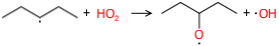

In [11]:
rxnList = rateCoeff.loc['AutoTST-OOH'].dropna().keys()
kinSheet = rateCoeff[rxnList].T.sort_values(by='AutoTST-OOH').T
kSheet = kinSheet.iloc[:-1,:] # remove the last column, which is AutoTST-OOHabstraction
kinSheet.columns[18]

In [12]:
kSheet

,RCRESOLO + H2O2 => CRESOL + HO2,NC9H20 + HO2 <=> C9H19-4 + H2O2,NC9H20 + HO2 <=> C9H19-3 + H2O2,NC9H20 + HO2 <=> C9H19-1 + H2O2,NC9H20 + HO2 <=> C9H19-2 + H2O2,NC9H20 + HO2 <=> C9H19-5 + H2O2,ch3cooh + ho2 => ch2cooh + h2o2,ch3cooh + ho2 <=> ch3co2 + h2o2,CH3O2 + HO2 <=> CH3O2H + O2,C6H5OH# + R3OOH <=> C6H4OH# + H2O2,...,CH2-5-cC6H6-13 + HO2 <=> A1CH2 + H2O2,STYREN + HO2 <=> BSTYRYL + H2O2,styrene + R3OOH => C6H5CH2CHO + R2OH,styrene + R3OOH => C6H5COCH3 + R2OH,C6H5C2H2 + H2O2 => C6H5C2H3 + HO2,STYREN + HO2 <=> ASTYRYL + H2O2,CH3 + HO2 <=> CH4 + O2,CH3 + HO2 <=> CH3O + OH,H2O2 + H <=> H2O + OH,H2O2 + H <=> HO2 + H2
AramcoMech_1.3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.207197,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.770857,16.019660,14.999943,13.864250
AramcoMech_2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.207197,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.770857,16.019660,14.999943,13.864250
Biomass,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.607270,14.999943,13.913422
Chernov,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.705882,14.337315,12.450654
CombFlame2012/2028-Sarathy,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.207197,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.770857,16.019660,14.999943,13.864250
CombFlame2013/1315-Chang,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.966083,16.509845,14.999943,13.690279
CombFlame2013/1541-Zhang,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,13.207197,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.770857,16.019660,14.999943,13.864250
CombFlame2013/1609-Veloo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,13.815511,NaN,14.999943,12.998830
CombFlame2013/17-Malewicki,NaN,7.329481,7.329481,6.351094,7.329481,6.636334,NaN,NaN,13.207197,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,14.966083,16.509845,14.999943,13.690279
CombFlame2013/1939-Cai,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,13.815511,16.410765,14.999943,12.998830


In [13]:
print kSheet.shape[1]/2
kSheet1 = kSheet.iloc[:, :(kSheet.shape[1]/2)]
kSheet2 = kSheet.iloc[:, (kSheet.shape[1]/2):]
kinSheet1 = kinSheet.iloc[:, :(kinSheet.shape[1]/2)]
kinSheet2 = kinSheet.iloc[:, (kinSheet.shape[1]/2):]

457


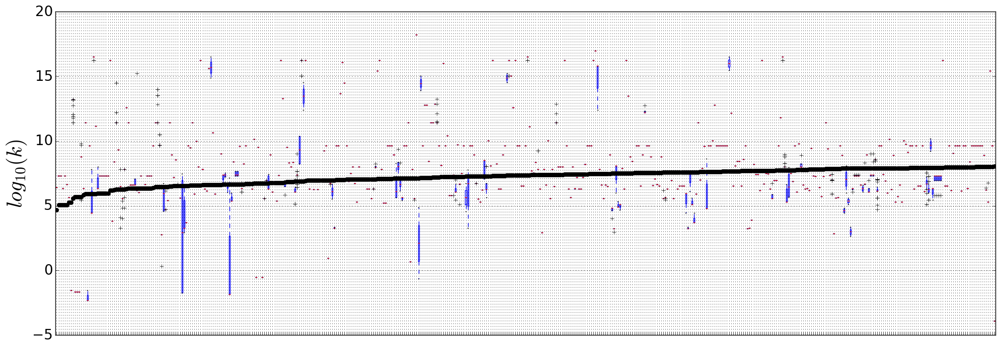

In [14]:

boxPlot = kSheet1.plot.box(figsize=(20,7), grid=True, rot=90)
boxPlot.plot(range(1,kSheet1.shape[1]+1),kinSheet1.transpose()['AutoTST-OOH'].values, marker='o', color='k', linestyle='')

boxPlot.set_ylabel('$log_{10}(k)$', fontsize=30)
#boxPlot.set_xlabel('Reaction', fontsize=30)
boxPlot.set_ylim((-5,20))
boxPlot.tick_params(
    axis="y",
    labelsize=20)# This cuts out the -70 results 
boxPlot.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom='on',      # ticks along the bottom edge are off
    top='off',         # ticks along the top edge are off
    labelbottom='off')




fig = boxPlot.get_figure()
fig.tight_layout()

fig.savefig("boxPlot1_presentation.pdf")


/Users/nathan/anaconda/envs/rmg_env/lib/python2.7/site-packages/numpy/lib/function_base.py:3834: RuntimeWarning: Invalid value encountered in percentile
  RuntimeWarning)


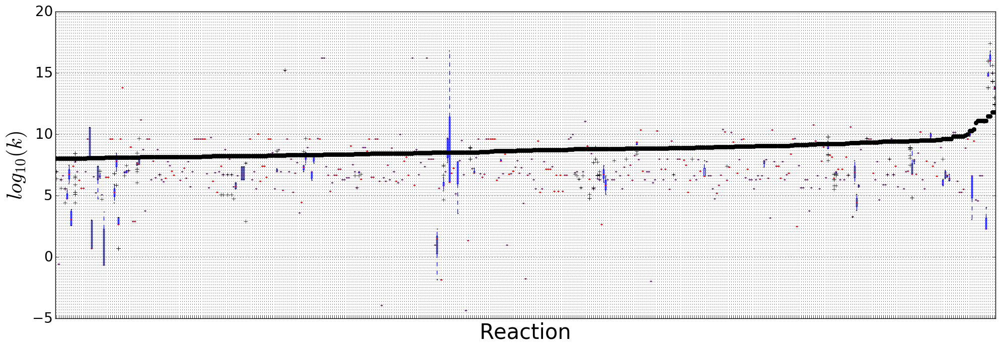

In [15]:

boxPlot = kSheet2.plot.box(figsize=(20,7), grid=True, rot=90)
boxPlot.plot(range(1,kSheet2.shape[1]+1),kinSheet2.transpose()['AutoTST-OOH'].values, marker='o', color='k', linestyle='')

boxPlot.set_ylabel('$log_{10}(k)$', fontsize=30)
boxPlot.set_xlabel('Reaction', fontsize=30)
boxPlot.set_ylim((-5,20))
boxPlot.tick_params(
    axis="y",
    labelsize=20)# This cuts out the -70 results 
boxPlot.tick_params(
    axis='x',          # changes apply to the x-axis
    which='both',      # both major and minor ticks are affected
    bottom='on',      # ticks along the bottom edge are off
    top='off',         # ticks along the top edge are off
    labelbottom='off')




fig = boxPlot.get_figure()
fig.tight_layout()

fig.savefig("boxPlot2_presentation.pdf")


## Making the parity plot

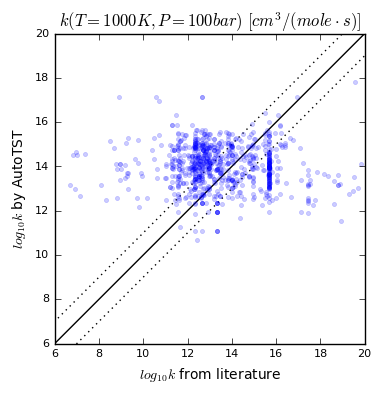

In [44]:
plt.plot(range(-2, 25), range(-2, 25), '-k', zorder=-1) # Parity Line
plt.plot(range(-3, 24), range(-2, 25), ':k', zorder=-1) # 1 order of magnitude
plt.plot(range(-1, 26), range(-2, 25), ':k', zorder=-1) # 1 order of magnitude
#plt.figure(figsize=(10,10))
for j in kinSheet.T.index:
    mean = kSheet[j].mean() + 6 # ksheet excludes AutoTST
    autoTST = kinSheet[j].loc['AutoTST-OOH'] + 6
    x_list = []
    y_list = []
    """
    for i in list(kinSheet.T):
        if i != "AutoTST-OOH" and not pd.isnull(kinSheet[j].loc[i]):
            x_list.append(kinSheet[j].loc[i] + 6)
            y_list.append(autoTST)
    """
            

    #plt.plot(x_list, y_list, '|-g', alpha=0.5) # Line and dots for the range of literature values
    #plt.plot(x_list, y_list, '|b') # Tick marks for each point
    
    plt.plot(mean, autoTST, '.b', alpha=0.2) # Red bars for the average
    

    plt.axis('equal')
    plt.ylim([6,20])
    plt.xlim([6,20])
    plt.title("$k(T=1000 K, P=100 bar) \ [cm^3 / (mole \cdot s)]$")
    plt.xlabel('$log_{10}k$ from literature', fontsize=10)
    plt.ylabel('$log_{10}k$ by AutoTST', fontsize=10)
    plt.tick_params(axis='x', labelsize=8)
    plt.tick_params(axis='y', labelsize=8)
    plt.axes().set_aspect('equal',adjustable='box')
    


#plt.savefig('parityPlot.pdf')

Trying to debug the `ValueError` on `not pd.isnull(kinSheet[i].loc[j])` which suggests `kinSheet[i].loc[j]` is a Series not a single value

There are two reactions that look the same!
Looking into the `AutoTST-OOHabstraction` Reaction Library it looks like there are two different species being given the same name `IC4H6OH` in the spreadsheet.

## IC4H7OH + HO2 <=> IC4H6OH + H2O2
```
AutoTST-OOHabstraction Arrhenius(A=(8.37166e-09,'cm^3/(mol*s)'), n=5.75426, Ea=(31.1394,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.74682, dn = +|- 0.132612, dEa = +|- 0.729496 kJ/mol""")
Gasoline_Surrogate Arrhenius(A=(7644,'cm^3/(mol*s)'), n=2.712, Ea=(13930,'cal/mol'), T0=(1,'K'))
n-Heptane Arrhenius(A=(7644,'cm^3/(mol*s)'), n=2.712, Ea=(13930,'cal/mol'), T0=(1,'K'))
PCI2013/335-Wang Arrhenius(A=(7644,'cm^3/(mol*s)'), n=2.712, Ea=(13930,'cal/mol'), T0=(1,'K'))
MB-Dooley Arrhenius(A=(7644,'cm^3/(mol*s)'), n=2.71, Ea=(13930,'cal/mol'), T0=(1,'K'))
CombFlame2013/487-Schenk Arrhenius(A=(792.2,'cm^3/(mol*s)'), n=2.98, Ea=(12300,'cal/mol'), T0=(1,'K'))
AramcoMech_2.0 Arrhenius(A=(1.45e-05,'cm^3/(mol*s)'), n=5.26, Ea=(8267.91,'cal/mol'), T0=(1,'K'))
CombFlame2013/1541-Zhang Arrhenius(A=(7644,'cm^3/(mol*s)'), n=2.712, Ea=(13930,'cal/mol'), T0=(1,'K'))
```
In `AutoTST-OOHabstraction` this is:
```
entry(
    index = 162,
    label = "C4H8O(189) + HO2(2) <=> H2O2(4) + C4H7O(259)",
    degeneracy = 1,
    kinetics =  Arrhenius(
        A = (8.37166e-09, 'cm^3/(mol*s)'),
        n = 5.75426,
        Ea = (31.1394, 'kJ/mol'),
        T0 = (1, 'K'),
        Tmin = (303.03, 'K'),
        Tmax = (2500, 'K'),
        comment = 'Fitted to 59 data points; dA = *|/ 2.74682, dn = +|- 0.132612, dEa = +|- 0.729496 kJ/mol',
    ),
    shortDesc = u"""AutoTST M062X for C4H8O(189) + HO2(2) <=> H2O2(4) + C4H7O(259)""",
)
```
and `C4H7O(259)` is 
```
C4H7O(259)
multiplicity 2
1  C u0 p0 c0 {2,S} {5,S} {6,S} {7,S}
2  C u0 p0 c0 {1,S} {3,S} {4,D}
3  C u1 p0 c0 {2,S} {8,S} {9,S}
4  C u0 p0 c0 {2,D} {10,S} {11,S}
5  O u0 p2 c0 {1,S} {12,S}
6  H u0 p0 c0 {1,S}
7  H u0 p0 c0 {1,S}
8  H u0 p0 c0 {3,S}
9  H u0 p0 c0 {3,S}
10 H u0 p0 c0 {4,S}
11 H u0 p0 c0 {4,S}
12 H u0 p0 c0 {5,S}

InChI:	InChI=1S/C4H7O/c1-4(2)3-5/h5H,1-3H2
SMILES:	[CH2]C(=C)CO
```

## IC4H7OH + HO2 <=> IC4H6OH + H2O2
```
AutoTST-OOHabstraction Arrhenius(A=(8.04843e-06,'cm^3/(mol*s)'), n=4.79274, Ea=(14.1732,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.74322, dn = +|- 0.0729353, dEa = +|- 0.401217 kJ/mol""")
PCI2017/052-Li Arrhenius(A=(1.45e-05,'cm^3/(mol*s)'), n=5.26, Ea=(8267.91,'cal/mol'), T0=(1,'K'))
```
In `AutoTST-OOHabstraction` this is:
```
entry(
    index = 112,
    label = "C4H8O(189) + HO2(2) <=> C4H7O(190) + H2O2(4)",
    degeneracy = 1,
    kinetics =  Arrhenius(
        A = (8.04843e-06, 'cm^3/(mol*s)'),
        n = 4.79274,
        Ea = (14.1732, 'kJ/mol'),
        T0 = (1, 'K'),
        Tmin = (303.03, 'K'),
        Tmax = (2500, 'K'),
        comment = 'Fitted to 59 data points; dA = *|/ 1.74322, dn = +|- 0.0729353, dEa = +|- 0.401217 kJ/mol',
    ),
    shortDesc = u"""AutoTST M062X for C4H8O(189) + HO2(2) <=> C4H7O(190) + H2O2(4)""",
)
```
and `C4H7O(190)` is 
```
C4H7O(190)
multiplicity 2
1  C u0 p0 c0 {2,S} {6,S} {7,S} {8,S}
2  C u0 p0 c0 {1,S} {3,S} {4,D}
3  C u1 p0 c0 {2,S} {5,S} {9,S}
4  C u0 p0 c0 {2,D} {10,S} {11,S}
5  O u0 p2 c0 {3,S} {12,S}
6  H u0 p0 c0 {1,S}
7  H u0 p0 c0 {1,S}
8  H u0 p0 c0 {1,S}
9  H u0 p0 c0 {3,S}
10 H u0 p0 c0 {4,S}
11 H u0 p0 c0 {4,S}
12 H u0 p0 c0 {5,S}

InChI:	InChI=1S/C4H7O/c1-4(2)3-5/h3,5H,1H2,2H3
SMILES:	C=C(C)[CH]O
```

The InChI codes are different so they're not resonance isomers.  So I think it's a bug that the model comparer is giving them the same name. Let's load the names pickle and see if we can find them

In [ ]:
import cPickle as pickle
names = pickle.load(open('../names.pkl'))
names = pd.DataFrame(names)
names.columns = [n.toSMILES() for n in names.columns]
names.index = [n.split('RMG-models/')[-1] for n in names.index]
names

In [ ]:
print names.index
'AutoTST-OOHabstraction' in names.index

Dang!

## Making the Arrhenius plots for each reaction

In [19]:
importerKin = pd.DataFrame(importerKinetics).drop("AutoTST-OOHabstraction")
importerKin.loc['AutoTST-OOH'] = np.nan
importerKin 

,IC3H7COC3H6-T + H2O2 <=> IC3H7COC3H7-I + HO2,CH3CO + TETRALIN => CH3CHO + RTETRALIN,ic3h5cho + o <=> ic3h5co + oh,ic3h5cho + o2 <=> ic3h5co + ho2,ic3h5cho + h <=> ic3h5co + h2,ic3h5co <=> c3h5-t + co,CjOCOCOC*O <=> CjOCOC*O + CH2O,tc3h6ocho + oh <=> tc3h6cho + ho2,tc3h6ocho <=> ch3coch3 + hco,pC4H9 + HO2 <=> nC3H7 + OH + CH2O,...,C11OOH1-3O2 <=> C11OOH1-3 + O2,OHX + O2 <=> HO2 + O,C11OOH1-4O2 <=> C11OOH1-4 + O2,IC3H7OO + CYC6H8 => C3H7OOH + C6H6 + H,A2- + C4H4 <=> A3 + H,C11OOH2-1O2 <=> C11OOH2-1 + O2,CH3TXcC6H10 + O2 <=> CH3-1-cC6H9 + HO2,C11OOH3-2O2 <=> C11OOH3-2 + O2,SC4H7 + NC3H7OH => NC4H8 + CH3CHCH2OH,sc4h9o2 + c4h10 <=> sc4h9o2h + sc4h9
AramcoMech_1.3,NaN,NaN,"Arrhenius(A=(7.18e+12,'cm^3/(mol*s)'), n=0, Ea...","Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(4...","Arrhenius(A=(2.6e+12,'cm^3/(mol*s)'), n=0, Ea=...","Arrhenius(A=(1.278e+20,'s^-1'), n=-1.89, Ea=(3...",NaN,"Arrhenius(A=(2.018e+17,'cm^3/(mol*s)'), n=-1.2...","Arrhenius(A=(3.98e+13,'s^-1'), n=0, Ea=(9700,'...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea..."
AramcoMech_2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(2.018e+17,'cm^3/(mol*s)'), n=-1.2...",NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Biomass,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Chernov,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2012/2028-Sarathy,NaN,NaN,"Arrhenius(A=(7.18e+12,'cm^3/(mol*s)'), n=0, Ea...","Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(4...","Arrhenius(A=(2.6e+12,'cm^3/(mol*s)'), n=0, Ea=...","Arrhenius(A=(1.278e+20,'s^-1'), n=-1.89, Ea=(3...",NaN,"Arrhenius(A=(2.018e+17,'cm^3/(mol*s)'), n=-1.2...","Arrhenius(A=(3.98e+13,'s^-1'), n=0, Ea=(9700,'...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea..."
CombFlame2013/1315-Chang,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/1541-Zhang,NaN,NaN,"Arrhenius(A=(7.18e+12,'cm^3/(mol*s)'), n=0, Ea...","Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(4...","Arrhenius(A=(2.6e+12,'cm^3/(mol*s)'), n=0, Ea=...","Arrhenius(A=(1.278e+20,'s^-1'), n=-1.89, Ea=(3...",NaN,NaN,"Arrhenius(A=(3.98e+13,'s^-1'), n=0, Ea=(9700,'...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea..."
CombFlame2013/1609-Veloo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/17-Malewicki,NaN,NaN,"Arrhenius(A=(7.18e+12,'cm^3/(mol*s)'), n=0, Ea...","Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(4...","Arrhenius(A=(2.6e+12,'cm^3/(mol*s)'), n=0, Ea=...",NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea..."
CombFlame2013/1907-Merchant,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [ ]:
directory = '/gss_gpfs_scratch/harms.n/comparerTST'
results = defaultdict(OrderedDict)
comparerFiles = [f for f in os.listdir(directory) if os.path.isfile(os.path.join(directory, f))]
k = 0
for fil in comparerFiles:
    if ".log" and "updated" in fil:
        k += 1
print k
results = defaultdict(OrderedDict)
not_ooh_abstraction = []
autoTST = {}
for i in range(1,k+1):
    r = results[i]
    filename = 'AutoTST-comparer.updated.{0:d}.combined.log'.format(i)
    filepath = os.path.join(directory,filename)
    with open(filepath) as f:
        lines = f.readlines()
    
    for j,l in enumerate(lines):
        m = re.match('comparerTST.py:182 performCalcs INFO reaction: (.*)', l)
        n = re.match('comparerTST.py:221 performCalcs INFO We have calculated kinetics (.*)', l)
        if m:
            r['Reaction'] = eval(m.group(1))
        if n:
            r["AutoTST Arrhenius"] = evalArrhenius(n.group(1))

    if "Reaction" in r.keys() and "AutoTST Arrhenius" in r.keys():
        autoTST[r['Reaction']] = r["AutoTST Arrhenius"]
        

In [22]:
autoTST

17.79782850026017

In [31]:
for key in importerKin.keys():
    if len(key.reactants) == 2 and len(key.products) == 2:
        reacts = []
        for reactant in key.reactants:
            reacts.append(reactant.molecule[0])
        for autoTSTKey in autotst_kinetics:
            if autoTSTKey.matchesMolecules(reacts):
                print "Match found"
                print autoTSTKey
                print
                importerKin[key].loc["AutoTST-OOH"] = autoTSTKey.kinetics

Match found
UBLDSKDTLIHIDN-UHFFFAOYSA-u6 + MHAJPDPJQMAIIY-UHFFFAOYSA <=> HXVNBWAKAOHACI-UHFFFAOYSA + OUUQCZGPVNCOIJ-UHFFFAOYSA-u2

Match found
OUUQCZGPVNCOIJ-UHFFFAOYSA-u2 + STNJBCKSHOAVAJ-UHFFFAOYSA <=> MHAJPDPJQMAIIY-UHFFFAOYSA + KHZBQMMGVPWWAU-UHFFFAOYSA-u3

Match found
STNJBCKSHOAVAJ-UHFFFAOYSA + OUUQCZGPVNCOIJ-UHFFFAOYSA-u2 <=> WJCFNDBWNOZYRK-UHFFFAOYSA-u1 + MHAJPDPJQMAIIY-UHFFFAOYSA

Match found
HXCJICGBLUHJAP-UHFFFAOYSA-u1 + UFHFLCQGNIYNRP-UHFFFAOYSA <=> YZCKVEUIGOORGS-UHFFFAOYSA-u1 + LAIUFBWHERIJIH-UHFFFAOYSA

Match found
YZCKVEUIGOORGS-UHFFFAOYSA-u1 + LAIUFBWHERIJIH-UHFFFAOYSA <=> UFHFLCQGNIYNRP-UHFFFAOYSA + NUQMYZQRNWAISM-UHFFFAOYSA-u5

Match found
YZCKVEUIGOORGS-UHFFFAOYSA-u1 + LAIUFBWHERIJIH-UHFFFAOYSA <=> UFHFLCQGNIYNRP-UHFFFAOYSA + LNRGKCVGVGVUBD-UHFFFAOYSA-u7

Match found
BPYKZOBWXAYCFH-UHFFFAOYSA-u2 + UFHFLCQGNIYNRP-UHFFFAOYSA <=> YZCKVEUIGOORGS-UHFFFAOYSA-u1 + LAIUFBWHERIJIH-UHFFFAOYSA

Match found
UFHFLCQGNIYNRP-UHFFFAOYSA + SHCLHMINMSSGHM-UHFFFAOYSA-u3 <=> LAIUFBWHER

In [32]:
importerKin

,IC3H7COC3H6-T + H2O2 <=> IC3H7COC3H7-I + HO2,CH3CO + TETRALIN => CH3CHO + RTETRALIN,ic3h5cho + o <=> ic3h5co + oh,ic3h5cho + o2 <=> ic3h5co + ho2,ic3h5cho + h <=> ic3h5co + h2,ic3h5co <=> c3h5-t + co,CjOCOCOC*O <=> CjOCOC*O + CH2O,tc3h6ocho + oh <=> tc3h6cho + ho2,tc3h6ocho <=> ch3coch3 + hco,pC4H9 + HO2 <=> nC3H7 + OH + CH2O,...,C11OOH1-3O2 <=> C11OOH1-3 + O2,OHX + O2 <=> HO2 + O,C11OOH1-4O2 <=> C11OOH1-4 + O2,IC3H7OO + CYC6H8 => C3H7OOH + C6H6 + H,A2- + C4H4 <=> A3 + H,C11OOH2-1O2 <=> C11OOH2-1 + O2,CH3TXcC6H10 + O2 <=> CH3-1-cC6H9 + HO2,C11OOH3-2O2 <=> C11OOH3-2 + O2,SC4H7 + NC3H7OH => NC4H8 + CH3CHCH2OH,sc4h9o2 + c4h10 <=> sc4h9o2h + sc4h9
AramcoMech_1.3,NaN,NaN,"Arrhenius(A=(7.18e+12,'cm^3/(mol*s)'), n=0, Ea...","Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(4...","Arrhenius(A=(2.6e+12,'cm^3/(mol*s)'), n=0, Ea=...","Arrhenius(A=(1.278e+20,'s^-1'), n=-1.89, Ea=(3...",NaN,"Arrhenius(A=(2.018e+17,'cm^3/(mol*s)'), n=-1.2...","Arrhenius(A=(3.98e+13,'s^-1'), n=0, Ea=(9700,'...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea..."
AramcoMech_2.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(2.018e+17,'cm^3/(mol*s)'), n=-1.2...",NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Biomass,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
Chernov,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2012/2028-Sarathy,NaN,NaN,"Arrhenius(A=(7.18e+12,'cm^3/(mol*s)'), n=0, Ea...","Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(4...","Arrhenius(A=(2.6e+12,'cm^3/(mol*s)'), n=0, Ea=...","Arrhenius(A=(1.278e+20,'s^-1'), n=-1.89, Ea=(3...",NaN,"Arrhenius(A=(2.018e+17,'cm^3/(mol*s)'), n=-1.2...","Arrhenius(A=(3.98e+13,'s^-1'), n=0, Ea=(9700,'...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea..."
CombFlame2013/1315-Chang,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/1541-Zhang,NaN,NaN,"Arrhenius(A=(7.18e+12,'cm^3/(mol*s)'), n=0, Ea...","Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(4...","Arrhenius(A=(2.6e+12,'cm^3/(mol*s)'), n=0, Ea=...","Arrhenius(A=(1.278e+20,'s^-1'), n=-1.89, Ea=(3...",NaN,NaN,"Arrhenius(A=(3.98e+13,'s^-1'), n=0, Ea=(9700,'...",NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea..."
CombFlame2013/1609-Veloo,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CombFlame2013/17-Malewicki,NaN,NaN,"Arrhenius(A=(7.18e+12,'cm^3/(mol*s)'), n=0, Ea...","Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(4...","Arrhenius(A=(2.6e+12,'cm^3/(mol*s)'), n=0, Ea=...",NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea..."
CombFlame2013/1907-Merchant,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


In [33]:
rxnList = importerKin.T['AutoTST-OOH'].dropna(axis=0).index.values
expSheet = importerKin[rxnList].T.sort_values(by='AutoTST-OOH')
expSheet

,AramcoMech_1.3,AramcoMech_2.0,Biomass,Chernov,CombFlame2012/2028-Sarathy,CombFlame2013/1315-Chang,CombFlame2013/1541-Zhang,CombFlame2013/1609-Veloo,CombFlame2013/17-Malewicki,CombFlame2013/1907-Merchant,...,PCI2017/058-Sun,PCI2017/082-Hemken,PCI2017/087-Tran,PCI2017/111-Jin,PCI2017/145-Sun,Reduced-DRG-GRI-mech,Shamel-Propane,USC_Mech_ii,n-Heptane,AutoTST-OOH
c8h17oo-5-3 + h2o2 <=> c8h17ooh-5-3 + ho2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(2.14071e-07,'cm^3/(mol*s)'), n=4...."
R231C4H9O2U + R3OOH => C4H10O2P + O2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(0.000699088,'cm^3/(mol*s)'), n=4...."
sc4h9o2 + ho2 <=> sc4h9o2h + o2,"Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea...",NaN,NaN,NaN,"Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea...",NaN,"Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea...",NaN,"Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea...",NaN,...,"Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea...","Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea...","Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea...",NaN,"Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea...",NaN,NaN,NaN,"Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea...","Arrhenius(A=(0.000699088,'cm^3/(mol*s)'), n=4...."
FC6H13O2 + H2O2 <=> FC6H13O2H + HO2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(7.69938e-06,'cm^3/(mol*s)'), n=4...."
DC5H11 + HO2 <=> DC5H11O + OH,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(0.00842519,'cm^3/(mol*s)'), n=4.1..."
AC8H17 + CH4 <=> IC8H18 + CH3,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(7.22846e-05,'cm^3/(mol*s)'), n=4...."
D-EC6H12O + HO2 => IC4H9COCH2 + H2O2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(0.000567416,'cm^3/(mol*s)'), n=4...."
D-EC6H12O + HO2 => DC5H10CHO + H2O2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(0.000567416,'cm^3/(mol*s)'), n=4...."
IC5H11CO + H2O2 <=> IC5H11CHO + HO2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(0.000516781,'cm^3/(mol*s)'), n=4...."
NC5H11CO + H2O2 <=> NC5H11CHO + HO2,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,"Arrhenius(A=(3.33482e-06,'cm^3/(mol*s)'), n=5...."


In [26]:
#%cd arrheniusPlots

Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.14071e-07,'cm^3/(mol*s)'), n=4.95298, Ea=(15.9078,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.58808, dn = +|- 0.0607022, dEa = +|- 0.333923 kJ/mol""")
c8h17oo-5-3 + h2o2 <=> c8h17ooh-5-3 + ho2


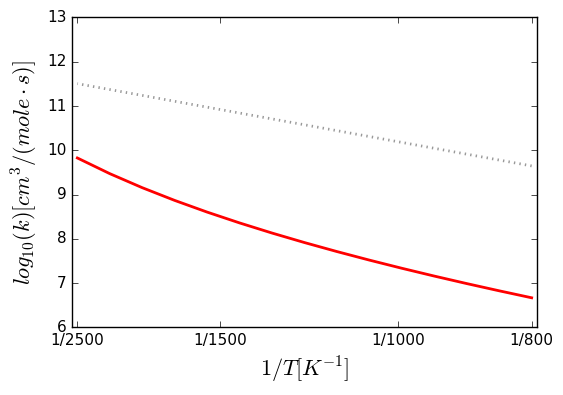


Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(-1300,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000699088,'cm^3/(mol*s)'), n=4.44799, Ea=(57.5136,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.27414, dn = +|- 0.0317961, dEa = +|- 0.17491 kJ/mol""")
R231C4H9O2U + R3OOH => C4H10O2P + O2


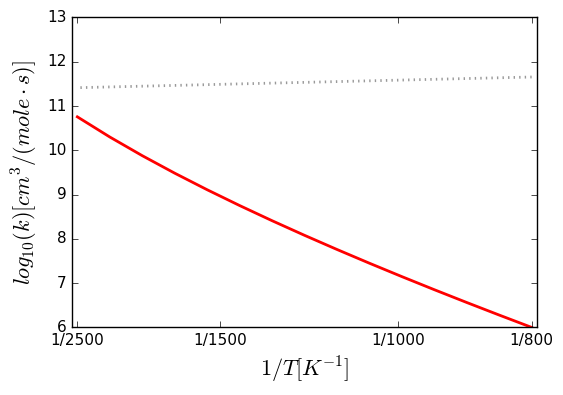


Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'

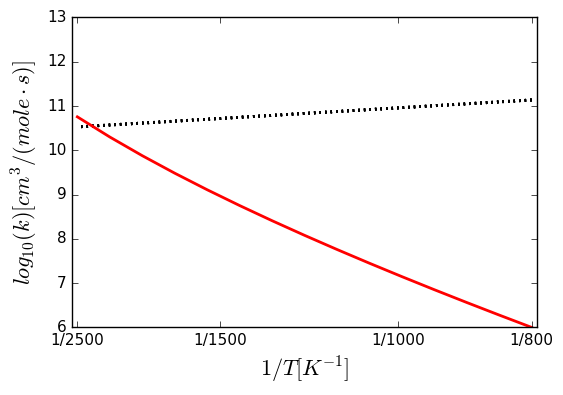


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.69938e-06,'cm^3/(mol*s)'), n=4.55833, Ea=(8.68669,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.35935, dn = +|- 0.0402918, dEa = +|- 0.221645 kJ/mol""")
FC6H13O2 + H2O2 <=> FC6H13O2H + HO2


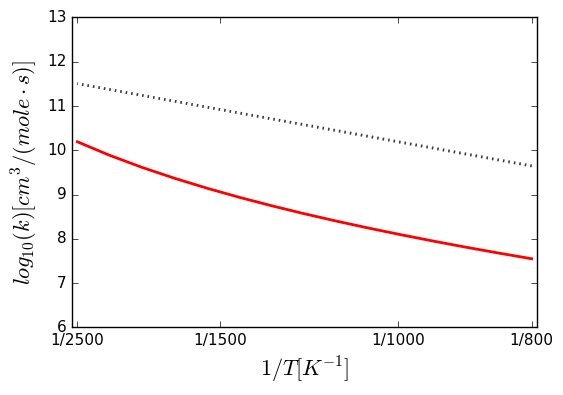


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00842519,'cm^3/(mol*s)'), n=4.18468, Ea=(38.5072,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.18581, dn = +|- 0.0223664, dEa = +|- 0.123037 kJ/mol""")
DC5H11 + HO2 <=> DC5H11O + OH


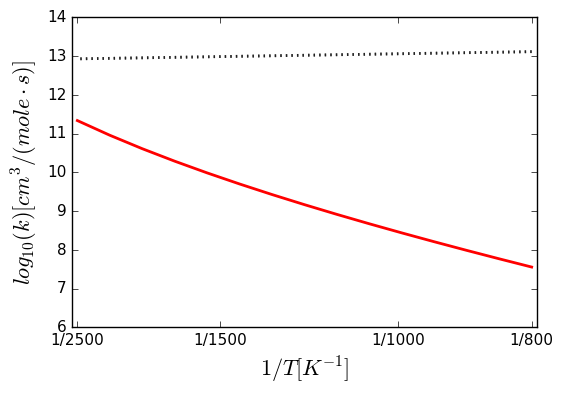


Arrhenius(A=(1.68e-14,'cm^3/(mol*s)'), n=8.06, Ea=(8911,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.22846e-05,'cm^3/(mol*s)'), n=4.6424, Ea=(34.5816,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.84825, dn = +|- 0.0806136, dEa = +|- 0.443456 kJ/mol""")
AC8H17 + CH4 <=> IC8H18 + CH3


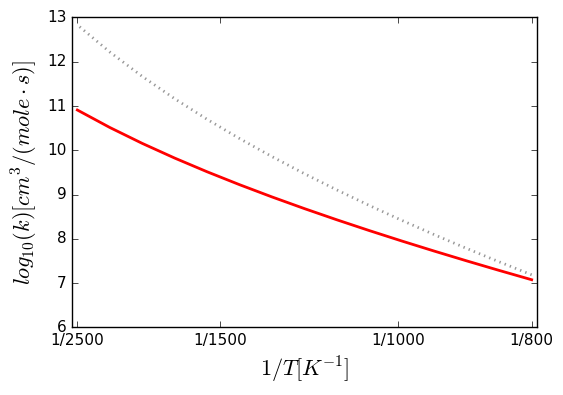


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000567416,'cm^3/(mol*s)'), n=4.4656, Ea=(42.4274,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.34622, dn = +|- 0.0390183, dEa = +|- 0.21464 kJ/mol""")
D-EC6H12O + HO2 => IC4H9COCH2 + H2O2


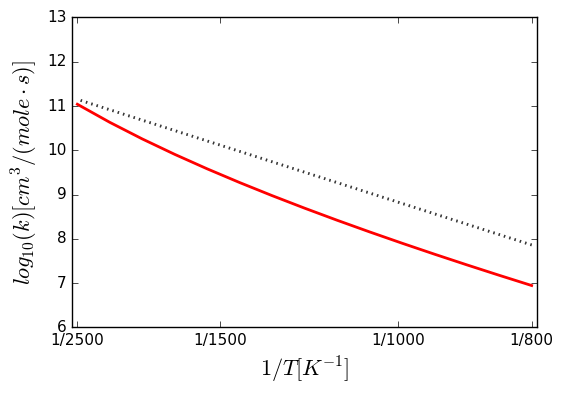


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000567416,'cm^3/(mol*s)'), n=4.4656, Ea=(42.4274,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.34622, dn = +|- 0.0390183, dEa = +|- 0.21464 kJ/mol""")
D-EC6H12O + HO2 => DC5H10CHO + H2O2


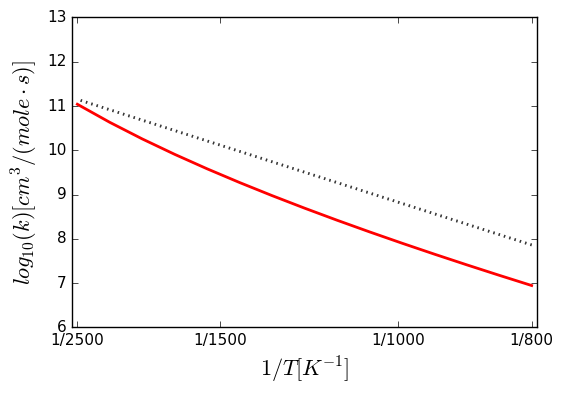


Arrhenius(A=(1.15e+13,'cm^3/(mol*s)'), n=-0.33, Ea=(12000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000516781,'cm^3/(mol*s)'), n=4.1389, Ea=(3.93756,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.22432, dn = +|- 0.026561, dEa = +|- 0.146112 kJ/mol""")
IC5H11CO + H2O2 <=> IC5H11CHO + HO2


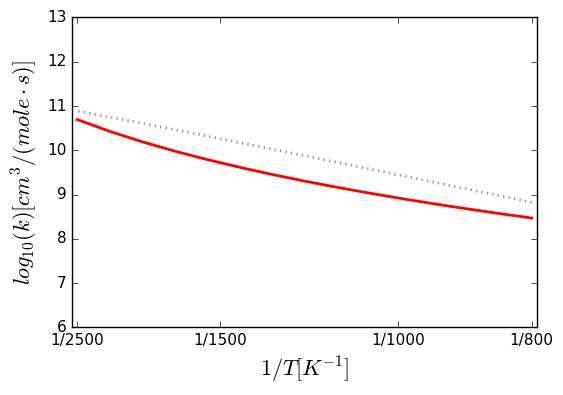


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.33482e-06,'cm^3/(mol*s)'), n=5.27598, Ea=(4.24339,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29015, dn = +|- 0.0334353, dEa = +|- 0.183927 kJ/mol""")
NC5H11CO + H2O2 <=> NC5H11CHO + HO2


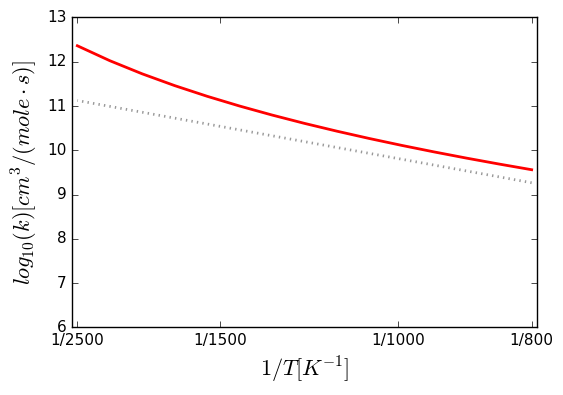


Arrhenius(A=(506,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00170865,'cm^3/(mol*s)'), n=4.48735, Ea=(48.5413,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.30303, dn = +|- 0.034739, dEa = +|- 0.191099 kJ/mol""")
c8h16-1 + ho2 <=> c8h15 + h2o2


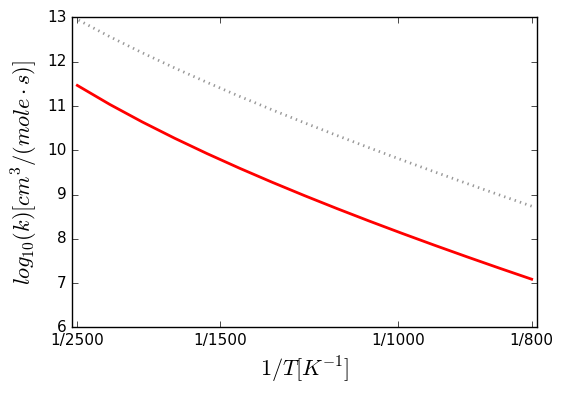


Arrhenius(A=(4.54e+11,'cm^3/(mol*s)'), n=0.01, Ea=(8175,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.73278e-05,'cm^3/(mol*s)'), n=4.2315, Ea=(2.68903,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.3058, dn = +|- 0.0350168, dEa = +|- 0.192627 kJ/mol""")
ZC7H15 + H2O2 <=> C7H162-4 + HO2


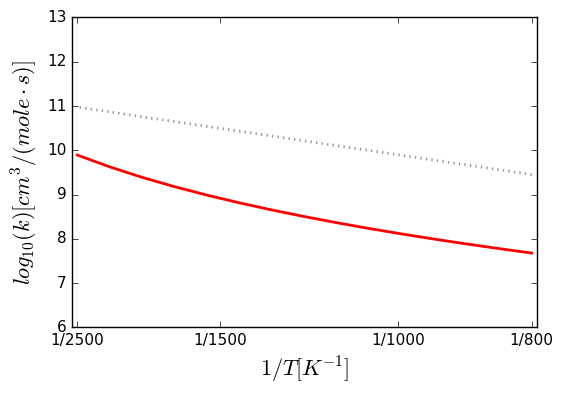


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.47687e-05,'cm^3/(mol*s)'), n=4.92848, Ea=(29.9282,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.79755, dn = +|- 0.0769631, dEa = +|- 0.423374 kJ/mol""")
C4H7CHO1-2 + HO2 <=> C4H7CO1-2 + H2O2


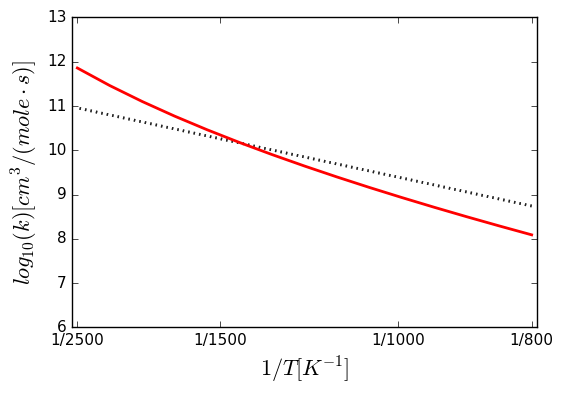


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.47687e-05,'cm^3/(mol*s)'), n=4.92848, Ea=(29.9282,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.79755, dn = +|- 0.0769631, dEa = +|- 0.423374 kJ/mol""")
C4H7CHO1-2 + HO2 <=> C4H6CHO1-24 + H2O2


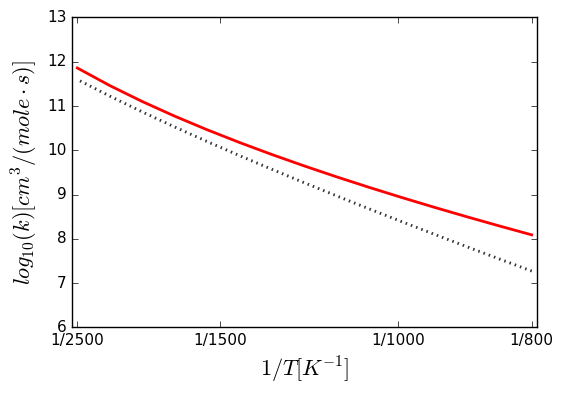


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.47687e-05,'cm^3/(mol*s)'), n=4.92848, Ea=(29.9282,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.79755, dn = +|- 0.0769631, dEa = +|- 0.423374 kJ/mol""")
C4H7CHO1-2 + HO2 <=> C4H6CHO1-23 + H2O2


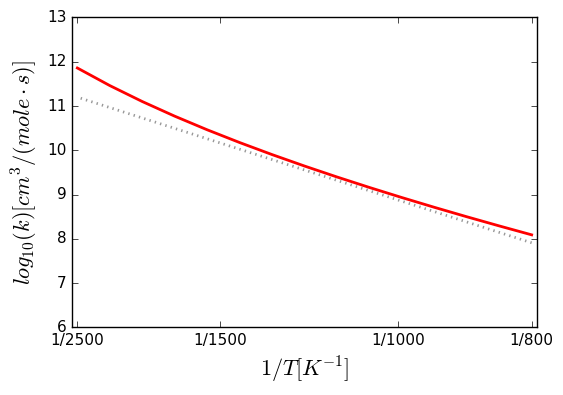


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.47687e-05,'cm^3/(mol*s)'), n=4.92848, Ea=(29.9282,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.79755, dn = +|- 0.0769631, dEa = +|- 0.423374 kJ/mol""")
C4H7CHO1-2 + HO2 <=> C4H6CHO1-23 + H2O2


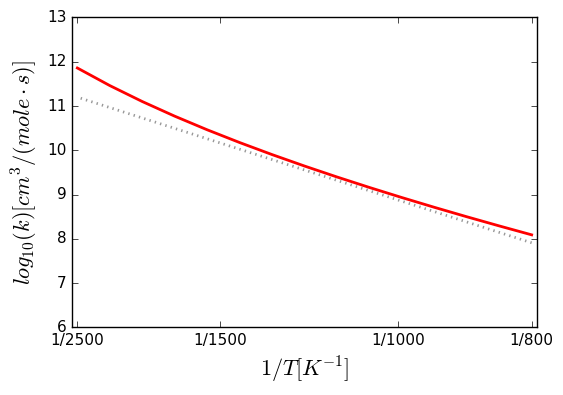


Arrhenius(A=(1.43e+06,'cm^3/(mol*s)'), n=2.01, Ea=(8942,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.43822e-08,'cm^3/(mol*s)'), n=5.55803, Ea=(17.6162,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.6147, dn = +|- 0.126142, dEa = +|- 0.69391 kJ/mol""")
IC3H7CHCHO + H2O2 <=> IC4H9CHO + HO2


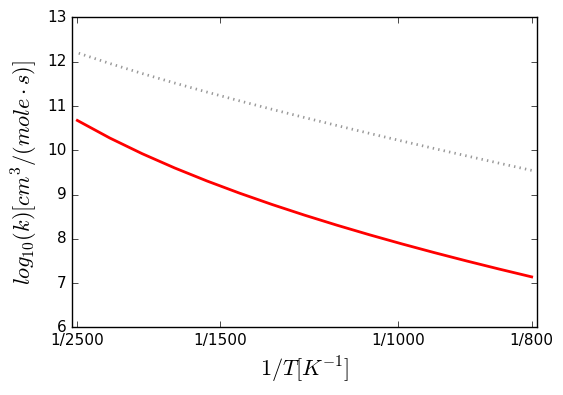


Arrhenius(A=(71400,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(484900,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0141167,'cm^3/(mol*s)'), n=4.09277, Ea=(66.0789,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.12325, dn = +|- 0.0152534, dEa = +|- 0.0839092 kJ/mol""")
tc4h9oh + ho2 <=> tc4h8oh + h2o2


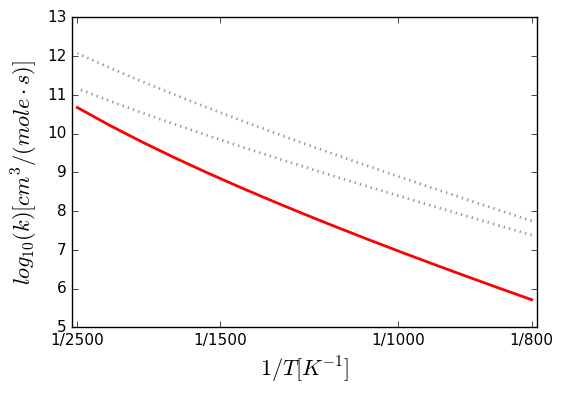


Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(53880,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0141167,'cm^3/(mol*s)'), n=4.09277, Ea=(66.0789,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.12325, dn = +|- 0.0152534, dEa = +|- 0.0839092 kJ/mol""")
tc4h9oh + ho2 <=> tc4h9o + h2o2


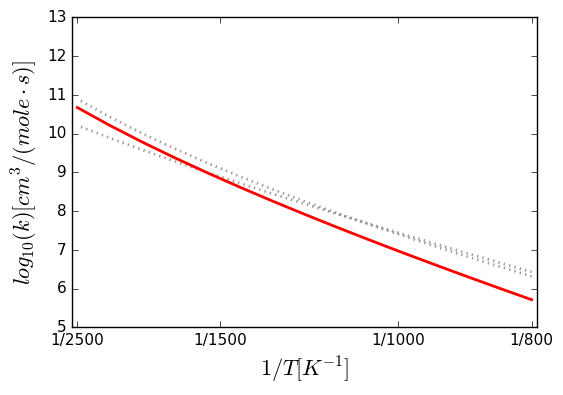


Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.04055e-07,'cm^3/(mol*s)'), n=5.34906, Ea=(15.9576,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.28051, dn = +|- 0.108195, dEa = +|- 0.595182 kJ/mol""")
C10H10 + HO2 <=> C10H9 + H2O2


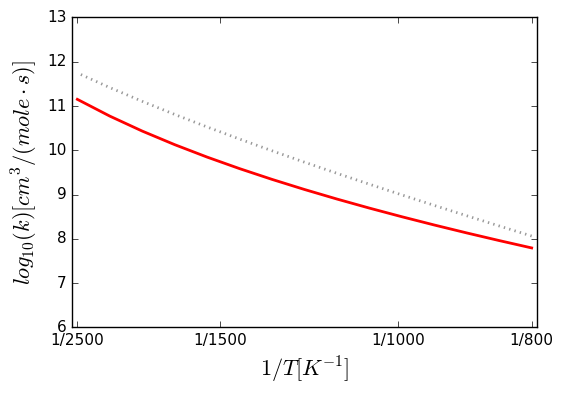


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000106295,'cm^3/(mol*s)'), n=4.28078, Ea=(5.58078,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.2015, dn = +|- 0.0240916, dEa = +|- 0.132528 kJ/mol""")
tc4h8oh-o2 + h2o2 <=> tc4h8oh-o2h + ho2


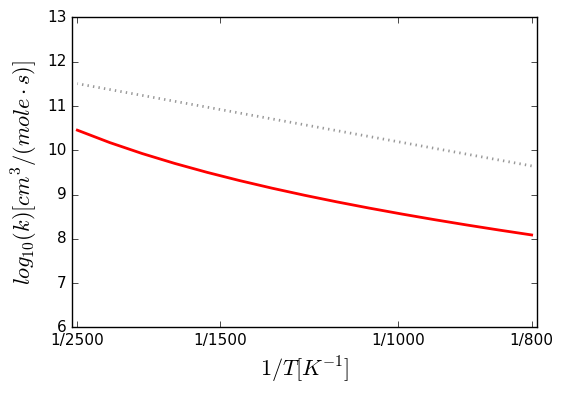


Arrhenius(A=(39,'cm^3/(mol*s)'), n=3.08, Ea=(25206,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.25833e-08,'cm^3/(mol*s)'), n=5.48414, Ea=(71.061,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.45502, dn = +|- 0.117872, dEa = +|- 0.648416 kJ/mol""")
ch3cooh + ho2 <=> ch3co2 + h2o2


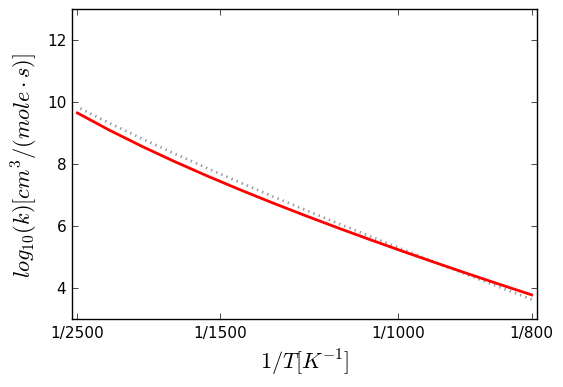


Arrhenius(A=(8.4e+12,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.25833e-08,'cm^3/(mol*s)'), n=5.48414, Ea=(71.061,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.45502, dn = +|- 0.117872, dEa = +|- 0.648416 kJ/mol""")
ch3cooh + ho2 => ch2cooh + h2o2


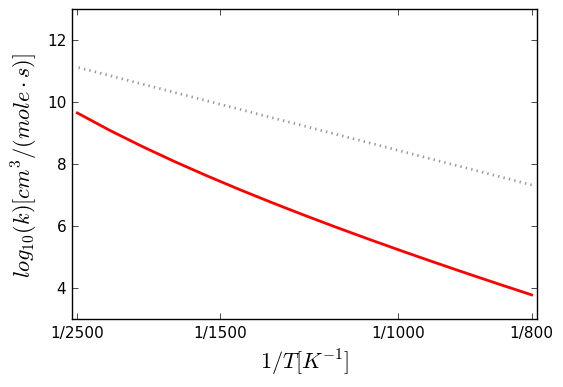


Arrhenius(A=(1.2e+12,'cm^3/(mol*s)'), n=0, Ea=(17000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.2e+12,'cm^3/(mol*s)'), n=0, Ea=(17000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.43357e-06,'cm^3/(mol*s)'), n=5.16052, Ea=(25.6917,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.07841, dn = +|- 0.0960166, dEa = +|- 0.528188 kJ/mol""")
cumene + R3OOH <=> H2O2 + C9H11#-1


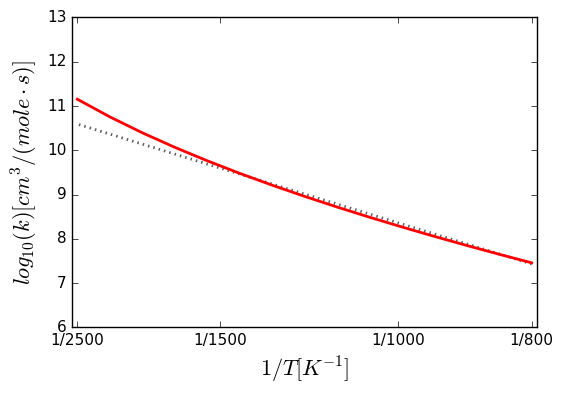


Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'

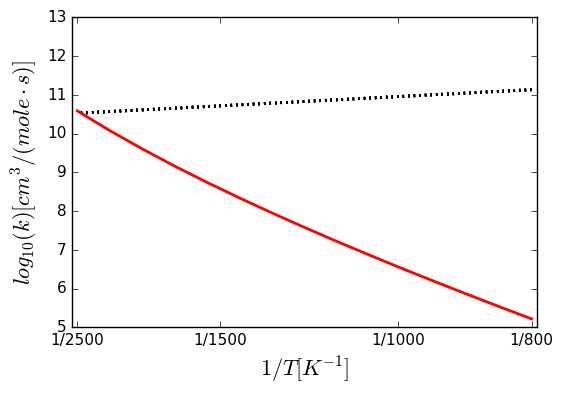


Arrhenius(A=(1.7e+07,'cm^3/(mol*s)'), n=1.53, Ea=(10500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.03971e-06,'cm^3/(mol*s)'), n=4.98925, Ea=(8.4172,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.83441, dn = +|- 0.0796272, dEa = +|- 0.438029 kJ/mol""")
TC4H9COCH2 + H2O2 <=> TC4H9COCH3 + HO2


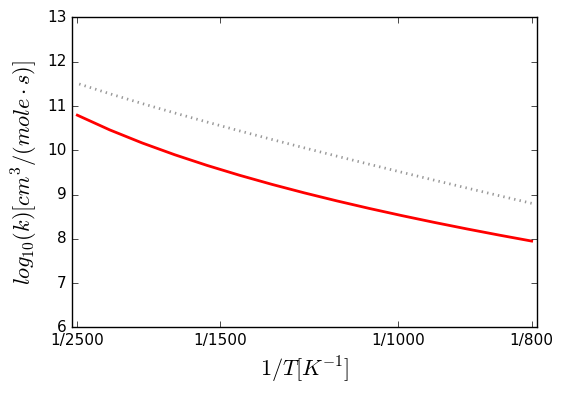


Arrhenius(A=(5.45e-05,'cm^3/(mol*s)'), n=4.852, Ea=(11911.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.28375e-07,'cm^3/(mol*s)'), n=5.44916, Ea=(33.7135,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.17793, dn = +|- 0.102155, dEa = +|- 0.561953 kJ/mol""")
CH3OCOC2H5 + HO2 <=> CH3OCOCHCH3 + H2O2


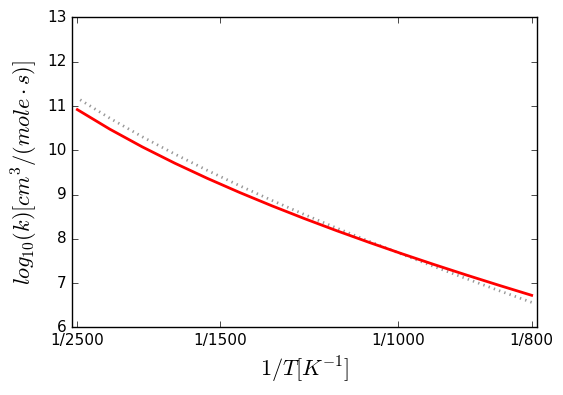


Arrhenius(A=(0.179,'cm^3/(mol*s)'), n=3.955, Ea=(16958.9,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.28375e-07,'cm^3/(mol*s)'), n=5.44916, Ea=(33.7135,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.17793, dn = +|- 0.102155, dEa = +|- 0.561953 kJ/mol""")
CH3OCOC2H5 + HO2 <=> CH3OCOCH2CH2 + H2O2


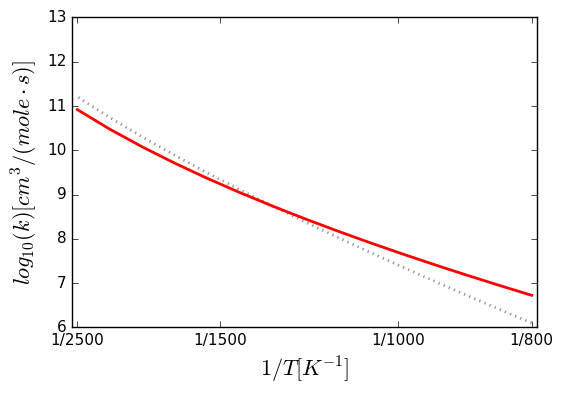


Arrhenius(A=(9.9e-07,'cm^3/(mol*s)'), n=5.47, Ea=(13619,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.28375e-07,'cm^3/(mol*s)'), n=5.44916, Ea=(33.7135,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.17793, dn = +|- 0.102155, dEa = +|- 0.561953 kJ/mol""")
CH3OCOC2H5 + HO2 <=> CH2OCOC2H5 + H2O2


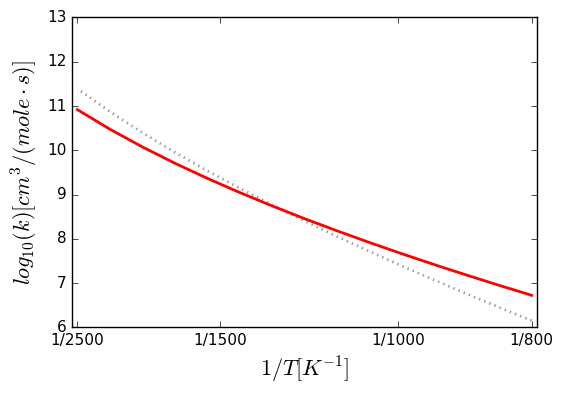


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00570514,'cm^3/(mol*s)'), n=4.12196, Ea=(33.9354,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17178, dn = +|- 0.0208053, dEa = +|- 0.11445 kJ/mol""")
ic4h8oh-3 + ho2 <=> ic4h8oh-3o + oh


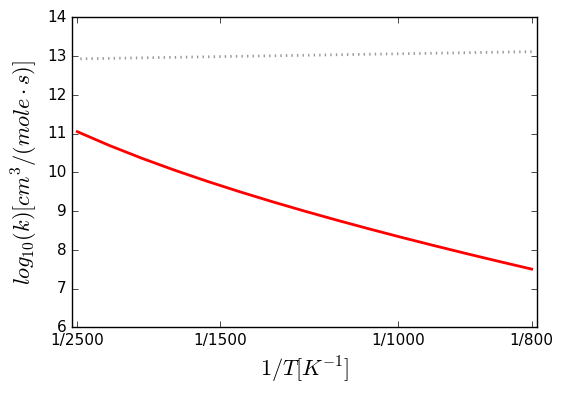


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.17842e-05,'cm^3/(mol*s)'), n=4.7859, Ea=(14.9525,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.68748, dn = +|- 0.0686704, dEa = +|- 0.377756 kJ/mol""")
mb4*o + ho2 <=> mb4j*o + h2o2


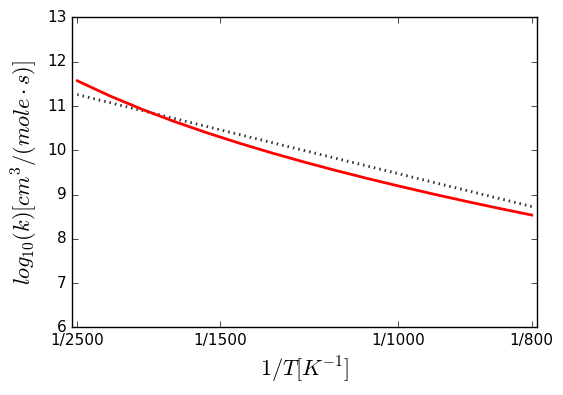


Arrhenius(A=(8e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.09861e-05,'cm^3/(mol*s)'), n=4.77176, Ea=(49.3376,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.50929, dn = +|- 0.054024, dEa = +|- 0.297186 kJ/mol""")
thf + ho2 <=> thf-3j + h2o2


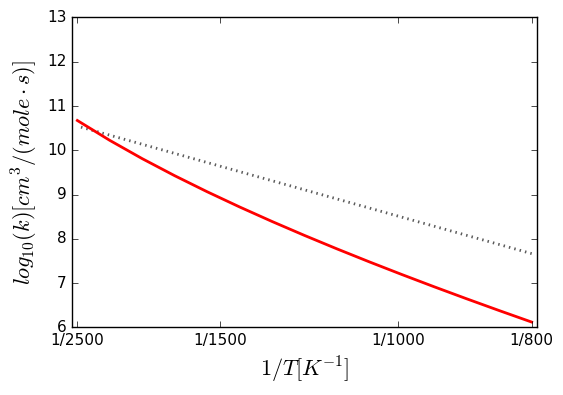


Arrhenius(A=(8e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.09861e-05,'cm^3/(mol*s)'), n=4.77176, Ea=(49.3376,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.50929, dn = +|- 0.054024, dEa = +|- 0.297186 kJ/mol""")
thf + ho2 <=> thf-2j + h2o2


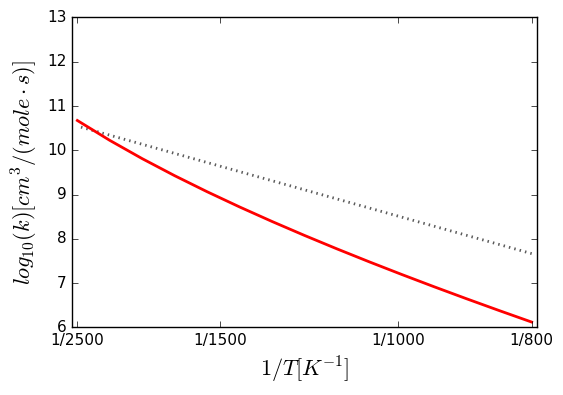


Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.28418e-08,'cm^3/(mol*s)'), n=5.51395, Ea=(25.9204,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.28198, dn = +|- 0.10828, dEa = +|- 0.595647 kJ/mol""")
ic3h5oh + ho2 <=> ch3coch3 + ho2


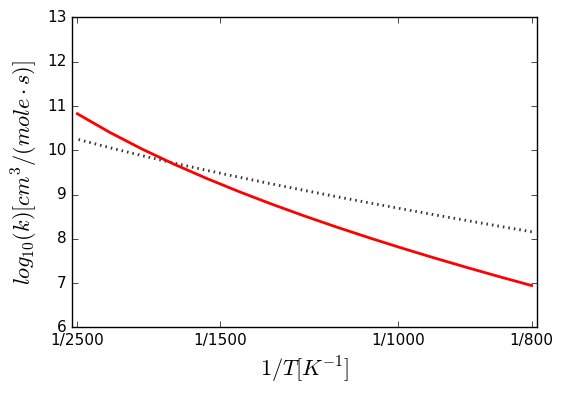


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.33637e-05,'cm^3/(mol*s)'), n=4.65345, Ea=(49.126,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.40929, dn = +|- 0.0450272, dEa = +|- 0.247695 kJ/mol""")
F-HC6H12O + HO2 => IC5H10CHO-BD + H2O2


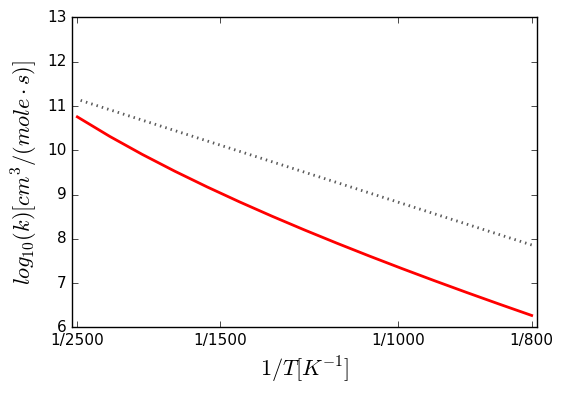


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.33637e-05,'cm^3/(mol*s)'), n=4.65345, Ea=(49.126,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.40929, dn = +|- 0.0450272, dEa = +|- 0.247695 kJ/mol""")
F-HC6H12O + HO2 => TC4H8CH2CHO + H2O2


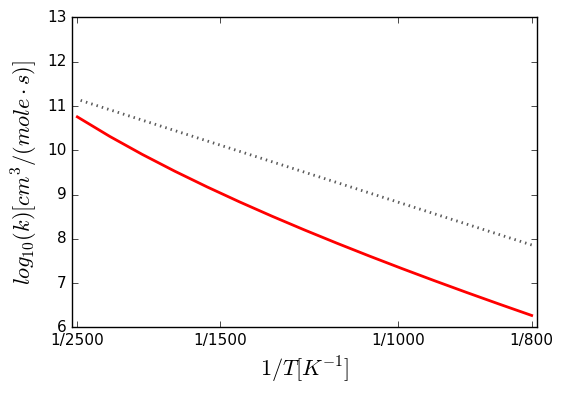


Arrhenius(A=(2.7e+11,'cm^3/(mol*s)'), n=0, Ea=(12000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.53937e-07,'cm^3/(mol*s)'), n=5.17289, Ea=(13.3364,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.04304, dn = +|- 0.0937638, dEa = +|- 0.515795 kJ/mol""")
C6H5CH2OH + HO2 <=> C6H5CH2OJ + H2O2


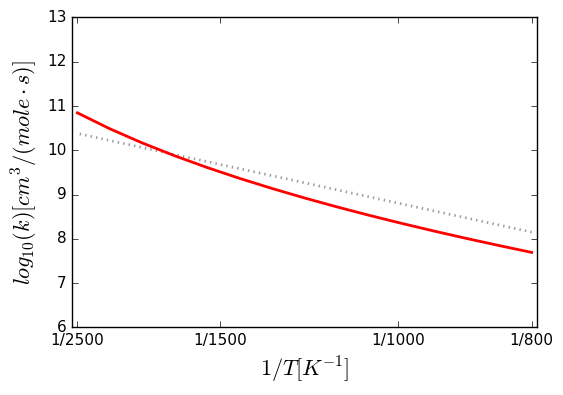


Arrhenius(A=(2.7e+11,'cm^3/(mol*s)'), n=0, Ea=(12000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.7e+11,'cm^3/(mol*s)'), n=0, Ea=(12000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.7e+11,'cm^3/(mol*s)'), n=0, Ea=(12000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.7e+11,'cm^3/(mol*s)'), n=0, Ea=(12000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.7e+11,'cm^3/(mol*s)'), n=0, Ea=(12000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.7e+11,'cm^3/(mol*s)'), n=0, Ea=(12000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.53937e-07,'cm^3/(mol*s)'), n=5.17289, Ea=(13.3364,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.04304, dn = +|- 0.0937638, dEa = +|- 0.515795 kJ/mol""")
C6H5CH2OH + R3OOH <=> C6H5CHOH + H2O2


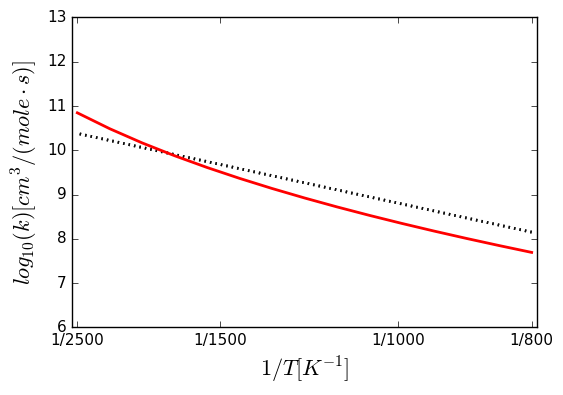


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.07442e-05,'cm^3/(mol*s)'), n=4.46166, Ea=(11.3621,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29848, dn = +|- 0.034279, dEa = +|- 0.188569 kJ/mol""")
GC6H13O2 + H2O2 <=> GC6H13O2H + HO2


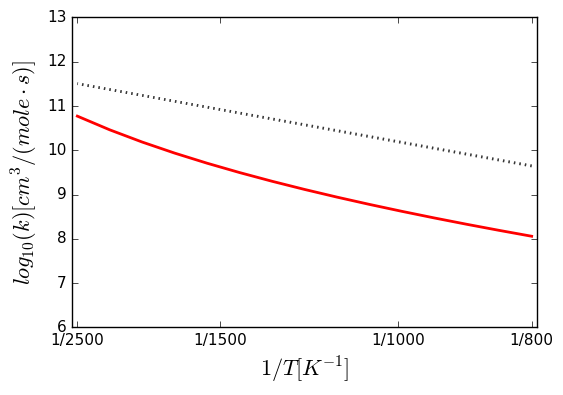


Arrhenius(A=(1.3e+11,'cm^3/(mol*s)'), n=0, Ea=(14070,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.55735e-05,'cm^3/(mol*s)'), n=5.09377, Ea=(-2.60251,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15687, dn = +|- 0.0191237, dEa = +|- 0.1052 kJ/mol""")
CH2-5-cC6H6-13 + HO2 <=> A1CH2 + H2O2


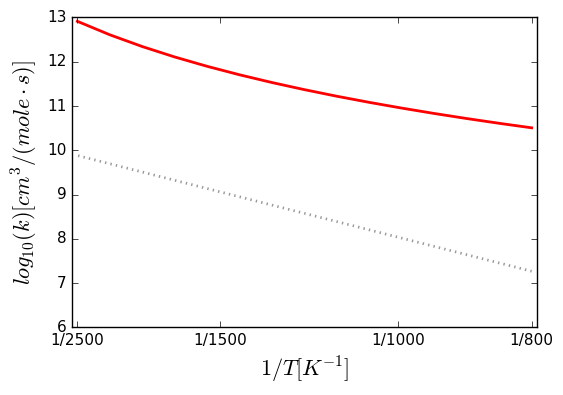


Arrhenius(A=(2.33e+12,'cm^3/(mol*s)'), n=0, Ea=(9817,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(378,'cm^3/(mol*s)'), n=2.72, Ea=(1500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000500778,'cm^3/(mol*s)'), n=4.59301, Ea=(58.4934,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.3249, dn = +|- 0.0369229, dEa = +|- 0.203113 kJ/mol""")
H2O2 + N-C3H7 => HO2 + C3H8


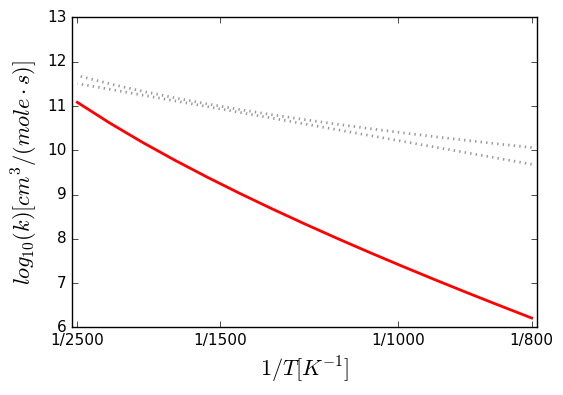


Arrhenius(A=(0.147,'cm^3/(mol*s)'), n=3.87, Ea=(6808,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.147,'cm^3/(mol*s)'), n=3.87, Ea=(6808,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.14e-18,'cm^3/(mol*s)'), n=9.25, Ea=(-2124.76,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.147,'cm^3/(mol*s)'), n=3.87, Ea=(6808,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.147,'cm^3/(mol*s)'), n=3.87, Ea=(6808,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.147,'cm^3/(mol*s)'), n=3.87, Ea=(6808,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.59737e-07,'cm^3/(mol*s)'), n=5.66515, Ea=(55.6936,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.83152, dn = +|- 0.07942, dEa = +|- 0.436889 kJ/mol""")
IC8H18 + CH3 <=> DC8H17 + CH4


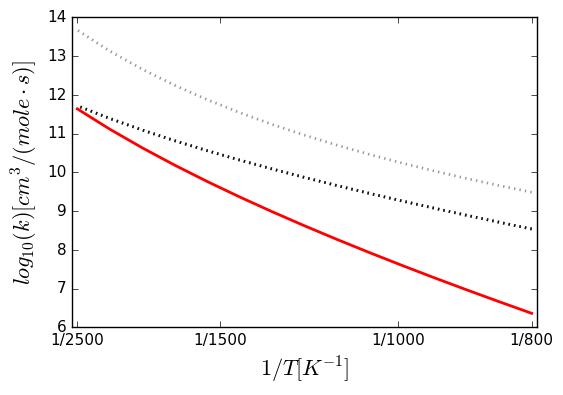


Arrhenius(A=(27050,'cm^3/(mol*s)'), n=2.26, Ea=(7287,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27050,'cm^3/(mol*s)'), n=2.26, Ea=(7287,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27050,'cm^3/(mol*s)'), n=2.26, Ea=(7287,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27100,'cm^3/(mol*s)'), n=2.26, Ea=(7287,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.59737e-07,'cm^3/(mol*s)'), n=5.66515, Ea=(55.6936,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.83152, dn = +|- 0.07942, dEa = +|- 0.436889 kJ/mol""")
IC8H18 + CH3 <=> BC8H17 + CH4


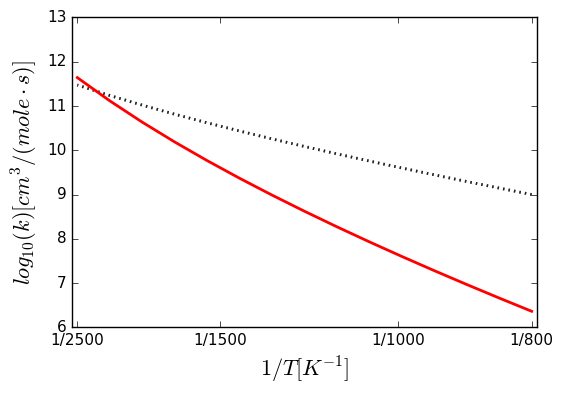


Arrhenius(A=(4.257e-14,'cm^3/(mol*s)'), n=8.06, Ea=(4154,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.257e-14,'cm^3/(mol*s)'), n=8.06, Ea=(4154,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.257e-14,'cm^3/(mol*s)'), n=8.06, Ea=(4154,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.257e-14,'cm^3/(mol*s)'), n=8.06, Ea=(4154,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.26e-14,'cm^3/(mol*s)'), n=8.06, Ea=(4154,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.59737e-07,'cm^3/(mol*s)'), n=5.66515, Ea=(55.6936,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.83152, dn = +|- 0.07942, dEa = +|- 0.436889 kJ/mol""")
IC8H18 + CH3 <=> AC8H17 + CH4


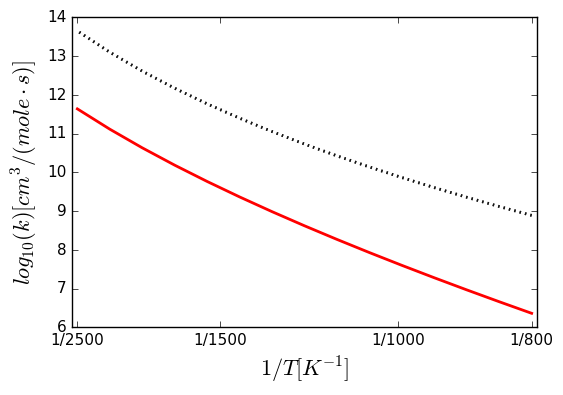


Arrhenius(A=(0.174,'cm^3/(mol*s)'), n=3.87, Ea=(12360,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.59737e-07,'cm^3/(mol*s)'), n=5.66515, Ea=(55.6936,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.83152, dn = +|- 0.07942, dEa = +|- 0.436889 kJ/mol""")
DC8H17 + CH4 <=> IC8H18 + CH3


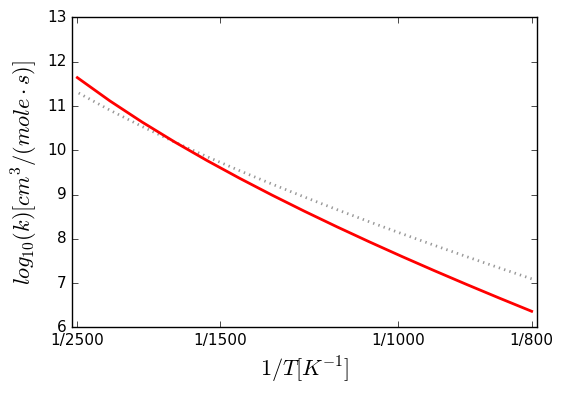


Arrhenius(A=(6.01e-10,'cm^3/(mol*s)'), n=6.36, Ea=(893,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.01e-10,'cm^3/(mol*s)'), n=6.36, Ea=(893,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(351300,'cm^3/(mol*s)'), n=2, Ea=(4871.29,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.01e-10,'cm^3/(mol*s)'), n=6.36, Ea=(893,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.01e-10,'cm^3/(mol*s)'), n=6.36, Ea=(893,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.01e-10,'cm^3/(mol*s)'), n=6.36, Ea=(893,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.59737e-07,'cm^3/(mol*s)'), n=5.66515, Ea=(55.6936,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.83152, dn = +|- 0.07942, dEa = +|- 0.436889 kJ/mol""")
IC8H18 + CH3 <=> CC8H17 + CH4


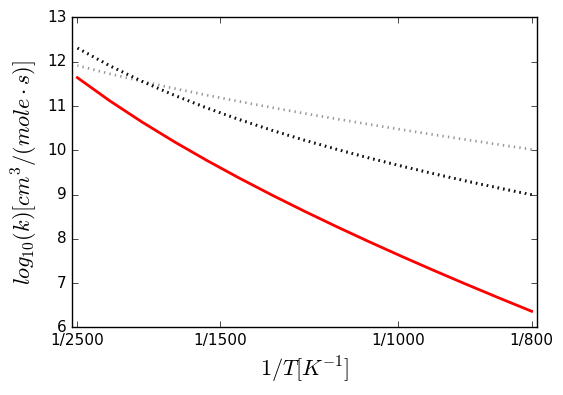


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.09773e-09,'cm^3/(mol*s)'), n=5.99598, Ea=(30.3028,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 3.38873, dn = +|- 0.160174, dEa = +|- 0.881116 kJ/mol""")
c4h7oh1-4 + ho2 <=> c4h6oh1-32 + h2o2


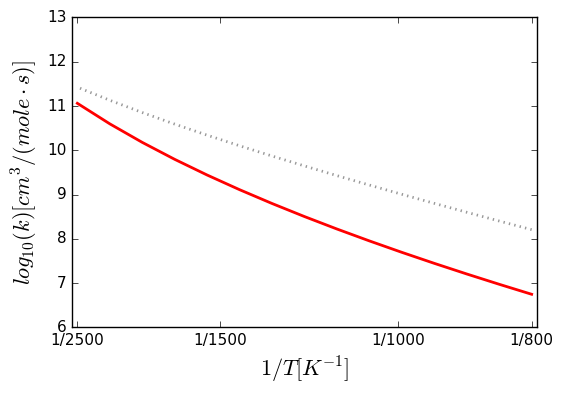


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.79468e-06,'cm^3/(mol*s)'), n=4.55488, Ea=(7.62608,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.35976, dn = +|- 0.0403318, dEa = +|- 0.221865 kJ/mol""")
c7h15oo-6-2 + h2o2 <=> c7h15ooh-6-2 + ho2


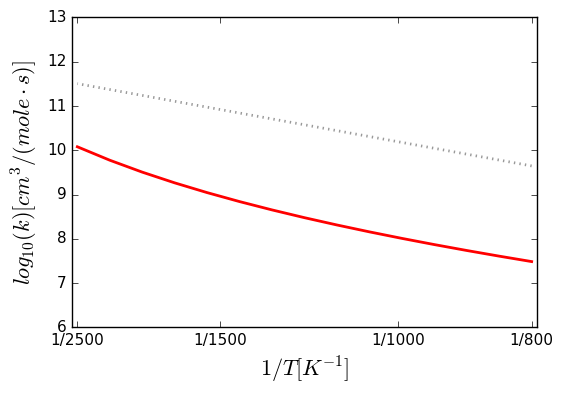


Arrhenius(A=(1.8e+11,'cm^3/(mol*s)'), n=0, Ea=(8226,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8e+11,'cm^3/(mol*s)'), n=0, Ea=(8226,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8e+11,'cm^3/(mol*s)'), n=0, Ea=(8226,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8e+11,'cm^3/(mol*s)'), n=0, Ea=(8226,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8e+11,'cm^3/(mol*s)'), n=0, Ea=(8226,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(108300,'cm^3/(mol*s)'), n=2, Ea=(7876.73,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8e+11,'cm^3/(mol*s)'), n=0, Ea=(8226,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(108300,'cm^3/(mol*s)'), n=2, Ea=(7876.73,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(108300,'cm^3/(mol*s)'), n=2, Ea=(7876.73,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8e+11,'cm^3/(mol*s)'), n=0, Ea=(8226,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8e+11,'cm^3/(mol*s)'), n=0, Ea=(8226,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000356088,'cm^3/(mol*s)'), n=4.44236, Ea=(7.94843,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data poin

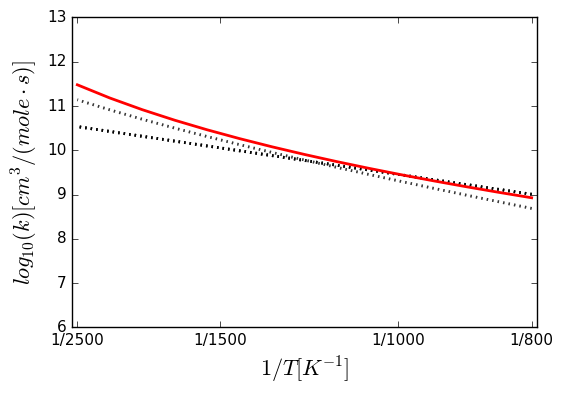


Arrhenius(A=(81.6,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(81.6,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(646500,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(81.6,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00412946,'cm^3/(mol*s)'), n=4.18697, Ea=(64.2101,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17411, dn = +|- 0.0210654, dEa = +|- 0.115881 kJ/mol""")
NEOC5H12 + HO2 <=> NEOC5H11 + H2O2


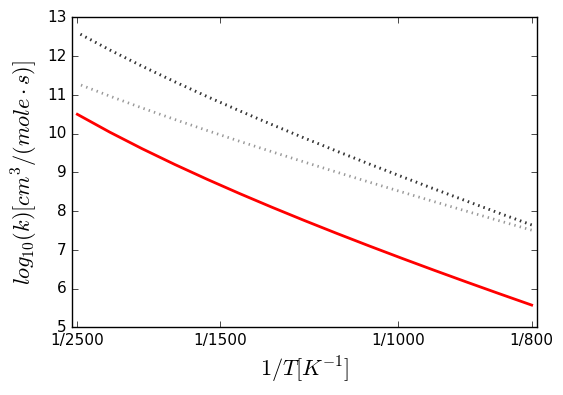


Arrhenius(A=(2.8e+13,'cm^3/(mol*s)'), n=0, Ea=(29932.1,'J/mol'), T0=(1,'K'))
Arrhenius(A=(2.81e+13,'cm^3/(mol*s)'), n=0, Ea=(7352,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.3e+13,'cm^3/(mol*s)'), n=0, Ea=(2900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+13,'cm^3/(mol*s)'), n=0, Ea=(7352,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.81e+13,'cm^3/(mol*s)'), n=0, Ea=(7352,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.3e+13,'cm^3/(mol*s)'), n=0, Ea=(2900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.3e+13,'cm^3/(mol*s)'), n=0, Ea=(5000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.3e+13,'cm^3/(mol*s)'), n=0, Ea=(2900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.767e+06,'cm^3/(mol*s)'), n=2, Ea=(5025.57,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.3e+13,'cm^3/(mol*s)'), n=0, Ea=(2900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.3e+13,'cm^3/(mol*s)'), n=0, Ea=(2900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.3e+13,'cm^3/(mol*s)'), n=0, Ea=(2900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.28e+13,'cm^3/(mol*s)'), n=0, Ea=(2891,'cal/mol'), T0=(1,'K'))
Ar

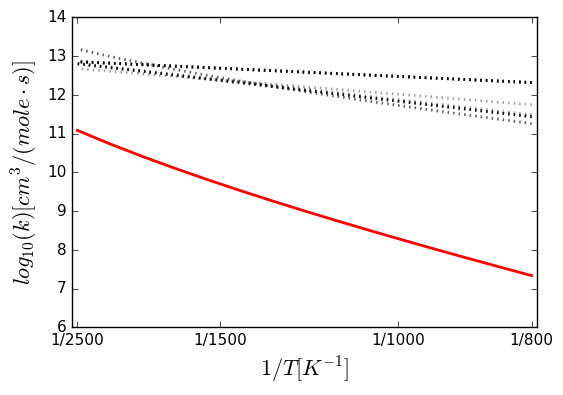


Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(14700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(14700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(14700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55.0211,'cm^3/(mol*s)'), n=3.06012, Ea=(50.3107,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.02334, dn = +|- 0.0030275, dEa = +|- 0.0166543 kJ/mol""")
C6H5OH# + B1O <=> C6H4OH# + R2OH


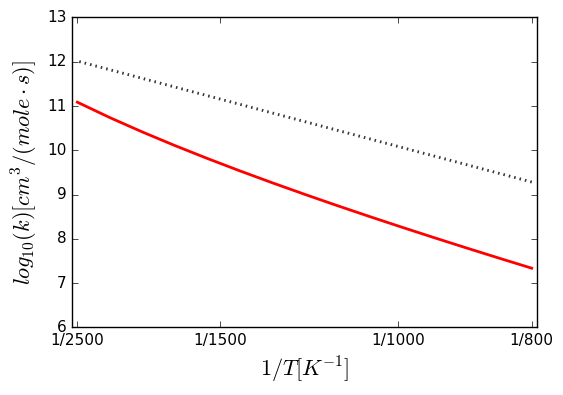


Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(14700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(14700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(14700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(14700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55.0211,'cm^3/(mol*s)'), n=3.06012, Ea=(50.3107,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.02334, dn = +|- 0.0030275, dEa = +|- 0.0166543 kJ/mol""")
c6h5oh + o <=> c6h4oh + oh


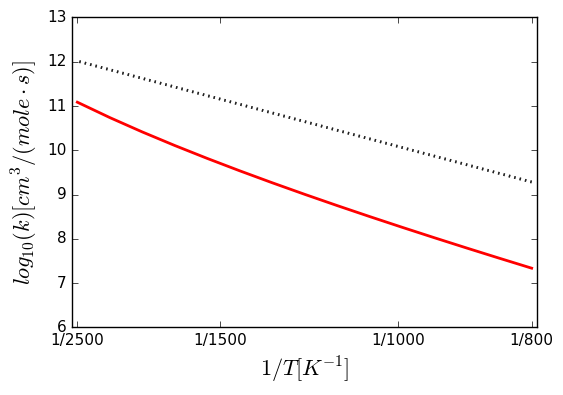


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55.0211,'cm^3/(mol*s)'), n=3.06012, Ea=(50.3107,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.02334, dn = +|- 0.0030275, dEa = +|- 0.0166543 kJ/mol""")
OH + C6H5O => C6H5 + HO2


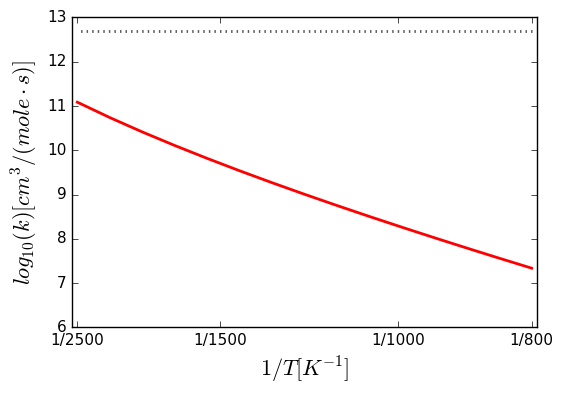


Arrhenius(A=(1.6e+13,'cm^3/(mol*s)'), n=0, Ea=(3400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55.0211,'cm^3/(mol*s)'), n=3.06012, Ea=(50.3107,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.02334, dn = +|- 0.0030275, dEa = +|- 0.0166543 kJ/mol""")
c6h5oh + o <=> oc6h4oh + h


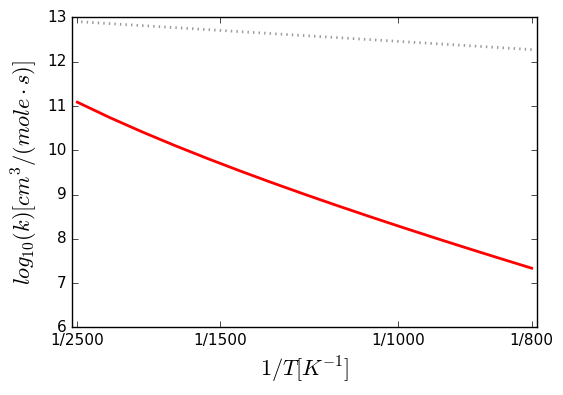


Arrhenius(A=(1.6e+13,'cm^3/(mol*s)'), n=0, Ea=(3400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.6e+13,'cm^3/(mol*s)'), n=0, Ea=(3400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.6e+13,'cm^3/(mol*s)'), n=0, Ea=(3400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55.0211,'cm^3/(mol*s)'), n=3.06012, Ea=(50.3107,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.02334, dn = +|- 0.0030275, dEa = +|- 0.0166543 kJ/mol""")
C6H5OH# + B1O <=> OC6H4OH + R1H


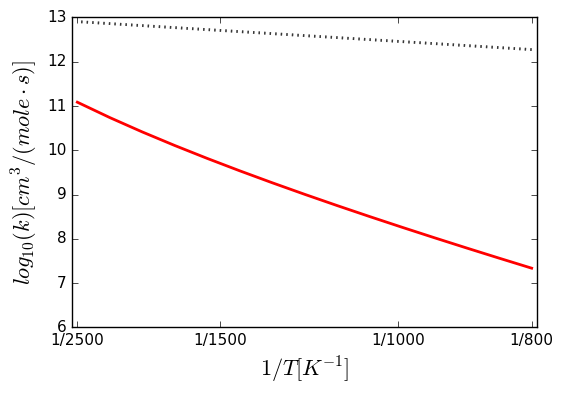


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.37919e-06,'cm^3/(mol*s)'), n=4.85216, Ea=(14.8947,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.48882, dn = +|- 0.052232, dEa = +|- 0.287328 kJ/mol""")
c8h17oo-3-2 + h2o2 <=> c8h17ooh-3-2 + ho2


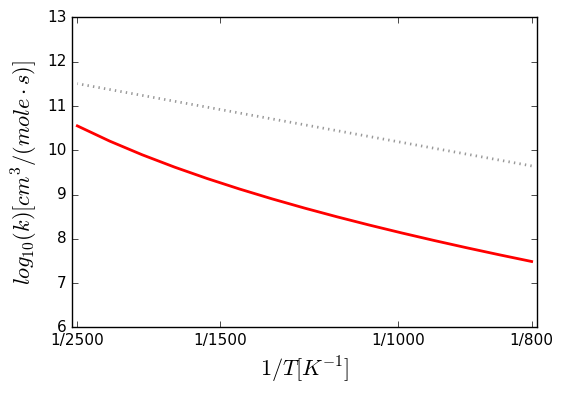


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.37984e-07,'cm^3/(mol*s)'), n=5.34916, Ea=(8.80525,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.25295, dn = +|- 0.0295946, dEa = +|- 0.1628 kJ/mol""")
HC6H13O2 + H2O2 <=> HC6H13O2H + HO2


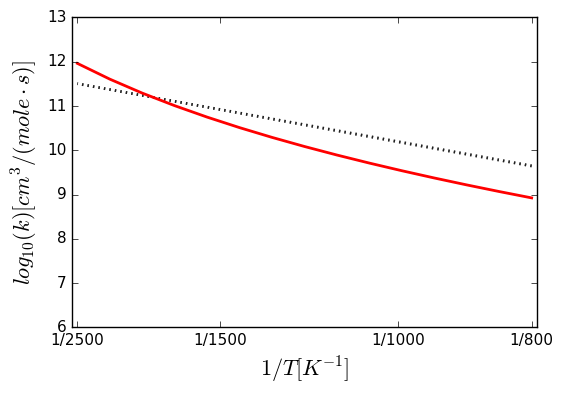


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.17615e-06,'cm^3/(mol*s)'), n=4.79838, Ea=(17.5364,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.59615, dn = +|- 0.0613674, dEa = +|- 0.337582 kJ/mol""")
HO2 + C7H15O2H-4 <=> H2O2 + C7H15O2-4


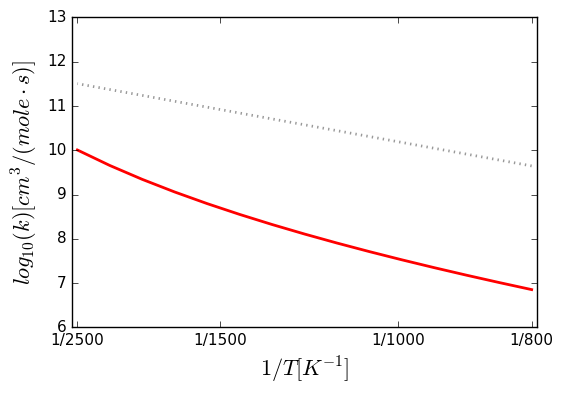


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.17615e-06,'cm^3/(mol*s)'), n=4.79838, Ea=(17.5364,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.59615, dn = +|- 0.0613674, dEa = +|- 0.337582 kJ/mol""")
H2O2 + C7H15O2-4 <=> HO2 + C7H15O2H-4


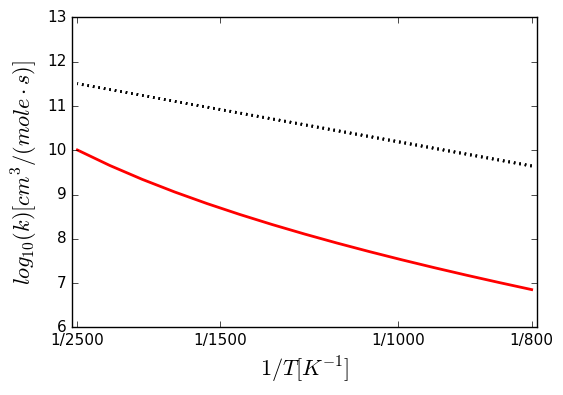


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00381291,'cm^3/(mol*s)'), n=4.10983, Ea=(29.8187,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17374, dn = +|- 0.0210245, dEa = +|- 0.115656 kJ/mol""")
c4h8oh-3 + ho2 <=> c4h8oh-3o + oh


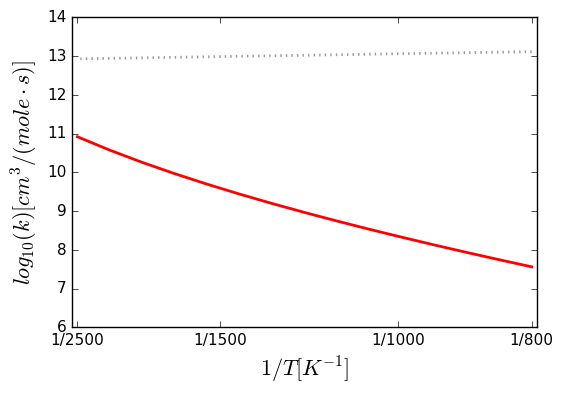


Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K')

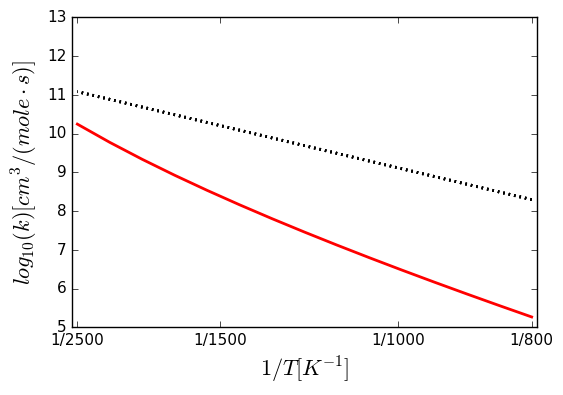


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.09259e-06,'cm^3/(mol*s)'), n=4.63923, Ea=(13.4798,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.4347, dn = +|- 0.0473726, dEa = +|- 0.260597 kJ/mol""")
BC6H13O2 + H2O2 <=> BC6H13O2H + HO2


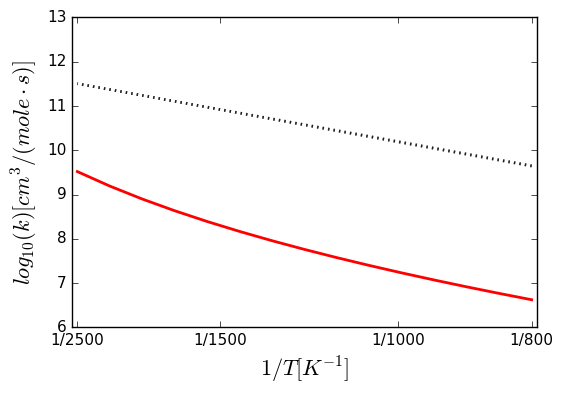


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.77894e-07,'cm^3/(mol*s)'), n=4.75432, Ea=(11.0257,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.50409, dn = +|- 0.053571, dEa = +|- 0.294694 kJ/mol""")
NEOC5H11O2 + H2O2 <=> NEOC5H11O2H + HO2


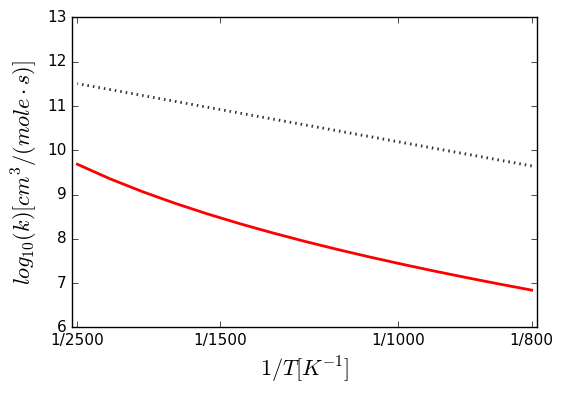


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.37e-05,'cm^3/(mol*s)'), n=4.73114, Ea=(49.8452,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.46573, dn = +|- 0.0501806, dEa = +|- 0.276044 kJ/mol""")
B-EC6H12O + HO2 => BC5H10CHO + H2O2


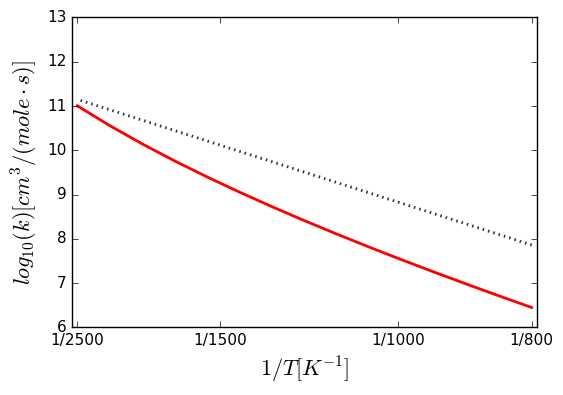


Arrhenius(A=(3.03e+09,'cm^3/(mol*s)'), n=0.16, Ea=(4451,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.93324e-08,'cm^3/(mol*s)'), n=5.57703, Ea=(24.3886,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.57598, dn = +|- 0.124184, dEa = +|- 0.683136 kJ/mol""")
TC3H6COC2H3 + H2O2 <=> IC3H7COC2H3 + HO2


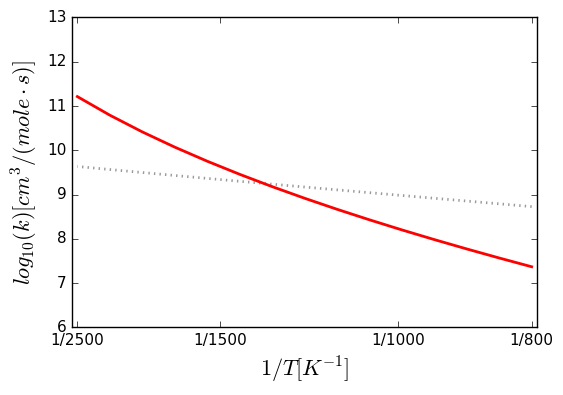


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.08345e-08,'cm^3/(mol*s)'), n=5.36971, Ea=(18.2492,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.89447, dn = +|- 0.0838549, dEa = +|- 0.461286 kJ/mol""")
c7h15oo-4-2 + h2o2 <=> c7h15ooh-4-2 + ho2


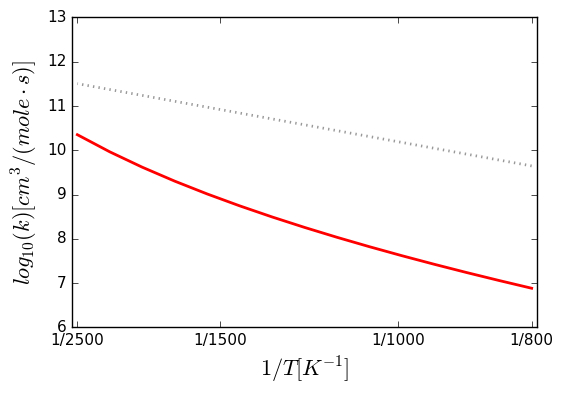


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.15806e-07,'cm^3/(mol*s)'), n=4.77464, Ea=(9.00229,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.48014, dn = +|- 0.0514641, dEa = +|- 0.283104 kJ/mol""")
AC6H13O2 + H2O2 <=> AC6H13O2H + HO2


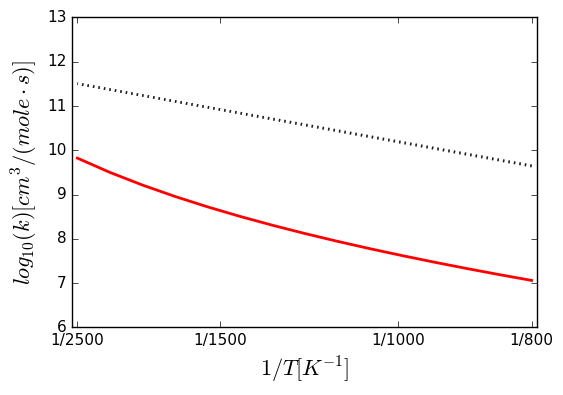


Arrhenius(A=(2e+12,'cm^3/(mol*s)'), n=0, Ea=(17057,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000170319,'cm^3/(mol*s)'), n=4.61962, Ea=(12.6354,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.60068, dn = +|- 0.0617396, dEa = +|- 0.33963 kJ/mol""")
THP-2-4-ene + HO2 <=> THP-5yl + H2O2


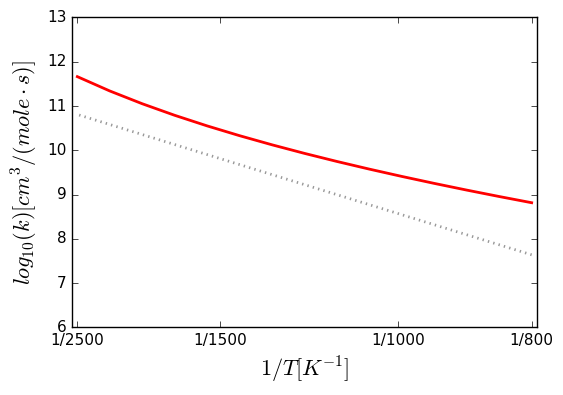


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0110728,'cm^3/(mol*s)'), n=3.66775, Ea=(-5.97661,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.04442, dn = +|- 0.00570363, dEa = +|- 0.0313757 kJ/mol""")
mb2ooh + ho2 => mb2oo + h2o2


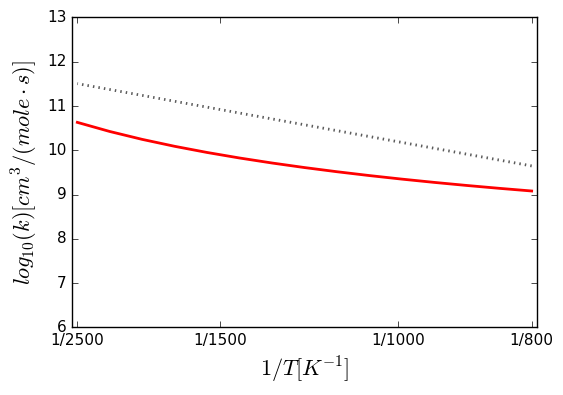


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0110728,'cm^3/(mol*s)'), n=3.66775, Ea=(-5.97661,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.04442, dn = +|- 0.00570363, dEa = +|- 0.0313757 kJ/mol""")
mb2oo + h2o2 => mb2ooh + ho2


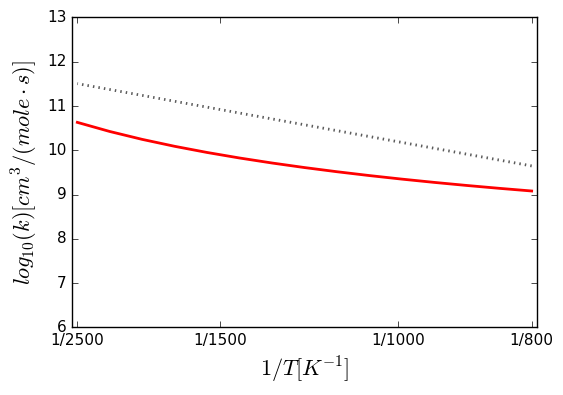


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.60963e-06,'cm^3/(mol*s)'), n=4.84371, Ea=(7.70266,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.69702, dn = +|- 0.06941, dEa = +|- 0.381825 kJ/mol""")
MCH14DIEN + HO2 <=> MCH14N6J + H2O2


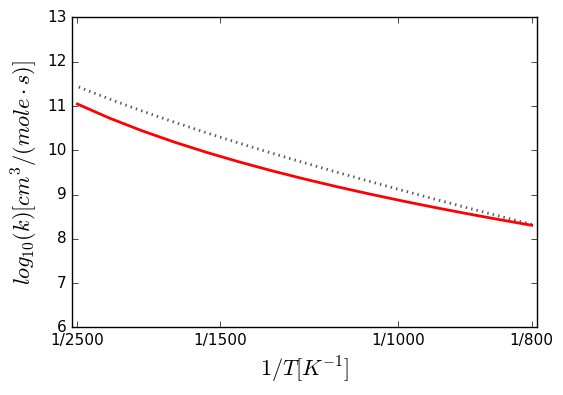


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.60963e-06,'cm^3/(mol*s)'), n=4.84371, Ea=(7.70266,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.69702, dn = +|- 0.06941, dEa = +|- 0.381825 kJ/mol""")
MCH14DIEN + HO2 <=> MCH14N3J + H2O2


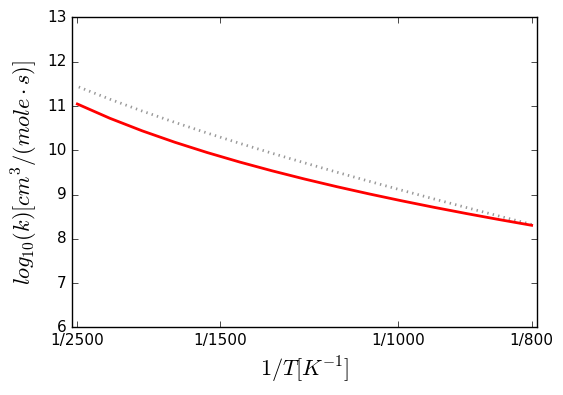


Arrhenius(A=(9490,'cm^3/(mol*s)'), n=2.6, Ea=(13862.3,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9490,'cm^3/(mol*s)'), n=2.6, Ea=(13862.3,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.60963e-06,'cm^3/(mol*s)'), n=4.84371, Ea=(7.70266,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.69702, dn = +|- 0.06941, dEa = +|- 0.381825 kJ/mol""")
MCH14DIEN + HO2 <=> MCH14NCH2J + H2O2


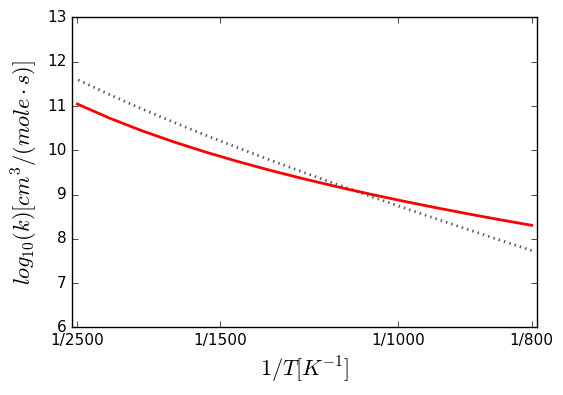


Arrhenius(A=(1.32e+07,'cm^3/(mol*s)'), n=1.49, Ea=(10540,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.08521e-08,'cm^3/(mol*s)'), n=5.84966, Ea=(39.8384,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.55771, dn = +|- 0.0581684, dEa = +|- 0.319985 kJ/mol""")
IC3H7COCH2 + H2O2 <=> IC3H7COCH3 + HO2


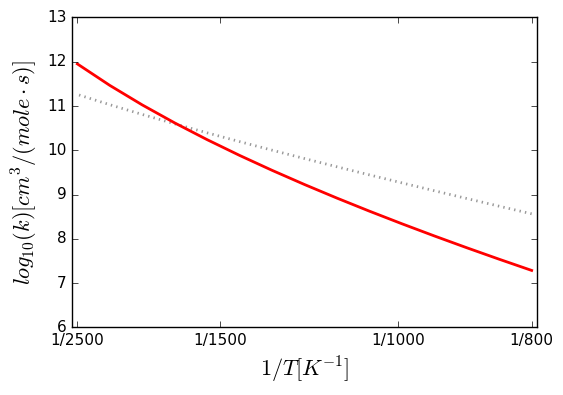


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.09072e-05,'cm^3/(mol*s)'), n=4.66259, Ea=(9.1018,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.42151, dn = +|- 0.0461599, dEa = +|- 0.253926 kJ/mol""")
c8h17oo-7-2 + h2o2 <=> c8h17ooh-7-2 + ho2


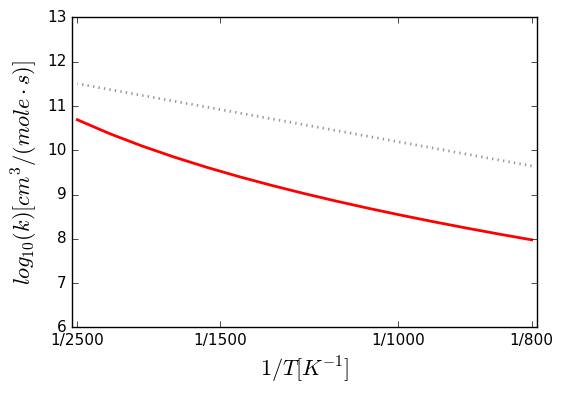


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.22598e-05,'cm^3/(mol*s)'), n=4.58088, Ea=(37.5284,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.39751, dn = +|- 0.0439249, dEa = +|- 0.241631 kJ/mol""")
A-DC6H12O + HO2 => IC3H6CH2COCH3 + H2O2


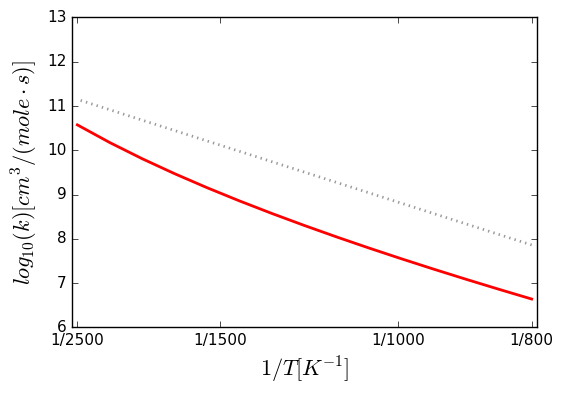


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.22598e-05,'cm^3/(mol*s)'), n=4.58088, Ea=(37.5284,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.39751, dn = +|- 0.0439249, dEa = +|- 0.241631 kJ/mol""")
A-DC6H12O + HO2 => C5H10CHO4-2 + H2O2


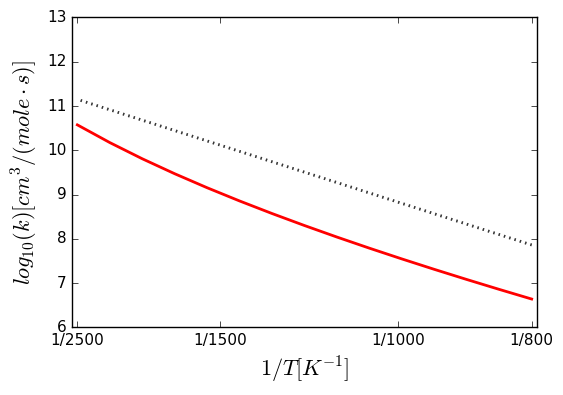


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.22598e-05,'cm^3/(mol*s)'), n=4.58088, Ea=(37.5284,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.39751, dn = +|- 0.0439249, dEa = +|- 0.241631 kJ/mol""")
A-DC6H12O + HO2 => IC3H6CH2COCH3 + H2O2


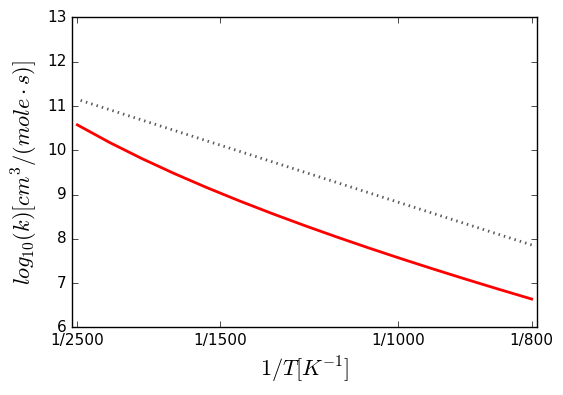


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000270086,'cm^3/(mol*s)'), n=4.5702, Ea=(61.2541,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33568, dn = +|- 0.0379865, dEa = +|- 0.208964 kJ/mol""")
CC5H11 + HO2 <=> CC5H11O + OH


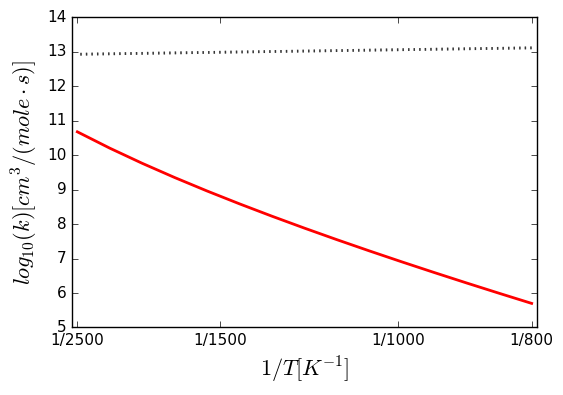


Arrhenius(A=(187000,'cm^3/(mol*s)'), n=2.5, Ea=(14684.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.63902e-07,'cm^3/(mol*s)'), n=5.21988, Ea=(26.463,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.97486, dn = +|- 0.0893089, dEa = +|- 0.491288 kJ/mol""")
A1CH3CH3 + HO2 <=> A1CH3CH2 + H2O2


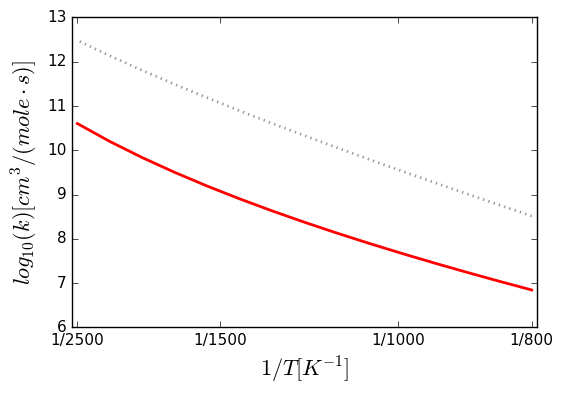


Arrhenius(A=(14460,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(10830,'cm^3/(mol*s)'), n=2.55, Ea=(10532,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.36e-05,'cm^3/(mol*s)'), n=5.04, Ea=(15275.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.3672e-09,'cm^3/(mol*s)'), n=6.07812, Ea=(55.5281,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.78093, dn = +|- 0.0757438, dEa = +|- 0.416667 kJ/mol""")
ch3cooch3 + ho2 <=> ch2cooch3 + h2o2


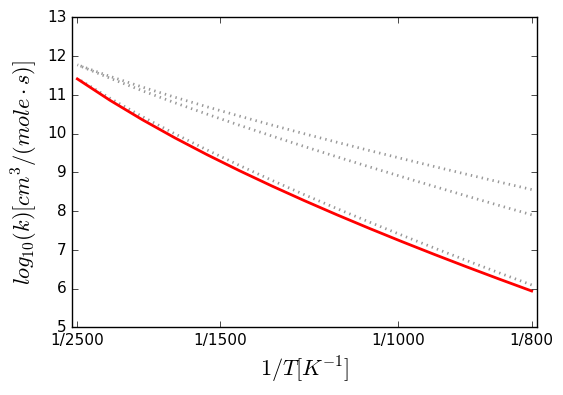


Arrhenius(A=(14460,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40400,'cm^3/(mol*s)'), n=2.5, Ea=(16690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.46e-06,'cm^3/(mol*s)'), n=5.53, Ea=(13717.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.3672e-09,'cm^3/(mol*s)'), n=6.07812, Ea=(55.5281,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.78093, dn = +|- 0.0757438, dEa = +|- 0.416667 kJ/mol""")
ch3cooch3 + ho2 <=> ch3cooch2 + h2o2


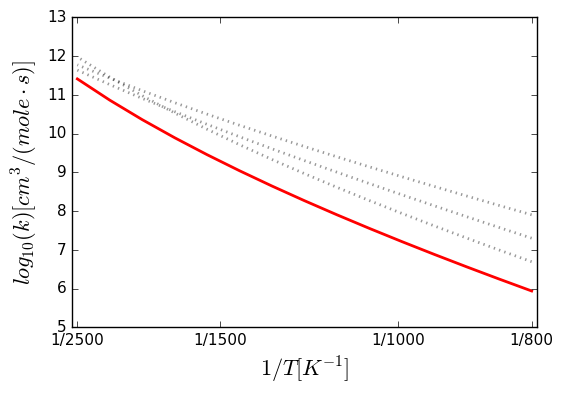


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00111181,'cm^3/(mol*s)'), n=4.21999, Ea=(7.0632,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29891, dn = +|- 0.0343227, dEa = +|- 0.188809 kJ/mol""")
NC4H9CO + H2O2 <=> NC4H9CHO + HO2


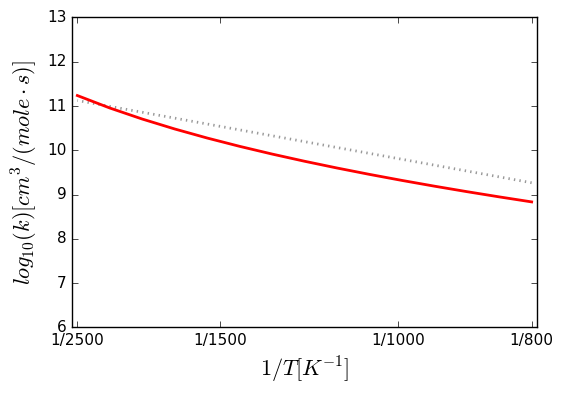


Arrhenius(A=(82.8,'cm^3/(mol*s)'), n=2.78, Ea=(3004,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000338218,'cm^3/(mol*s)'), n=4.08983, Ea=(-1.06047,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.16691, dn = +|- 0.0202586, dEa = +|- 0.111443 kJ/mol""")
TC3H6CH2CHO + H2O2 <=> IC4H9CHO + HO2


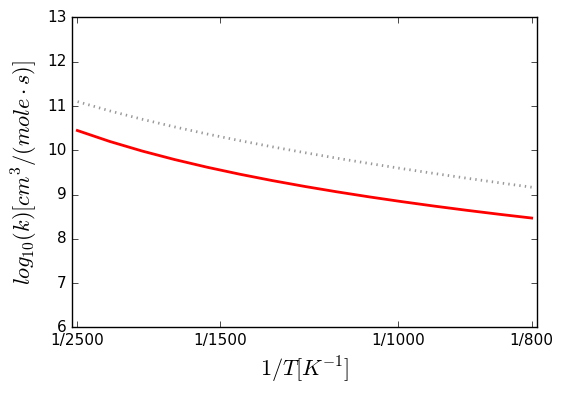


Arrhenius(A=(0.000138,'cm^3/(mol*s)'), n=4.95, Ea=(15343,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000282731,'cm^3/(mol*s)'), n=4.50922, Ea=(35.0027,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.37477, dn = +|- 0.0417724, dEa = +|- 0.22979 kJ/mol""")
C4H10O + HO2 <=> C4H9Oa + H2O2


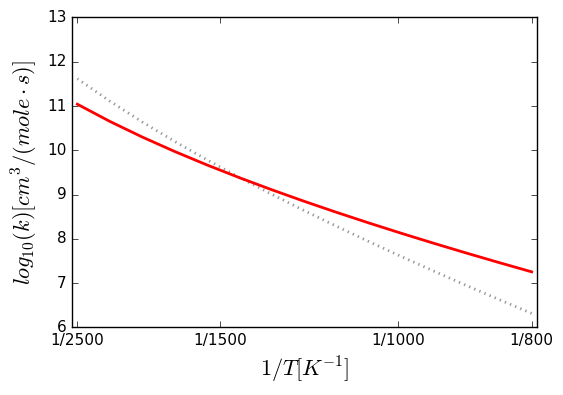


Arrhenius(A=(0.724,'cm^3/(mol*s)'), n=3.98, Ea=(9058,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000282731,'cm^3/(mol*s)'), n=4.50922, Ea=(35.0027,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.37477, dn = +|- 0.0417724, dEa = +|- 0.22979 kJ/mol""")
C4H10O + HO2 <=> C4H9Ob + H2O2


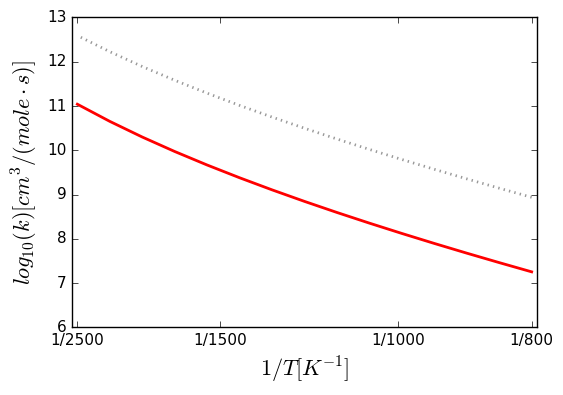


Arrhenius(A=(55200,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55200,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55200,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00839855,'cm^3/(mol*s)'), n=4.13232, Ea=(47.6358,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15359, dn = +|- 0.0187512, dEa = +|- 0.10315 kJ/mol""")
IC6H13CHO-B + HO2 <=> AC6H12CHO-B + H2O2


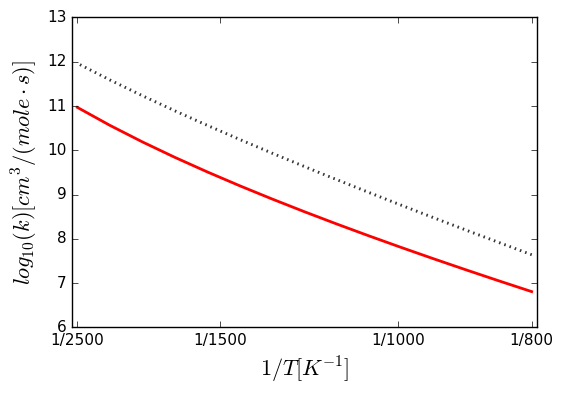


Arrhenius(A=(24750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(24750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(24750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00839855,'cm^3/(mol*s)'), n=4.13232, Ea=(47.6358,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15359, dn = +|- 0.0187512, dEa = +|- 0.10315 kJ/mol""")
IC6H13CHO-B + HO2 <=> CC6H12CHO-B + H2O2


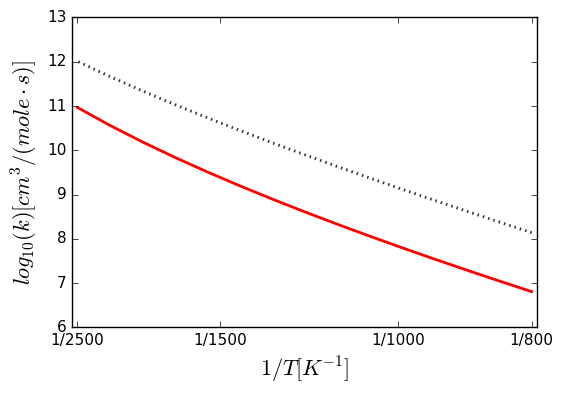


Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00839855,'cm^3/(mol*s)'), n=4.13232, Ea=(47.6358,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15359, dn = +|- 0.0187512, dEa = +|- 0.10315 kJ/mol""")
IC6H13CHO-B + HO2 <=> EC6H12CHO-B + H2O2


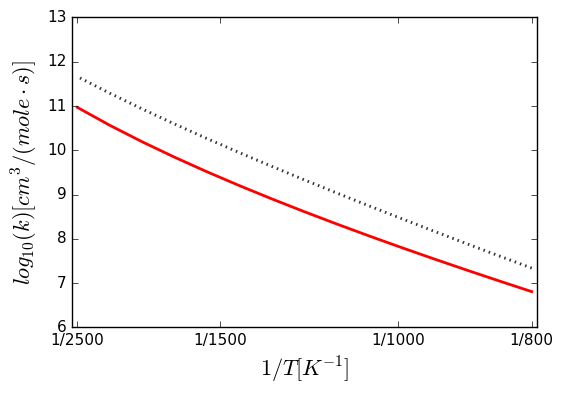


Arrhenius(A=(24750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(24750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(24750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00839855,'cm^3/(mol*s)'), n=4.13232, Ea=(47.6358,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15359, dn = +|- 0.0187512, dEa = +|- 0.10315 kJ/mol""")
IC6H13CHO-B + HO2 <=> DC6H12CHO-B + H2O2


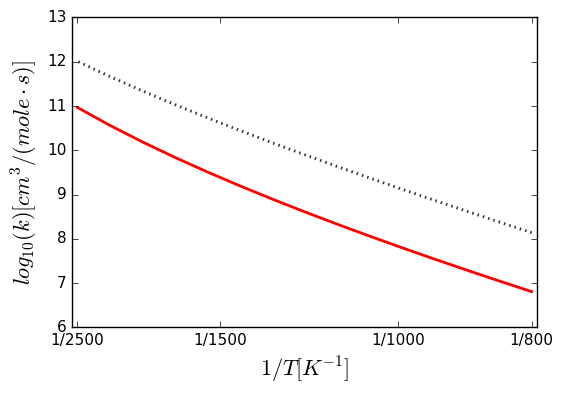


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00839855,'cm^3/(mol*s)'), n=4.13232, Ea=(47.6358,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15359, dn = +|- 0.0187512, dEa = +|- 0.10315 kJ/mol""")
IC6H13CHO-B + HO2 <=> IC6H13CO-B + H2O2


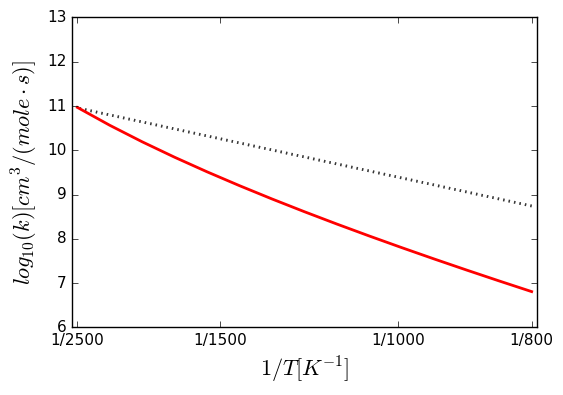


Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.99236e-08,'cm^3/(mol*s)'), n=5.4303, Ea=(15.2963,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.27187, dn = +|- 0.107697, dEa = +|- 0.592439 kJ/mol""")
ch3chchoh + ho2 <=> c2h5cho + ho2


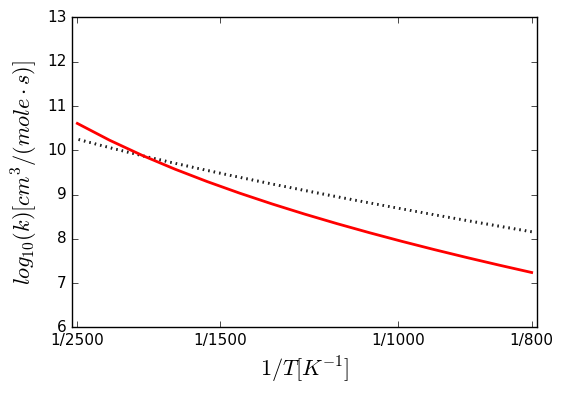


Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01179e-07,'cm^3/(mol*s)'), n=5.52332, Ea=(22.6731,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.3178, dn = +|- 0.110324, dEa = +|- 0.606892 kJ/mol""")
BC5H10 + HO2 <=> CC5H9-B + H2O2


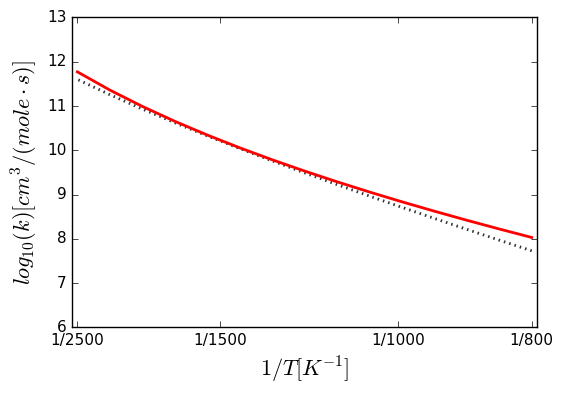


Arrhenius(A=(19280,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(19280,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(19280,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01179e-07,'cm^3/(mol*s)'), n=5.52332, Ea=(22.6731,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.3178, dn = +|- 0.110324, dEa = +|- 0.606892 kJ/mol""")
BC5H10 + HO2 <=> AC5H9-C + H2O2


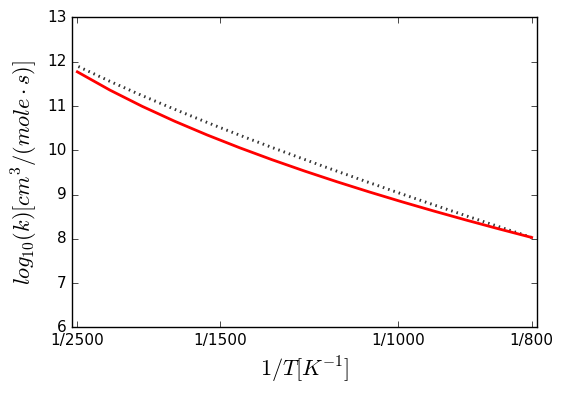


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.89254e-09,'cm^3/(mol*s)'), n=5.53061, Ea=(19.8897,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.50728, dn = +|- 0.120637, dEa = +|- 0.663623 kJ/mol""")
mf25oh + ho2 <=> mf25oj + h2o2


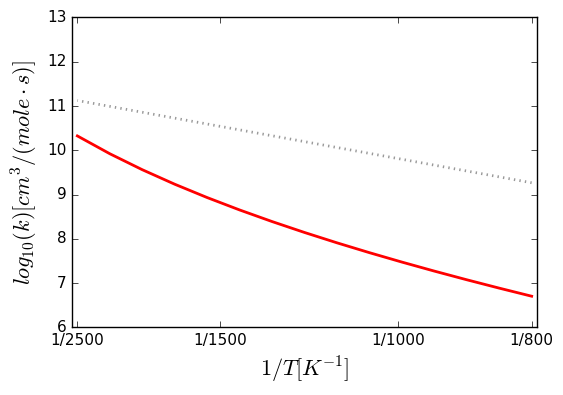


Arrhenius(A=(29300,'cm^3/(mol*s)'), n=2.21, Ea=(4462,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0917105,'cm^3/(mol*s)'), n=3.76595, Ea=(-2.8594,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.02579, dn = +|- 0.00334231, dEa = +|- 0.018386 kJ/mol""")
C4H8COCH3-1 + H2O2 <=> NC4H9COCH3 + HO2


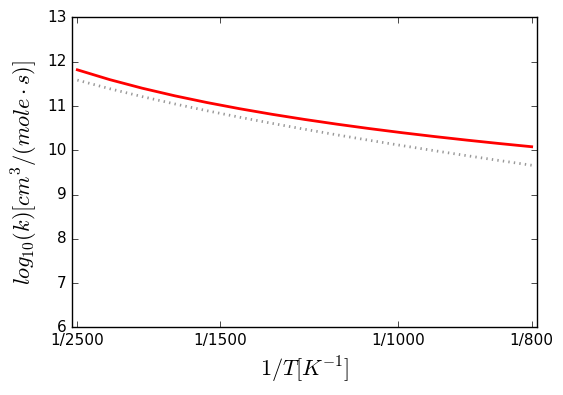


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.195634,'cm^3/(mol*s)'), n=3.77914, Ea=(56.6015,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06036, dn = +|- 0.00769218, dEa = +|- 0.0423147 kJ/mol""")
B-CC6H12O + HO2 => TC3H6COC2H5 + H2O2


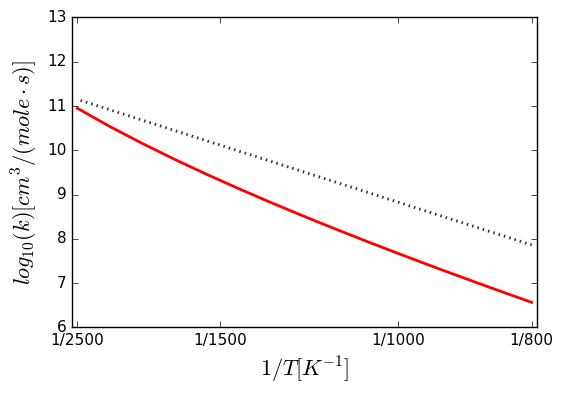


Arrhenius(A=(13600,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(12800,'cm^3/(mol*s)'), n=2.6, Ea=(12400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13600,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.5677e-06,'cm^3/(mol*s)'), n=4.91083, Ea=(7.94989,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.72048, dn = +|- 0.0712117, dEa = +|- 0.391736 kJ/mol""")
CHD14 + HO2 <=> C6H7C + H2O2


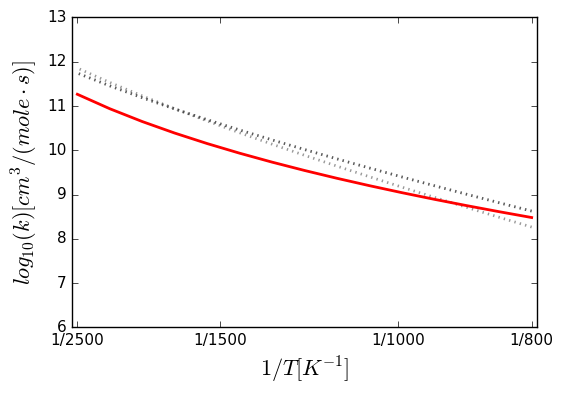


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000236831,'cm^3/(mol*s)'), n=4.28195, Ea=(42.6311,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17079, dn = +|- 0.0206938, dEa = +|- 0.113836 kJ/mol""")
HO2 + C7H15O2H-1 <=> H2O2 + C7H15O2-1


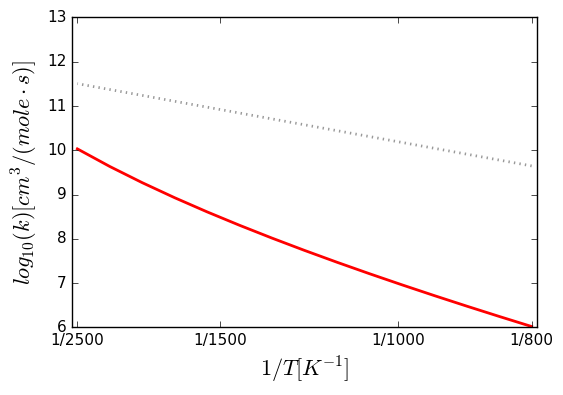


Arrhenius(A=(1.3e+15,'cm^3/(mol*s)'), n=-1.07, Ea=(9530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.3e+15,'cm^3/(mol*s)'), n=-1.07, Ea=(9530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.3e+15,'cm^3/(mol*s)'), n=-1.07, Ea=(9530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.3e+15,'cm^3/(mol*s)'), n=-1.07, Ea=(9530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.7355e-08,'cm^3/(mol*s)'), n=5.5772, Ea=(16.9238,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.51468, dn = +|- 0.121024, dEa = +|- 0.665751 kJ/mol""")
c5h6 + ho2 <=> c5h7 + o2


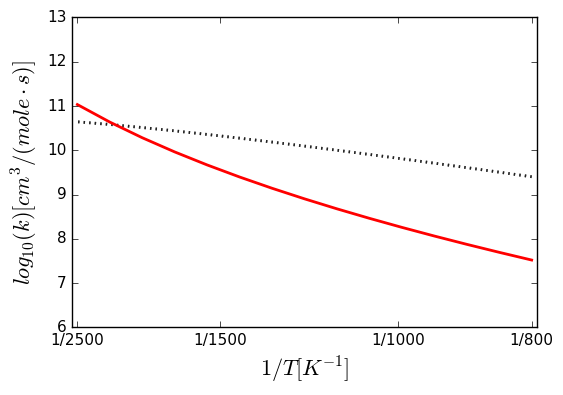


Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.7355e-08,'cm^3/(mol*s)'), n=5.5772, Ea=(16.9238,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.51468, dn = +|- 0.121024, dEa = +|- 0.665751 kJ/mol""")
C5H6 + HO2 <=> C5H5 + H2O2


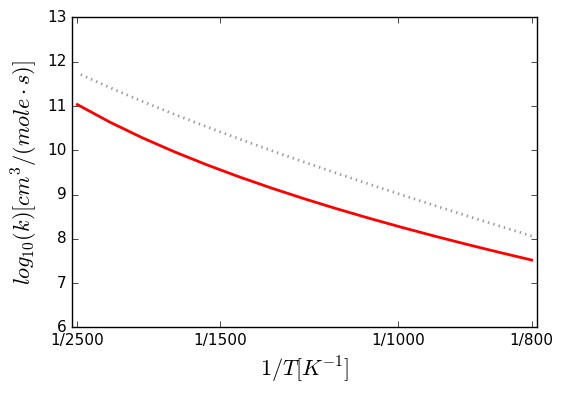


Arrhenius(A=(2e+12,'cm^3/(mol*s)'), n=0, Ea=(48781,'J/mol'), T0=(1,'K'))
Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+12,'cm^3/(mol*s)'), n=0, Ea=(15900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12899.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(538800,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+12,'cm^3/(mol*s)'), n=0, Ea=(11660,'cal/mol'), T0=(1,'K'))
Arr

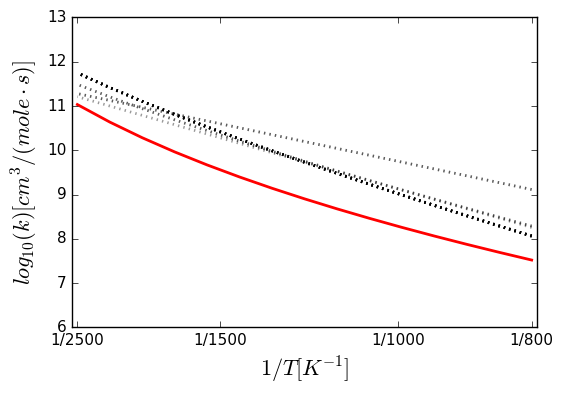


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.54687e-08,'cm^3/(mol*s)'), n=5.56618, Ea=(13.9096,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.06984, dn = +|- 0.095474, dEa = +|- 0.525203 kJ/mol""")
c8h17oo-1-2 + h2o2 <=> c8h17ooh-1-2 + ho2


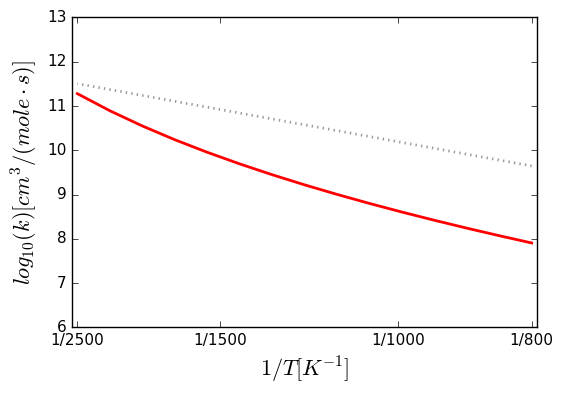


Arrhenius(A=(4.51e+06,'cm^3/(mol*s)'), n=2, Ea=(11350,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.10829e-08,'cm^3/(mol*s)'), n=5.60171, Ea=(23.6948,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.80177, dn = +|- 0.135211, dEa = +|- 0.743796 kJ/mol""")
C4H8CHO-4 + H2O2 <=> NC4H9CHO + HO2


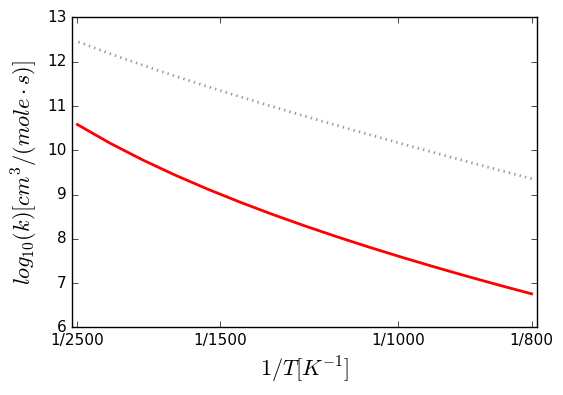


Arrhenius(A=(6.99e+12,'cm^3/(mol*s)'), n=-0.51, Ea=(11160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.35645e-07,'cm^3/(mol*s)'), n=5.13562, Ea=(25.3145,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.19199, dn = +|- 0.102999, dEa = +|- 0.566597 kJ/mol""")
TC3H6COC2H5 + H2O2 <=> IC3H7COC2H5 + HO2


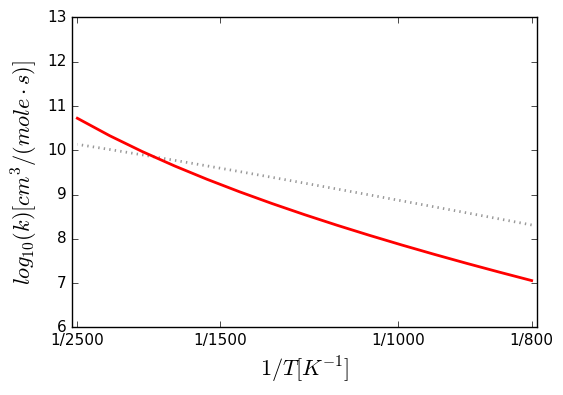


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0380762,'cm^3/(mol*s)'), n=3.28063, Ea=(4.33353,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.16007, dn = +|- 0.0194865, dEa = +|- 0.107195 kJ/mol""")
sc4h8oh-2o2 + h2o2 <=> sc4h8oh-2o2h + ho2


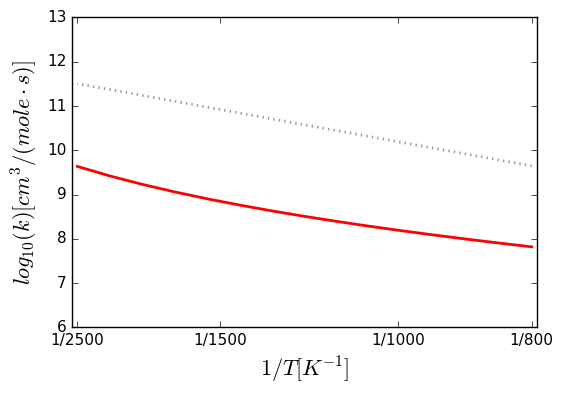


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000430897,'cm^3/(mol*s)'), n=3.99537, Ea=(3.58674,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.07101, dn = +|- 0.00900326, dEa = +|- 0.049527 kJ/mol""")
sc4h8oh-1o2 + h2o2 <=> sc4h8oh-1o2h + ho2


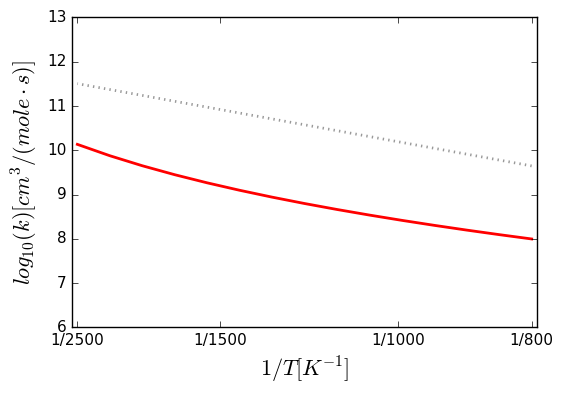


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.1841e-08,'cm^3/(mol*s)'), n=5.69229, Ea=(16.1288,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.4559, dn = +|- 0.0492977, dEa = +|- 0.271187 kJ/mol""")
c8h17oo-5-2 + h2o2 <=> c8h17ooh-5-2 + ho2


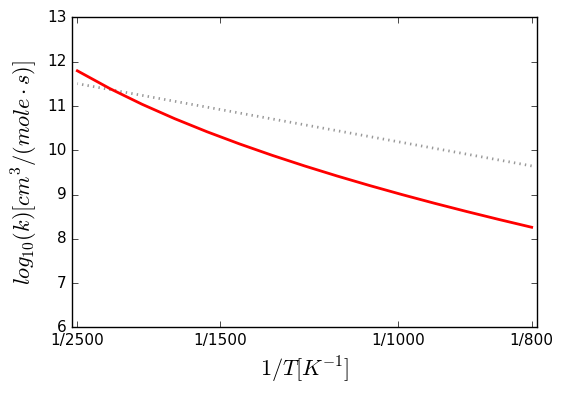


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(2000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00011437,'cm^3/(mol*s)'), n=4.80507, Ea=(54.4362,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.49662, dn = +|- 0.0529178, dEa = +|- 0.291101 kJ/mol""")
THP-2-yl + HO2 <=> THP-2-ene + H2O2


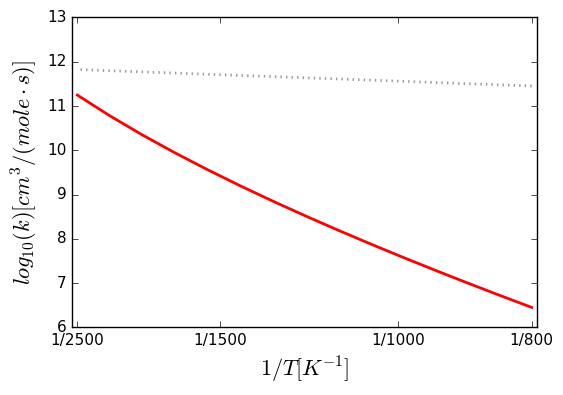


Arrhenius(A=(1.98,'cm^3/(mol*s)'), n=3.78, Ea=(12335,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.92672e-10,'cm^3/(mol*s)'), n=6.47717, Ea=(20.3369,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.38677, dn = +|- 0.114172, dEa = +|- 0.628061 kJ/mol""")
dmf25 + ho2 <=> dmf252j + h2o2


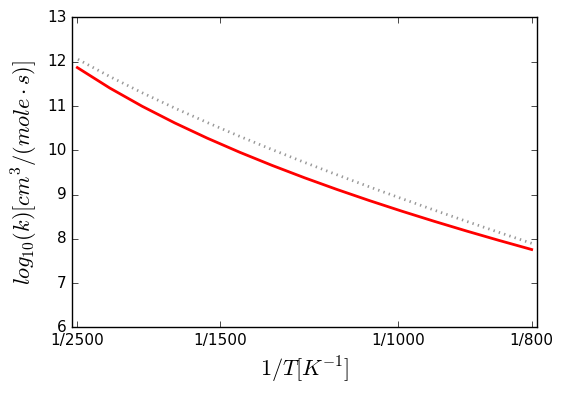


Arrhenius(A=(5.5e+12,'cm^3/(mol*s)'), n=0, Ea=(28900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.92672e-10,'cm^3/(mol*s)'), n=6.47717, Ea=(20.3369,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.38677, dn = +|- 0.114172, dEa = +|- 0.628061 kJ/mol""")
dmf25 + ho2 <=> dmf253j + h2o2


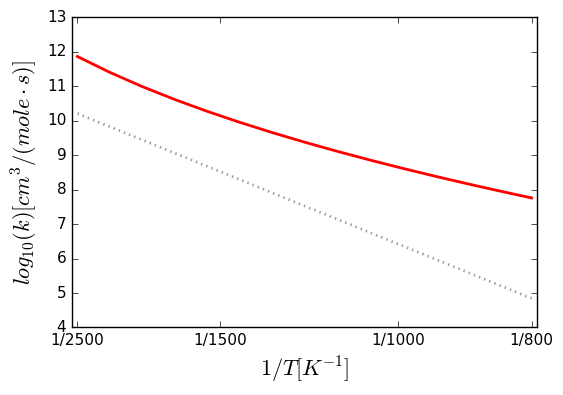


Arrhenius(A=(1.118e+13,'cm^3/(mol*s)'), n=-0.37, Ea=(2988.05,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.3798e-08,'cm^3/(mol*s)'), n=5.33619, Ea=(25.1757,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.10371, dn = +|- 0.0976042, dEa = +|- 0.536921 kJ/mol""")
C2H5COCH2 + HO2 => C2H5COCH3 + O2


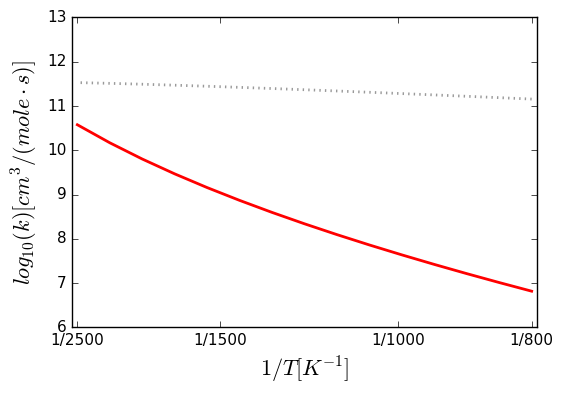


PDepArrhenius(pressures=([0.001,0.01,0.1,1,10,50,100],'atm'), arrhenius=[Arrhenius(A=(1.802e+17,'cm^3/(mol*s)'), n=-1.42, Ea=(987.3,'cal/mol'), T0=(1,'K')), Arrhenius(A=(9.653e+17,'cm^3/(mol*s)'), n=-1.624, Ea=(1480.1,'cal/mol'), T0=(1,'K')), Arrhenius(A=(3.425e+20,'cm^3/(mol*s)'), n=-2.33, Ea=(3456.6,'cal/mol'), T0=(1,'K')), Arrhenius(A=(3.364e+25,'cm^3/(mol*s)'), n=-3.695, Ea=(7858.8,'cal/mol'), T0=(1,'K')), Arrhenius(A=(1.661e+29,'cm^3/(mol*s)'), n=-4.649, Ea=(12875,'cal/mol'), T0=(1,'K')), Arrhenius(A=(1.031e+28,'cm^3/(mol*s)'), n=-4.236, Ea=(14801.6,'cal/mol'), T0=(1,'K')), Arrhenius(A=(8.168e+25,'cm^3/(mol*s)'), n=-3.62, Ea=(14669.2,'cal/mol'), T0=(1,'K'))])
Arrhenius(A=(1.667e+12,'cm^3/(mol*s)'), n=0.269, Ea=(-687.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.3798e-08,'cm^3/(mol*s)'), n=5.33619, Ea=(25.1757,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.10371, dn = +|- 0.0976042, dEa = +|- 0.536921 kJ/mol""")
C2H5COCH2 + HO

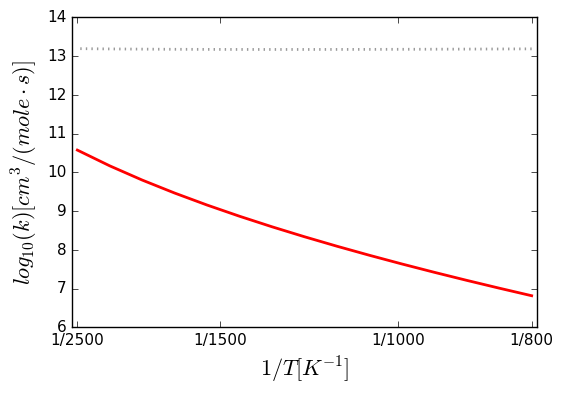


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0171532,'cm^3/(mol*s)'), n=4.13621, Ea=(51.4303,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15337, dn = +|- 0.0187263, dEa = +|- 0.103013 kJ/mol""")
A-CC6H12O + HO2 => IC3H6COC2H5 + H2O2


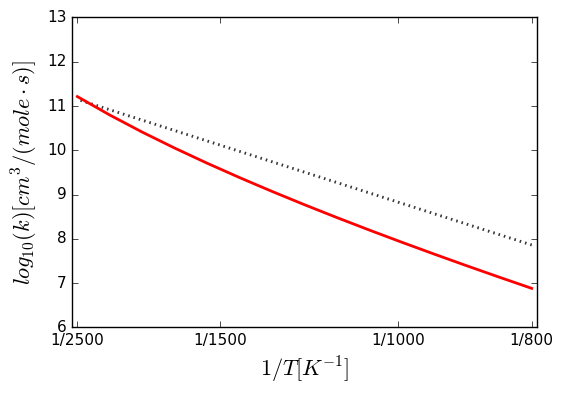


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0171532,'cm^3/(mol*s)'), n=4.13621, Ea=(51.4303,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15337, dn = +|- 0.0187263, dEa = +|- 0.103013 kJ/mol""")
A-CC6H12O + HO2 => C5H10CHO3-2 + H2O2


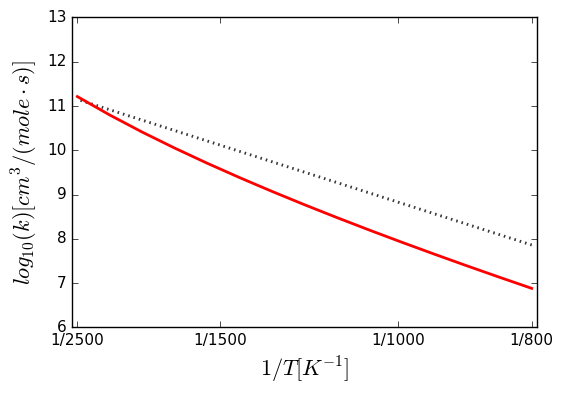


Arrhenius(A=(1.636e+11,'cm^3/(mol*s)'), n=0, Ea=(12583,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.19014e-08,'cm^3/(mol*s)'), n=5.60643, Ea=(21.3075,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.63441, dn = +|- 0.127128, dEa = +|- 0.69933 kJ/mol""")
C6H101-5 + HO2 <=> C6H9 + H2O2


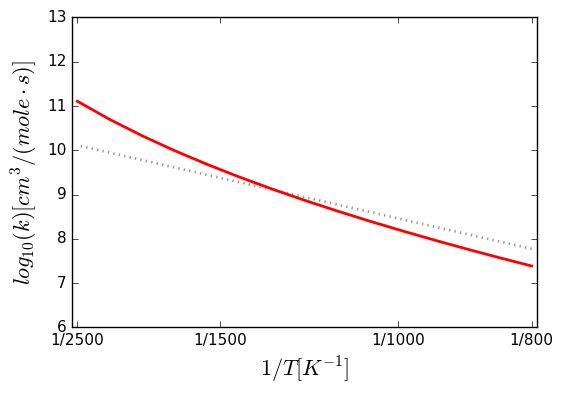


Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mo

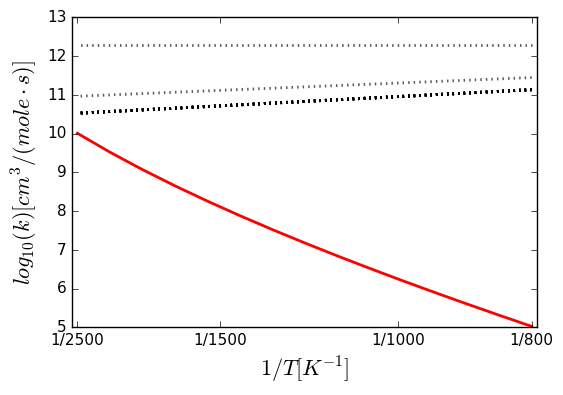


Arrhenius(A=(3.79e+11,'cm^3/(mol*s)'), n=0.03, Ea=(8148,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.44774e-06,'cm^3/(mol*s)'), n=4.48985, Ea=(5.98104,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.52922, dn = +|- 0.0557455, dEa = +|- 0.306656 kJ/mol""")
BC8H17 + H2O2 <=> IC8H18 + HO2


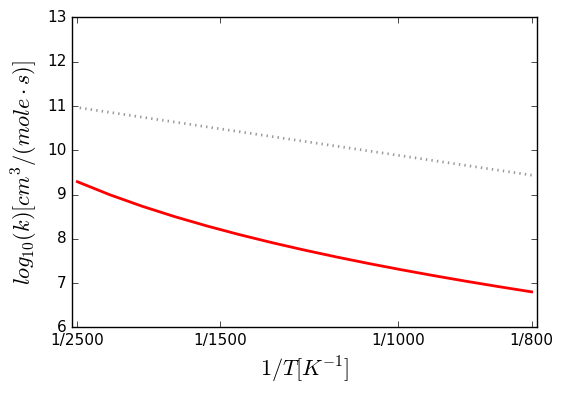


Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(-2600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.37e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.40195e-10,'cm^3/(mol*s)'), n=5.99114, Ea=(23.2567,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.93552, dn = +|- 0.141332, dEa = +|- 0.777465 kJ/mol""")
C3H5OO + HO2 => O2 + C3H5OOH


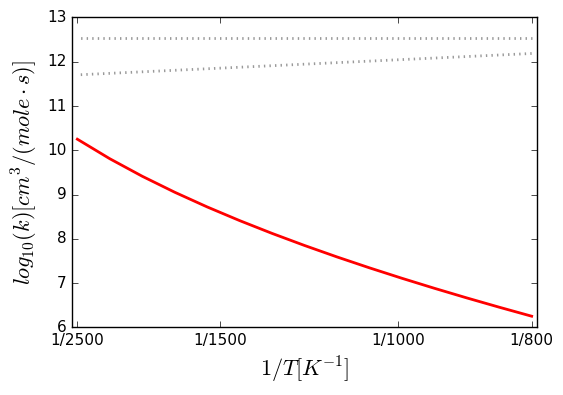


Arrhenius(A=(3.4,'cm^3/(mol*s)'), n=3.6, Ea=(17200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.43044e-07,'cm^3/(mol*s)'), n=5.36795, Ea=(18.1348,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.26242, dn = +|- 0.10715, dEa = +|- 0.58943 kJ/mol""")
e2f + ho2 <=> e2f2j-p + h2o2


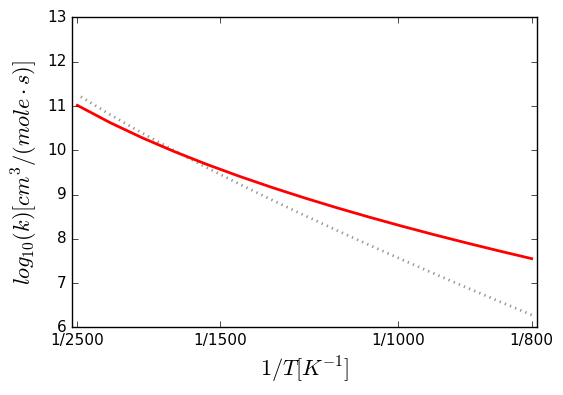


Arrhenius(A=(3.97,'cm^3/(mol*s)'), n=3.57, Ea=(8962.94,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.43044e-07,'cm^3/(mol*s)'), n=5.36795, Ea=(18.1348,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.26242, dn = +|- 0.10715, dEa = +|- 0.58943 kJ/mol""")
e2f + ho2 <=> e2f2j-a + h2o2


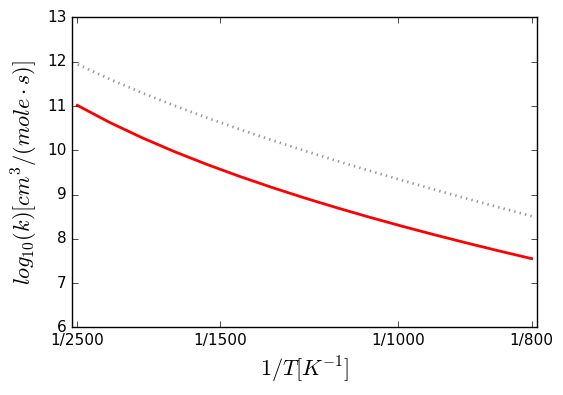


Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.52e+11,'cm^3/(mol*s)'), n=0, Ea=(-1900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'

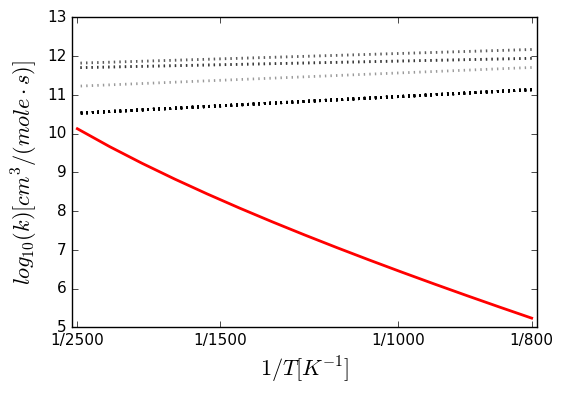


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00349656,'cm^3/(mol*s)'), n=4.17623, Ea=(28.8233,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21723, dn = +|- 0.0257993, dEa = +|- 0.141922 kJ/mol""")
B-DC6H12O + HO2 => TC3H6CH2COCH3 + H2O2


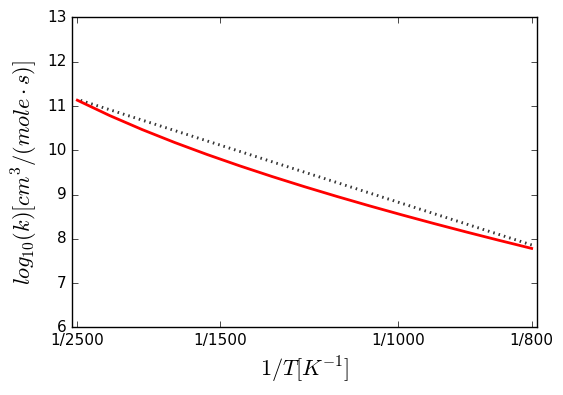


Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.1e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(3000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+07,'cm^3/(mol*s)'), n=2, Ea=(2999.52,'cal/mol'), T0=(1,'K

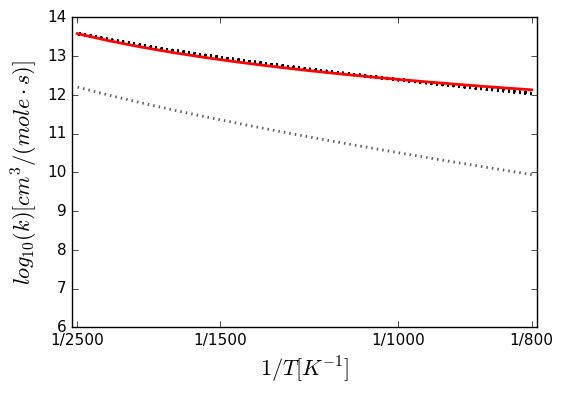


Arrhenius(A=(3e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.81e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'J/mol'), T0=(1,'K'))
Arrhenius(A=(3e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
MultiArrhenius(arrhenius=[Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K')), Arrhenius(A=(3e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))])
Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
MultiArrhenius(arrhenius=[Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K')), Arrhenius(A=(3e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))])
MultiArrhenius(arrhenius=[Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K')), Arrhenius(A=(3e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0

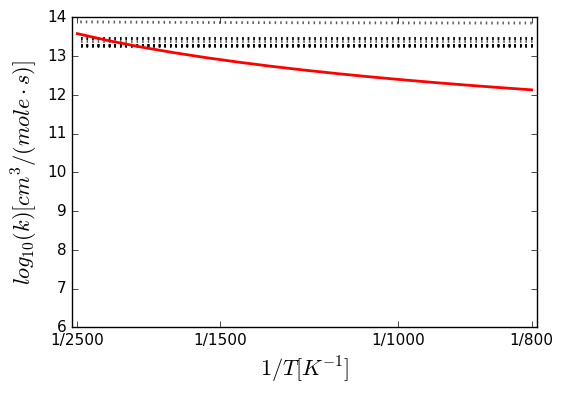


Arrhenius(A=(5.54e+13,'cm^3/(mol*s)'), n=0.05, Ea=(-136,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.54e+13,'cm^3/(mol*s)'), n=0.05, Ea=(-136,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.43e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'J/mol'), T0=(1,'K'))
Arrhenius(A=(5.54e+13,'cm^3/(mol*s)'), n=0.05, Ea=(-136,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.43e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.54e+13,'cm^3/(mol*s)'), n=0.05, Ea=(-136,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.43e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.43e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.43e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.54e+13,'cm^3/(mol*s)'), n=0.05, Ea=(-136,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.54e+13,'cm^3/(mol*s)'), n=0.05, Ea=(-136,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.43e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrh

/Users/nathan/anaconda/envs/rmg_env/lib/python2.7/site-packages/ipykernel/__main__.py:43: RuntimeWarning: divide by zero encountered in log10


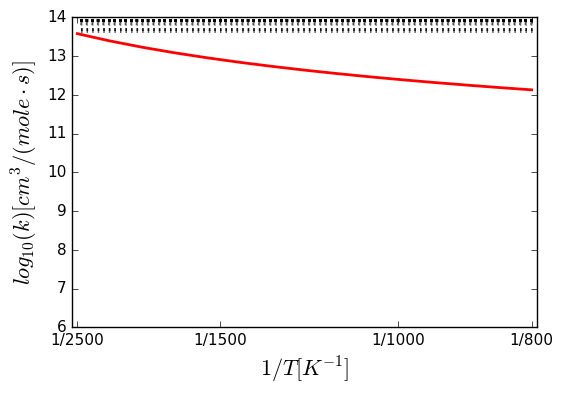


Arrhenius(A=(1e+13,'cm^3/(mol*s)'), n=0.05, Ea=(-136,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.97e+12,'cm^3/(mol*s)'), n=0.05, Ea=(-136,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(350.005,'cm^3/(mol*s)'), n=3.22833, Ea=(-3.32007,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.02732, dn = +|- 0.00353753, dEa = +|- 0.01946 kJ/mol""")
ch3 + o <=> hco + h2


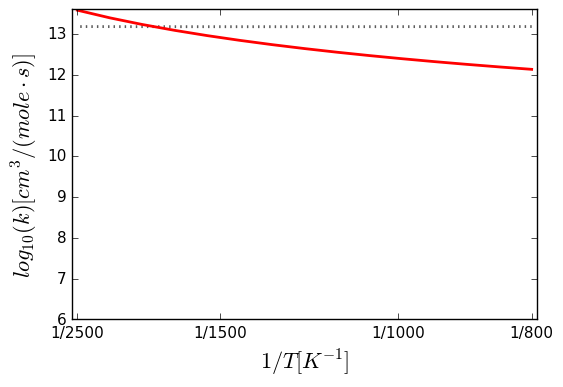


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.5589e-09,'cm^3/(mol*s)'), n=6.03529, Ea=(10.1048,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.68995, dn = +|- 0.068862, dEa = +|- 0.37881 kJ/mol""")
H2O2 + C4H9OaOO <=> HO2 + C4H9OaOOH


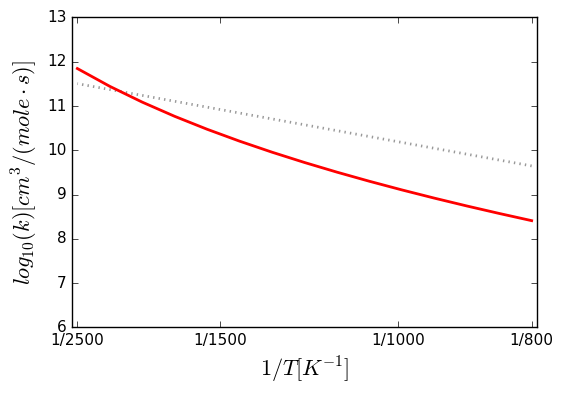


Arrhenius(A=(4e+12,'cm^3/(mol*s)'), n=0, Ea=(17000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.85847e-08,'cm^3/(mol*s)'), n=5.80618, Ea=(40.736,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.66216, dn = +|- 0.128503, dEa = +|- 0.706895 kJ/mol""")
c3h4o + ho2 <=> c3h3o + h2o2


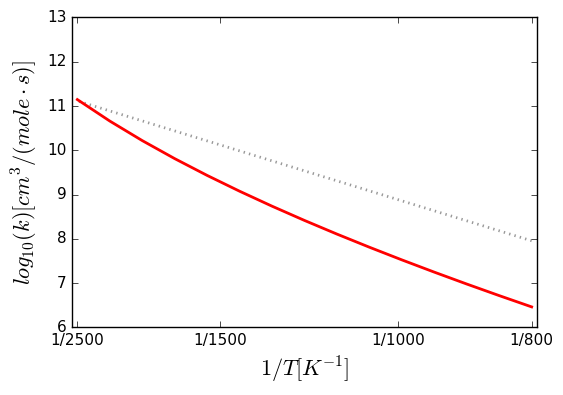


Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000660621,'cm^3/(mol*s)'), n=4.28842, Ea=(64.7448,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.20179, dn = +|- 0.024124, dEa = +|- 0.132706 kJ/mol""")
ch3ch2o + ho2 <=> ch3cho + h2o2


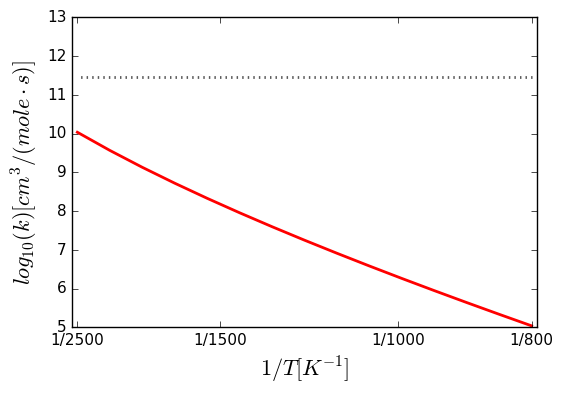


Arrhenius(A=(867,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.344e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(867,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(867,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(867,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(867,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(431000,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,

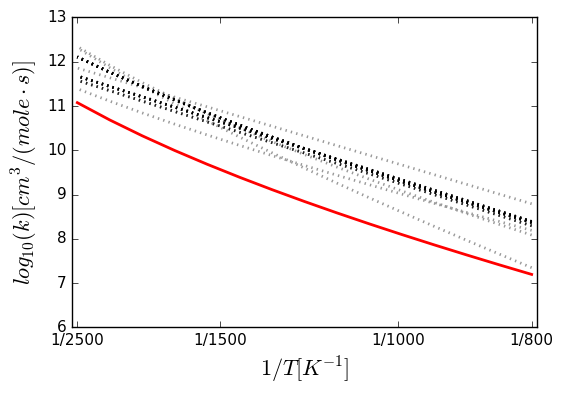


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.75088e-06,'cm^3/(mol*s)'), n=4.66384, Ea=(50.1597,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.44774, dn = +|- 0.0485601, dEa = +|- 0.267129 kJ/mol""")
NC12H26 + HO2 <=> C12H25-2 + H2O2


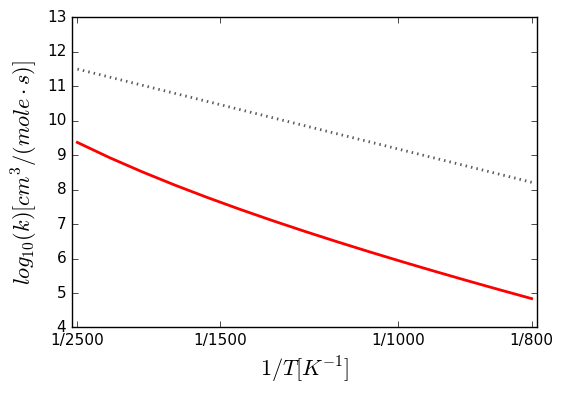


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.75088e-06,'cm^3/(mol*s)'), n=4.66384, Ea=(50.1597,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.44774, dn = +|- 0.0485601, dEa = +|- 0.267129 kJ/mol""")
NC12H26 + HO2 <=> C12H25-4 + H2O2


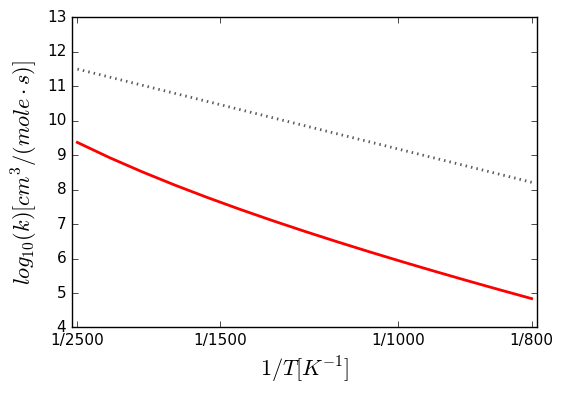


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.75088e-06,'cm^3/(mol*s)'), n=4.66384, Ea=(50.1597,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.44774, dn = +|- 0.0485601, dEa = +|- 0.267129 kJ/mol""")
NC12H26 + HO2 <=> C12H25-5 + H2O2


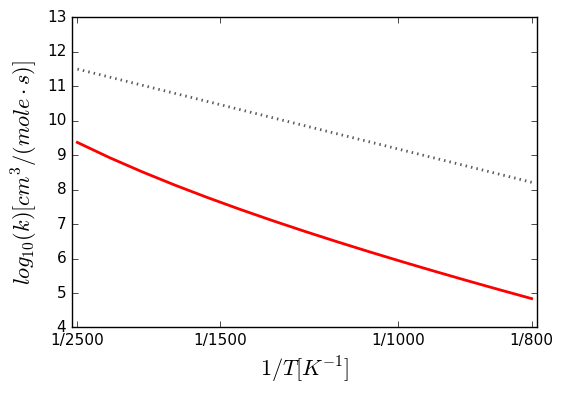


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.75088e-06,'cm^3/(mol*s)'), n=4.66384, Ea=(50.1597,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.44774, dn = +|- 0.0485601, dEa = +|- 0.267129 kJ/mol""")
NC12H26 + HO2 <=> C12H25-6 + H2O2


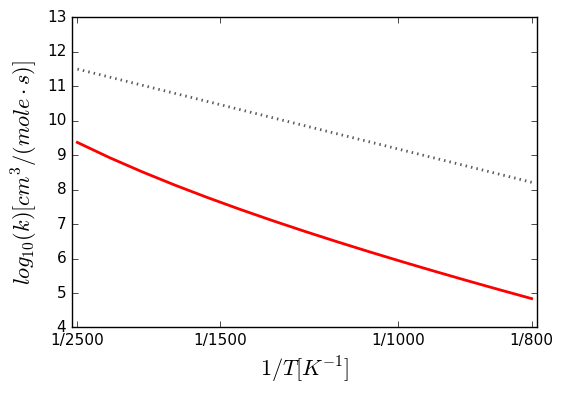


Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.185e+06,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.75088e-06,'cm^3/(mol*s)'), n=4.66384, Ea=(50.1597,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.44774, dn = +|- 0.0485601, dEa = +|- 0.267129 kJ/mol""")
NC12H26 + HO2 <=> C12H25-1 + H2O2


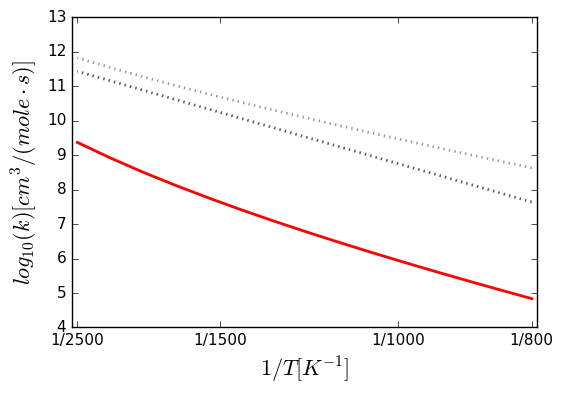


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.75088e-06,'cm^3/(mol*s)'), n=4.66384, Ea=(50.1597,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.44774, dn = +|- 0.0485601, dEa = +|- 0.267129 kJ/mol""")
NC12H26 + HO2 <=> C12H25-3 + H2O2


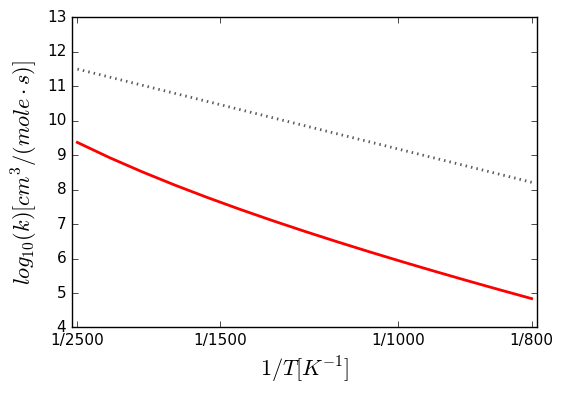


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.98272e-05,'cm^3/(mol*s)'), n=4.58646, Ea=(15.3149,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.49913, dn = +|- 0.0531378, dEa = +|- 0.292311 kJ/mol""")
NC9H19CHO + HO2 <=> NC9H19CO + H2O2


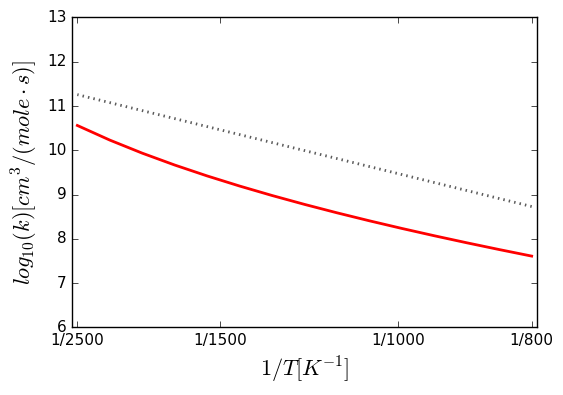


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhe

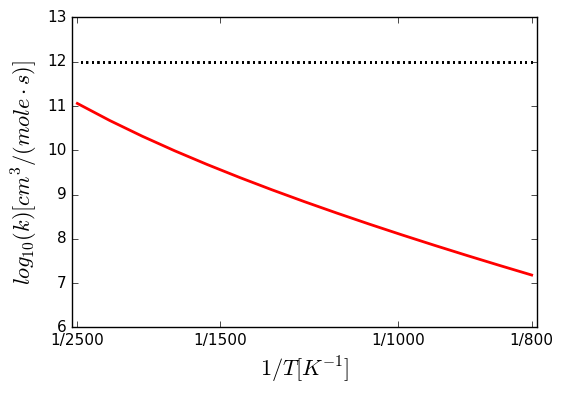


Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.04108e-08,'cm^3/(mol*s)'), n=5.43478, Ea=(20.749,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.21945, dn = +|- 0.104633, dEa = +|- 0.575587 kJ/mol""")
C4H7OH2-2 + HO2 <=> C4H6OH1-32 + H2O2


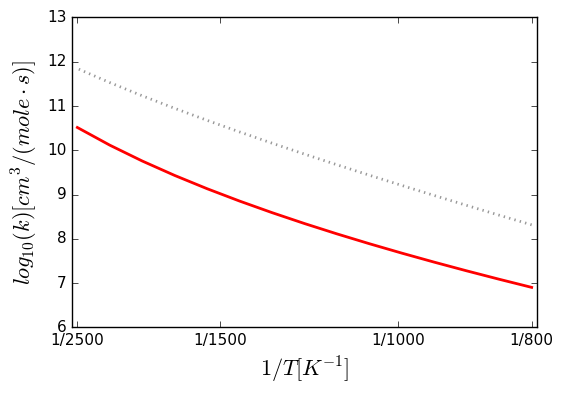


Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.04108e-08,'cm^3/(mol*s)'), n=5.43478, Ea=(20.749,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.21945, dn = +|- 0.104633, dEa = +|- 0.575587 kJ/mol""")
c4h7oh2-2 + ho2 <=> c2h5coch3 + ho2


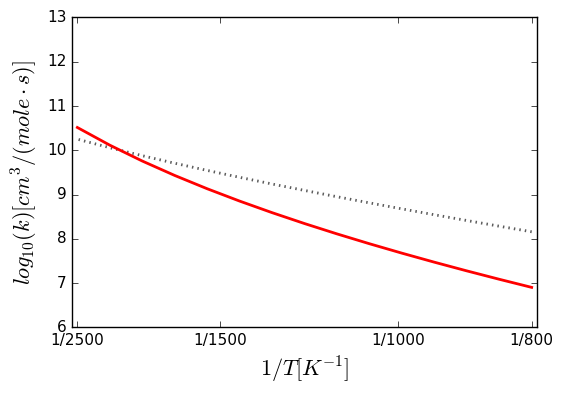


Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.04108e-08,'cm^3/(mol*s)'), n=5.43478, Ea=(20.749,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.21945, dn = +|- 0.104633, dEa = +|- 0.575587 kJ/mol""")
c4h7oh2-2 + ho2 <=> c4h6oh1-32 + h2o2


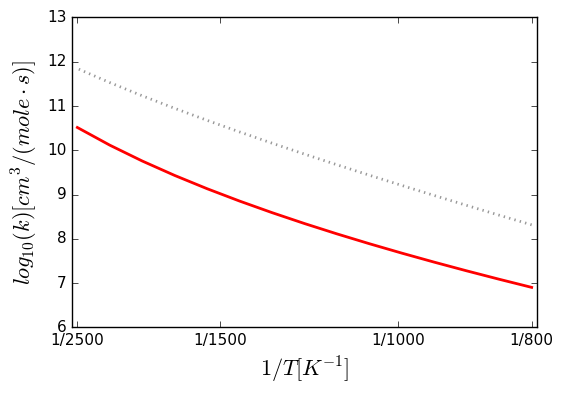


Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(-4000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(48.1798,'cm^3/(mol*s)'), n=2.94264, Ea=(69.7681,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.23572, dn = +|- 0.0277778, dEa = +|- 0.152806 kJ/mol""")
c8h16-5-2 + oh => c2h5cho + dc5h11


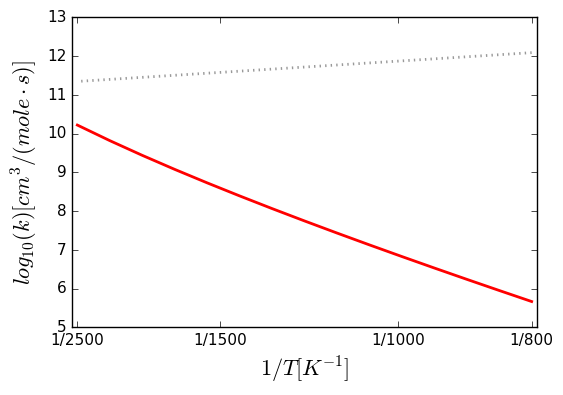


Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(-4000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(48.1798,'cm^3/(mol*s)'), n=2.94264, Ea=(69.7681,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.23572, dn = +|- 0.0277778, dEa = +|- 0.152806 kJ/mol""")
c8h16-5-2 + oh => ch3cho + ec6h13


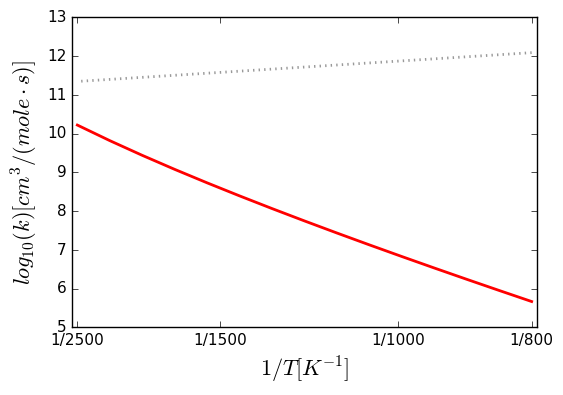


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.21357e-05,'cm^3/(mol*s)'), n=4.90047, Ea=(42.5076,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.59586, dn = +|- 0.0613437, dEa = +|- 0.337452 kJ/mol""")
HO2 + C5H11O2H-2 <=> H2O2 + C5H11O2-2


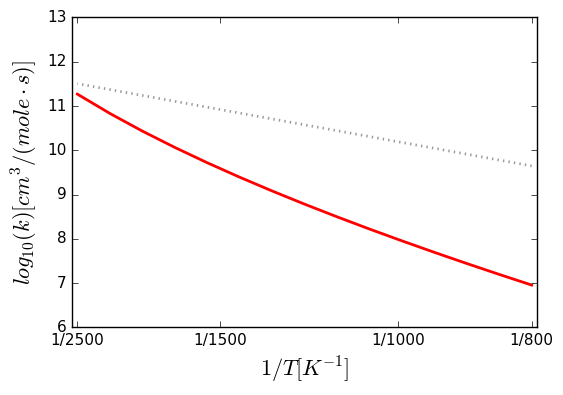


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.58895e-08,'cm^3/(mol*s)'), n=5.10923, Ea=(13.9124,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.71878, dn = +|- 0.0710823, dEa = +|- 0.391024 kJ/mol""")
c8h17oo-3-3 + h2o2 <=> c8h17ooh-3-3 + ho2


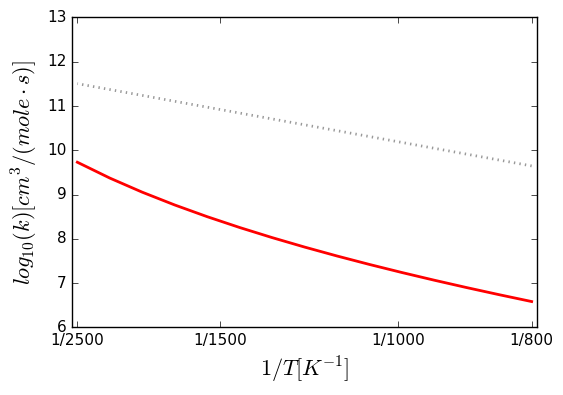


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.05413e-05,'cm^3/(mol*s)'), n=4.6555, Ea=(49.8551,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.42863, dn = +|- 0.0468159, dEa = +|- 0.257535 kJ/mol""")
BC6H13O2H + HO2 <=> BC6H13O2 + H2O2


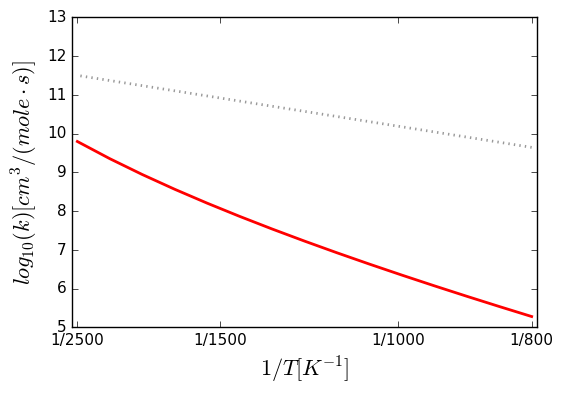


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.37029e-06,'cm^3/(mol*s)'), n=4.9551, Ea=(8.10865,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.74582, dn = +|- 0.0731304, dEa = +|- 0.402291 kJ/mol""")
MCH15DIEN + HO2 <=> MCH13N6J + H2O2


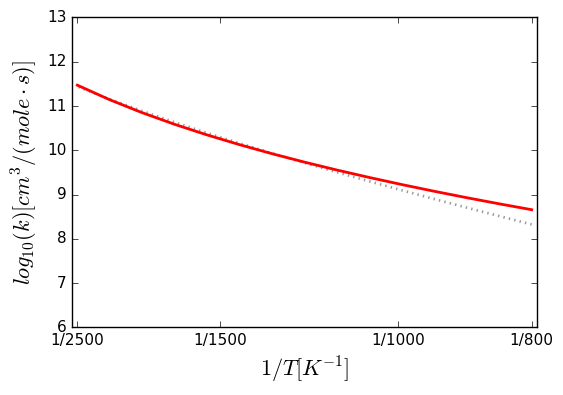


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.37029e-06,'cm^3/(mol*s)'), n=4.9551, Ea=(8.10865,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.74582, dn = +|- 0.0731304, dEa = +|- 0.402291 kJ/mol""")
MCH15DIEN + HO2 <=> MCH15N3J + H2O2


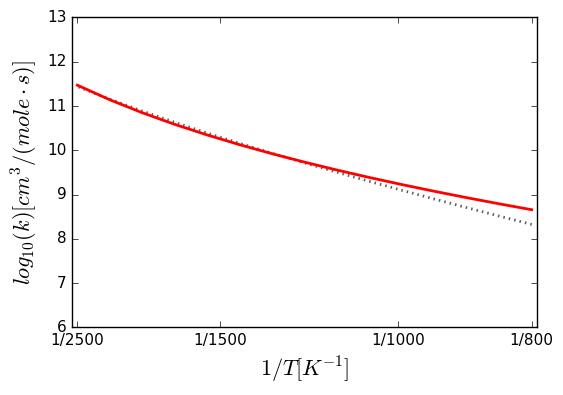


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9490,'cm^3/(mol*s)'), n=2.6, Ea=(13862.3,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.37029e-06,'cm^3/(mol*s)'), n=4.9551, Ea=(8.10865,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.74582, dn = +|- 0.0731304, dEa = +|- 0.402291 kJ/mol""")
MCH15DIEN + HO2 <=> MCH15NCH2J + H2O2


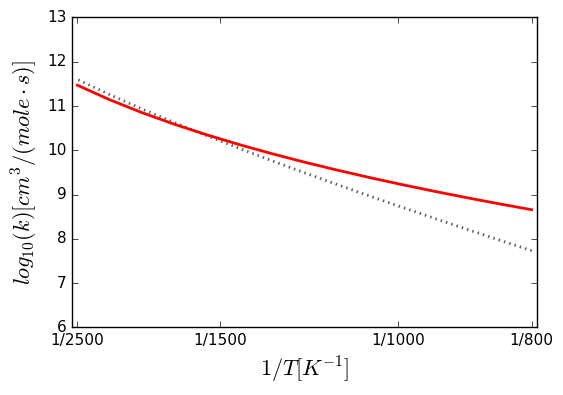


Arrhenius(A=(9490,'cm^3/(mol*s)'), n=2.6, Ea=(13862.3,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.37029e-06,'cm^3/(mol*s)'), n=4.9551, Ea=(8.10865,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.74582, dn = +|- 0.0731304, dEa = +|- 0.402291 kJ/mol""")
MCH15DIEN + HO2 <=> MCH15NCH2J + H2O2


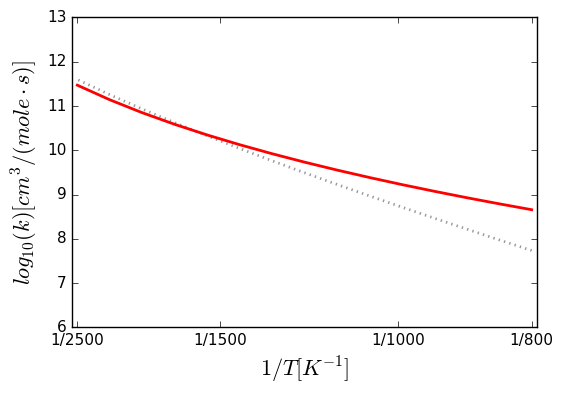


Arrhenius(A=(6.48e+06,'cm^3/(mol*s)'), n=1.72, Ea=(15140,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.44465e-06,'cm^3/(mol*s)'), n=4.66939, Ea=(10.9012,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.68978, dn = +|- 0.0688491, dEa = +|- 0.378739 kJ/mol""")
AC3H4COC2H5 + H2O2 <=> IC3H5COC2H5 + HO2


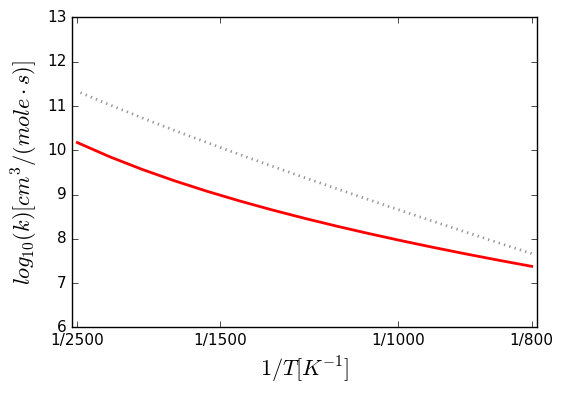


Arrhenius(A=(13200,'cm^3/(mol*s)'), n=2.5, Ea=(9560,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(60880,'cm^3/(mol*s)'), n=2, Ea=(6877.98,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.5e+11,'cm^3/(mol*s)'), n=0, Ea=(10800,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.5e+11,'cm^3/(mol*s)'), n=0, Ea=(10800,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13200,'cm^3/(mol*s)'), n=2.5, Ea=(9560,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.5e+11,'cm^3/(mol*s)'), n=0, Ea=(10800,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.02222e-08,'cm^3/(mol*s)'), n=5.5945, Ea=(12.618,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.16963, dn = +|- 0.101654, dEa = +|- 0.559198 kJ/mol""")
R17C2H5OO + H2O2 <=> C2H5OOH + R3OOH


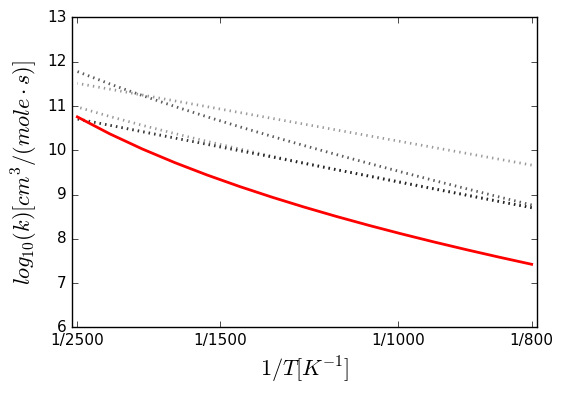


Arrhenius(A=(2e-19,'cm^3/(mol*s)'), n=0, Ea=(17500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.43952e-08,'cm^3/(mol*s)'), n=6.18945, Ea=(24.3295,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.11348, dn = +|- 0.0982122, dEa = +|- 0.540266 kJ/mol""")
BC6H12 + HO2 <=> BC6H13 + O2


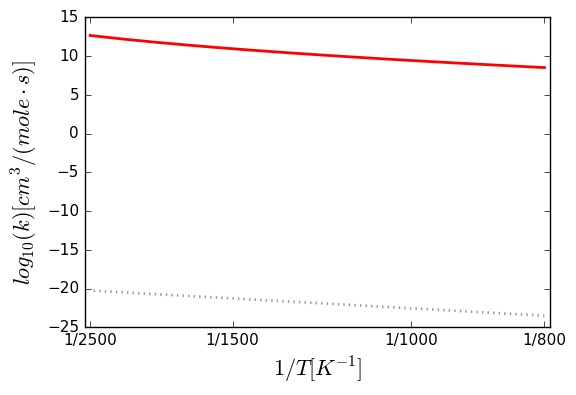


Arrhenius(A=(19280,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(19280,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(19280,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.43952e-08,'cm^3/(mol*s)'), n=6.18945, Ea=(24.3295,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.11348, dn = +|- 0.0982122, dEa = +|- 0.540266 kJ/mol""")
BC6H12 + HO2 <=> AC6H11-C + H2O2


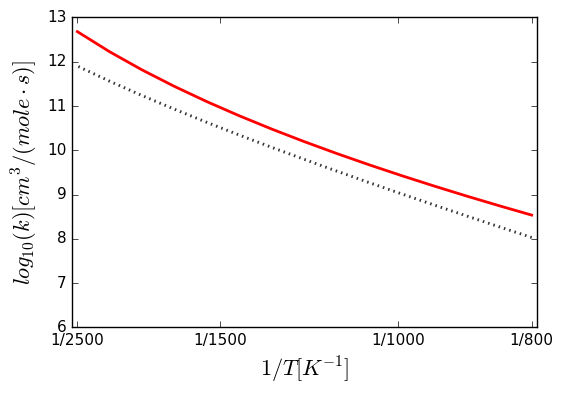


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.43952e-08,'cm^3/(mol*s)'), n=6.18945, Ea=(24.3295,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.11348, dn = +|- 0.0982122, dEa = +|- 0.540266 kJ/mol""")
BC6H12 + HO2 <=> CC6H11-B + H2O2


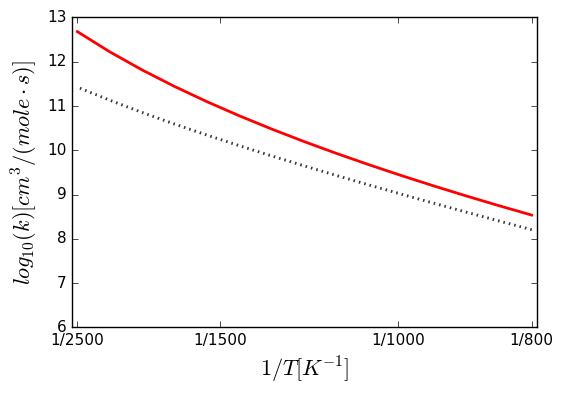


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.43952e-08,'cm^3/(mol*s)'), n=6.18945, Ea=(24.3295,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.11348, dn = +|- 0.0982122, dEa = +|- 0.540266 kJ/mol""")
BC6H12 + HO2 <=> BC6H11-E + H2O2


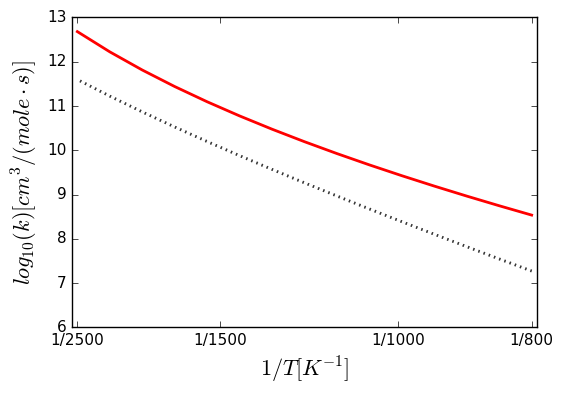


Arrhenius(A=(2e-19,'cm^3/(mol*s)'), n=0, Ea=(17500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.43952e-08,'cm^3/(mol*s)'), n=6.18945, Ea=(24.3295,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.11348, dn = +|- 0.0982122, dEa = +|- 0.540266 kJ/mol""")
BC6H12 + HO2 <=> CC6H13 + O2


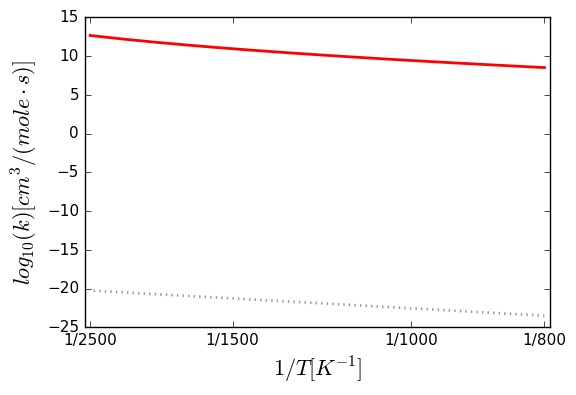


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.62684e-08,'cm^3/(mol*s)'), n=4.91619, Ea=(10.6279,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.66344, dn = +|- 0.066787, dEa = +|- 0.367395 kJ/mol""")
QC7H15O2 + H2O2 <=> QC7H15O2H + HO2


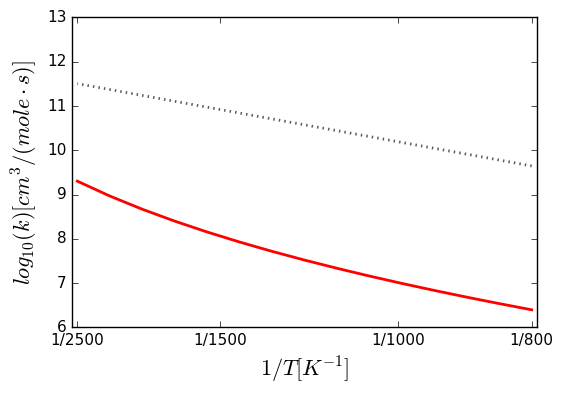


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8749e-07,'cm^3/(mol*s)'), n=4.97098, Ea=(14.0107,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.5747, dn = +|- 0.0595917, dEa = +|- 0.327814 kJ/mol""")
CC6H13O2 + H2O2 <=> CC6H13O2H + HO2


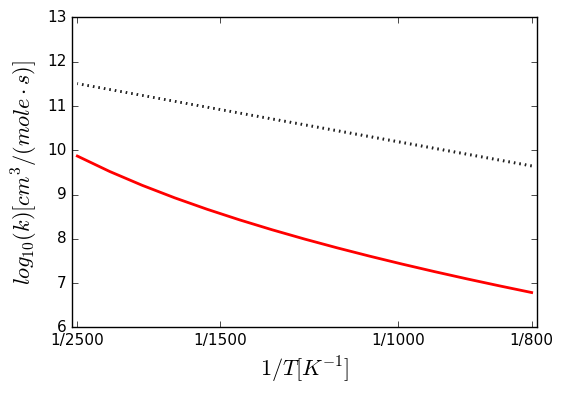


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8749e-07,'cm^3/(mol*s)'), n=4.97098, Ea=(14.0107,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.5747, dn = +|- 0.0595917, dEa = +|- 0.327814 kJ/mol""")
CC6H13O2H + HO2 <=> CC6H13O2 + H2O2


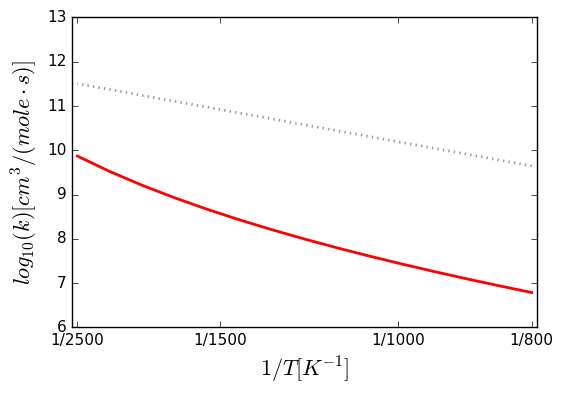


Arrhenius(A=(4.58e+12,'cm^3/(mol*s)'), n=0, Ea=(9817,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(10830,'cm^3/(mol*s)'), n=2, Ea=(2037.98,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.58e+12,'cm^3/(mol*s)'), n=0, Ea=(9817,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(10830,'cm^3/(mol*s)'), n=2, Ea=(2037.98,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000941222,'cm^3/(mol*s)'), n=4.38678, Ea=(61.955,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.2651, dn = +|- 0.0308616, dEa = +|- 0.16977 kJ/mol""")
H2O2 + C4H9-1 => HO2 + C4H10


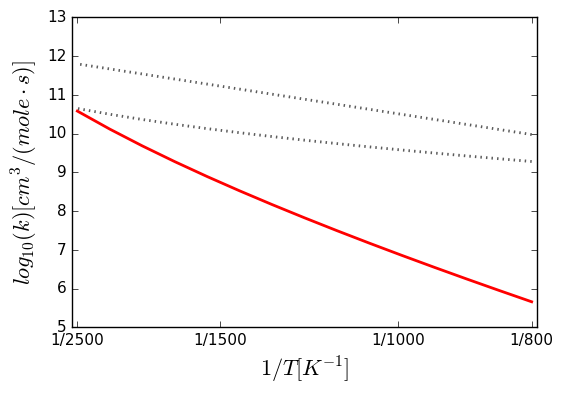


Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(-4000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(46.4475,'cm^3/(mol*s)'), n=2.88413, Ea=(65.0793,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.25209, dn = +|- 0.0295044, dEa = +|- 0.162304 kJ/mol""")
c8h16-4-2 + oh => nc3h7cho + ic4h9


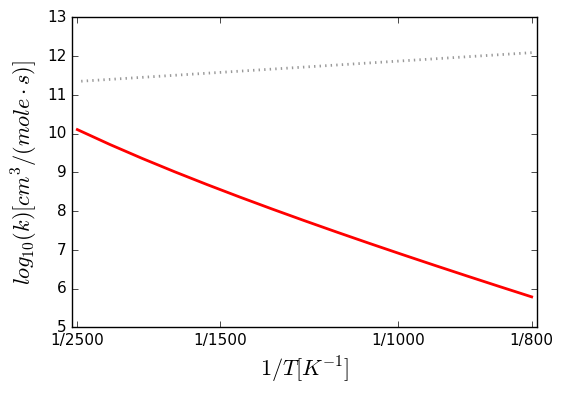


Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(-4000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(46.4475,'cm^3/(mol*s)'), n=2.88413, Ea=(65.0793,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.25209, dn = +|- 0.0295044, dEa = +|- 0.162304 kJ/mol""")
c8h16-4-2 + oh => c2h5cho + dc5h11


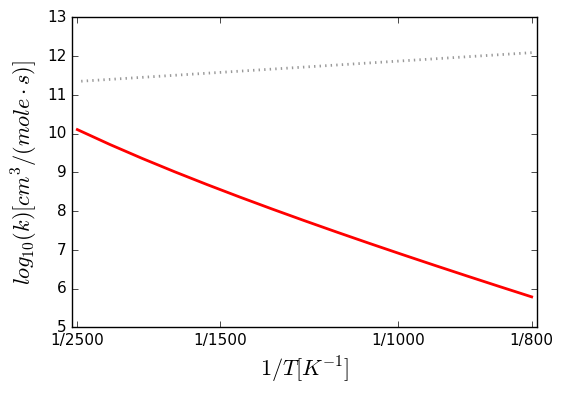


Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00117409,'cm^3/(mol*s)'), n=3.9349, Ea=(-1.96054,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.09471, dn = +|- 0.0118763, dEa = +|- 0.0653316 kJ/mol""")
CC5H10 + HO2 <=> CC5H9-A + H2O2


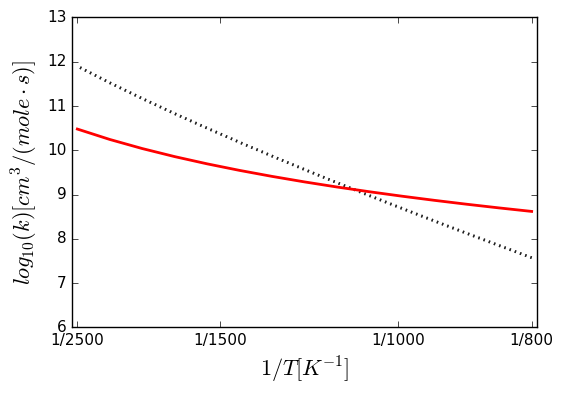


Arrhenius(A=(1810,'cm^3/(mol*s)'), n=2.5, Ea=(7154,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1810,'cm^3/(mol*s)'), n=2.5, Ea=(7154,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1810,'cm^3/(mol*s)'), n=2.5, Ea=(7154,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00117409,'cm^3/(mol*s)'), n=3.9349, Ea=(-1.96054,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.09471, dn = +|- 0.0118763, dEa = +|- 0.0653316 kJ/mol""")
CC5H10 + HO2 <=> CC5H9-B + H2O2


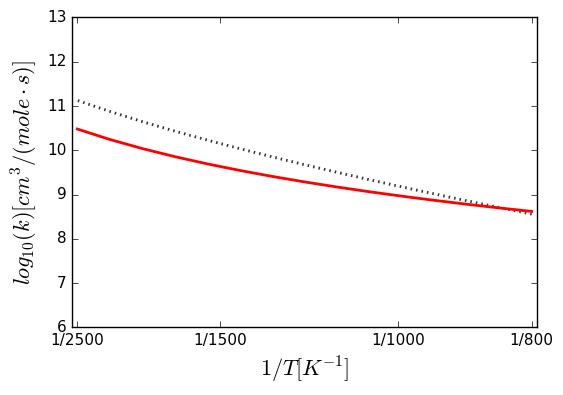


Arrhenius(A=(56600,'cm^3/(mol*s)'), n=2.22, Ea=(4461,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00117409,'cm^3/(mol*s)'), n=3.9349, Ea=(-1.96054,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.09471, dn = +|- 0.0118763, dEa = +|- 0.0653316 kJ/mol""")
CC5H9A + H2O2 <=> CC5H10 + HO2


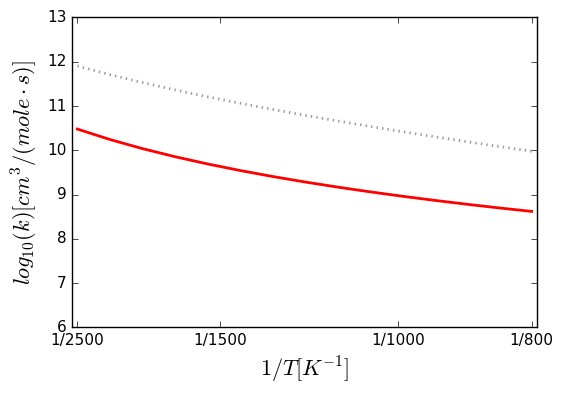


Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.55719e-07,'cm^3/(mol*s)'), n=5.22375, Ea=(11.925,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.03092, dn = +|- 0.0929825, dEa = +|- 0.511497 kJ/mol""")
c4h7oh1-1 + ho2 <=> nc3h7cho + ho2


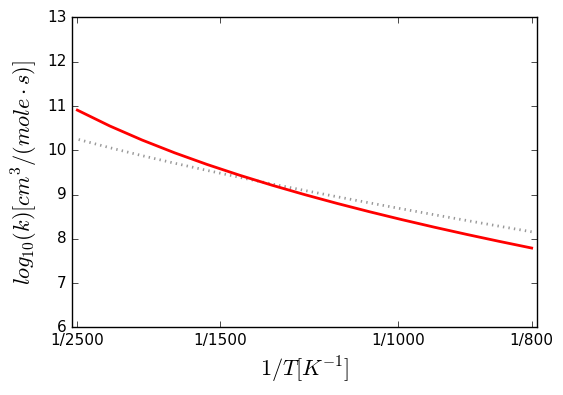


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.55719e-07,'cm^3/(mol*s)'), n=5.22375, Ea=(11.925,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.03092, dn = +|- 0.0929825, dEa = +|- 0.511497 kJ/mol""")
c4h7oh1-1 + ho2 <=> c4h6oh1-13 + h2o2


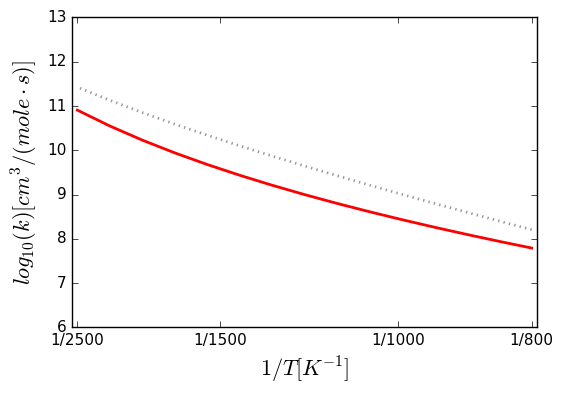


Arrhenius(A=(2e+12,'cm^3/(mol*s)'), n=0, Ea=(2000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00167525,'cm^3/(mol*s)'), n=4.28657, Ea=(49.4433,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21493, dn = +|- 0.0255513, dEa = +|- 0.140558 kJ/mol""")
cC6H11 + HO2 <=> cC6H10 + H2O2


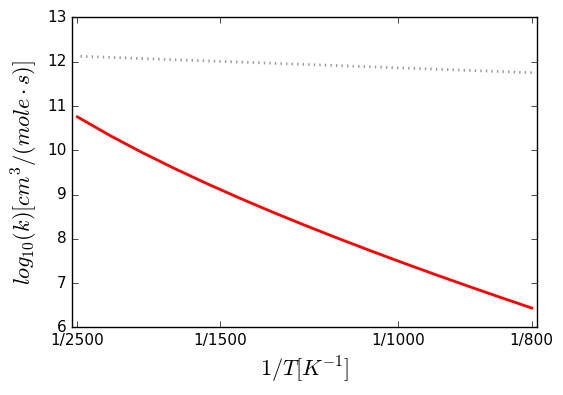


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00167525,'cm^3/(mol*s)'), n=4.28657, Ea=(49.4433,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21493, dn = +|- 0.0255513, dEa = +|- 0.140558 kJ/mol""")
CHXRAD + HO2 <=> CHXOJ + OH


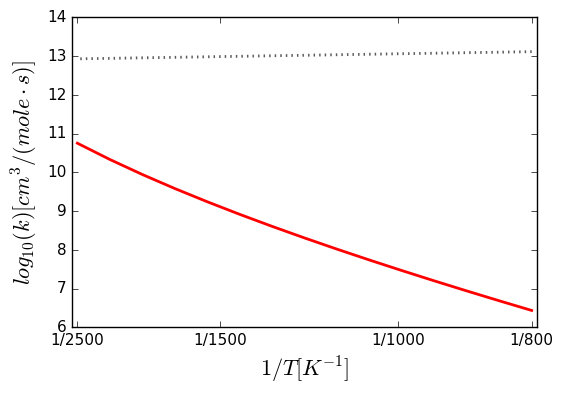


Arrhenius(A=(2.05e+13,'cm^3/(mol*s)'), n=-0.38, Ea=(8399,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00421275,'cm^3/(mol*s)'), n=3.80577, Ea=(-3.51149,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.03615, dn = +|- 0.00466089, dEa = +|- 0.0256396 kJ/mol""")
C7H15-1 + H2O2 <=> NC7H16 + HO2


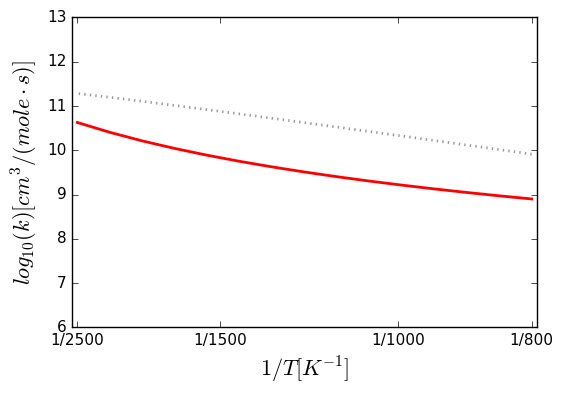


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.38662e-07,'cm^3/(mol*s)'), n=5.83066, Ea=(52.7191,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51166, dn = +|- 0.0542298, dEa = +|- 0.298318 kJ/mol""")
HC6H13O2H + HO2 <=> HC6H13O2 + H2O2


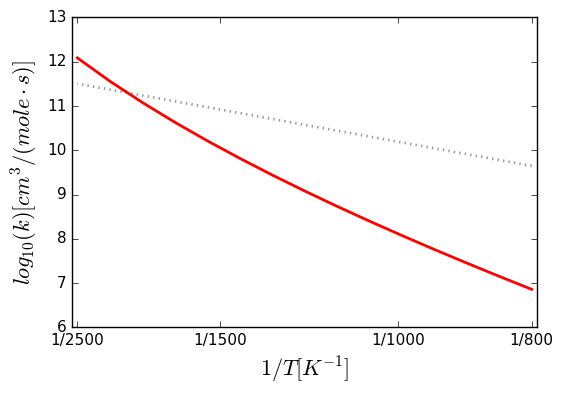


Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.62413e-08,'cm^3/(mol*s)'), n=5.11947, Ea=(45.7145,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.92139, dn = +|- 0.0857067, dEa = +|- 0.471473 kJ/mol""")
h3e25o + ho2 <=> h3e25o1j + h2o2


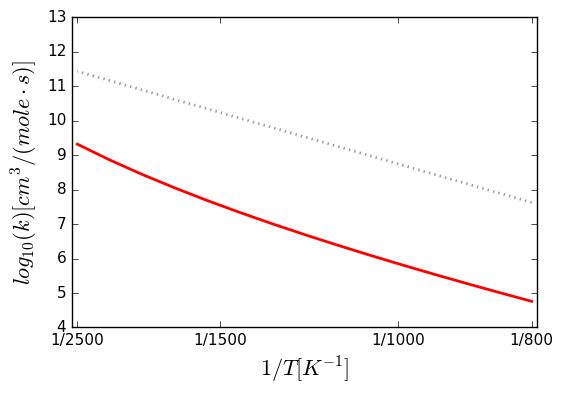


Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000405537,'cm^3/(mol*s)'), n=4.37835, Ea=(23.7318,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28241, dn = +|- 0.0326449, dEa = +|- 0.17958 kJ/mol""")
CH3OCH2OCH3 + HO2 <=> CH3OCH2OCH2 + H2O2


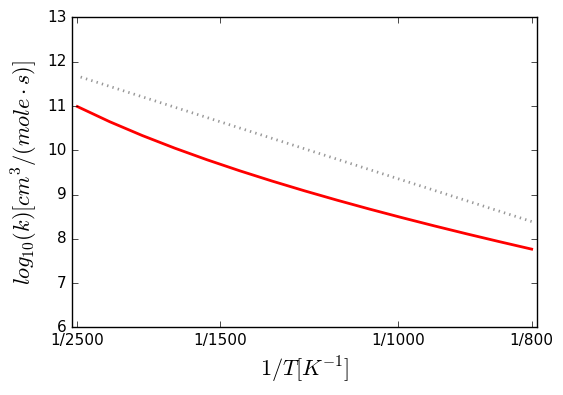


Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000405537,'cm^3/(mol*s)'), n=4.37835, Ea=(23.7318,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28241, dn = +|- 0.0326449, dEa = +|- 0.17958 kJ/mol""")
CH3OCH2OCH3 + HO2 <=> CH3OCHOCH3 + H2O2


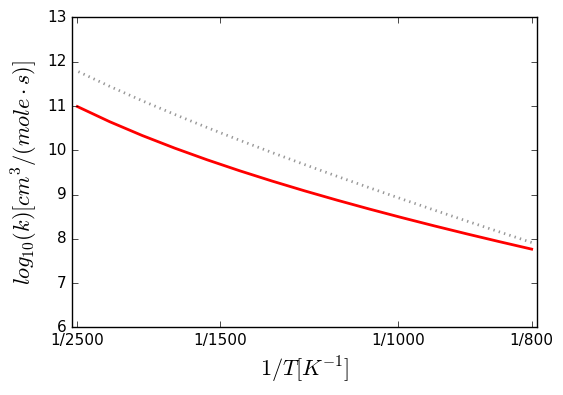


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0163388,'cm^3/(mol*s)'), n=4.09651, Ea=(38.1379,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15079, dn = +|- 0.0184329, dEa = +|- 0.101399 kJ/mol""")
ic6h13cho + ho2 <=> ic6h13co + h2o2


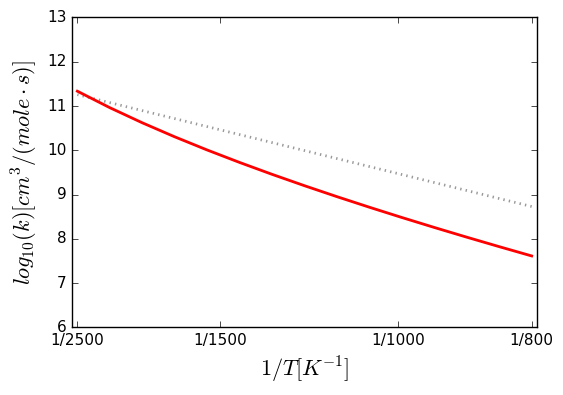


Arrhenius(A=(9.78e+12,'cm^3/(mol*s)'), n=-0.33, Ea=(8404,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00431723,'cm^3/(mol*s)'), n=3.98954, Ea=(-0.405891,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11809, dn = +|- 0.0146488, dEa = +|- 0.0805833 kJ/mol""")
AC8H17 + H2O2 <=> IC8H18 + HO2


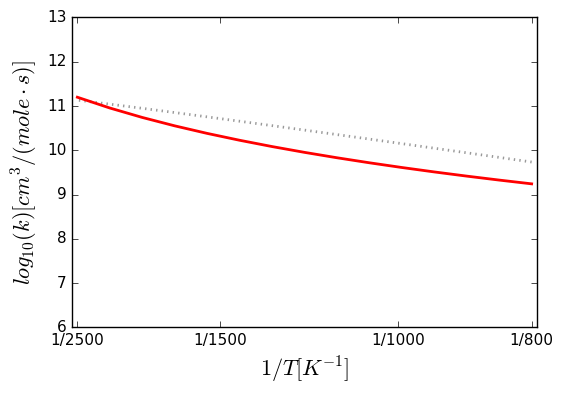


Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.85e+10,'cm^3/(mol*s)'), n=0.73, Ea=(16943.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(48600,'cm^3/(mol*s)'), n=2.5, Ea=(16690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(48600,'cm^3/(mol*s)'), n=2.5, Ea=(16690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00431723,'cm^3/(mol*s)'), n=3.98954, Ea=(-0.405891,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11809, dn = +|- 0.0146488, dEa = +|- 0.0805833 kJ/mol""")
IC8H18 + HO2 <=> DC8H17 + H2O2


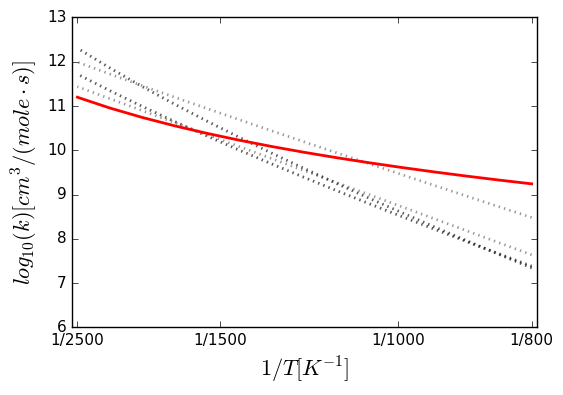


Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(35300,'cm^3/(mol*s)'), n=2.5, Ea=(14680,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00431723,'cm^3/(mol*s)'), n=3.98954, Ea=(-0.405891,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11809, dn = +|- 0.0146488, dEa = +|- 0.0805833 kJ/mol""")
IC8H18 + HO2 <=> BC8H17 + H2O2


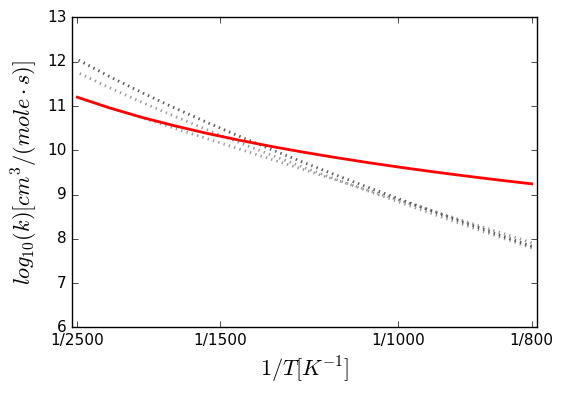


Arrhenius(A=(433.2,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(433.2,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(484900,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(12260,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(12260,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(16010,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00431723,'cm^3/(mol*s)'), n=3.98954, Ea=(-0.405891,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11809, dn = +|- 0.0146488, dEa = +|- 0.0805833 kJ/mol""")
IC8H18 + HO2 <=> CC8H17 + H2O2


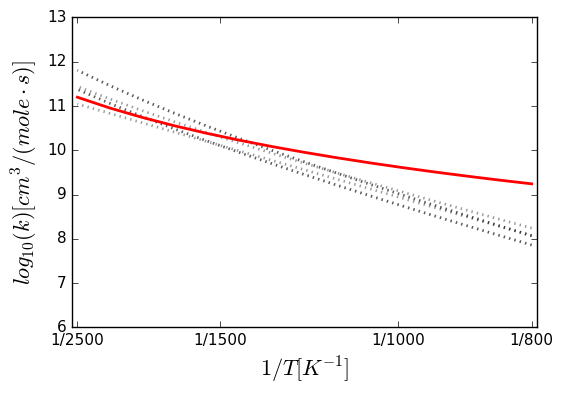


Arrhenius(A=(61.2,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(61.2,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(72900,'cm^3/(mol*s)'), n=2.5, Ea=(16680,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(72900,'cm^3/(mol*s)'), n=2.5, Ea=(16680,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.52e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00431723,'cm^3/(mol*s)'), n=3.98954, Ea=(-0.405891,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11809, dn = +|- 0.0146488, dEa = +|- 0.0805833 kJ/mol""")
IC8H18 + HO2 <=> AC8H17 + H2O2


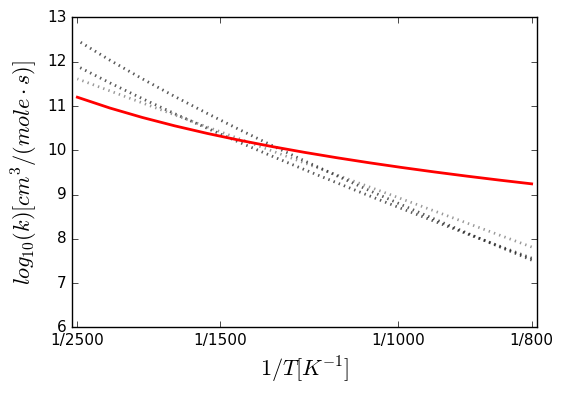


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000234702,'cm^3/(mol*s)'), n=4.53625, Ea=(46.706,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.34866, dn = +|- 0.0392556, dEa = +|- 0.215945 kJ/mol""")
A-BC6H12O + HO2 => C5H10CHO2-2 + H2O2


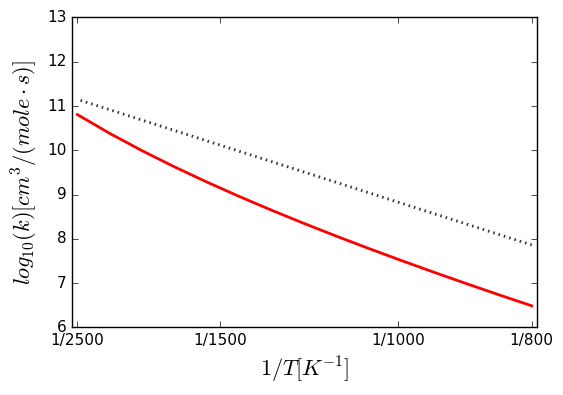


Arrhenius(A=(6e+12,'cm^3/(mol*s)'), n=0, Ea=(37190,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.01275,'cm^3/(mol*s)'), n=3.50914, Ea=(155.399,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08187, dn = +|- 0.010327, dEa = +|- 0.0568091 kJ/mol""")
c4h7oh1-4 + o2 <=> c4h6oh1-32 + ho2


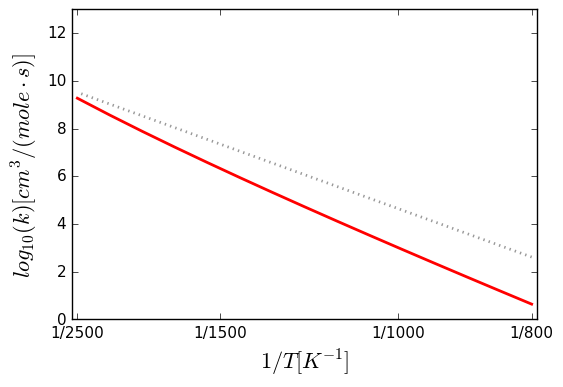


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(2000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.66626e-05,'cm^3/(mol*s)'), n=4.85732, Ea=(59.0974,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.54899, dn = +|- 0.0574311, dEa = +|- 0.315929 kJ/mol""")
THP-3-yl + HO2 <=> THP-3-ene + H2O2


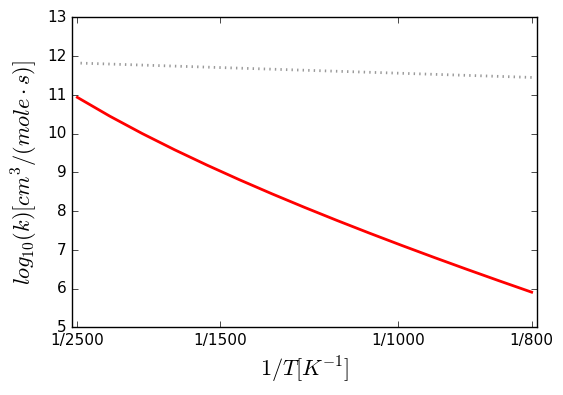


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(2000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.66626e-05,'cm^3/(mol*s)'), n=4.85732, Ea=(59.0974,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.54899, dn = +|- 0.0574311, dEa = +|- 0.315929 kJ/mol""")
THP-3-yl + HO2 <=> THP-2-ene + H2O2


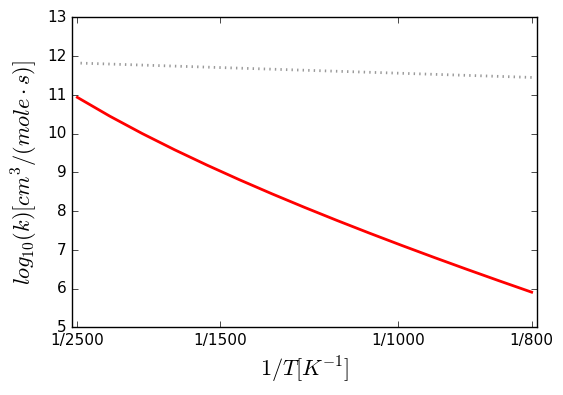


Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00193592,'cm^3/(mol*s)'), n=4.30275, Ea=(47.0268,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21942, dn = +|- 0.0260345, dEa = +|- 0.143216 kJ/mol""")
C5H11-1 + HO2 <=> C5H

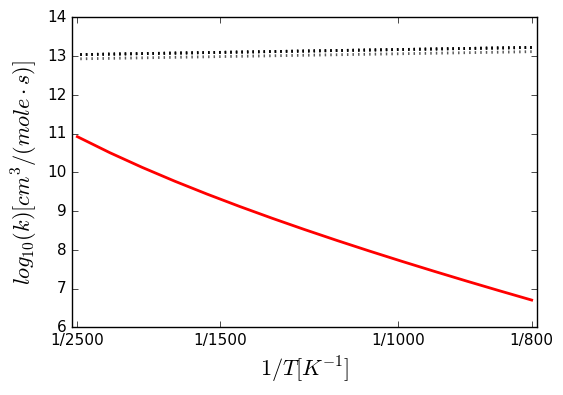


Arrhenius(A=(2.31e+10,'cm^3/(mol*s)'), n=0.29, Ea=(446,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00193592,'cm^3/(mol*s)'), n=4.30275, Ea=(47.0268,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21942, dn = +|- 0.0260345, dEa = +|- 0.143216 kJ/mol""")
C5H11-1 + HO2 <=> NC5H12 + O2


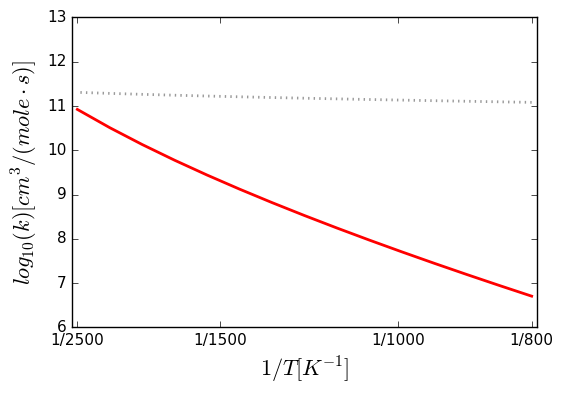


Arrhenius(A=(93300,'cm^3/(mol*s)'), n=2.5, Ea=(14684.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(161600,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.86135e-07,'cm^3/(mol*s)'), n=5.27754, Ea=(24.0269,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.97249, dn = +|- 0.0891518, dEa = +|- 0.490424 kJ/mol""")
HO2 + C10H7CH3 => H2O2 + C10H7CH2


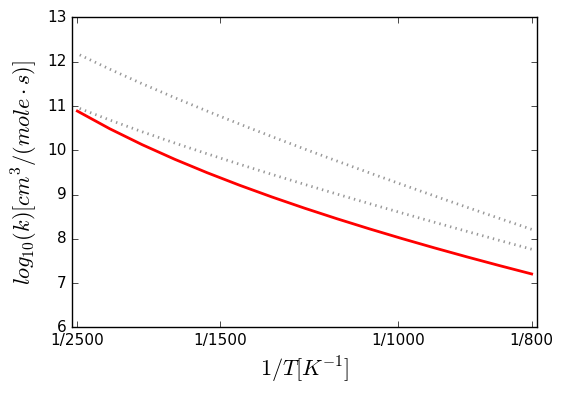


Arrhenius(A=(19000,'cm^3/(mol*s)'), n=2.6, Ea=(13900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(19000,'cm^3/(mol*s)'), n=2.6, Ea=(13900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.01761e-07,'cm^3/(mol*s)'), n=5.57753, Ea=(30.2021,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.31673, dn = +|- 0.110263, dEa = +|- 0.606556 kJ/mol""")
C4H6-2 + R3OOH <=> C4H5-2 + H2O2


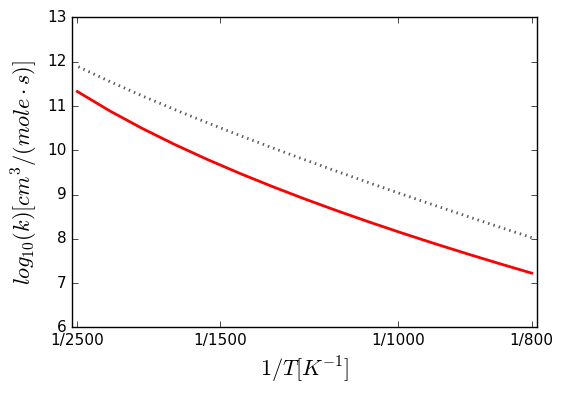


Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00652857,'cm^3/(mol*s)'), n=4.18282, Ea=(38.4396,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17502, dn = +|- 0.0211673, dEa = +|- 0.116441 kJ/mol""")
c7h16-2 + ho2 <=> c7h15-2d + h2o2


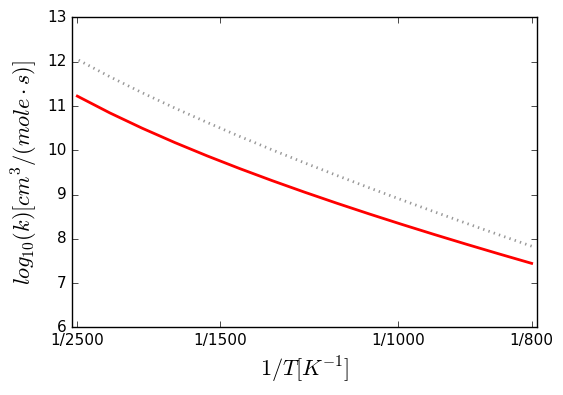


Arrhenius(A=(20.4,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00652857,'cm^3/(mol*s)'), n=4.18282, Ea=(38.4396,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17502, dn = +|- 0.0211673, dEa = +|- 0.116441 kJ/mol""")
c7h16-2 + ho2 <=> c7h15-2f + h2o2


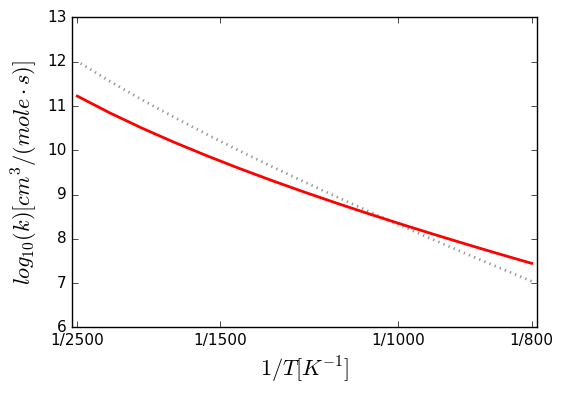


Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00652857,'cm^3/(mol*s)'), n=4.18282, Ea=(38.4396,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17502, dn = +|- 0.0211673, dEa = +|- 0.116441 kJ/mol""")
c7h16-2 + ho2 <=> c7h15-2e + h2o2


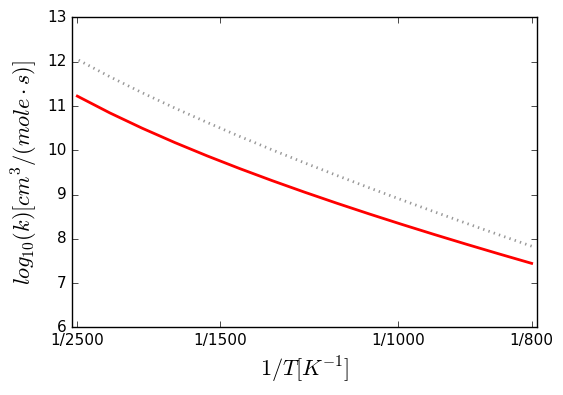


Arrhenius(A=(650,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00652857,'cm^3/(mol*s)'), n=4.18282, Ea=(38.4396,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17502, dn = +|- 0.0211673, dEa = +|- 0.116441 kJ/mol""")
c7h16-2 + ho2 <=> c7h15-2b + h2o2


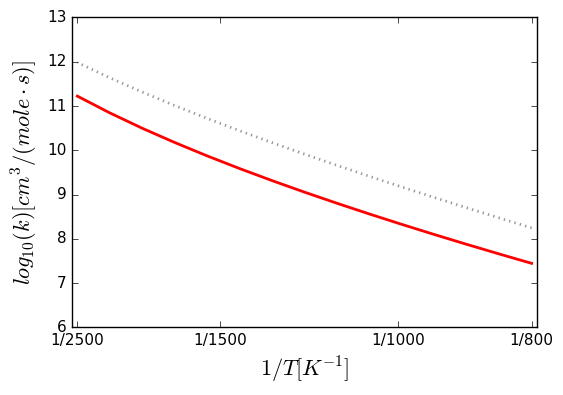


Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00652857,'cm^3/(mol*s)'), n=4.18282, Ea=(38.4396,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17502, dn = +|- 0.0211673, dEa = +|- 0.116441 kJ/mol""")
c7h16-2 + ho2 <=> c7h15-2a + h2o2


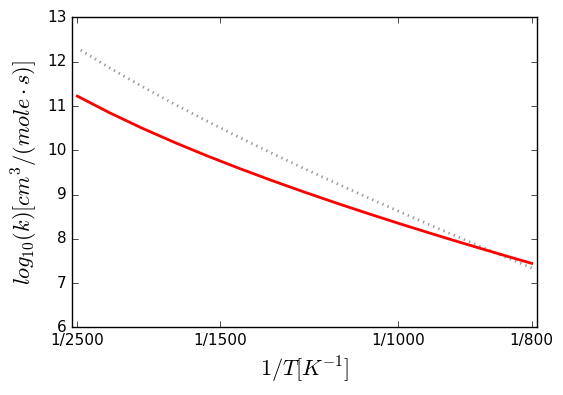


Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00652857,'cm^3/(mol*s)'), n=4.18282, Ea=(38.4396,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17502, dn = +|- 0.0211673, dEa = +|- 0.116441 kJ/mol""")
c7h16-2 + ho2 <=> c7h15-2c + h2o2


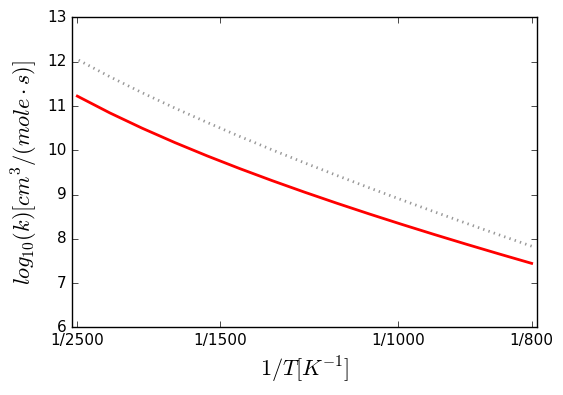


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.73937e-09,'cm^3/(mol*s)'), n=5.66192, Ea=(30.0385,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.66372, dn = +|- 0.12858, dEa = +|- 0.707319 kJ/mol""")
hoc2h4cho + ho2 <=> hoc2h4co + h2o2


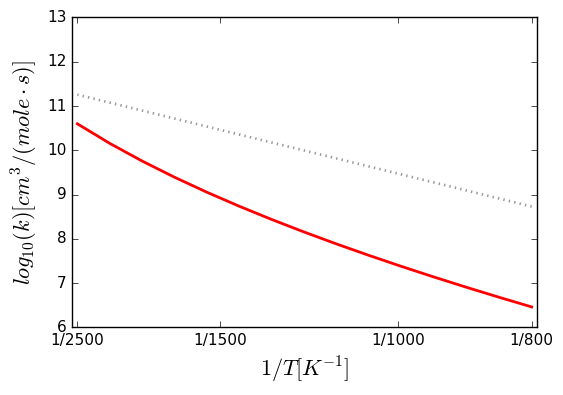


Arrhenius(A=(2.47e+11,'cm^3/(mol*s)'), n=0, Ea=(-1570,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.47e+11,'cm^3/(mol*s)'), n=0, Ea=(-1570,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.47e+11,'cm^3/(mol*s)'), n=0, Ea=(-1570,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.47e+11,'cm^3/(mol*s)'), n=0, Ea=(-1570,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.47e+11,'cm^3/(mol*s)'), n=0, Ea=(-1570,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.47e+11,'cm^3/(mol*s)'), n=0, Ea=(-1570,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.6e+10,'cm^3/(mol*s)'), n=0, Ea=(-2603,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.47e+11,'cm^3/(mol*s)'), n=0, Ea=(-1570,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+06,'cm^3/(mol*s)'), n=2.1, Ea=(4870,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.47e+11,'cm^3/(mol*s)'), n=0, Ea=(-1570,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.47e+11,'cm^3/(mol*s)'), n=0, Ea=(-1570,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.47e+11,'cm^3/(mol*s)'), n=0, Ea=(-1570,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.47e+11,'cm^3/(mol*s)'), n=0, Ea=(-1570,'cal/mol'), 

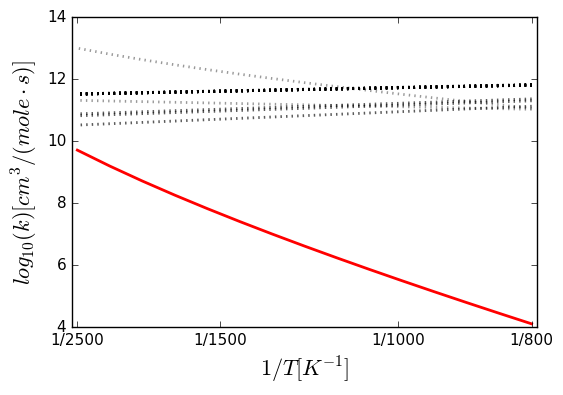


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.16788e-07,'cm^3/(mol*s)'), n=5.27195, Ea=(24.6276,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.09691, dn = +|- 0.0971796, dEa = +|- 0.534585 kJ/mol""")
MCH1ENE + HO2 <=> MCH1N4J + H2O2


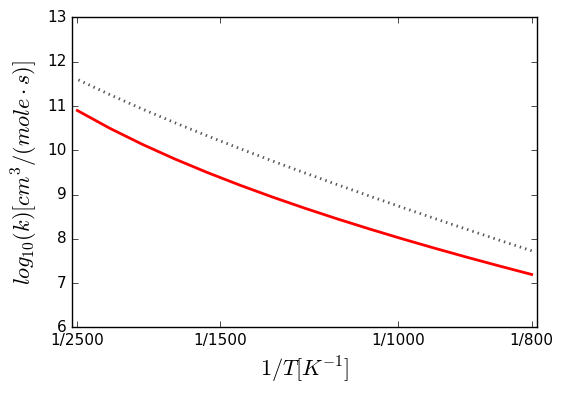


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9490,'cm^3/(mol*s)'), n=2.6, Ea=(13862.3,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9490,'cm^3/(mol*s)'), n=2.6, Ea=(13862.3,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.16788e-07,'cm^3/(mol*s)'), n=5.27195, Ea=(24.6276,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.09691, dn = +|- 0.0971796, dEa = +|- 0.534585 kJ/mol""")
MCH1ENE + HO2 <=> CHXDCH22J + H2O2


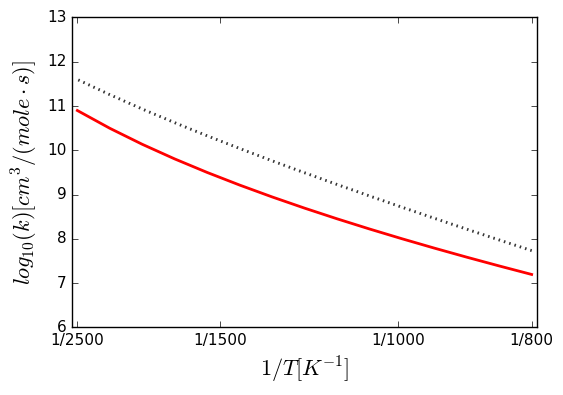


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.16788e-07,'cm^3/(mol*s)'), n=5.27195, Ea=(24.6276,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.09691, dn = +|- 0.0971796, dEa = +|- 0.534585 kJ/mol""")
MCH1ENE + HO2 <=> MCH1N6J + H2O2


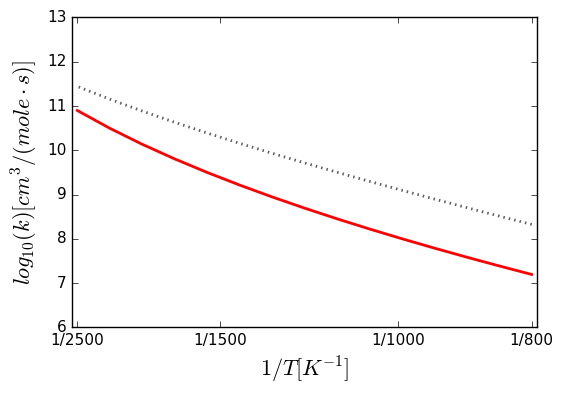


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.16788e-07,'cm^3/(mol*s)'), n=5.27195, Ea=(24.6276,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.09691, dn = +|- 0.0971796, dEa = +|- 0.534585 kJ/mol""")
MCH1ENE + HO2 <=> MCH1N5J + H2O2


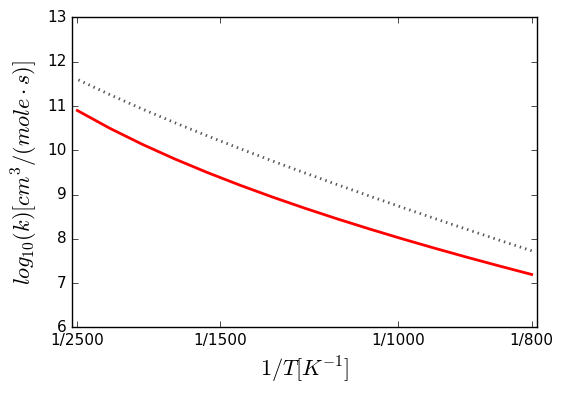


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.16788e-07,'cm^3/(mol*s)'), n=5.27195, Ea=(24.6276,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.09691, dn = +|- 0.0971796, dEa = +|- 0.534585 kJ/mol""")
MCH1ENE + HO2 <=> MCH1N3J + H2O2


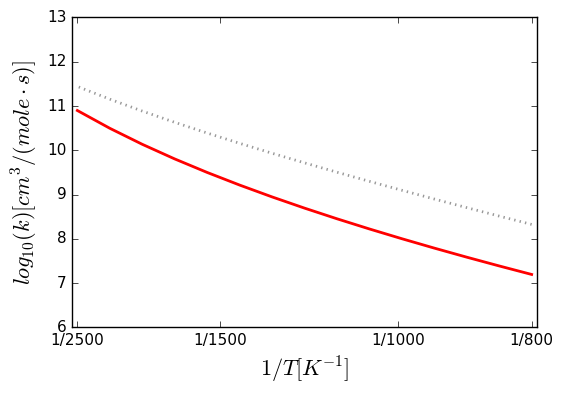


Arrhenius(A=(13600,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13600,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.69849e-06,'cm^3/(mol*s)'), n=4.74174, Ea=(-0.633557,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.45314, dn = +|- 0.0490483, dEa = +|- 0.269815 kJ/mol""")
CYHX24N1*O + HO2 <=> C6H5O + H2O2


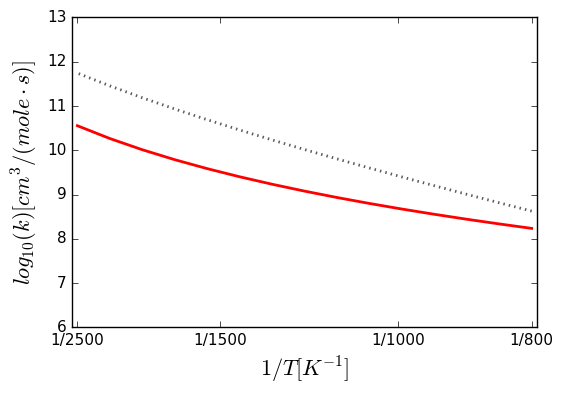


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.60336e-06,'cm^3/(mol*s)'), n=4.70011, Ea=(11.7882,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.43222, dn = +|- 0.0471448, dEa = +|- 0.259344 kJ/mol""")
H2O2 + C4H9ObOO <=> HO2 + C4H9ObOOH


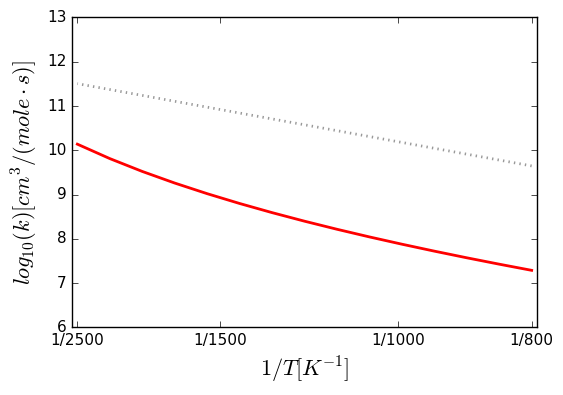


Arrhenius(A=(0.99,'cm^3/(mol*s)'), n=3.78, Ea=(12335,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.80983e-09,'cm^3/(mol*s)'), n=5.83528, Ea=(22.8347,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.81027, dn = +|- 0.135609, dEa = +|- 0.745983 kJ/mol""")
mf25cho + ho2 <=> mf2j5cho + h2o2


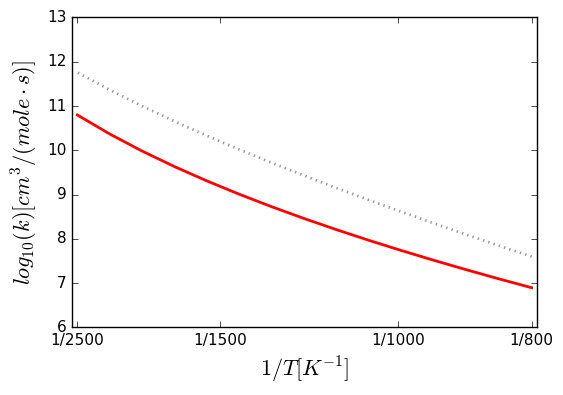


Arrhenius(A=(7.05,'cm^3/(mol*s)'), n=3.81, Ea=(9250.98,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.80983e-09,'cm^3/(mol*s)'), n=5.83528, Ea=(22.8347,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.81027, dn = +|- 0.135609, dEa = +|- 0.745983 kJ/mol""")
mf25cho + ho2 <=> mf25cjo + h2o2


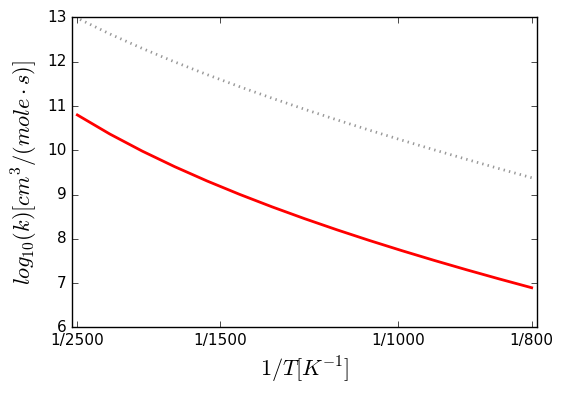


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16494,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.83993e-07,'cm^3/(mol*s)'), n=5.35369, Ea=(23.5876,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.39945, dn = +|- 0.114867, dEa = +|- 0.631884 kJ/mol""")
CH3-3-C6H9-15 + HO2 <=> CH2-3-C6H9-15 + H2O2


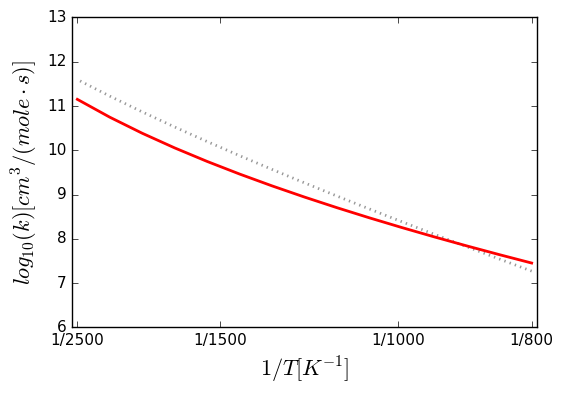


Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.37726e-06,'cm^3/(mol*s)'), n=4.76078, Ea=(25.8407,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.83062, dn = +|- 0.0793556, dEa = +|- 0.436535 kJ/mol""")
c4h7oh2-1 + ho2 <=> c4h6oh1-32 + h2o2


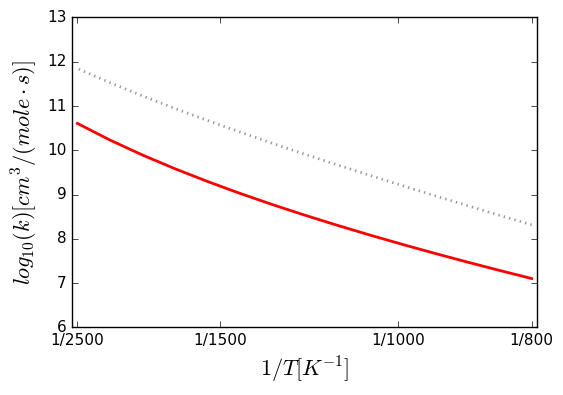


Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.74115e-06,'cm^3/(mol*s)'), n=5.0229, Ea=(45.5097,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.75128, dn = +|- 0.0735406, dEa = +|- 0.404547 kJ/mol""")
ic4h8oh-3o2 + ho2 <=> ic4h8oh-3o2h + o2


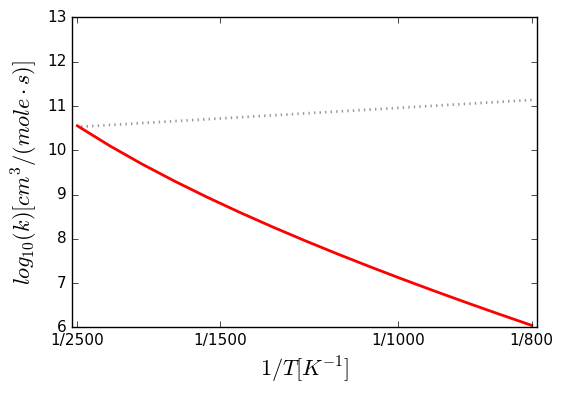


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.97248e-07,'cm^3/(mol*s)'), n=4.86101, Ea=(12.1842,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.57656, dn = +|- 0.059747, dEa = +|- 0.328669 kJ/mol""")
C6H13O2-2 + H2O2 <=> C6H13O2H-2 + HO2


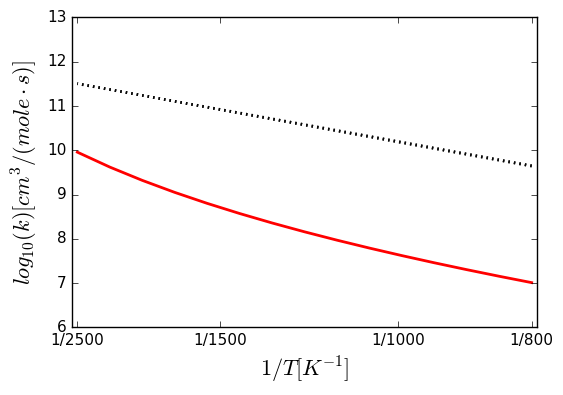


Arrhenius(A=(11100,'cm^3/(mol*s)'), n=2.77, Ea=(12420,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2912.48,'cm^3/(mol*s)'), n=3.0224, Ea=(28.3047,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.62865, dn = +|- 0.0640127, dEa = +|- 0.352134 kJ/mol""")
AC8H17 + H2 <=> IC8H18 + H


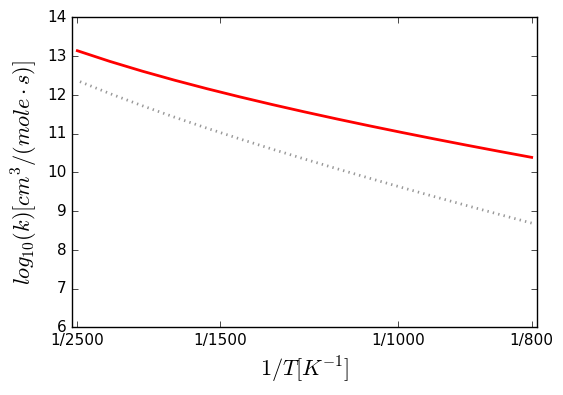


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.70337e-05,'cm^3/(mol*s)'), n=4.45754, Ea=(9.44368,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29189, dn = +|- 0.0336117, dEa = +|- 0.184898 kJ/mol""")
CC5H11O2 + H2O2 <=> CC5H11O2H + HO2


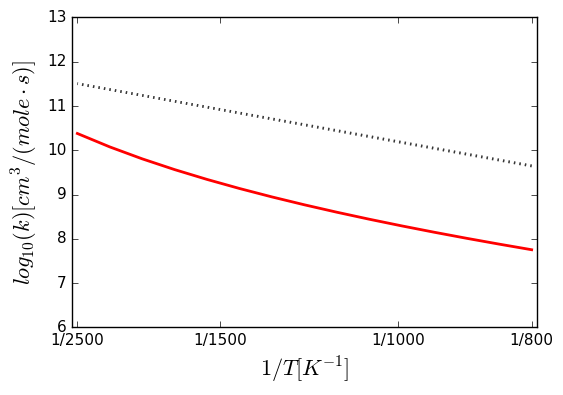


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.14605e-05,'cm^3/(mol*s)'), n=5.00343, Ea=(35.0264,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11752, dn = +|- 0.0145822, dEa = +|- 0.0802164 kJ/mol""")
COCOCOC*O + HO2 <=> COCOCjOC*O + H2O2


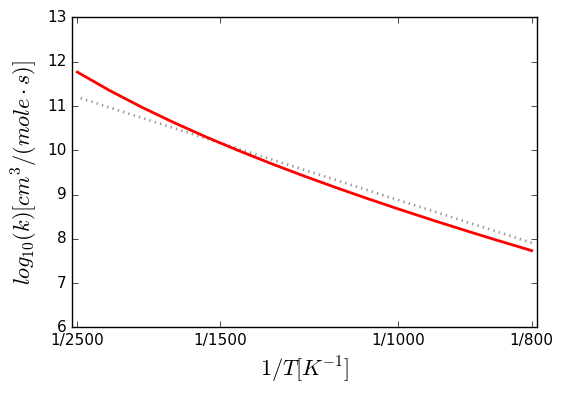


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.14605e-05,'cm^3/(mol*s)'), n=5.00343, Ea=(35.0264,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11752, dn = +|- 0.0145822, dEa = +|- 0.0802164 kJ/mol""")
COCOCOC*O + HO2 <=> COCOCOCj*O + H2O2


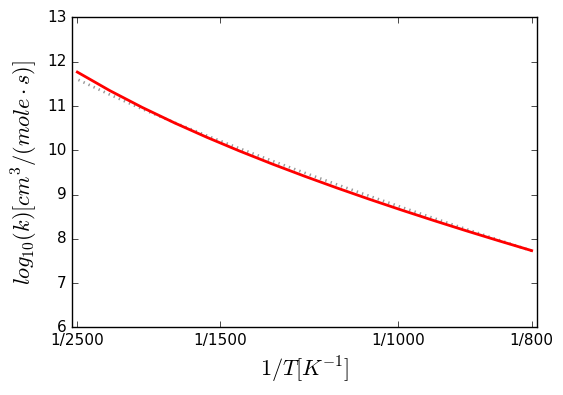


Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20430,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.14605e-05,'cm^3/(mol*s)'), n=5.00343, Ea=(35.0264,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11752, dn = +|- 0.0145822, dEa = +|- 0.0802164 kJ/mol""")
COCOCOC*O + HO2 <=> CjOCOCOC*O + H2O2


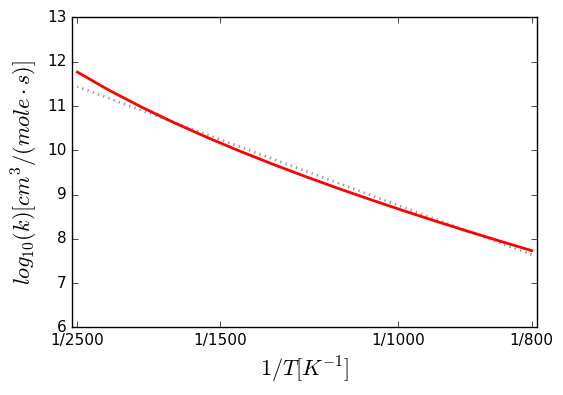


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.14605e-05,'cm^3/(mol*s)'), n=5.00343, Ea=(35.0264,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11752, dn = +|- 0.0145822, dEa = +|- 0.0802164 kJ/mol""")
COCOCOC*O + HO2 <=> COCjOCOC*O + H2O2


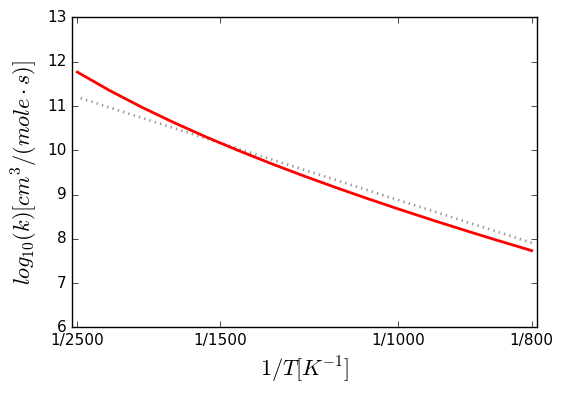


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3

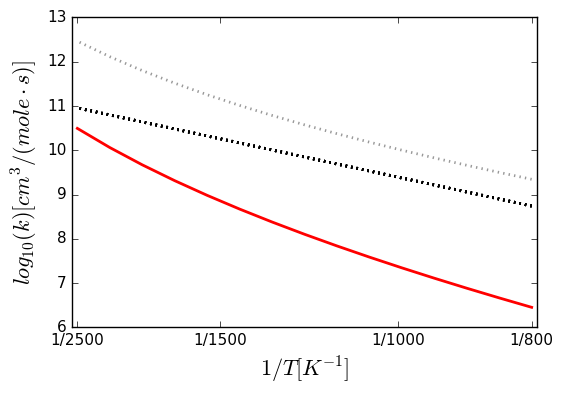


Arrhenius(A=(0.0307,'cm^3/(mol*s)'), n=4.403, Ea=(13547.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.08079e-08,'cm^3/(mol*s)'), n=5.53033, Ea=(29.3721,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.27191, dn = +|- 0.107699, dEa = +|- 0.592453 kJ/mol""")
IC3H5CHO + HO2 <=> IC3H4CHO-A + H2O2


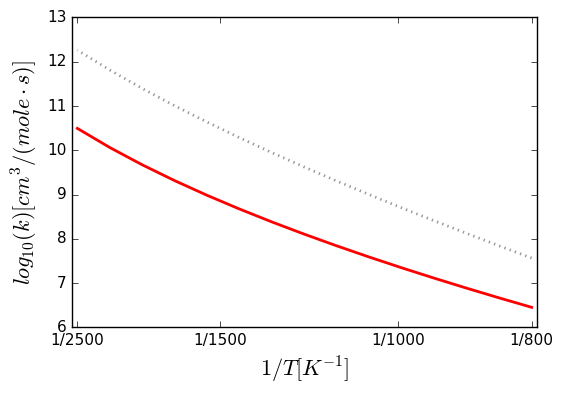


Arrhenius(A=(8e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.08079e-08,'cm^3/(mol*s)'), n=5.53033, Ea=(29.3721,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.27191, dn = +|- 0.107699, dEa = +|- 0.592453 kJ/mol""")
HO2 + IC3H5CHO => CO + NC3-QOOH


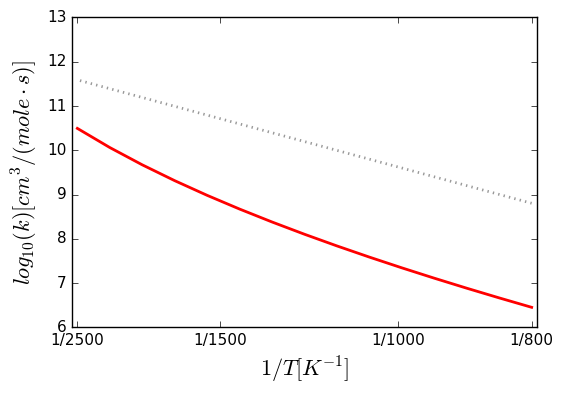


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0079161,'cm^3/(mol*s)'), n=3.94832, Ea=(34.833,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.10948, dn = +|- 0.0136348, dEa = +|- 0.0750051 kJ/mol""")
C6H13O2H-2 + HO2 <=> C6H13O2-2 + H2O2


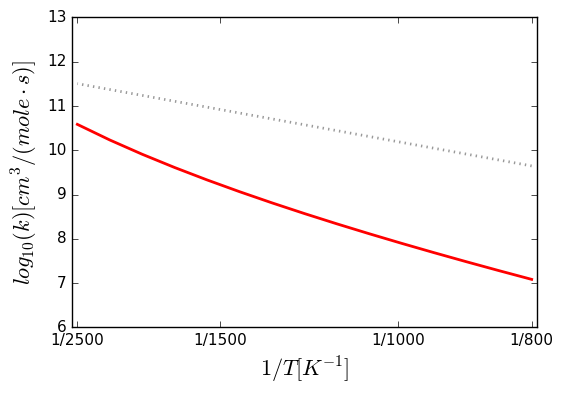


Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10533.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10533.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.8e+12,'cm^3/(mol*s)'), n=0, Ea=(100426,'J/mol'), T0=(1,'K'))
Arrhenius(A=(0.00562,'cm^3/(mol*s)'), n=4.12, Ea=(17400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(24000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(24000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10533.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(24000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10533.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10533.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(24000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10533.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, 

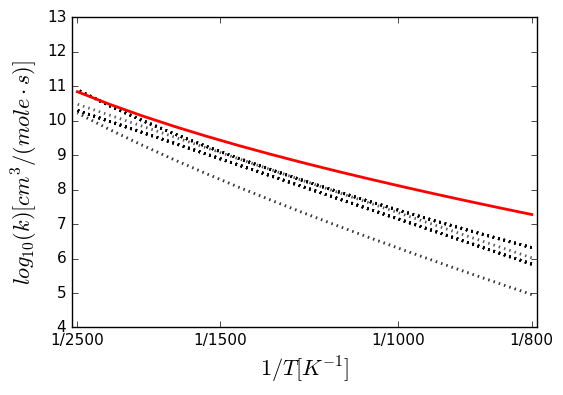


Arrhenius(A=(0.03986,'cm^3/(mol*s)'), n=4.3, Ea=(15333,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.03986,'cm^3/(mol*s)'), n=4.3, Ea=(15333,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(24300,'cm^3/(mol*s)'), n=2.5, Ea=(66114.1,'J/mol'), T0=(1,'K'))
Arrhenius(A=(0.00904,'cm^3/(mol*s)'), n=4.54, Ea=(11967.9,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23790,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(12300,'cm^3/(mol*s)'), n=2.55, Ea=(15750,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.03986,'cm^3/(mol*s)'), n=4.3, Ea=(15333,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00904,'cm^3/(mol*s)'), n=4.54, Ea=(11967.9,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(12300,'cm^3/(mol*s)'), n=2.55, Ea=(15750,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.03986,'cm^3/(mol*s)'), n=4.3, Ea=(15333,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.03986,'cm^3/(mol*s)'), n=4.3, Ea=(15333,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23790,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.03986,'cm^3/(mol*s)'), n=4.3, Ea=(15

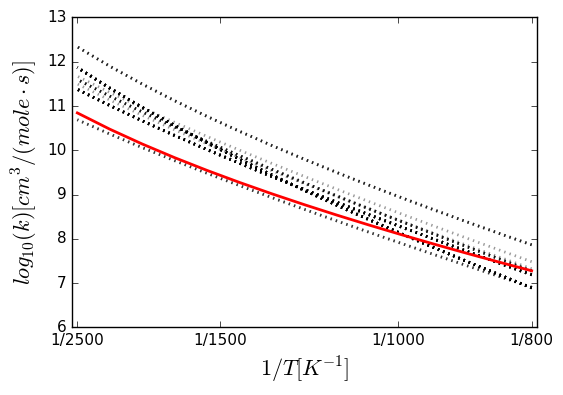


Arrhenius(A=(3.5e-05,'cm^3/(mol*s)'), n=5.26, Ea=(7475.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8200,'cm^3/(mol*s)'), n=2.5, Ea=(45191.9,'J/mol'), T0=(1,'K'))
Arrhenius(A=(0.028,'cm^3/(mol*s)'), n=4.32, Ea=(8530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+12,'cm^3/(mol*s)'), n=0, Ea=(16000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8200,'cm^3/(mol*s)'), n=2.55, Ea=(10750,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.028,'cm^3/(mol*s)'), n=4.32, Ea=(8530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.5e-05,'cm^3/(mol*s)'), n=5.26, Ea=(7475.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.028,'cm^3/(mol*s)'), n=4.32, Ea=(8530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8200,'cm^3/(mol*s)'), n=2.55, Ea=(10750,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.5e-05,'cm^3/(mol*s)'), n=5.26, Ea=(7475.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.5e-05,'cm^3/(mol*s)'), n=5.26, Ea=(7475.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+12,'cm^3/(mol*s)'), n=0, Ea=(16000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.5e-05,'cm^3/(mol*s)'), n=5.26, Ea=(7475.1,'cal/mo

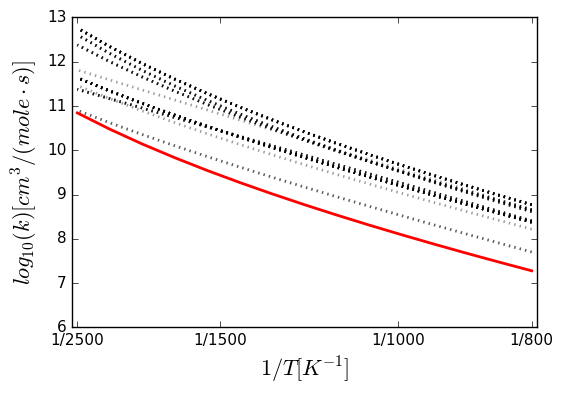


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.35705e-05,'cm^3/(mol*s)'), n=4.56732, Ea=(12.5778,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33487, dn = +|- 0.0379065, dEa = +|- 0.208524 kJ/mol""")
HO2 + CC8H17O2H <=> H2O2 + CC8H17O2


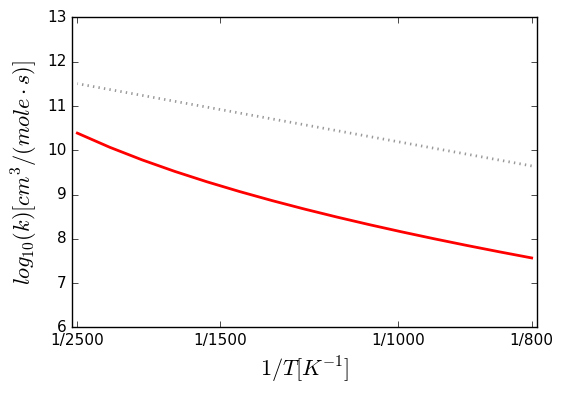


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.35705e-05,'cm^3/(mol*s)'), n=4.56732, Ea=(12.5778,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33487, dn = +|- 0.0379065, dEa = +|- 0.208524 kJ/mol""")
H2O2 + CC8H17O2 <=> HO2 + CC8H17O2H


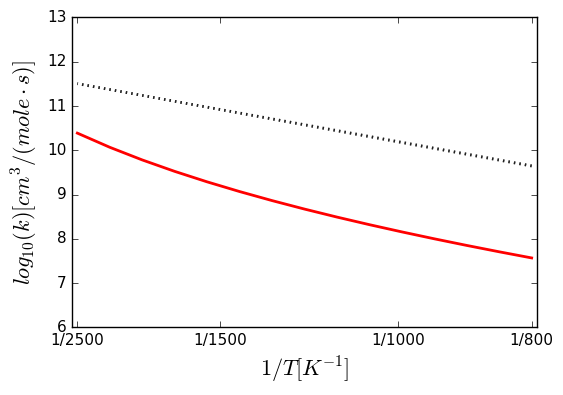


Arrhenius(A=(2.82e+06,'cm^3/(mol*s)'), n=1.97, Ea=(11380,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.45417e-07,'cm^3/(mol*s)'), n=5.18634, Ea=(16.1154,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.13967, dn = +|- 0.0998287, dEa = +|- 0.549158 kJ/mol""")
C4H6CHO1-44 + H2O2 <=> C4H7CHO1-4 + HO2


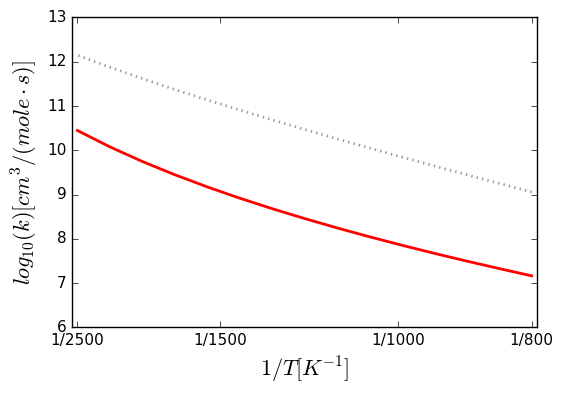


Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
MultiArrhenius(arrhenius=[Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K')), Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))])
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'),

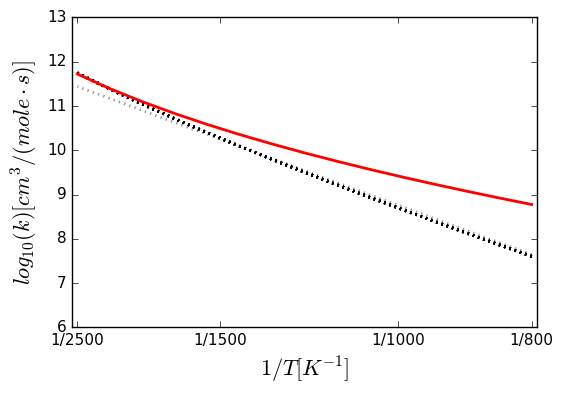


Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3

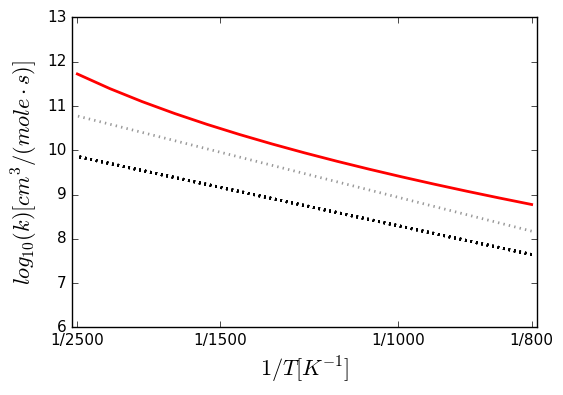


Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3

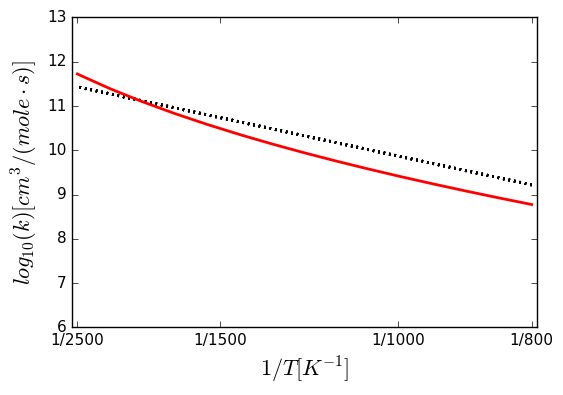


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00124586,'cm^3/(mol*s)'), n=4.32619, Ea=(31.3031,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29624, dn = +|- 0.0340533, dEa = +|- 0.187327 kJ/mol""")
F-GC6H12O + HO2 => TC4H8COCH3 + H2O2


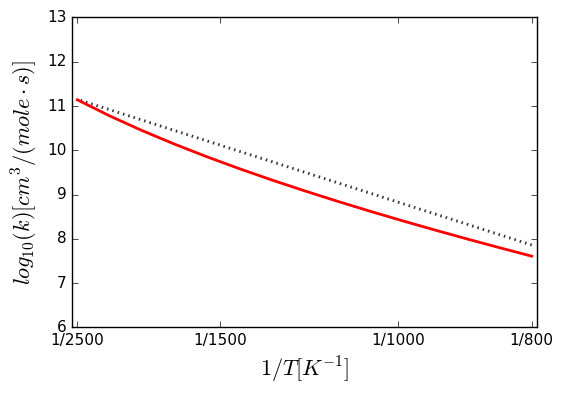


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00124586,'cm^3/(mol*s)'), n=4.32619, Ea=(31.3031,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29624, dn = +|- 0.0340533, dEa = +|- 0.187327 kJ/mol""")
F-GC6H12O + HO2 => IC5H10CHO-BC + H2O2


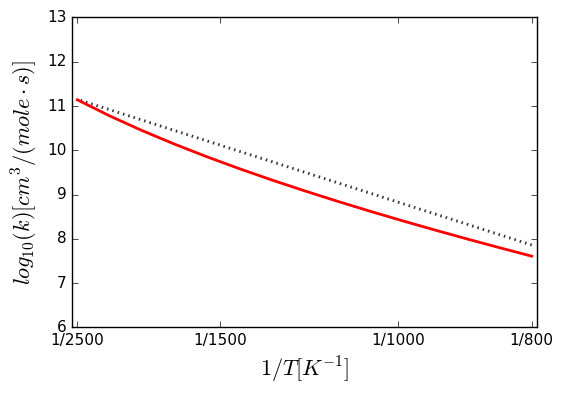


Arrhenius(A=(4.23e+12,'cm^3/(mol*s)'), n=-0.35, Ea=(12010,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00019398,'cm^3/(mol*s)'), n=4.21545, Ea=(7.10528,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.31598, dn = +|- 0.0360362, dEa = +|- 0.198235 kJ/mol""")
C4H7CO1-4 + H2O2 <=> C4H7CHO1-4 + HO2


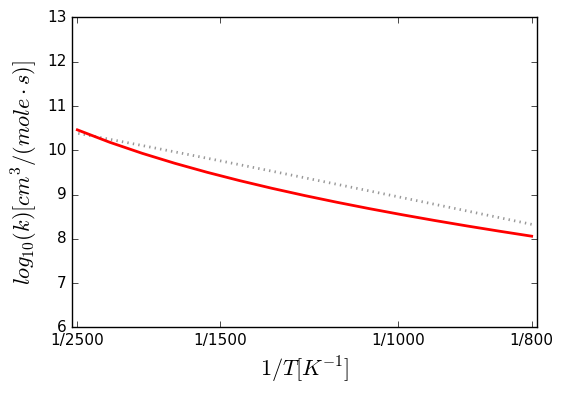


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000443381,'cm^3/(mol*s)'), n=4.44427, Ea=(55.459,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.26232, dn = +|- 0.0305729, dEa = +|- 0.168182 kJ/mol""")
BC5H11 + HO2 <=> BC5H11O + OH


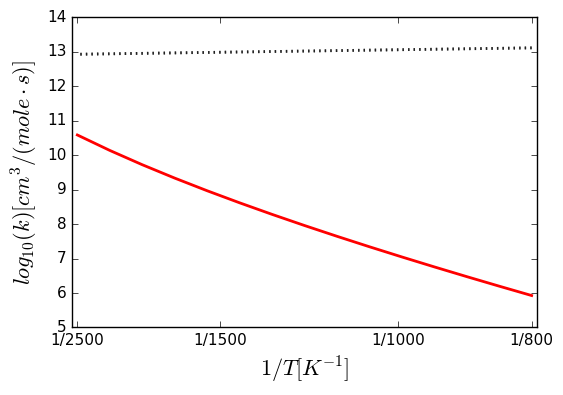


Arrhenius(A=(9.97e+12,'cm^3/(mol*s)'), n=-0.33, Ea=(8410,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00168842,'cm^3/(mol*s)'), n=3.74501, Ea=(-4.51447,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.02577, dn = +|- 0.00333976, dEa = +|- 0.0183721 kJ/mol""")
C6H13-1 + H2O2 <=> NC6H14 + HO2


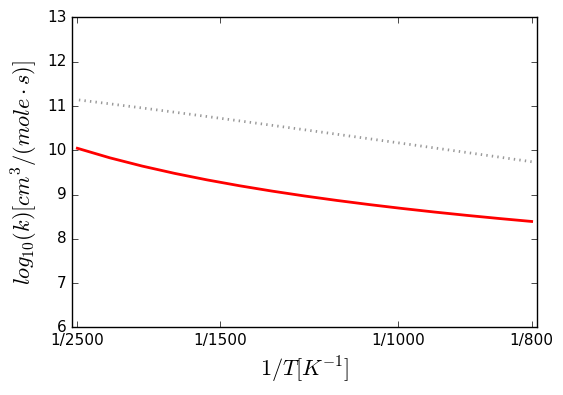


Arrhenius(A=(40950,'cm^3/(mol*s)'), n=2.5, Ea=(10204,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.71008e-09,'cm^3/(mol*s)'), n=5.78353, Ea=(19.9725,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.96911, dn = +|- 0.142824, dEa = +|- 0.785678 kJ/mol""")
PHCH2HCO + HO2 => PHCH2CO + H2O2


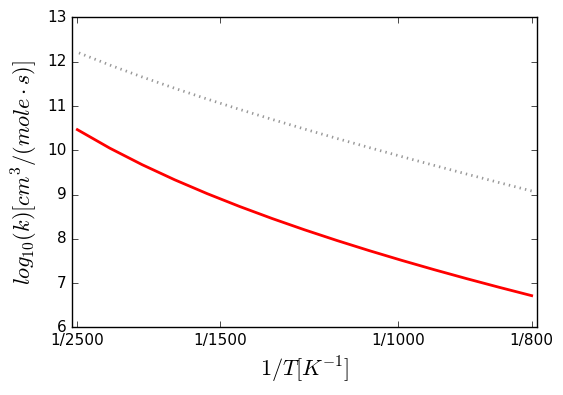


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'), comment="""Chemkin file stated explicit reverse rate: REV /  0.000E+00  0.00  0.000E+00 /""")
Arrhenius(A=(5.20202e-05,'cm^3/(mol*s)'), n=4.62674, Ea=(65.5362,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.37729, dn = +|- 0.0420128, dEa = +|- 0.231112 kJ/mol""")
sc4h8oh-2 + ho2 => sc4h8oh-2o + oh


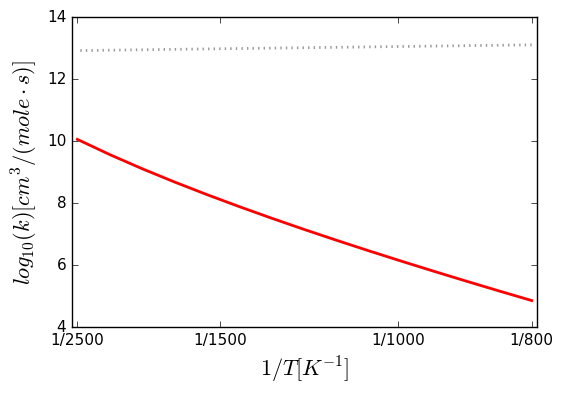


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000703518,'cm^3/(mol*s)'), n=4.31598, Ea=(45.4863,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.22582, dn = +|- 0.0267223, dEa = +|- 0.146999 kJ/mol""")
c4h8oh-1 + ho2 <=> c4h8oh-1o + oh


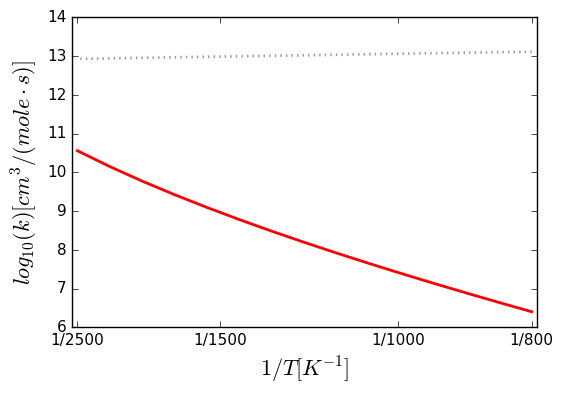


Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0.5, Ea=(42200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.157187,'cm^3/(mol*s)'), n=3.88415, Ea=(172.848,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.27655, dn = +|- 0.0320435, dEa = +|- 0.176271 kJ/mol""")
hoc2h4cho + o2 <=> hoc2h4co + ho2


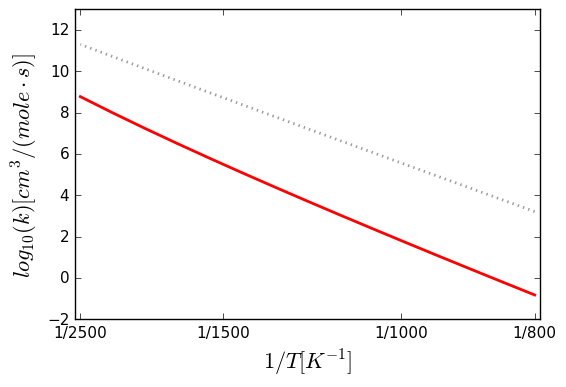


Arrhenius(A=(8.44e+14,'cm^3/(mol*s)'), n=0, Ea=(22256.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000214091,'cm^3/(mol*s)'), n=4.66984, Ea=(21.3089,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.61529, dn = +|- 0.0629319, dEa = +|- 0.346188 kJ/mol""")
A1CH3CH3 + CH3 <=> A1CH3CH2 + CH4


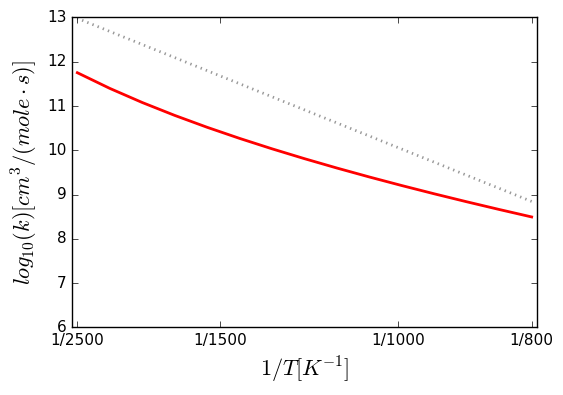


Arrhenius(A=(2.11e+13,'cm^3/(mol*s)'), n=-0.55, Ea=(6080,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000277314,'cm^3/(mol*s)'), n=4.09185, Ea=(-1.55851,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.1501, dn = +|- 0.0183539, dEa = +|- 0.100965 kJ/mol""")
TC4H9COC2H4S + H2O2 <=> TC4H9COC2H5 + HO2


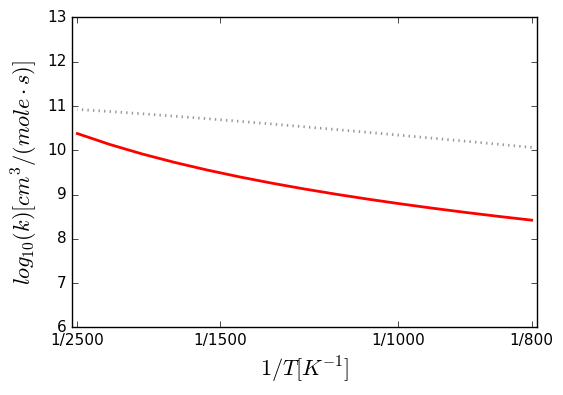


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00270461,'cm^3/(mol*s)'), n=4.07938, Ea=(42.8584,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.1182, dn = +|- 0.0146627, dEa = +|- 0.0806594 kJ/mol""")
nc7h15cho + ho2 <=> nc7h15co + h2o2


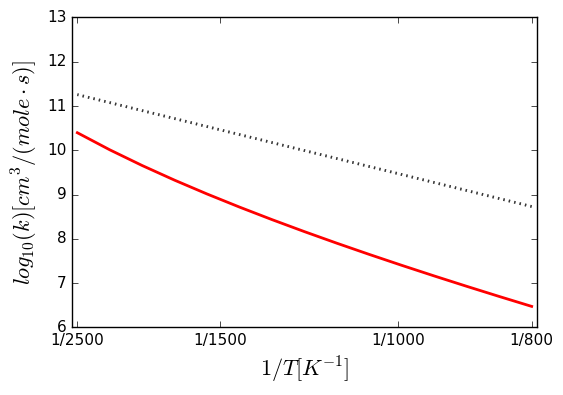


Arrhenius(A=(9490,'cm^3/(mol*s)'), n=2.6, Ea=(13862.3,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.50381e-08,'cm^3/(mol*s)'), n=5.67296, Ea=(15.8252,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.65616, dn = +|- 0.128207, dEa = +|- 0.705266 kJ/mol""")
MCH13DIEN + HO2 <=> MCH13NCH2J + H2O2


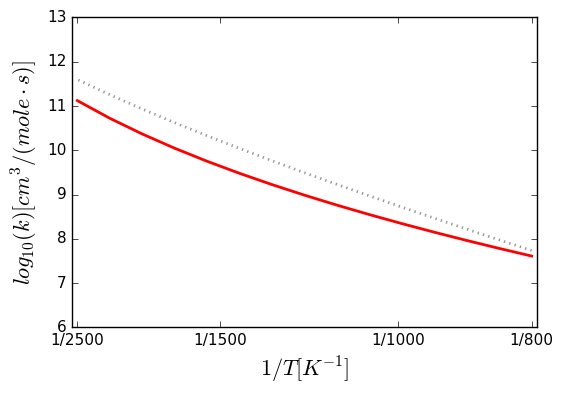


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.50381e-08,'cm^3/(mol*s)'), n=5.67296, Ea=(15.8252,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.65616, dn = +|- 0.128207, dEa = +|- 0.705266 kJ/mol""")
MCH13DIEN + HO2 <=> MCH13N6J + H2O2


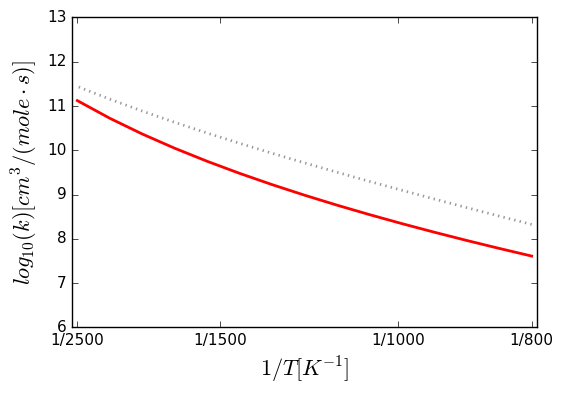


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.50381e-08,'cm^3/(mol*s)'), n=5.67296, Ea=(15.8252,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.65616, dn = +|- 0.128207, dEa = +|- 0.705266 kJ/mol""")
MCH13DIEN + HO2 <=> MCH13N5J + H2O2


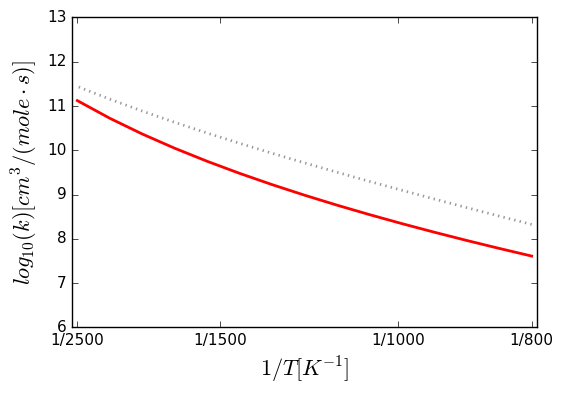


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9490,'cm^3/(mol*s)'), n=2.6, Ea=(13862.3,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.50381e-08,'cm^3/(mol*s)'), n=5.67296, Ea=(15.8252,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.65616, dn = +|- 0.128207, dEa = +|- 0.705266 kJ/mol""")
MCH13DIEN + HO2 <=> MCH13NCH2J + H2O2


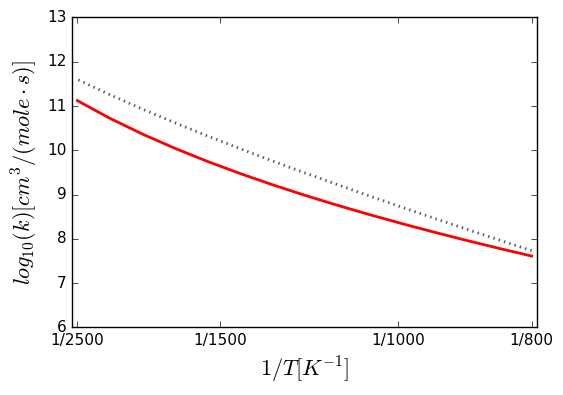


Arrhenius(A=(0.317,'cm^3/(mol*s)'), n=3.71, Ea=(2483,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00535033,'cm^3/(mol*s)'), n=3.76176, Ea=(-3.19931,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.04351, dn = +|- 0.0055897, dEa = +|- 0.030749 kJ/mol""")
C5H11-2 + H2O2 <=> NC5H12 + HO2


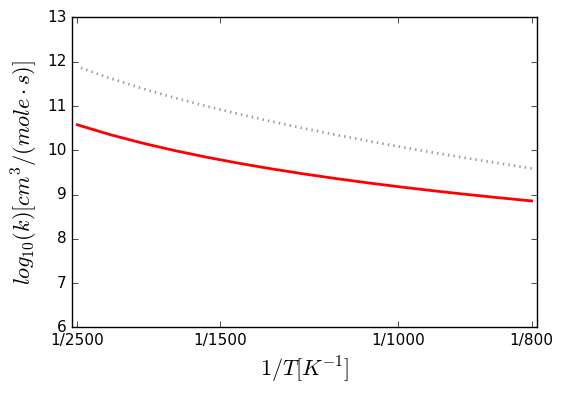


Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(783000,'cm^3/(mol*s)'), n=2.05, Ea=(13

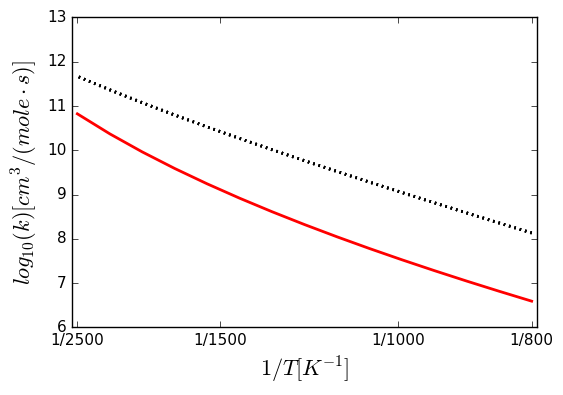


Arrhenius(A=(1.45e-05,'cm^3/(mol*s)'), n=5.26, Ea=(8267.91,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.37166e-09,'cm^3/(mol*s)'), n=5.75426, Ea=(31.1394,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.74682, dn = +|- 0.132612, dEa = +|- 0.729496 kJ/mol""")
IC4H7OH + HO2 <=> IC4H6OH + H2O2


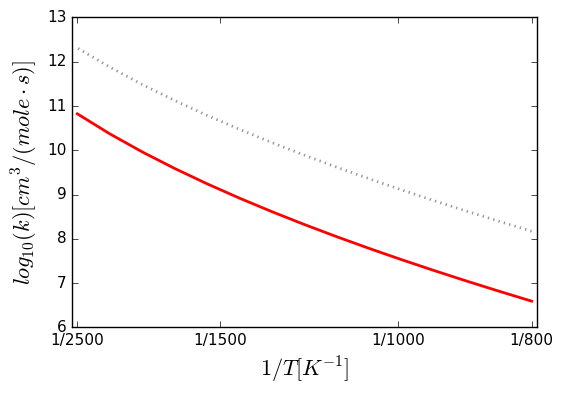


Arrhenius(A=(7644,'cm^3/(mol*s)'), n=2.712, Ea=(13930,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(792.2,'cm^3/(mol*s)'), n=2.98, Ea=(12300,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7644,'cm^3/(mol*s)'), n=2.712, Ea=(13930,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7644,'cm^3/(mol*s)'), n=2.71, Ea=(13930,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7644,'cm^3/(mol*s)'), n=2.712, Ea=(13930,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7644,'cm^3/(mol*s)'), n=2.712, Ea=(13930,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.37166e-09,'cm^3/(mol*s)'), n=5.75426, Ea=(31.1394,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.74682, dn = +|- 0.132612, dEa = +|- 0.729496 kJ/mol""")
ic4h7oh + ho2 <=> ic4h6oh + h2o2


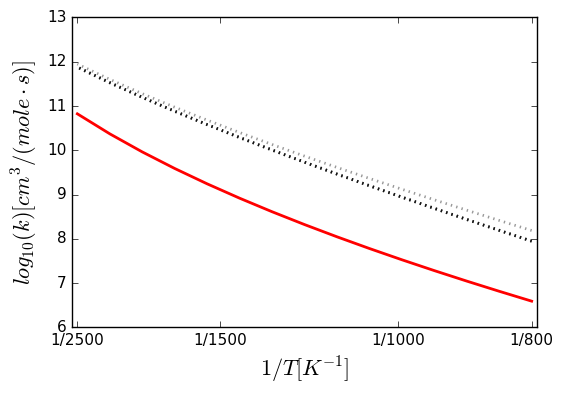


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.45305e-06,'cm^3/(mol*s)'), n=4.76111, Ea=(24.5531,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.49941, dn = +|- 0.0531621, dEa = +|- 0.292445 kJ/mol""")
ROOH1 + HO2 <=> RO21 + H2O2


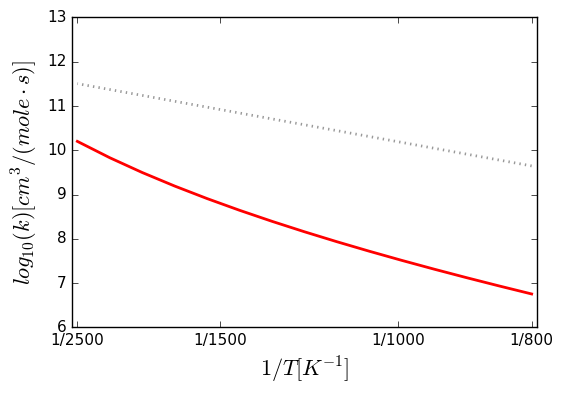


Arrhenius(A=(1.03e+13,'cm^3/(mol*s)'), n=-0.57, Ea=(9337,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.5612e-08,'cm^3/(mol*s)'), n=5.63323, Ea=(25.7729,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.52069, dn = +|- 0.121336, dEa = +|- 0.667472 kJ/mol""")
CH3CHCHO + H2O2 <=> C2H5CHO + HO2


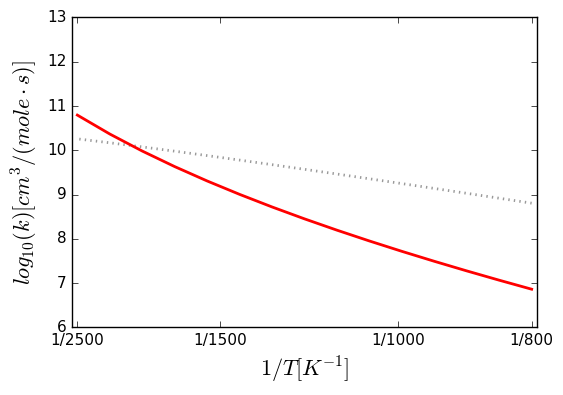


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.64583e-06,'cm^3/(mol*s)'), n=5.84699, Ea=(55.5868,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.55717, dn = +|- 0.0581227, dEa = +|- 0.319733 kJ/mol""")
me2*om*o + ho2 <=> me2j*om*o + h2o2


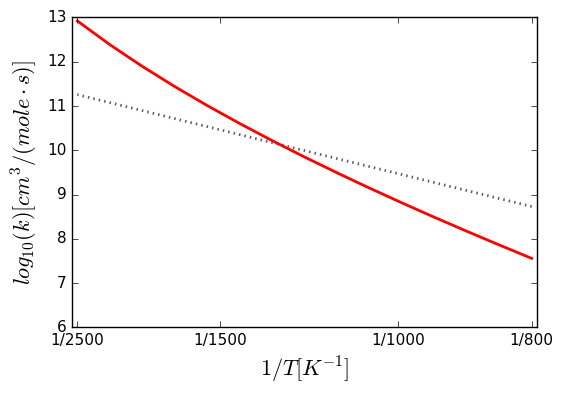


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.64583e-06,'cm^3/(mol*s)'), n=5.84699, Ea=(55.5868,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.55717, dn = +|- 0.0581227, dEa = +|- 0.319733 kJ/mol""")
me2*om*o + ho2 <=> me2*omj*o + h2o2


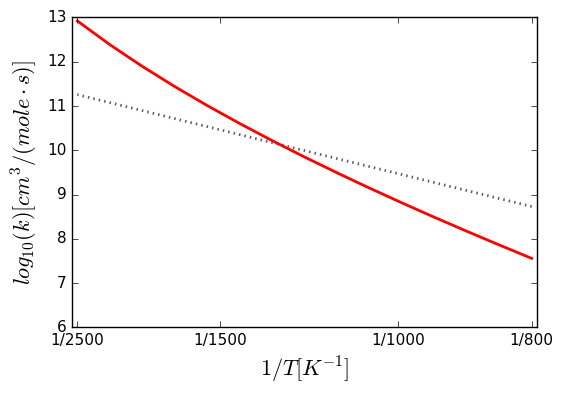


Arrhenius(A=(0.329,'cm^3/(mol*s)'), n=3.71, Ea=(2491,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00120756,'cm^3/(mol*s)'), n=3.76885, Ea=(-3.94595,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.03818, dn = +|- 0.00491811, dEa = +|- 0.0270545 kJ/mol""")
C5H11-3 + H2O2 <=> NC5H12 + HO2


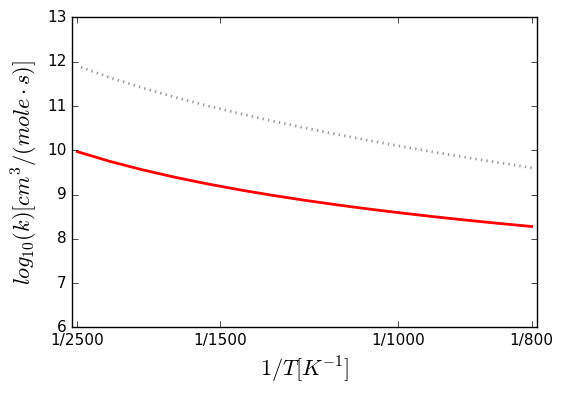


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00320166,'cm^3/(mol*s)'), n=4.22942, Ea=(43.0166,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.18488, dn = +|- 0.0222636, dEa = +|- 0.122472 kJ/mol""")
C4H9Ob + HO2 <=> C4H9ObO + OH


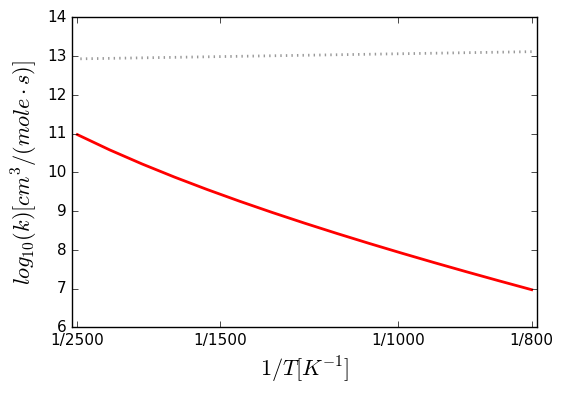


Arrhenius(A=(3290,'cm^3/(mol*s)'), n=2.51, Ea=(6362,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0322274,'cm^3/(mol*s)'), n=3.47207, Ea=(-6.22827,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.09536, dn = +|- 0.0119543, dEa = +|- 0.0657606 kJ/mol""")
C5H10CHO-4 + H2O2 <=> NC5H11CHO + HO2


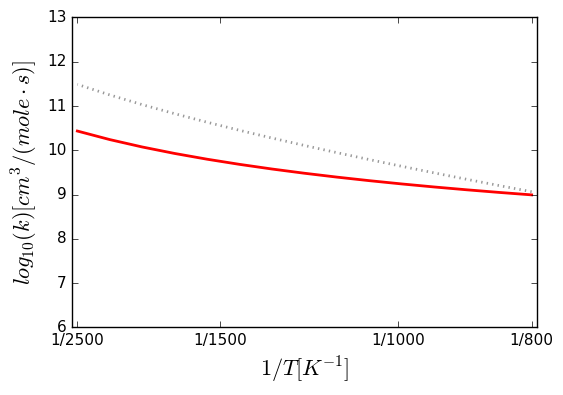


Arrhenius(A=(2.66e+11,'cm^3/(mol*s)'), n=0, Ea=(11269,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.14727e-07,'cm^3/(mol*s)'), n=5.33872, Ea=(12.931,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.20758, dn = +|- 0.10393, dEa = +|- 0.571717 kJ/mol""")
PHC4H7-2 + HO2 <=> BPHC4H6-3 + H2O2


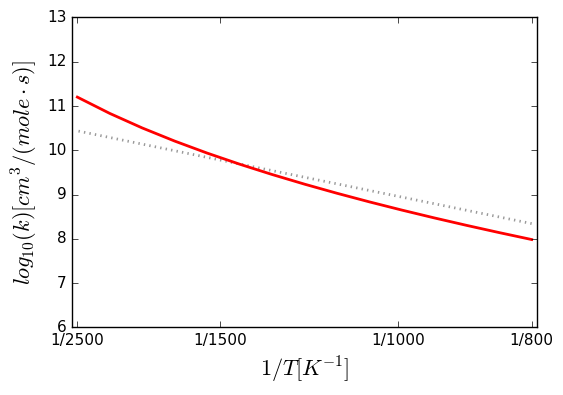


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000279564,'cm^3/(mol*s)'), n=4.46761, Ea=(62.4534,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29422, dn = +|- 0.0338483, dEa = +|- 0.1862 kJ/mol""")
ic4h8oh-1 + ho2 <=> ic4h8oh-1o + oh


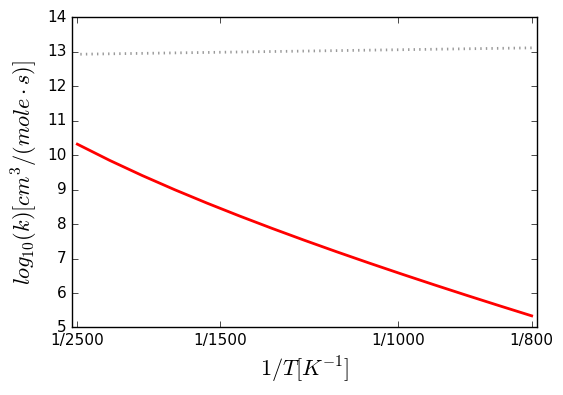


Arrhenius(A=(4.25e+11,'cm^3/(mol*s)'), n=-0.51, Ea=(11160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.41526e-09,'cm^3/(mol*s)'), n=5.42421, Ea=(33.2591,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.65211, dn = +|- 0.128006, dEa = +|- 0.704164 kJ/mol""")
C5H10CHO2-2 + H2O2 <=> NC5H11CHO-2 + HO2


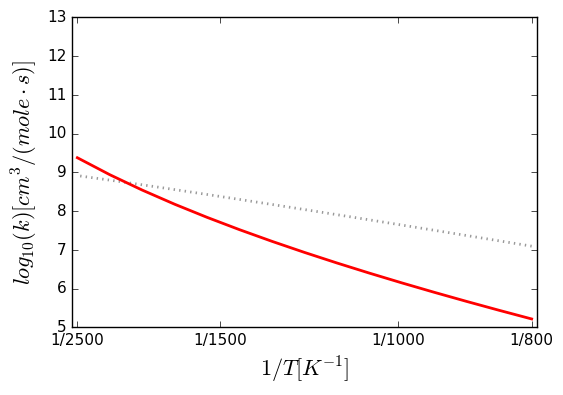


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00280369,'cm^3/(mol*s)'), n=3.96221, Ea=(48.9636,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08191, dn = +|- 0.0103322, dEa = +|- 0.0568373 kJ/mol""")
mp3*o2*o + ho2 <=> mp3j*o2*o + h2o2


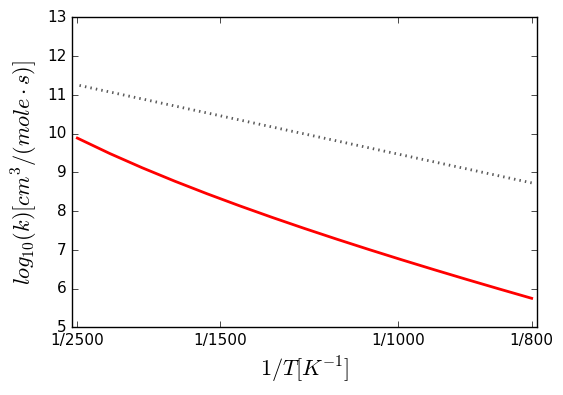


Arrhenius(A=(18390,'cm^3/(mol*s)'), n=2, Ea=(6028.4,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18390,'cm^3/(mol*s)'), n=2, Ea=(6028.4,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18390,'cm^3/(mol*s)'), n=2, Ea=(6028.4,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13215e-07,'cm^3/(mol*s)'), n=5.33323, Ea=(45.1551,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.08967, dn = +|- 0.0967257, dEa = +|- 0.532088 kJ/mol""")
CH2CHO + H2O2 => CH3CHO + HO2


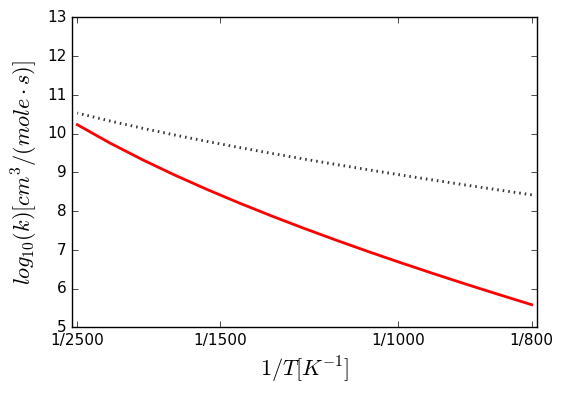


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13215e-07,'cm^3/(mol*s)'), n=5.33323, Ea=(45.1551,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.08967, dn = +|- 0.0967257, dEa = +|- 0.532088 kJ/mol""")
CH3CHO + HO2 <=> CH2CHO + H2O2


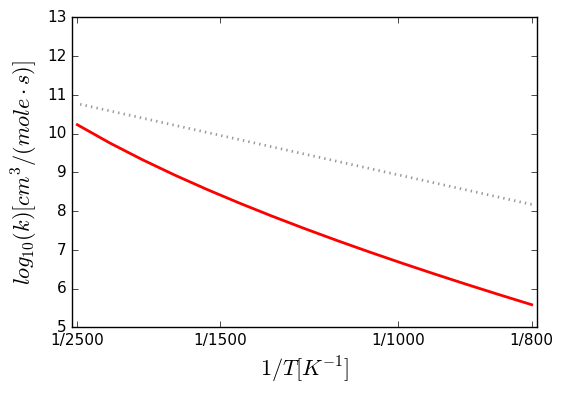


Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(49886.8,'J/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11940,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'

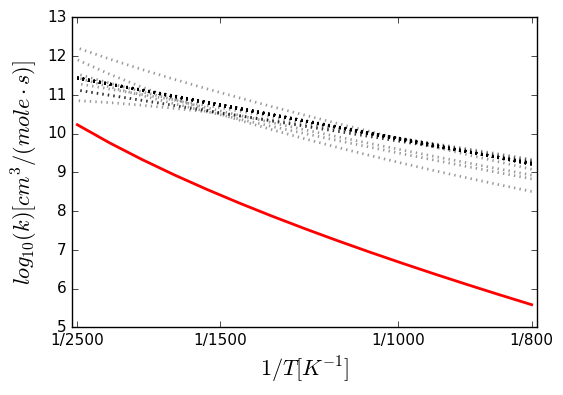


Arrhenius(A=(2.32e+11,'cm^3/(mol*s)'), n=0.4, Ea=(62348.1,'J/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(161600,'cm^3/(mol*s)'), n=2, Ea=(14178.4,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11923,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.32e+11,'cm^3/(mol*s)'), n=0.4, Ea=(14864,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.32e+11,'cm^3/(mol*s)'), n=0.4, Ea=(14864,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(161600,'cm^3/(mol*s)'), n=2, Ea=(14178.4,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13215e-07,'cm^3/(mol*s)'), n=5.33323, Ea=(45.1551,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.08967, dn = +|- 0.0967257, dEa = +|- 0.532088 kJ/mol""")
CH3CHO + HO2 <=> CH2HCO + H2O2


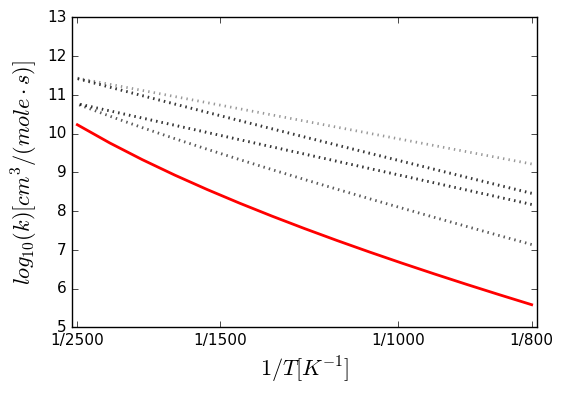


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000131451,'cm^3/(mol*s)'), n=4.32836, Ea=(3.89532,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 5

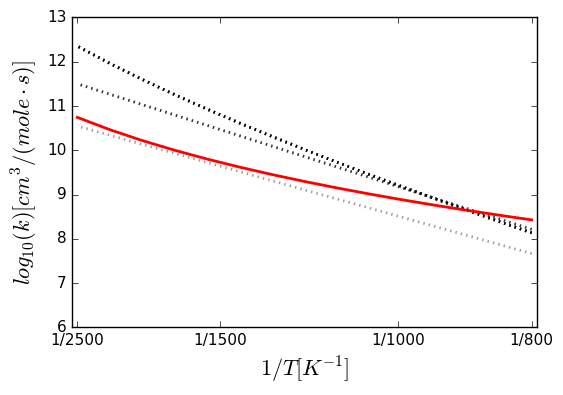


Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(61100,'cm^3/(mol*s)'), n=2.65, Ea=(17495.9,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(431000,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
MultiArrhenius(arrhenius=[Arrhenius(A=(1.2e+12,'cm^3/(mol*s)'), n=0, Ea=(17000,'cal/mol'), T0=(1,'K')), Arrhenius(A=(1.2e+12,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))])
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.

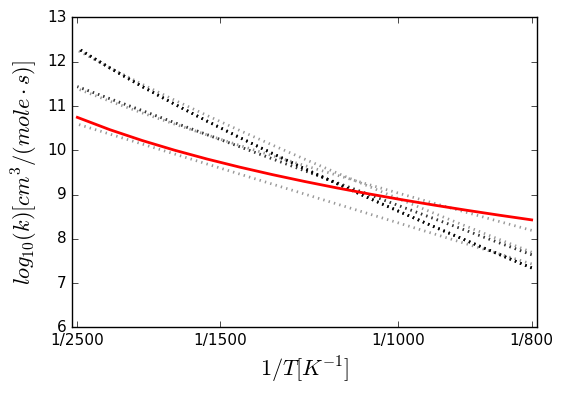


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000131451,'cm^3/(mol*s)'), n=4.32836, Ea=(3.89532,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data p

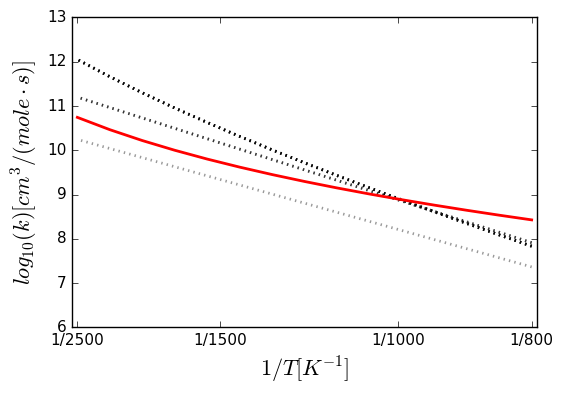


Arrhenius(A=(2.48,'cm^3/(mol*s)'), n=3.53, Ea=(3490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000131451,'cm^3/(mol*s)'), n=4.32836, Ea=(3.89532,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.38375, dn = +|- 0.0426272, dEa = +|- 0.234492 kJ/mol""")
C5H11-1 + H2O2 <=> NC5H12 + HO2


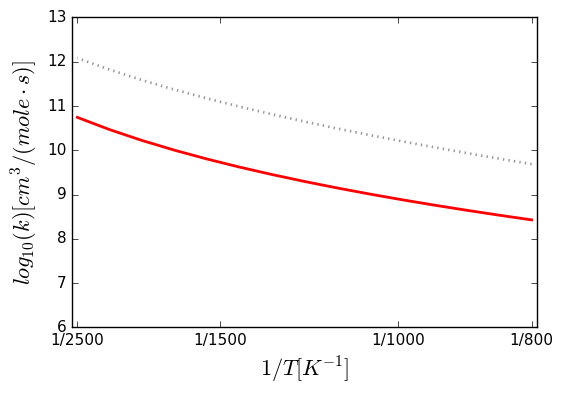


Arrhenius(A=(3.42e+12,'cm^3/(mol*s)'), n=-0.51, Ea=(11170,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.59925e-09,'cm^3/(mol*s)'), n=5.39848, Ea=(30.8536,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.54257, dn = +|- 0.122471, dEa = +|- 0.673713 kJ/mol""")
C4H8CHO2-2 + H2O2 <=> NC4H9CHO-2 + HO2


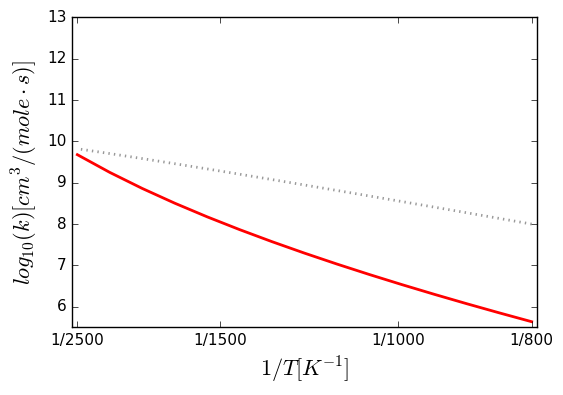


Arrhenius(A=(1.72e+06,'cm^3/(mol*s)'), n=1.8, Ea=(19710,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(901.333,'cm^3/(mol*s)'), n=2.96466, Ea=(-1.23006,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.03355, dn = +|- 0.00433106, dEa = +|- 0.0238252 kJ/mol""")
AC8H17 + H2O <=> IC8H18 + OH


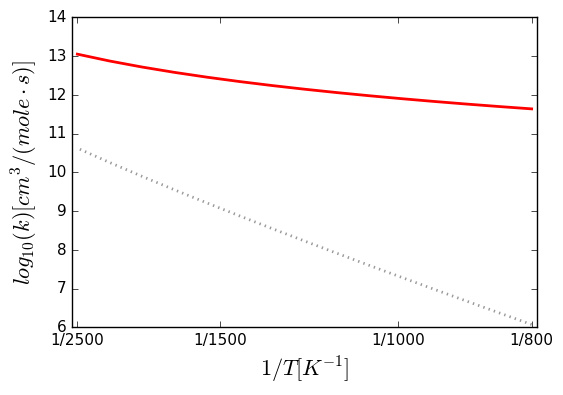


Arrhenius(A=(4.65e+13,'cm^3/(mol*s)'), n=-0.65, Ea=(6200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.40884e-08,'cm^3/(mol*s)'), n=5.66958, Ea=(31.1274,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.54681, dn = +|- 0.122689, dEa = +|- 0.674914 kJ/mol""")
NC3H7COC2H4S + H2O2 <=> NC3H7COC2H5 + HO2


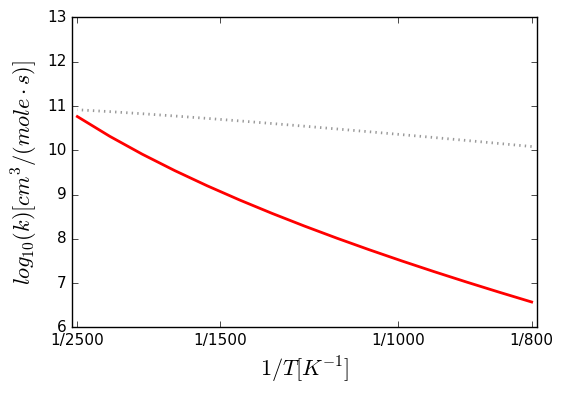


Arrhenius(A=(29900,'cm^3/(mol*s)'), n=2.21, Ea=(3472,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.91179e-06,'cm^3/(mol*s)'), n=4.62957, Ea=(6.30584,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.57184, dn = +|- 0.059353, dEa = +|- 0.326501 kJ/mol""")
NEOC5H11COCH2 + H2O2 <=> NEOC5H11COCH3 + HO2


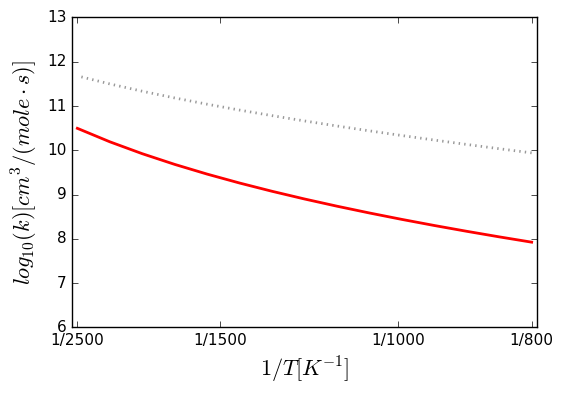


Arrhenius(A=(3.37e+11,'cm^3/(mol*s)'), n=0.05, Ea=(8142,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000794784,'cm^3/(mol*s)'), n=4.26562, Ea=(43.7449,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.19017, dn = +|- 0.0228487, dEa = +|- 0.125691 kJ/mol""")
C3H6COCH3-2 + H2O2 <=> NC3H7COCH3 + HO2


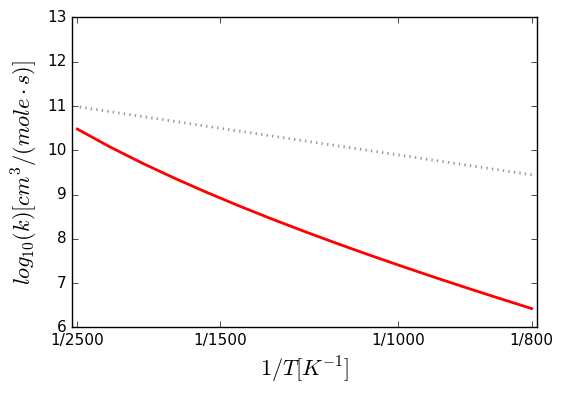


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0205598,'cm^3/(mol*s)'), n=3.98643, Ea=(42.2858,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08429, dn = +|- 0.0106205, dEa = +|- 0.0584232 kJ/mol""")
PHC4H9 + HO2 <=> DPHC4H8 + H2O2


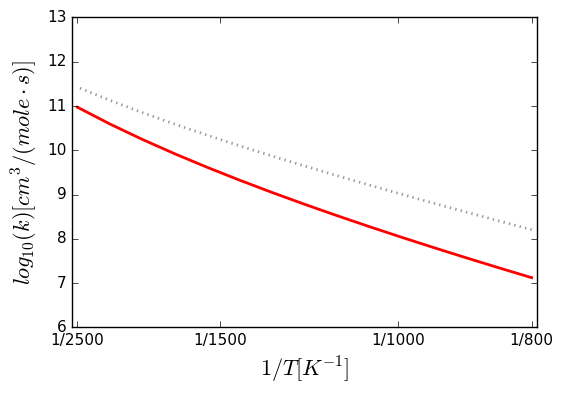


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0205598,'cm^3/(mol*s)'), n=3.98643, Ea=(42.2858,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08429, dn = +|- 0.0106205, dEa = +|- 0.0584232 kJ/mol""")
PHC4H9 + HO2 <=> BPHC4H8 + H2O2


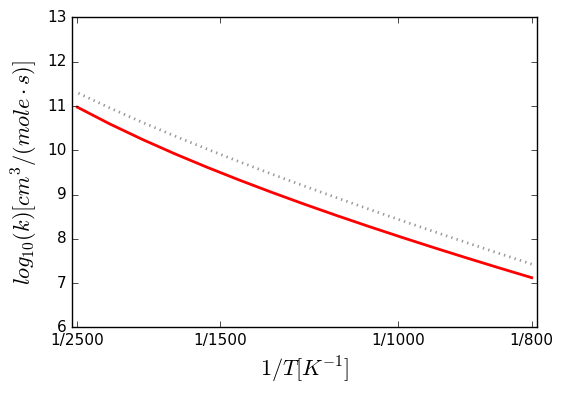


Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16494,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0205598,'cm^3/(mol*s)'), n=3.98643, Ea=(42.2858,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08429, dn = +|- 0.0106205, dEa = +|- 0.0584232 kJ/mol""")
PHC4H9 + HO2 <=> APHC4H8 + H2O2


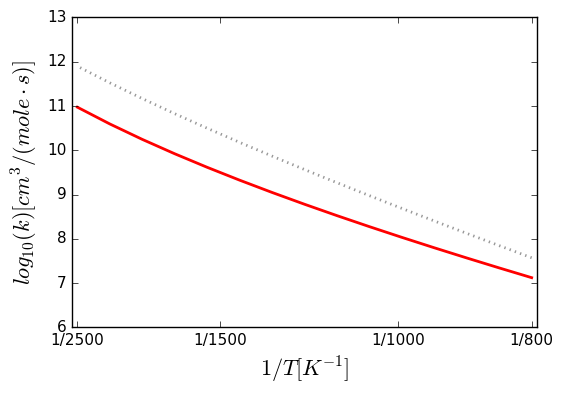


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0205598,'cm^3/(mol*s)'), n=3.98643, Ea=(42.2858,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08429, dn = +|- 0.0106205, dEa = +|- 0.0584232 kJ/mol""")
PHC4H9 + HO2 <=> CPHC4H8 + H2O2


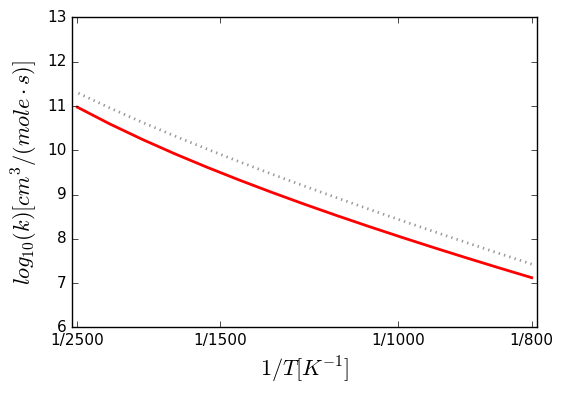


Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(17060,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.393e-08,'cm^3/(mol*s)'), n=5.74753, Ea=(28.6265,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.91819, dn = +|- 0.140554, dEa = +|- 0.773191 kJ/mol""")
THP-3-ene + HO2 <=> THP-234-enyl + H2O2


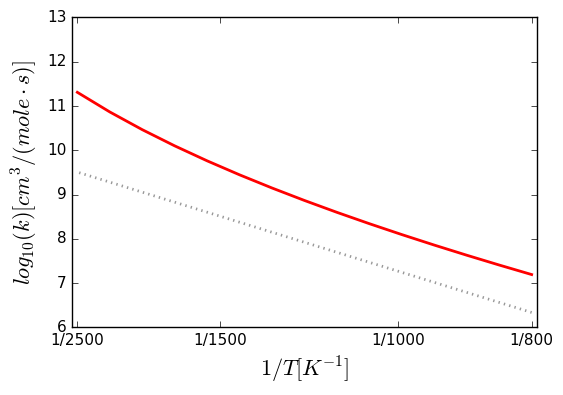


Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(17060,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.393e-08,'cm^3/(mol*s)'), n=5.74753, Ea=(28.6265,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.91819, dn = +|- 0.140554, dEa = +|- 0.773191 kJ/mol""")
THP-3-ene + HO2 <=> THP-345-enyl + H2O2


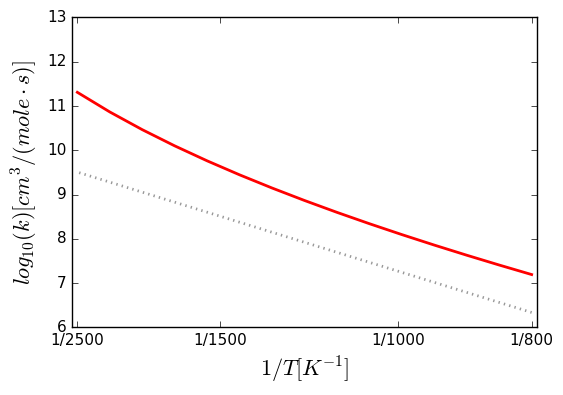


Arrhenius(A=(9.96e+06,'cm^3/(mol*s)'), n=1.66, Ea=(15210,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.42556e-05,'cm^3/(mol*s)'), n=4.32766, Ea=(3.76401,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.38785, dn = +|- 0.0430153, dEa = +|- 0.236627 kJ/mol""")
AC3H4CH2COCH3 + H2O2 <=> IC4H7COCH3 + HO2


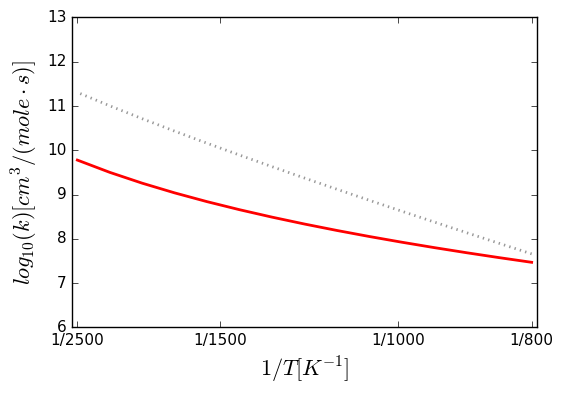


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00665314,'cm^3/(mol*s)'), n=4.38948, Ea=(40.4979,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28433, dn = +|- 0.032841, dEa = +|- 0.180658 kJ/mol""")
ic7h15cho + ho2 <=> ic7h15co + h2o2


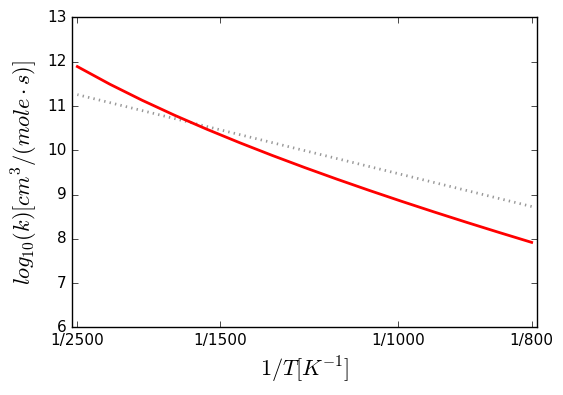


Arrhenius(A=(6.82e+12,'cm^3/(mol*s)'), n=-0.51, Ea=(11160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.17611e-09,'cm^3/(mol*s)'), n=6.37963, Ea=(17.6927,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.23777, dn = +|- 0.105712, dEa = +|- 0.581523 kJ/mol""")
TC3H6COCH3 + H2O2 <=> IC3H7COCH3 + HO2


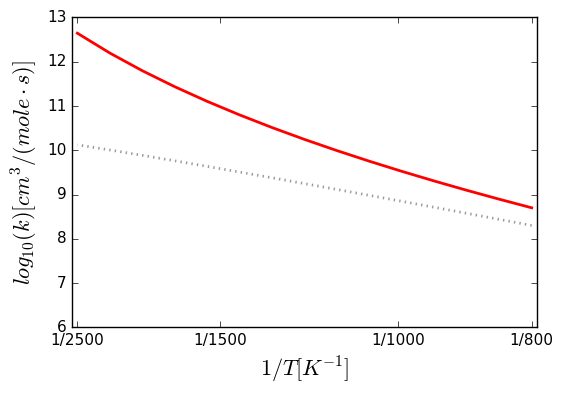


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000273708,'cm^3/(mol*s)'), n=4.09892, Ea=(41.1491,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.1198, dn = +|- 0.0148497, dEa = +|- 0.0816882 kJ/mol""")
nc8h17cho + ho2 <=> nc8h17co + h2o2


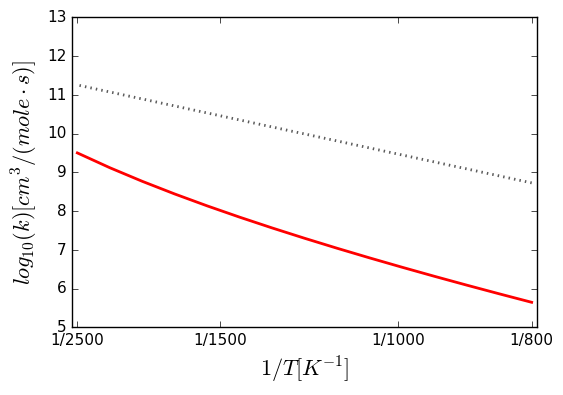


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257956,'cm^3/(mol*s)'), n=4.04846, Ea=(-1.78347,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15117, dn = +|- 0.0184754, dEa = +|- 0.101633 kJ/mol""")
IC4H9COCH3 + HO2 <=> IC4H9COCH2 + H2O2


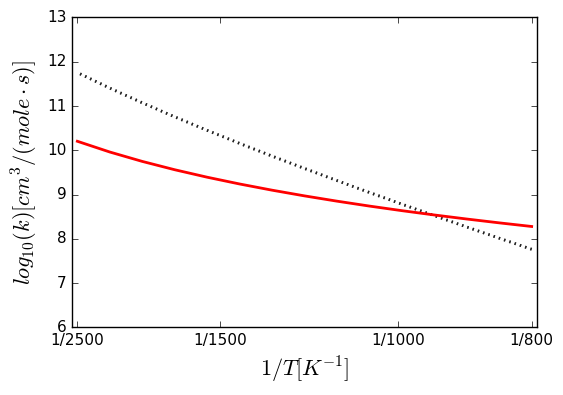


MultiArrhenius(arrhenius=[Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K')), Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))])
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257956,'cm^3/(mol*s)'), n=4.04846, Ea=(-1.78347,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15117, dn = +|- 0.0184754, dEa = +|- 0.101633 kJ/mol""")
IC4H9COCH3 + HO2 <=> IC3H7CHCOCH3 + H2O2


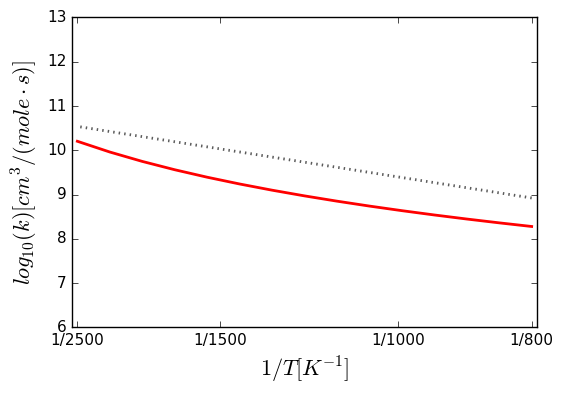


Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257956,'cm^3/(mol*s)'), n=4.04846, Ea=(-1.78347,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15117, dn = +|- 0.0184754, dEa = +|- 0.101633 kJ/mol""")
IC4H9COCH3 + HO2 <=> IC3H6CH2COCH3 + H2O2


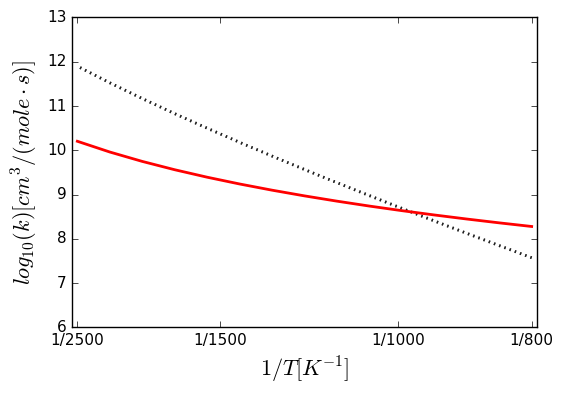


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(16000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(16000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(16000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(16000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257956,'cm^3/(mol*s)'), n=4.04846, Ea=(-1.78347,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15117, dn = +|- 0.0184754, dEa = +|- 0.101633 kJ/mol""")
IC4H9COCH3 + HO2 <=> TC3H6CH2COCH3 + H2O2


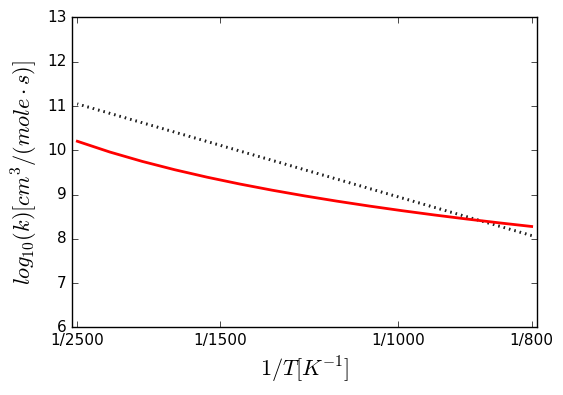


Arrhenius(A=(5.16e+10,'cm^3/(mol*s)'), n=0.26, Ea=(8442,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257956,'cm^3/(mol*s)'), n=4.04846, Ea=(-1.78347,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15117, dn = +|- 0.0184754, dEa = +|- 0.101633 kJ/mol""")
TC3H6CH2COCH3 + H2O2 <=> IC4H9COCH3 + HO2


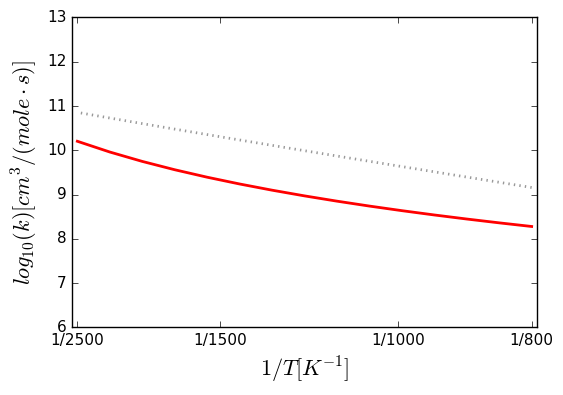


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm

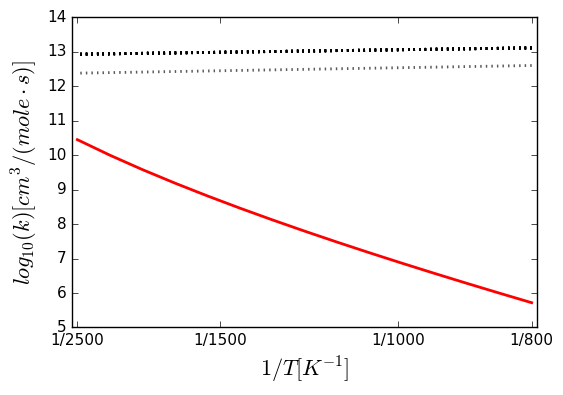


Arrhenius(A=(2.08e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.354e+10,'cm^3/(mol*s)'), n=0.285, Ea=(-59.03,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00121231,'cm^3/(mol*s)'), n=4.29582, Ea=(58.7337,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.20476, dn = +|- 0.0244477, dEa = +|- 0.134487 kJ/mol""")
HO2 + N-C3H7 => C3H8 + O2


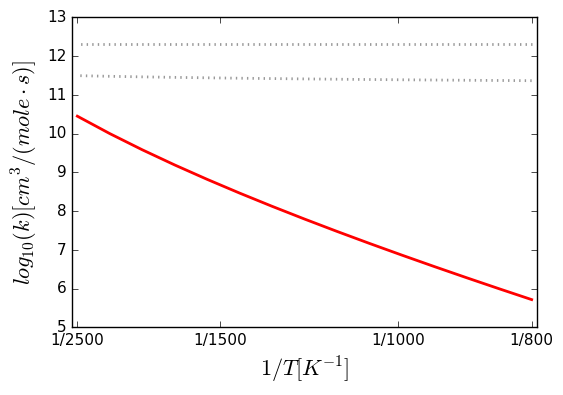


Arrhenius(A=(20600,'cm^3/(mol*s)'), n=2.5, Ea=(10205.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(20600,'cm^3/(mol*s)'), n=2.5, Ea=(10205.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.34514e-09,'cm^3/(mol*s)'), n=5.63527, Ea=(26.3041,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.62326, dn = +|- 0.126571, dEa = +|- 0.696268 kJ/mol""")
PRO13DIAL + HO2 <=> PRO13AL1J + H2O2


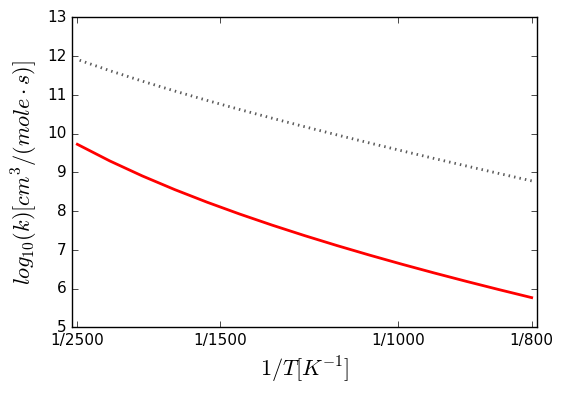


Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(24000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00161843,'cm^3/(mol*s)'), n=4.41608, Ea=(31.2187,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.34896, dn = +|- 0.0392853, dEa = +|- 0.216109 kJ/mol""")
ic3h7oh + ho2 <=> ic3h7o + h2o2


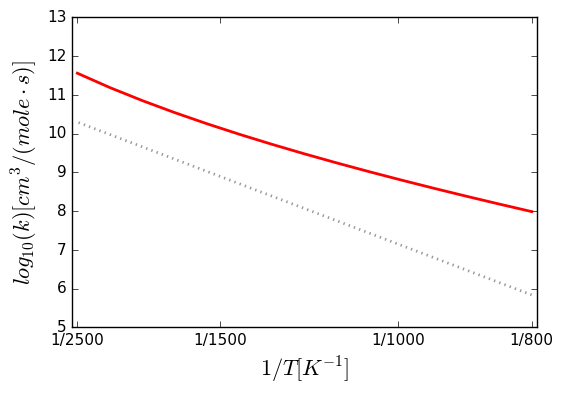


Arrhenius(A=(323300,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0226,'cm^3/(mol*s)'), n=4.52, Ea=(13850,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00161843,'cm^3/(mol*s)'), n=4.41608, Ea=(31.2187,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.34896, dn = +|- 0.0392853, dEa = +|- 0.216109 kJ/mol""")
HO2 + IC3H7OH => H2O2 + CH2CHOHCH3


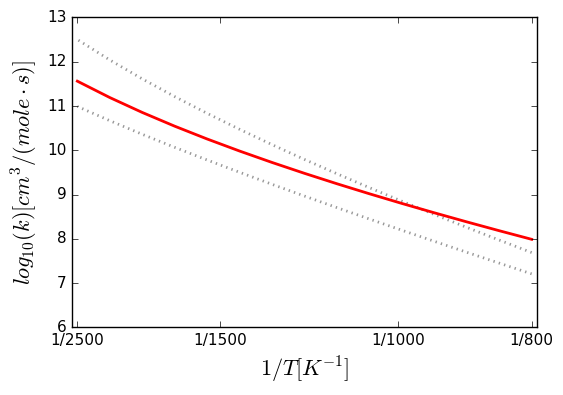


Arrhenius(A=(80820,'cm^3/(mol*s)'), n=2, Ea=(10318.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.25e-05,'cm^3/(mol*s)'), n=5.26, Ea=(7468,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00161843,'cm^3/(mol*s)'), n=4.41608, Ea=(31.2187,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.34896, dn = +|- 0.0392853, dEa = +|- 0.216109 kJ/mol""")
HO2 + IC3H7OH => H2O2 + CH3COHCH3


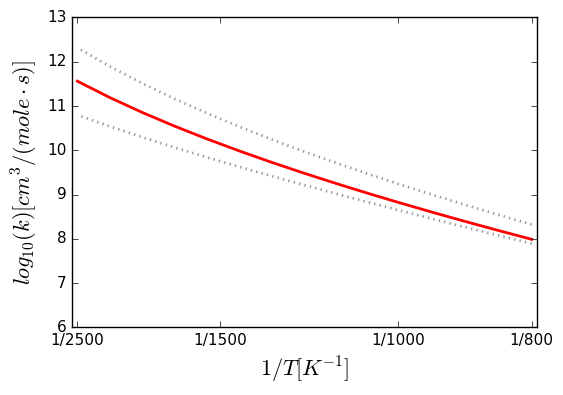


Arrhenius(A=(4.32e+11,'cm^3/(mol*s)'), n=0.01, Ea=(8169,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00015669,'cm^3/(mol*s)'), n=4.4528, Ea=(46.7795,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29246, dn = +|- 0.0336692, dEa = +|- 0.185214 kJ/mol""")
C6H13-3 + H2O2 <=> NC6H14 + HO2


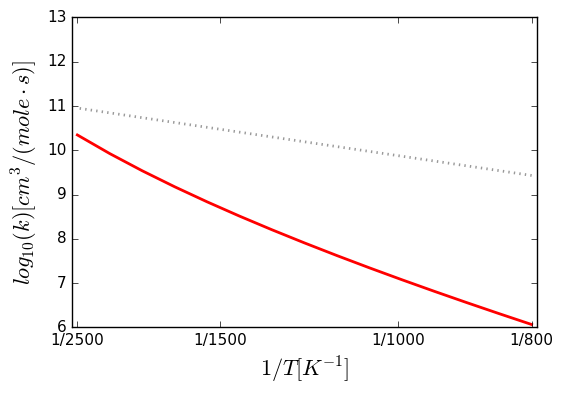


Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.74786e-07,'cm^3/(mol*s)'), n=5.32116, Ea=(61.5242,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.05404, dn = +|- 0.0944681, dEa = +|- 0.519669 kJ/mol""")
sc4h8oh-1o2 + ho2 <=> sc4h8oh-1o2h + o2


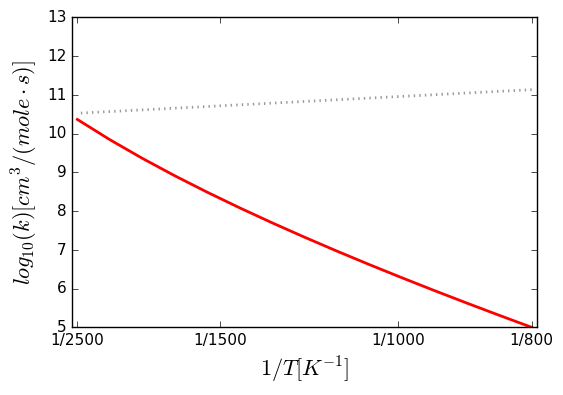


Arrhenius(A=(32700,'cm^3/(mol*s)'), n=2.22, Ea=(3472,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.82238e-06,'cm^3/(mol*s)'), n=4.45468, Ea=(5.55347,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.48459, dn = +|- 0.0518586, dEa = +|- 0.285274 kJ/mol""")
IC3H7COC3H6-I + H2O2 <=> IC3H7COC3H7-I + HO2


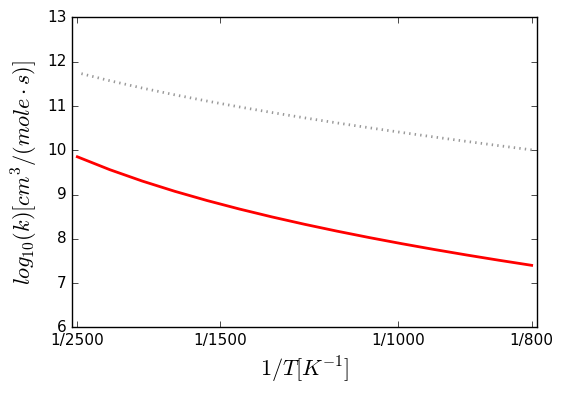


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00169676,'cm^3/(mol*s)'), n=4.37089, Ea=(42.7957,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.25706, dn = +|- 0.0300244, dEa = +|- 0.165164 kJ/mol""")
C-EC6H12O + HO2 => CC5H10CHO + H2O2


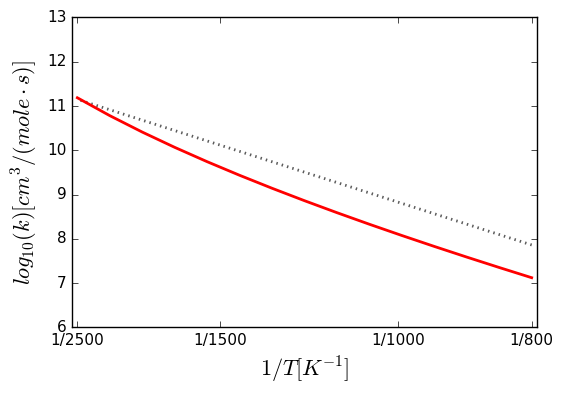


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00169676,'cm^3/(mol*s)'), n=4.37089, Ea=(42.7957,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.25706, dn = +|- 0.0300244, dEa = +|- 0.165164 kJ/mol""")
C-EC6H12O + HO2 => IC3H7COC2H4P + H2O2


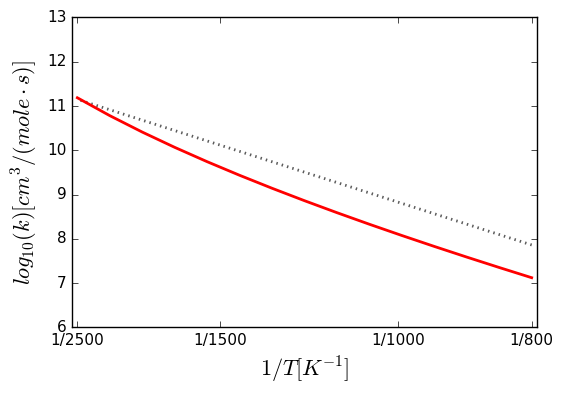


Arrhenius(A=(4.35e+11,'cm^3/(mol*s)'), n=0.01, Ea=(8165,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000515792,'cm^3/(mol*s)'), n=3.92751, Ea=(-2.48706,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.10166, dn = +|- 0.0127059, dEa = +|- 0.0698954 kJ/mol""")
C7H15-3 + H2O2 <=> NC7H16 + HO2


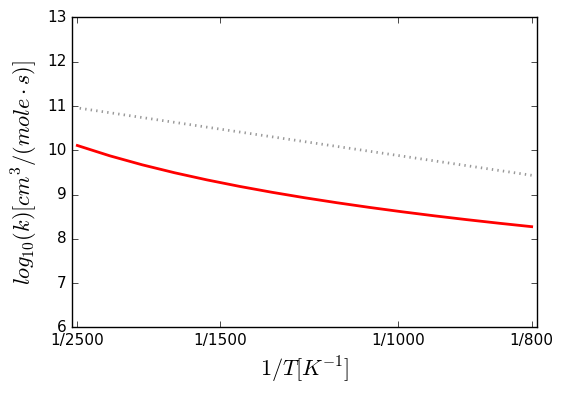


Arrhenius(A=(2.69e+12,'cm^3/(mol*s)'), n=0, Ea=(7410,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000114282,'cm^3/(mol*s)'), n=4.3133, Ea=(3.49508,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.35185, dn = +|- 0.0395655, dEa = +|- 0.21765 kJ/mol""")
DC6H13 + H2O2 <=> IC6H14 + HO2


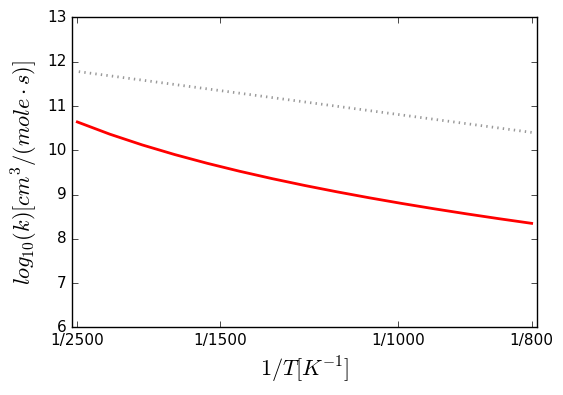


Arrhenius(A=(1.7e+12,'cm^3/(mol*s)'), n=0, Ea=(10700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.18425e-07,'cm^3/(mol*s)'), n=5.35071, Ea=(21.9891,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.105, dn = +|- 0.0976848, dEa = +|- 0.537364 kJ/mol""")
PHC2H4HCO + HO2 => PHC2H4CO + H2O2


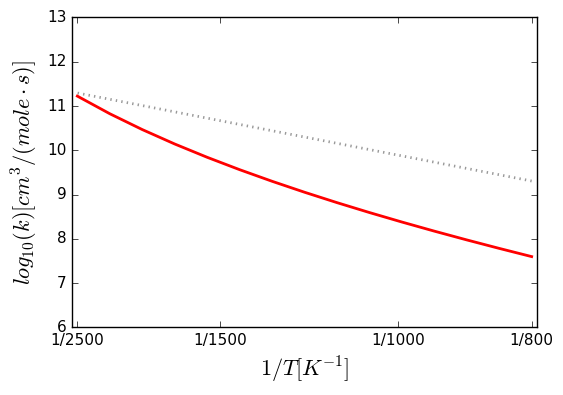


Arrhenius(A=(140,'cm^3/(mol*s)'), n=3.25, Ea=(14998,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.60398e-05,'cm^3/(mol*s)'), n=4.74358, Ea=(63.8521,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.49211, dn = +|- 0.0525215, dEa = +|- 0.288921 kJ/mol""")
MCH + HO2 <=> MCHR4 + H2O2


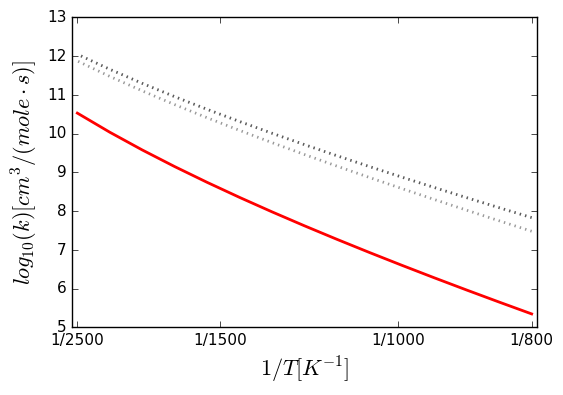


Arrhenius(A=(30500,'cm^3/(mol*s)'), n=2.65, Ea=(17496,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(20.4,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(20.4,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.60398e-05,'cm^3/(mol*s)'), n=4.74358, Ea=(63.8521,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.49211, dn = +|- 0.0525215, dEa = +|- 0.288921 kJ/mol""")
MCH + HO2 <=> CYCHEXCH2 + H2O2


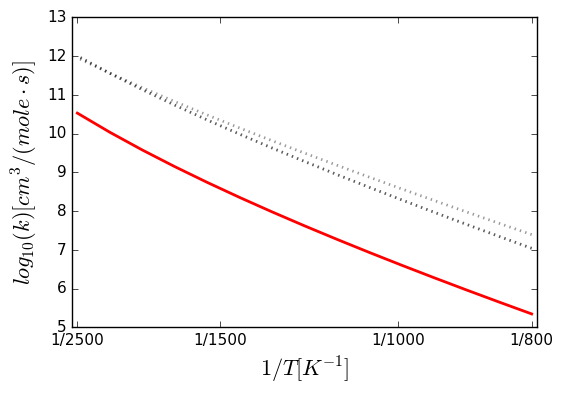


Arrhenius(A=(1240,'cm^3/(mol*s)'), n=2.77, Ea=(10500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.065,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.065,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.60398e-05,'cm^3/(mol*s)'), n=4.74358, Ea=(63.8521,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.49211, dn = +|- 0.0525215, dEa = +|- 0.288921 kJ/mol""")
MCH + HO2 <=> MCHR1 + H2O2


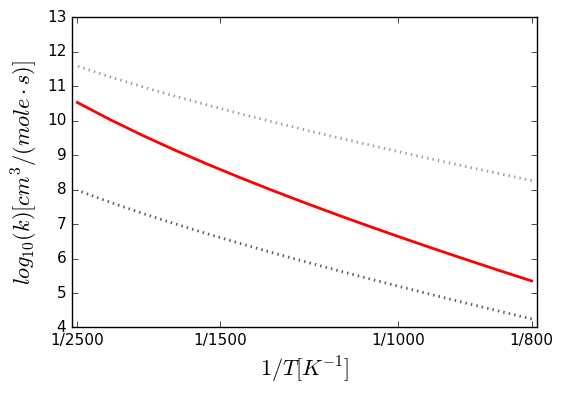


Arrhenius(A=(281,'cm^3/(mol*s)'), n=3.25, Ea=(14998,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(754300,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.60398e-05,'cm^3/(mol*s)'), n=4.74358, Ea=(63.8521,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.49211, dn = +|- 0.0525215, dEa = +|- 0.288921 kJ/mol""")
HO2 + MCYC6 => H2O2 + RMCYC6


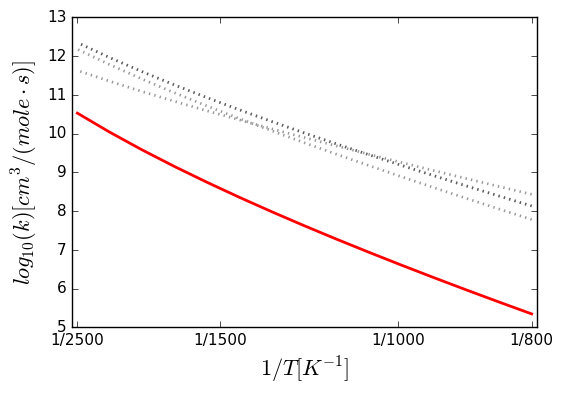


Arrhenius(A=(281,'cm^3/(mol*s)'), n=3.25, Ea=(14998,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.60398e-05,'cm^3/(mol*s)'), n=4.74358, Ea=(63.8521,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.49211, dn = +|- 0.0525215, dEa = +|- 0.288921 kJ/mol""")
MCH + HO2 <=> MCHR3 + H2O2


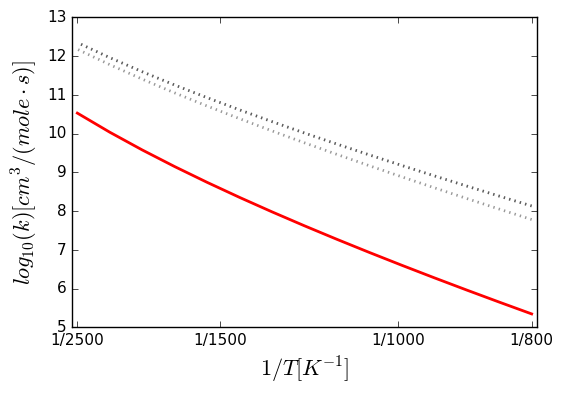


Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9935.95,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'

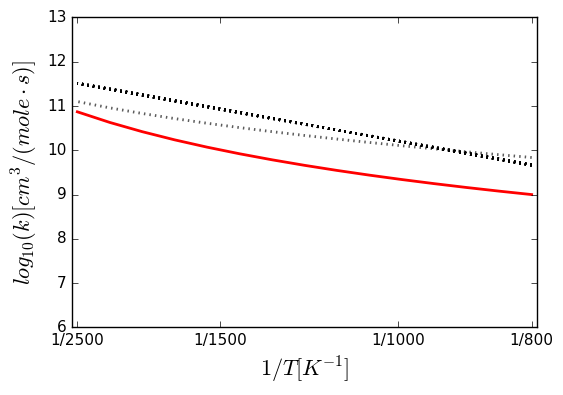


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.08763e-07,'cm^3/(mol*s)'), n=5.10468, Ea=(5.60181,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.8824, dn = +|- 0.083016, dEa = +|- 0.456671 kJ/mol""")
hoch2cho + ho2 <=> hoch2co + h2o2


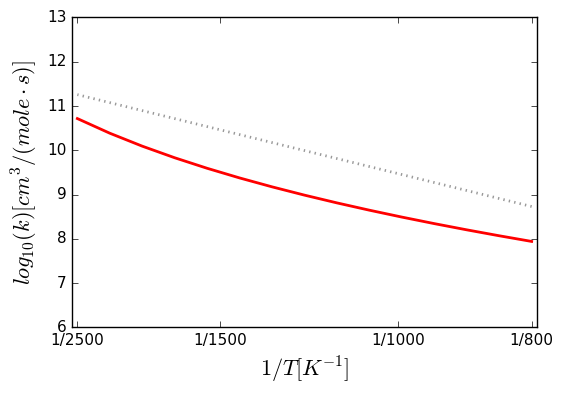


Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.062225,'cm^3/(mol*s)'), n=3.87317, Ea=(61.9862,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.07068, dn = +|- 0.00896307, dEa = +|- 0.0493059 kJ/mol""")
c4h8oh-2o2 + ho2 <=> c4h8oh-2o2h + o2


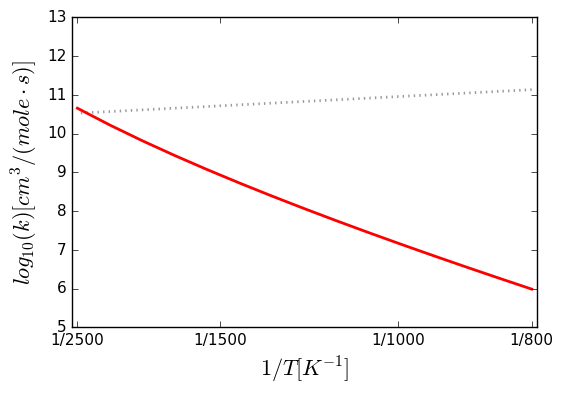


Arrhenius(A=(2e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00023138,'cm^3/(mol*s)'), n=4.66817, Ea=(64.1348,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.41599, dn = +|- 0.0456492, dEa = +|- 0.251116 kJ/mol""")
C5H91-3 + HO2 <=> C*CC*CC + H2O2


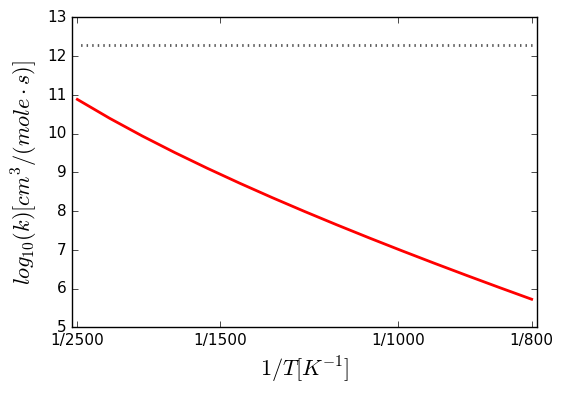


Arrhenius(A=(1.581e+12,'cm^3/(mol*s)'), n=-0.11, Ea=(-326,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00023138,'cm^3/(mol*s)'), n=4.66817, Ea=(64.1348,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.41599, dn = +|- 0.0456492, dEa = +|- 0.251116 kJ/mol""")
C5H91-3 + HO2 => C5H10-2 + O2


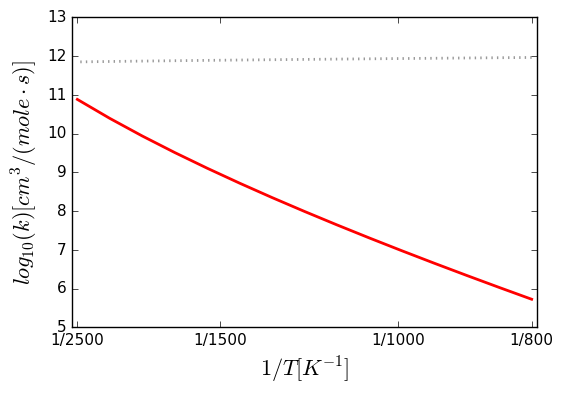


Arrhenius(A=(9.64e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.64e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.64e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.64e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.64e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.64e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.64e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.64e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00023138,'cm^3/(mol*s)'), n=4.66817, Ea=(64.1348,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.41599, dn = +|- 0.0456492, dEa = +|- 0.251116 kJ/mol""")
C5H91-3 + HO2 <=> C5H9O1-3 + OH


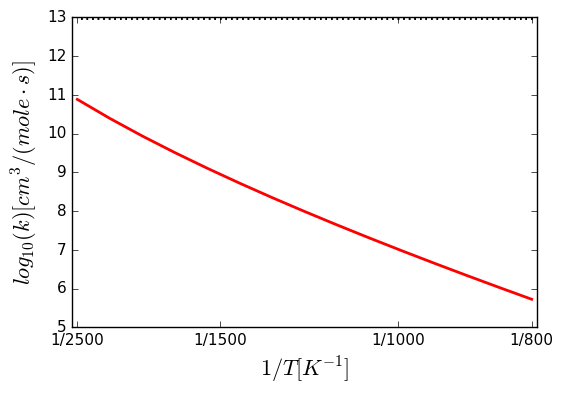


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(107800,'cm^3/(mol*s)'), n=2, Ea=(10318.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.88e+12,'cm^3/(mol*s)'), n=0, Ea=(17000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,

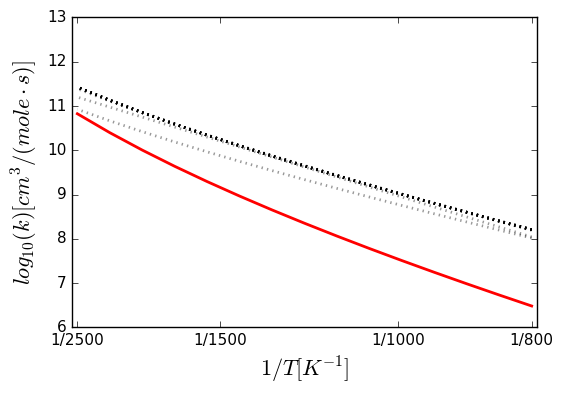


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(107800,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13909.9,'cal/mol'), T0=(1,'K'))
Arrheni

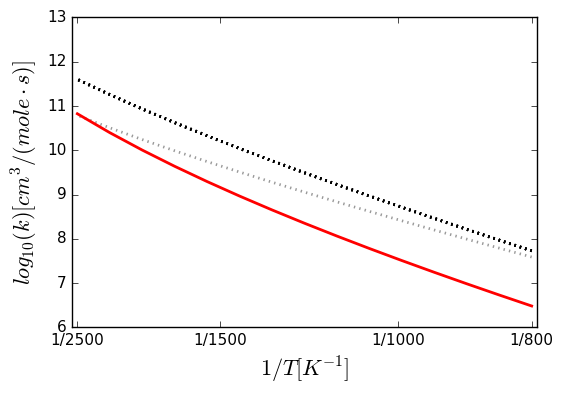


Arrhenius(A=(1.31,'cm^3/(mol*s)'), n=3.42, Ea=(27810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000315487,'cm^3/(mol*s)'), n=4.50876, Ea=(47.5193,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.30674, dn = +|- 0.0351114, dEa = +|- 0.193148 kJ/mol""")
C5H10-1 + HO2 <=> C5H11-1 + O2


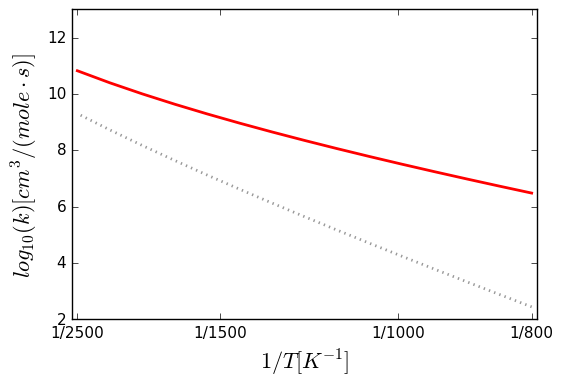


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000315487,'cm^3/(mol*s)'), n=4.50876, Ea=(47.5193,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.30674, dn = +|- 0.0351114, dEa = +|- 0.193148 kJ/mol""")
C5H10 + R3OOH => R2OH + C5H10OE#3


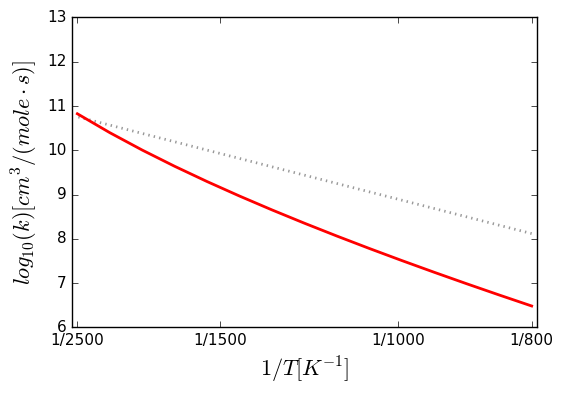


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16494,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(161600,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'

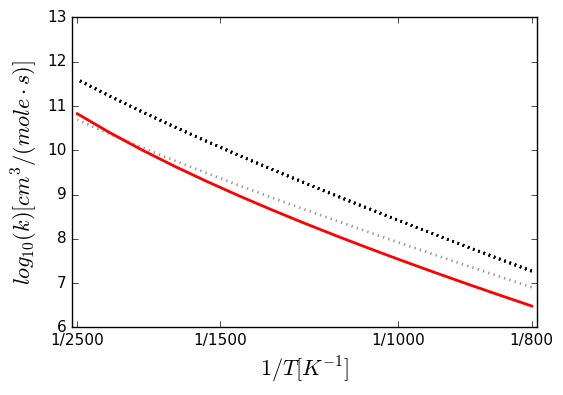


Arrhenius(A=(20.2,'cm^3/(mol*s)'), n=3.14, Ea=(22740,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000315487,'cm^3/(mol*s)'), n=4.50876, Ea=(47.5193,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.30674, dn = +|- 0.0351114, dEa = +|- 0.193148 kJ/mol""")
C5H10-1 + HO2 <=> C5H11-2 + O2


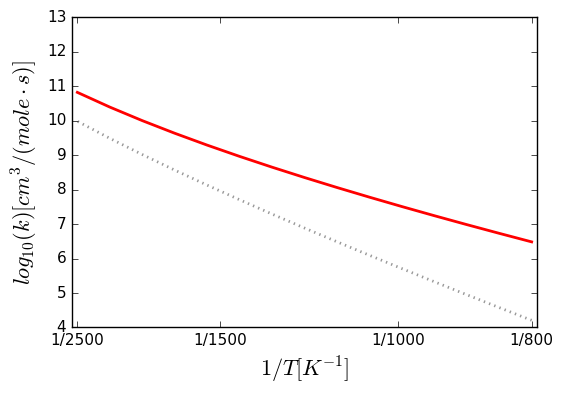


Arrhenius(A=(4.16e+11,'cm^3/(mol*s)'), n=0, Ea=(24858,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000280384,'cm^3/(mol*s)'), n=4.76439, Ea=(102.108,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.80114, dn = +|- 0.0772249, dEa = +|- 0.424814 kJ/mol""")
THP-2-4-ene + O2 <=> THP-5yl + HO2


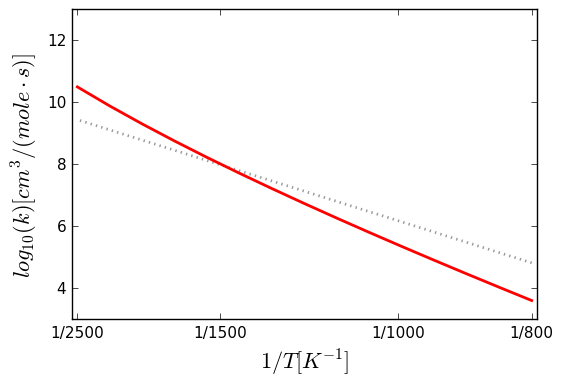


Arrhenius(A=(13000,'cm^3/(mol*s)'), n=2.6, Ea=(12400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13000,'cm^3/(mol*s)'), n=2.6, Ea=(12400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.14152e-06,'cm^3/(mol*s)'), n=5.05336, Ea=(13.5929,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.94928, dn = +|- 0.0875979, dEa = +|- 0.481876 kJ/mol""")
f25h + ho2 <=> c4h5o-3 + h2o2


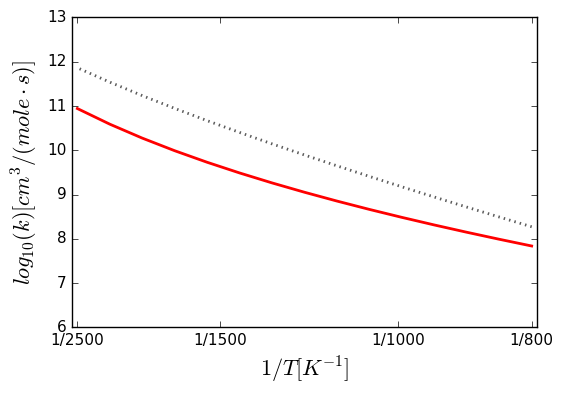


Arrhenius(A=(2.42e+13,'cm^3/(mol*s)'), n=-0.56, Ea=(6100,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.55516e-05,'cm^3/(mol*s)'), n=4.81694, Ea=(37.2392,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51886, dn = +|- 0.0548531, dEa = +|- 0.301747 kJ/mol""")
TC4H9CHCOCH3 + H2O2 <=> NEOC5H11COCH3 + HO2


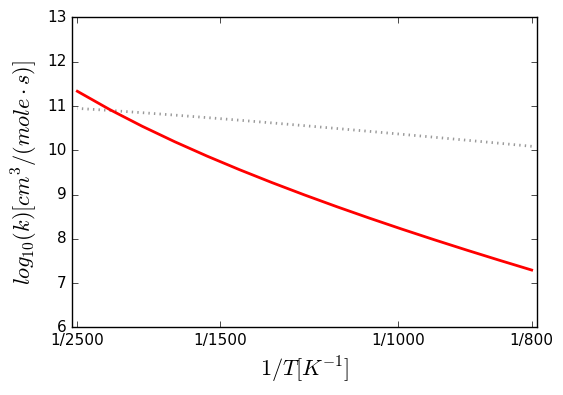


Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.55516e-05,'cm^3/(mol*s)'), n=4.81694, Ea=(37.2392,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51886, dn = +|- 0.0548531, dEa = +|- 0.301747 kJ/mol""")
NEOC5H11COCH3 + HO2 <=> NEOC5H10COCH3 + H2O2


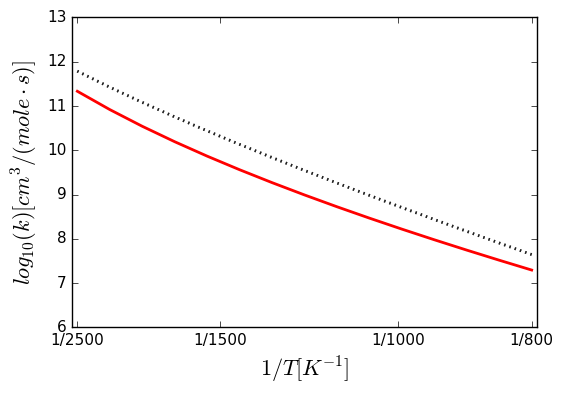


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.55516e-05,'cm^3/(mol*s)'), n=4.81694, Ea=(37.2392,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51886, dn = +|- 0.0548531, dEa = +|- 0.301747 kJ/mol""")
NEOC5H11COCH3 + HO2 <=> NEOC5H11COCH2 + H2O2


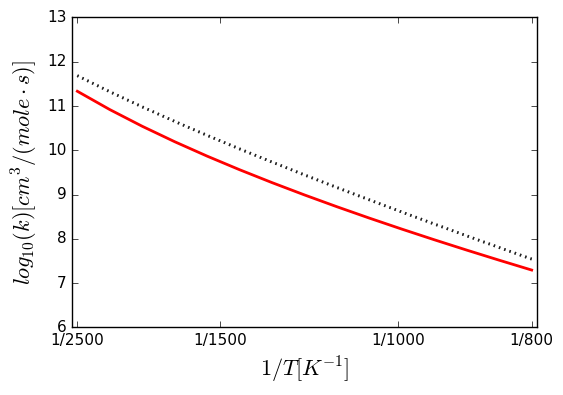


Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.55516e-05,'cm^3/(mol*s)'), n=4.81694, Ea=(37.2392,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51886, dn = +|- 0.0548531, dEa = +|- 0.301747 kJ/mol""")
NEOC5H11COCH3 + HO2 <=> TC4H9CHCOCH3 + H2O2


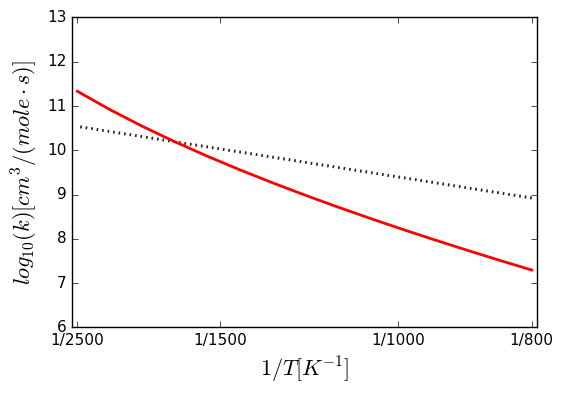


Arrhenius(A=(28370,'cm^3/(mol*s)'), n=2.22, Ea=(4462,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00305987,'cm^3/(mol*s)'), n=4.08776, Ea=(1.38763,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.20953, dn = +|- 0.0249659, dEa = +|- 0.137338 kJ/mol""")
C5H92-5 + H2O2 => C5H10-2 + HO2


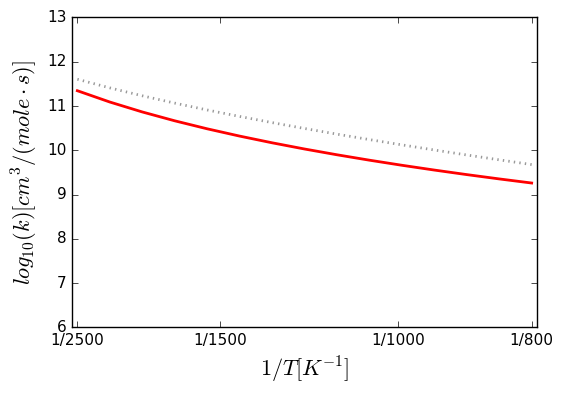


Arrhenius(A=(6e+12,'cm^3/(mol*s)'), n=0, Ea=(37190,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.149819,'cm^3/(mol*s)'), n=3.98904, Ea=(127.828,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.27883, dn = +|- 0.0322786, dEa = +|- 0.177564 kJ/mol""")
C4H7OH1-3 + O2 <=> C4H6OH1-32 + HO2


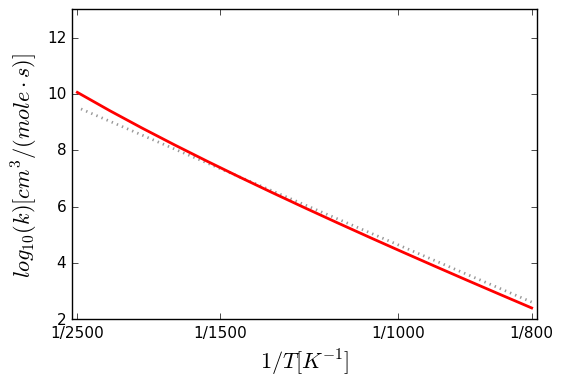


Arrhenius(A=(6e+12,'cm^3/(mol*s)'), n=0, Ea=(37190,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.149819,'cm^3/(mol*s)'), n=3.98904, Ea=(127.828,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.27883, dn = +|- 0.0322786, dEa = +|- 0.177564 kJ/mol""")
c4h7oh1-3 + o2 <=> c4h6oh1-32 + ho2


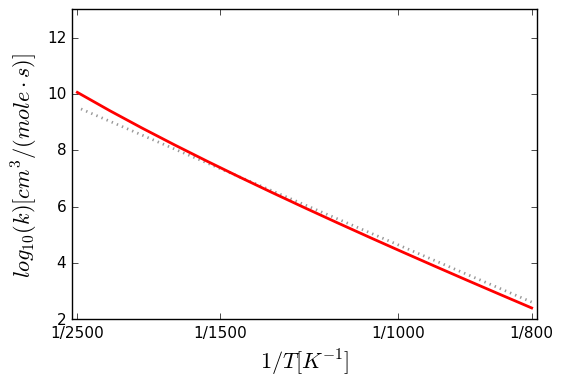


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000121284,'cm^3/(mol*s)'), n=4.38163, Ea=(49.6938,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28129, dn = +|- 0.0325299, dEa = +|- 0.178947 kJ/mol""")
C7H14-1 + HO2 <=> C7H131-6 + H2O2


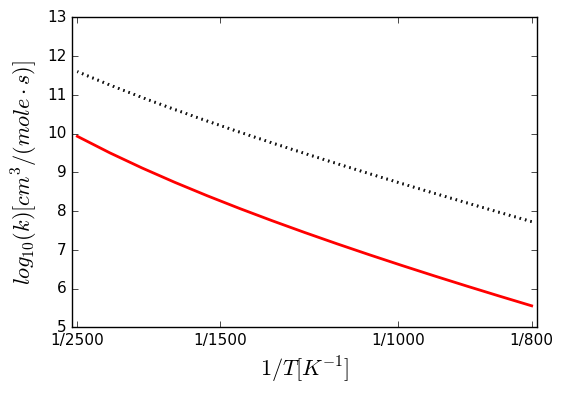


Arrhenius(A=(1.15e-08,'cm^3/(mol*s)'), n=-0.13, Ea=(17420,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000121284,'cm^3/(mol*s)'), n=4.38163, Ea=(49.6938,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28129, dn = +|- 0.0325299, dEa = +|- 0.178947 kJ/mol""")
C7H14-1 + HO2 <=> C7H15-2 + O2


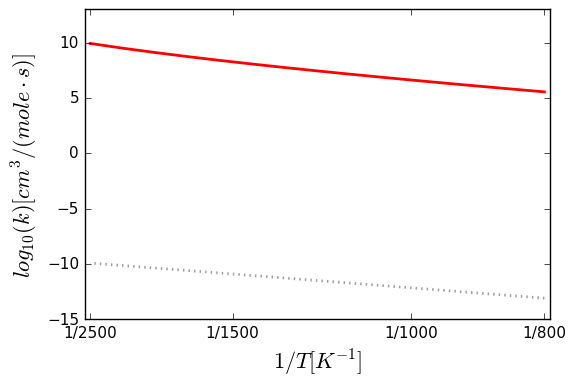


Arrhenius(A=(2.45e-10,'cm^3/(mol*s)'), n=0.27, Ea=(17920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000121284,'cm^3/(mol*s)'), n=4.38163, Ea=(49.6938,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28129, dn = +|- 0.0325299, dEa = +|- 0.178947 kJ/mol""")
C7H14-1 + HO2 <=> C7H15-1 + O2


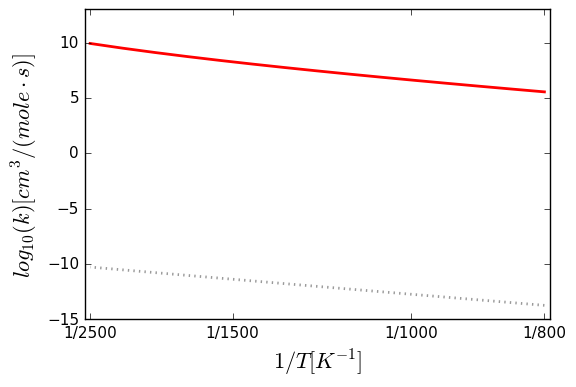


Arrhenius(A=(21600,'cm^3/(mol*s)'), n=2, Ea=(5267.81,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000121284,'cm^3/(mol*s)'), n=4.38163, Ea=(49.6938,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28129, dn = +|- 0.0325299, dEa = +|- 0.178947 kJ/mol""")
H2O2 + NC7H13 => NC7H14 + HO2


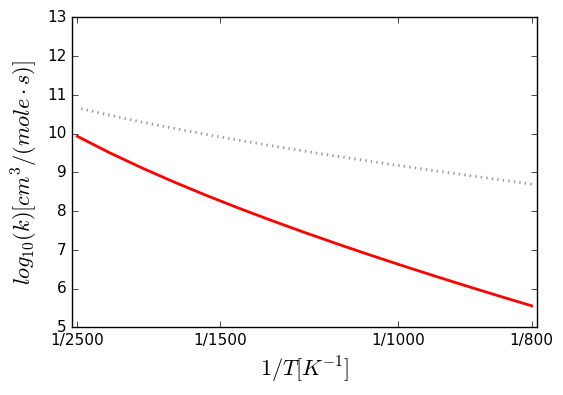


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000121284,'cm^3/(mol*s)'), n=4.38163, Ea=(49.6938,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28129, dn = +|- 0.0325299, dEa = +|- 0.178947 kJ/mol""")
C7H14Z + R3OOH => R2OH + C7H14OE#3


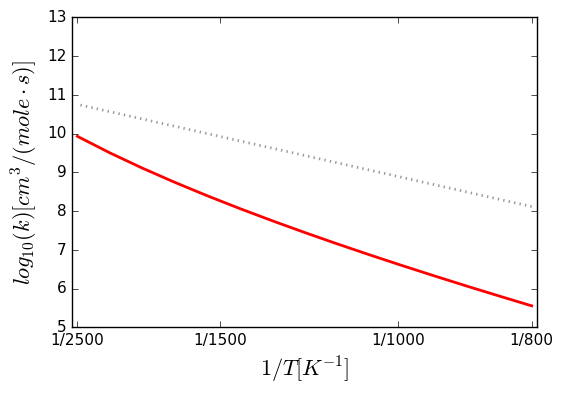


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000121284,'cm^3/(mol*s)'), n=4.38163, Ea=(49.6938,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28129, dn = +|- 0.0325299, dEa = +|- 0.178947 kJ/mol""")
C7H14-1 + HO2 <=> C7H131-4 + H2O2


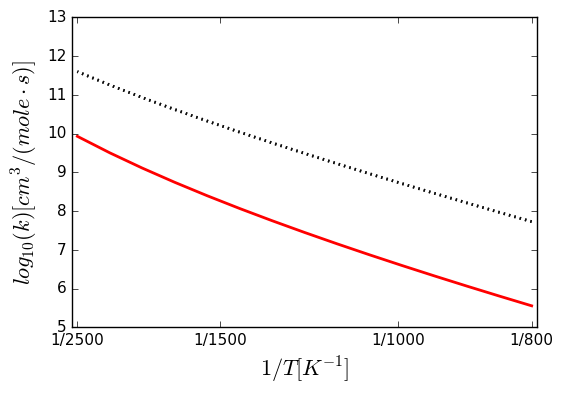


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000121284,'cm^3/(mol*s)'), n=4.38163, Ea=(49.6938,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28129, dn = +|- 0.0325299, dEa = +|- 0.178947 kJ/mol""")
C7H14-1 + HO2 <=> C7H131-7 + H2O2


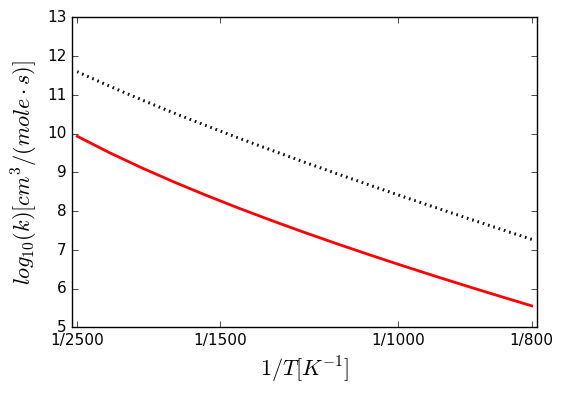


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(700400,'cm^3/(mol*s)'), n=2, Ea=(11117.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000121284,'cm^3/(mol*s)'), n=4.38163, Ea=(49.6938,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28129, dn = +|- 0.0325299, dEa = +|- 0.178947 kJ/mol""")
C7H14-1 + HO2 <=> C7H131-5 + H2O2


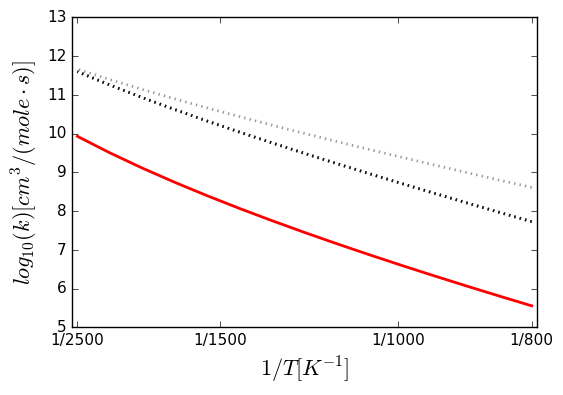


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000121284,'cm^3/(mol*s)'), n=4.38163, Ea=(49.6938,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.28129, dn = +|- 0.0325299, dEa = +|- 0.178947 kJ/mol""")
C7H14-1 + HO2 <=> C7H131-3 + H2O2


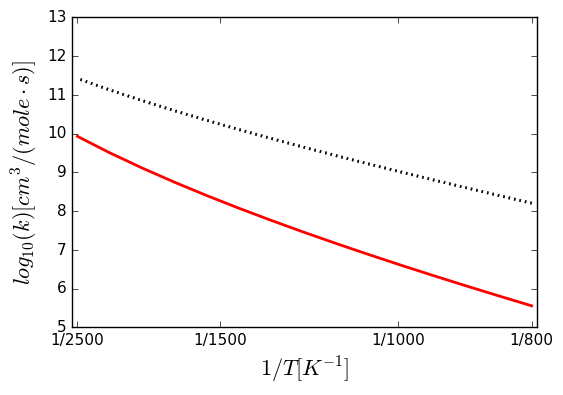


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.66671e-07,'cm^3/(mol*s)'), n=5.36023, Ea=(20.7461,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.31757, dn = +|- 0.110311, dEa = +|- 0.60682 kJ/mol""")
C7H14-2 + HO2 <=> C7H132-7 + H2O2


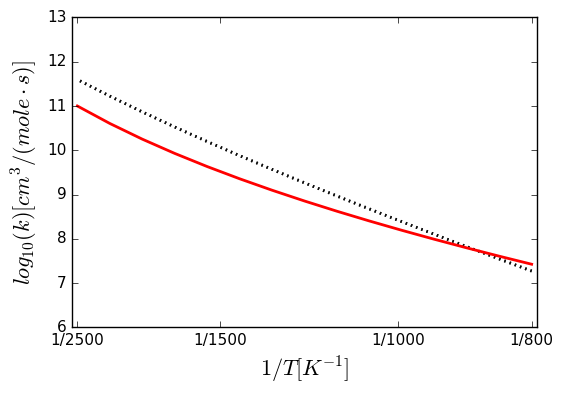


Arrhenius(A=(3.79e-09,'cm^3/(mol*s)'), n=0.05, Ea=(18270,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.66671e-07,'cm^3/(mol*s)'), n=5.36023, Ea=(20.7461,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.31757, dn = +|- 0.110311, dEa = +|- 0.60682 kJ/mol""")
C7H14-2 + HO2 <=> C7H15-3 + O2


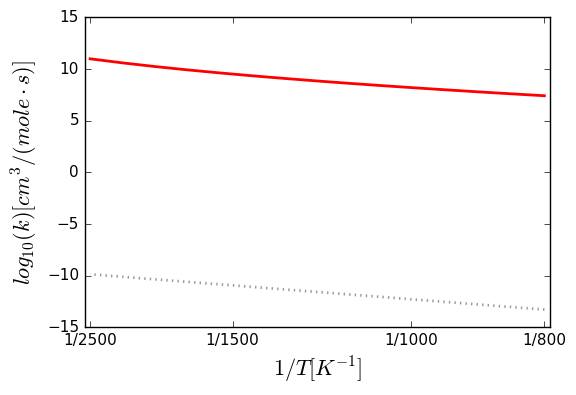


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.66671e-07,'cm^3/(mol*s)'), n=5.36023, Ea=(20.7461,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.31757, dn = +|- 0.110311, dEa = +|- 0.60682 kJ/mol""")
C7H14-2 + HO2 <=> C7H132-5 + H2O2


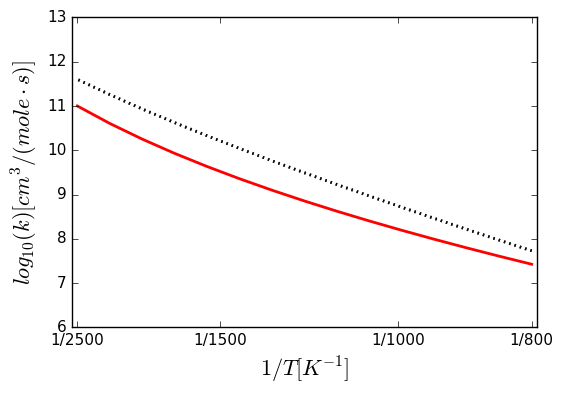


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.66671e-07,'cm^3/(mol*s)'), n=5.36023, Ea=(20.7461,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.31757, dn = +|- 0.110311, dEa = +|- 0.60682 kJ/mol""")
C7H14-2 + HO2 <=> C7H132-6 + H2O2


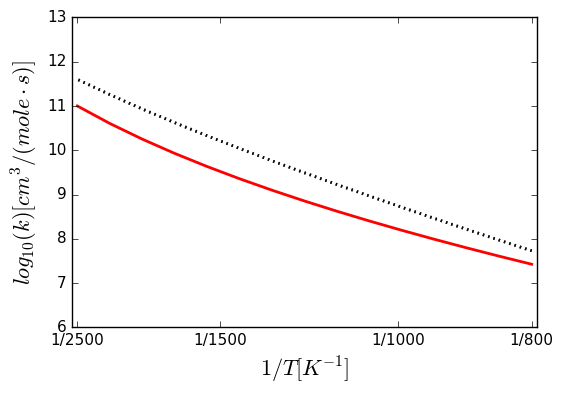


Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.66671e-07,'cm^3/(mol*s)'), n=5.36023, Ea=(20.7461,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.31757, dn = +|- 0.110311, dEa = +|- 0.60682 kJ/mol""")
C7H14-2 + HO2 <=> C7H131-3 + H2O2


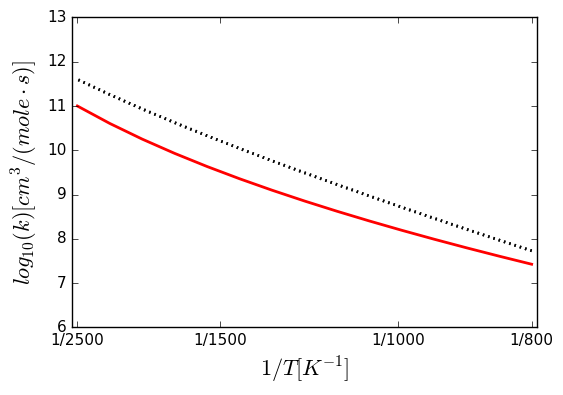


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.66671e-07,'cm^3/(mol*s)'), n=5.36023, Ea=(20.7461,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.31757, dn = +|- 0.110311, dEa = +|- 0.60682 kJ/mol""")
C7H14-2 + HO2 <=> C7H132-4 + H2O2


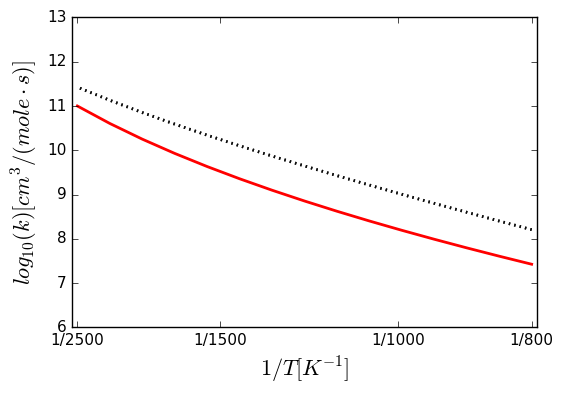


Arrhenius(A=(3.79e-09,'cm^3/(mol*s)'), n=0.05, Ea=(18270,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.66671e-07,'cm^3/(mol*s)'), n=5.36023, Ea=(20.7461,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.31757, dn = +|- 0.110311, dEa = +|- 0.60682 kJ/mol""")
C7H14-2 + HO2 <=> C7H15-2 + O2


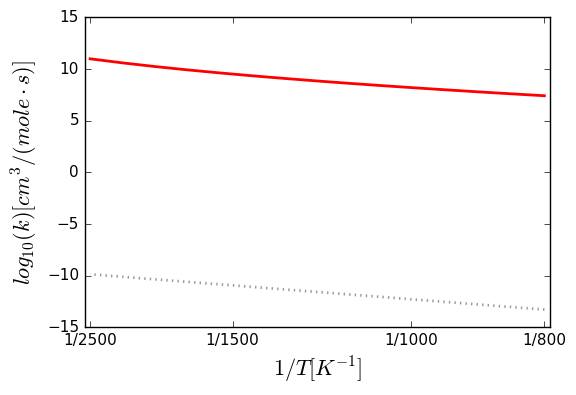


Arrhenius(A=(0.088,'cm^3/(mol*s)'), n=4.31, Ea=(17270,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.088,'cm^3/(mol*s)'), n=4.31, Ea=(17270,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.088,'cm^3/(mol*s)'), n=4.31, Ea=(17270,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(107800,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0574127,'cm^3/(mol*s)'), n=3.9559, Ea=(67.5659,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06209, dn = +|- 0.00790624, dEa = +|- 0.0434923 kJ/mol""")
nc4h9oh + ho2 <=> c4h8oh-4 + h2o2


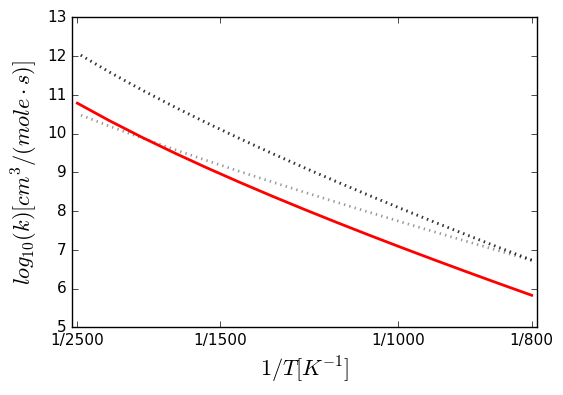


Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(37710,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0574127,'cm^3/(mol*s)'), n=3.9559, Ea=(67.5659,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06209, dn = +|- 0.00790624, dEa = +|- 0.0434923 kJ/mol""")
nc4h9oh + ho2 <=> pc4h9o + h2o2


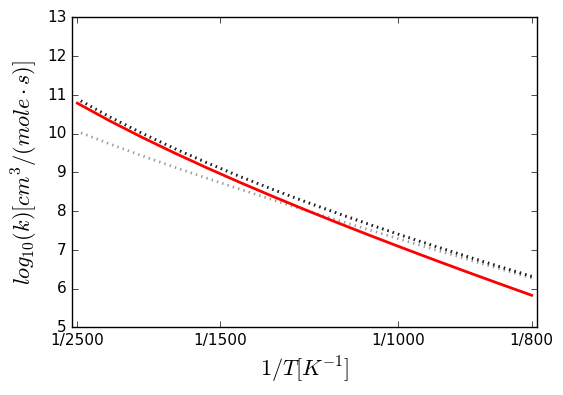


Arrhenius(A=(3.5e-05,'cm^3/(mol*s)'), n=5.26, Ea=(8268,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.5e-05,'cm^3/(mol*s)'), n=5.26, Ea=(8268,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(161600,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0574127,'cm^3/(mol*s)'), n=3.9559, Ea=(67.5659,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06209, dn = +|- 0.00790624, dEa = +|- 0.0434923 kJ/mol""")
nc4h9oh + ho2 <=> c4h8oh-1 + h2o2


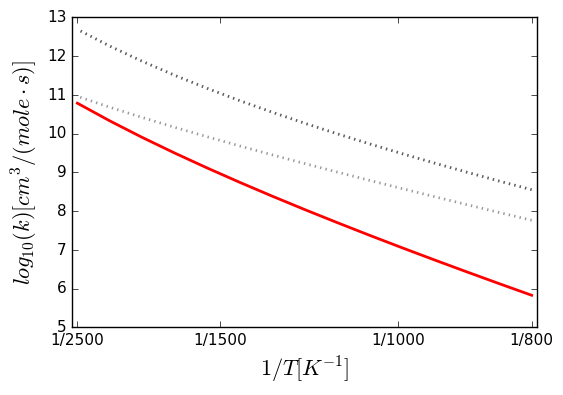


Arrhenius(A=(0.000276,'cm^3/(mol*s)'), n=4.76, Ea=(11850,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000276,'cm^3/(mol*s)'), n=4.76, Ea=(11850,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(80820,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0574127,'cm^3/(mol*s)'), n=3.9559, Ea=(67.5659,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06209, dn = +|- 0.00790624, dEa = +|- 0.0434923 kJ/mol""")
nc4h9oh + ho2 <=> c4h8oh-3 + h2o2


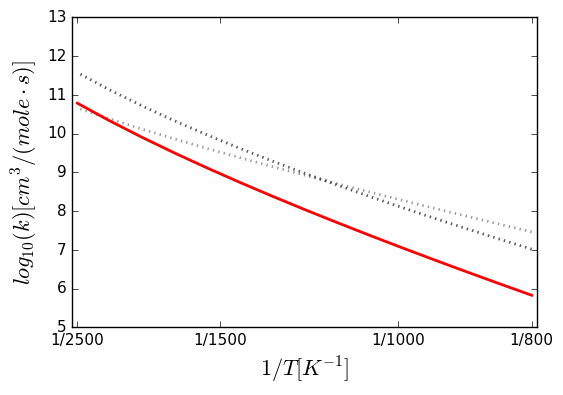


Arrhenius(A=(0.00751,'cm^3/(mol*s)'), n=4.52, Ea=(14710,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00751,'cm^3/(mol*s)'), n=4.52, Ea=(14710,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(43100,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0574127,'cm^3/(mol*s)'), n=3.9559, Ea=(67.5659,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06209, dn = +|- 0.00790624, dEa = +|- 0.0434923 kJ/mol""")
nc4h9oh + ho2 <=> c4h8oh-2 + h2o2


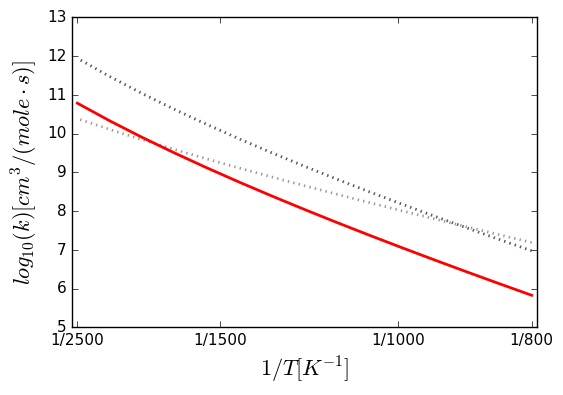


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.08992e-07,'cm^3/(mol*s)'), n=5.68434, Ea=(7.02495,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.38446, dn = +|- 0.0426943, dEa = +|- 0.234862 kJ/mol""")
C9H19O2-1 + H2O2 <=> C9H19O2H-1 + HO2


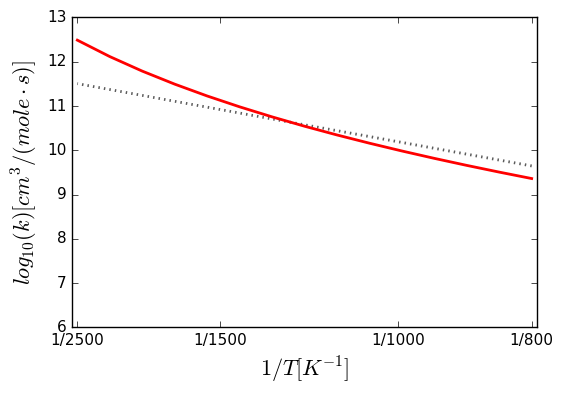


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.32958e-05,'cm^3/(mol*s)'), n=4.7941, Ea=(48.1901,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.45843, dn = +|- 0.0495251, dEa = +|- 0.272438 kJ/mol""")
NC9H20 + HO2 <=> C9H19-4 + H2O2


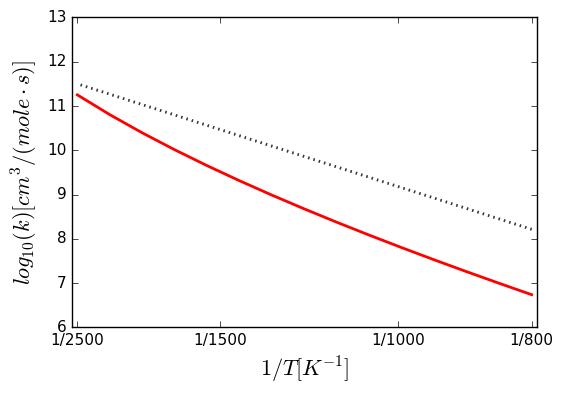


Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.32958e-05,'cm^3/(mol*s)'), n=4.7941, Ea=(48.1901,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.45843, dn = +|- 0.0495251, dEa = +|- 0.272438 kJ/mol""")
NC9H20 + HO2 <=> C9H19-1 + H2O2


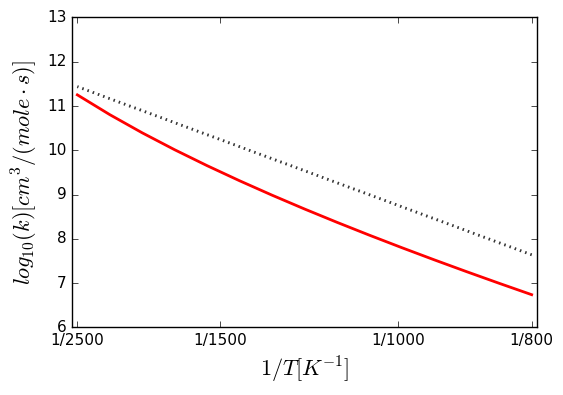


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.32958e-05,'cm^3/(mol*s)'), n=4.7941, Ea=(48.1901,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.45843, dn = +|- 0.0495251, dEa = +|- 0.272438 kJ/mol""")
NC9H20 + HO2 <=> C9H19-3 + H2O2


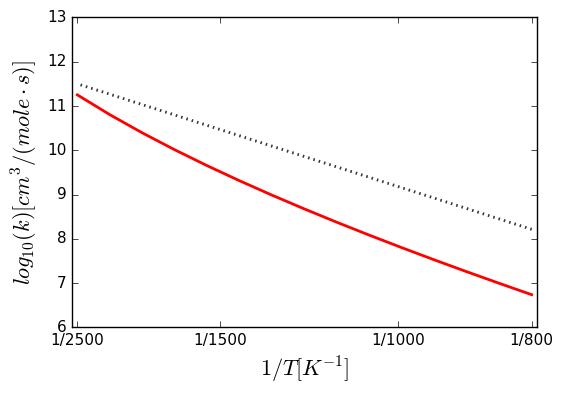


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.32958e-05,'cm^3/(mol*s)'), n=4.7941, Ea=(48.1901,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.45843, dn = +|- 0.0495251, dEa = +|- 0.272438 kJ/mol""")
NC9H20 + HO2 <=> C9H19-5 + H2O2


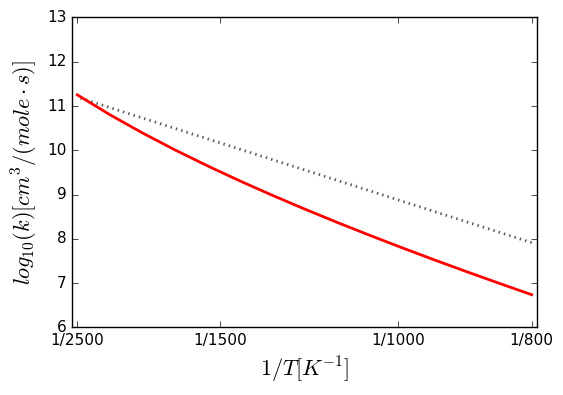


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.32958e-05,'cm^3/(mol*s)'), n=4.7941, Ea=(48.1901,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.45843, dn = +|- 0.0495251, dEa = +|- 0.272438 kJ/mol""")
NC9H20 + HO2 <=> C9H19-2 + H2O2


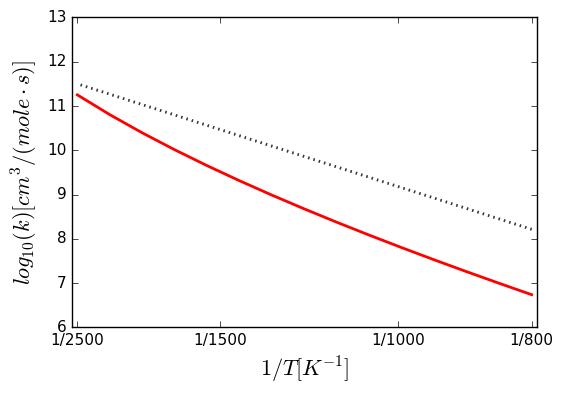


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.98959e-10,'cm^3/(mol*s)'), n=6.12943, Ea=(35.5241,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 3.58705, dn = +|- 0.167638, dEa = +|- 0.922178 kJ/mol""")
ACC6H10 + HO2 <=> ACC6H9-A + H2O2


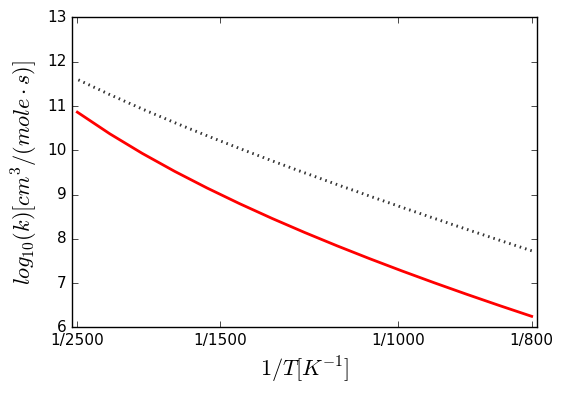


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.98959e-10,'cm^3/(mol*s)'), n=6.12943, Ea=(35.5241,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 3.58705, dn = +|- 0.167638, dEa = +|- 0.922178 kJ/mol""")
ACC6H10 + HO2 <=> ACC6H9-D + H2O2


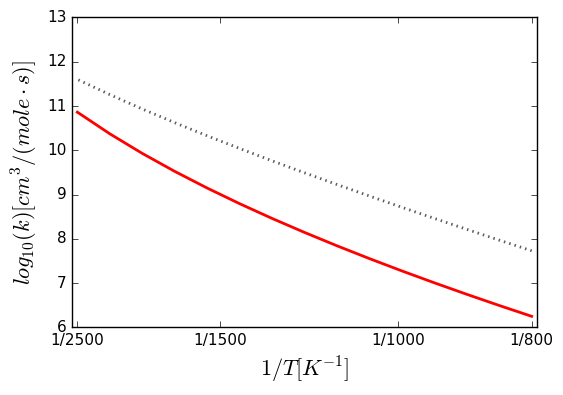


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000701905,'cm^3/(mol*s)'), n=4.32485, Ea=(46.8975,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.23104, dn = +|- 0.0272795, dEa = +|- 0.150065 kJ/mol""")
C5H11-2 + HO2 <=> C5H11O-2 + OH


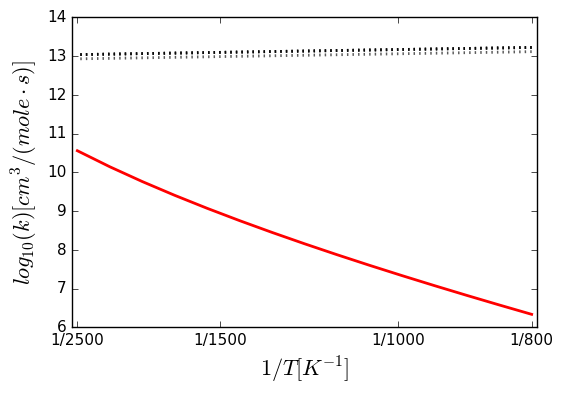


Arrhenius(A=(6.37e+08,'cm^3/(mol*s)'), n=0.69, Ea=(231,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000701905,'cm^3/(mol*s)'), n=4.32485, Ea=(46.8975,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.23104, dn = +|- 0.0272795, dEa = +|- 0.150065 kJ/mol""")
C5H11-2 + HO2 <=> NC5H12 + O2


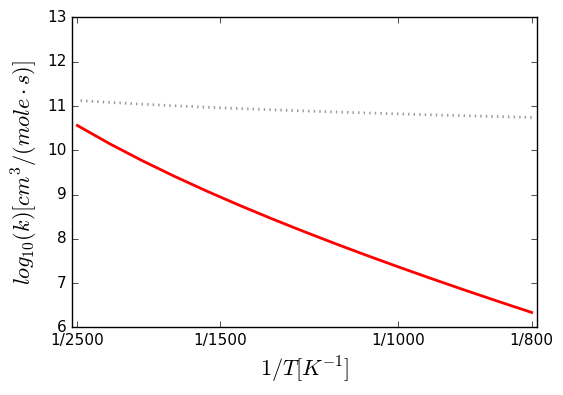


Arrhenius(A=(3290,'cm^3/(mol*s)'), n=2.51, Ea=(6362,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0062882,'cm^3/(mol*s)'), n=3.17172, Ea=(-9.64687,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.18573, dn = +|- 0.0223582, dEa = +|- 0.122993 kJ/mol""")
C5H10CHO-2 + H2O2 <=> NC5H11CHO + HO2


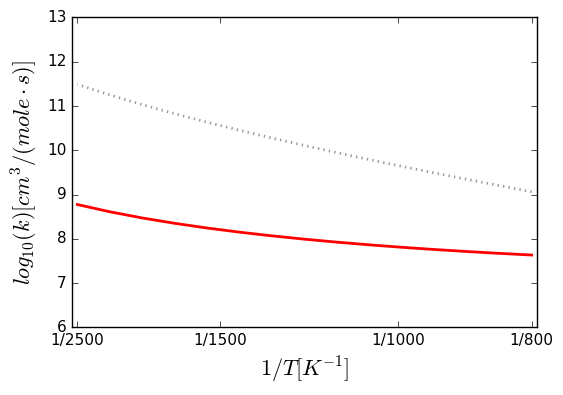


Arrhenius(A=(2.82e+11,'cm^3/(mol*s)'), n=0.07, Ea=(8112,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000230759,'cm^3/(mol*s)'), n=3.96301, Ea=(-1.68521,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.12882, dn = +|- 0.0159025, dEa = +|- 0.0874797 kJ/mol""")
C4H8COCH3-2 + H2O2 <=> NC4H9COCH3 + HO2


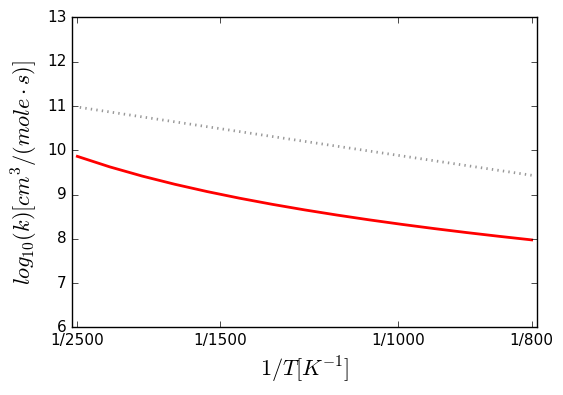


Arrhenius(A=(33200,'cm^3/(mol*s)'), n=2.22, Ea=(3472,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.431443,'cm^3/(mol*s)'), n=3.26974, Ea=(-7.48929,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17262, dn = +|- 0.0208984, dEa = +|- 0.114962 kJ/mol""")
IC3H6COC2H5 + H2O2 <=> IC3H7COC2H5 + HO2


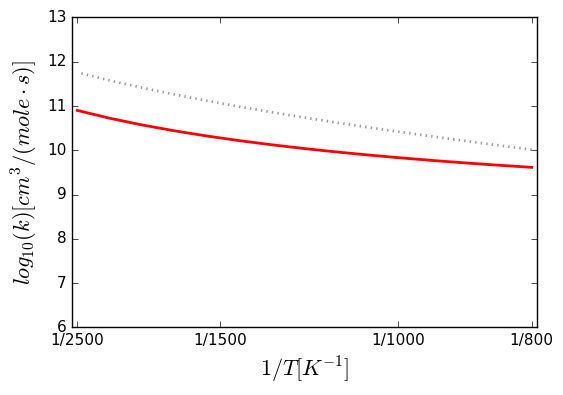


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000851317,'cm^3/(mol*s)'), n=3.64937, Ea=(-4.60504,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05864, dn = +|- 0.00747853, dEa = +|- 0.0411394 kJ/mol""")
mbmoo + h2o2 => mbmooh + ho2


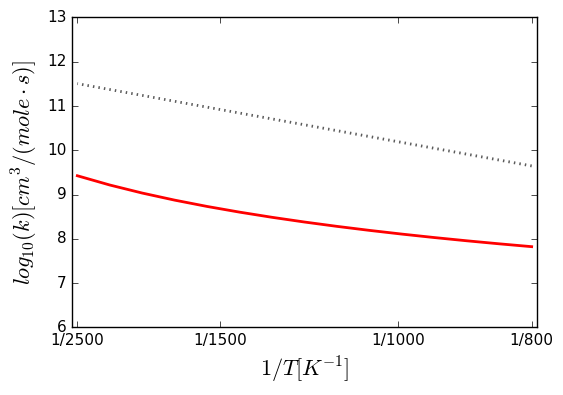


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000851317,'cm^3/(mol*s)'), n=3.64937, Ea=(-4.60504,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05864, dn = +|- 0.00747853, dEa = +|- 0.0411394 kJ/mol""")
mbmooh + ho2 => mbmoo + h2o2


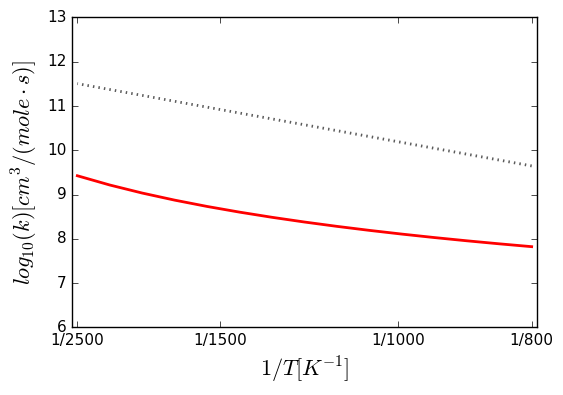


Arrhenius(A=(433.2,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(433.2,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(433.2,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(433.2,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(15000,'cm^3/(mol*s)'), n=2.5, Ea=(12260,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3600,'cm^3/(mol*s)'), n=2.55, Ea=(10500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(433.2,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(16000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(433.2,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(433.2,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(433.2,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3610,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(433.2,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T

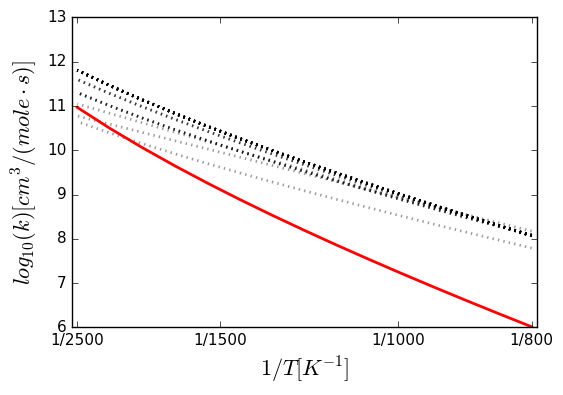


Arrhenius(A=(61.2,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(61.2,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(61.2,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(61.2,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(121500,'cm^3/(mol*s)'), n=2.5, Ea=(16690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(30000,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(61.2,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.55e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(61.2,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(61.2,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(61.2,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(61.2,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,

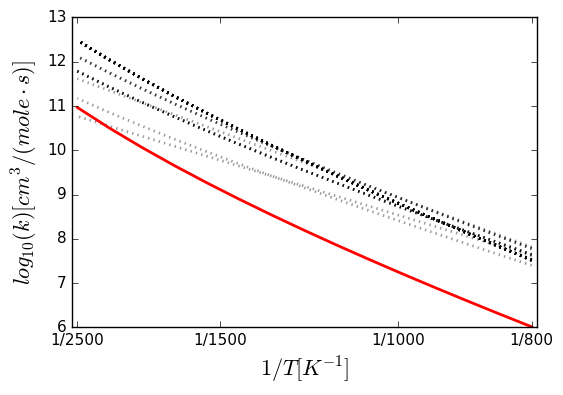


Arrhenius(A=(10100,'cm^3/(mol*s)'), n=2, Ea=(2119.32,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0010578,'cm^3/(mol*s)'), n=4.48259, Ea=(61.6073,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29855, dn = +|- 0.0342862, dEa = +|- 0.188609 kJ/mol""")
IC4H9P + H2O2 => IC4H10 + HO2


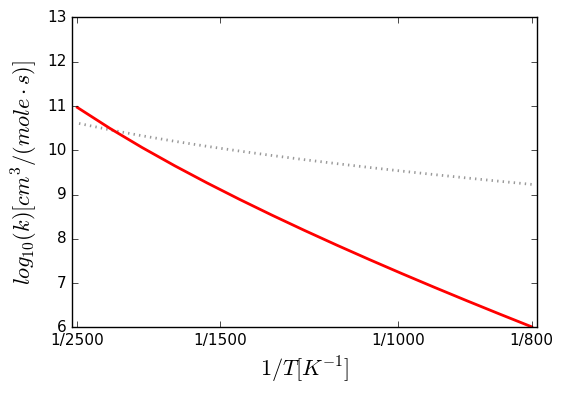


Arrhenius(A=(1.9e+13,'cm^3/(mol*s)'), n=-0.53, Ea=(6065,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.55467e-07,'cm^3/(mol*s)'), n=5.27471, Ea=(26.5385,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.01526, dn = +|- 0.0919671, dEa = +|- 0.505911 kJ/mol""")
SC2H4COC2H3 + H2O2 <=> C2H5COC2H3 + HO2


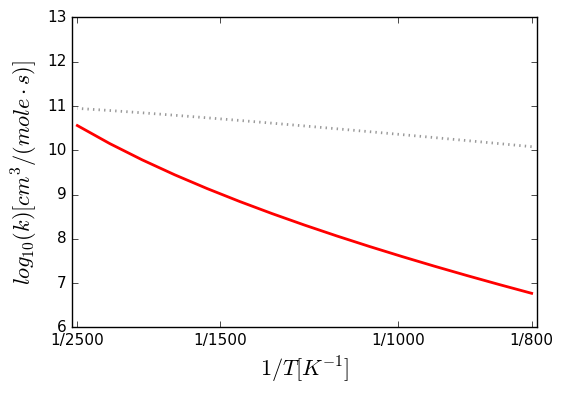


Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000187671,'cm^3/(mol*s)'), n=4.42924, Ea=(59.4943,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.27387, dn = +|- 0.0317679, dEa = +|- 0.174755 kJ/mol""")
tc4h8oh-o2 + ho2 <=> tc4h8oh-o2h + o2


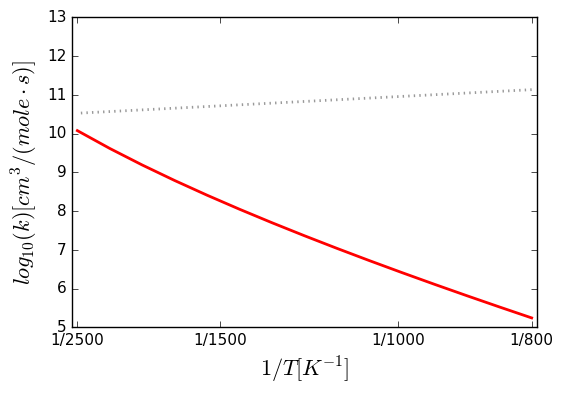


Arrhenius(A=(5.57e+13,'cm^3/(mol*s)'), n=-0.315, Ea=(862,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.57e+13,'cm^3/(mol*s)'), n=-0.315, Ea=(862,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.57e+13,'cm^3/(mol*s)'), n=-0.31, Ea=(862,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.57e+13,'cm^3/(mol*s)'), n=-0.315, Ea=(862,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.57e+13,'cm^3/(mol*s)'), n=-0.315, Ea=(862,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.65681e-06,'cm^3/(mol*s)'), n=4.84679, Ea=(12.546,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.79012, dn = +|- 0.0764191, dEa = +|- 0.420382 kJ/mol""")
ic4h6oh + ho2 <=> ic4h7oh + o2


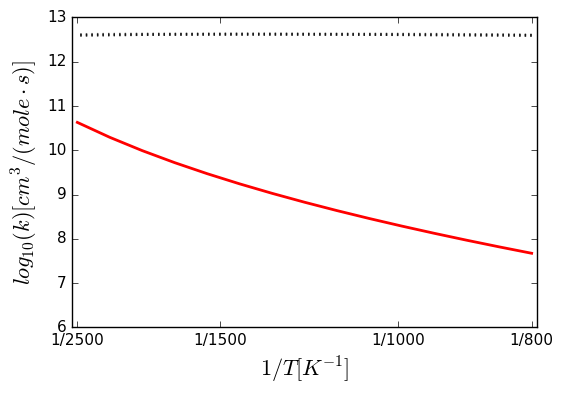


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000401616,'cm^3/(mol*s)'), n=4.21071, Ea=(28.2218,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.17225, dn = +|- 0.020858, dEa = +|- 0.11474 kJ/mol""")
ch3cocho + ho2 <=> ch3coco + h2o2


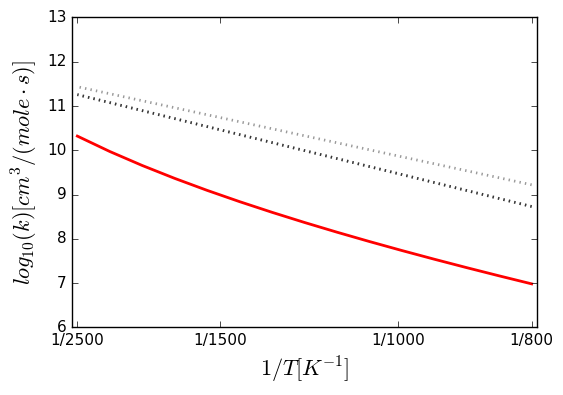


Arrhenius(A=(10830,'cm^3/(mol*s)'), n=2, Ea=(9550.95,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(10830,'cm^3/(mol*s)'), n=2, Ea=(9550.95,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.18884e-08,'cm^3/(mol*s)'), n=5.68421, Ea=(15.4981,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.6534, dn = +|- 0.12807, dEa = +|- 0.704515 kJ/mol""")
INDENYL + H2O2 => INDENE + HO2


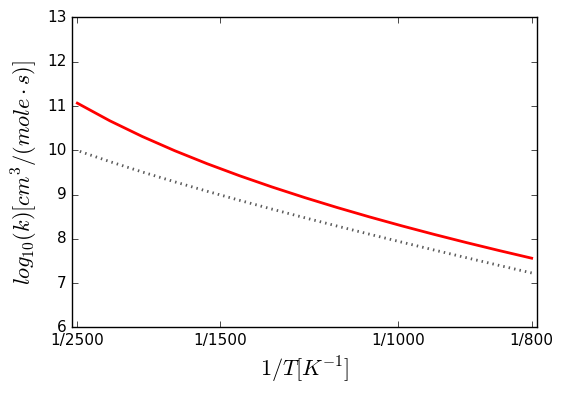


Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(11000,'cm^3/(mol*s)'), n=2.6, Ea=(12899.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(323300,'cm^3/(mol*s)'), n=2, Ea=(10401,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(12800,'cm^3/(mol*s)'), n=2.6, Ea=(12400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(12800,'cm^3/(mol*s)'), n=2.6, Ea=(12400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.99e+12,'cm^3/(mol*s)'), n=0, Ea=(11658.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(323300,'cm^3/(mol*s)'), n=2, Ea=(10401,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.18884e-08,'cm^3/(mol*s)'), n=5.68421, Ea=(15.4981,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.6534, dn = +|- 0.12807, dEa = +|- 0.704515 kJ/mol""")
INDENE + HO2 <=> INDENYL + H2O2


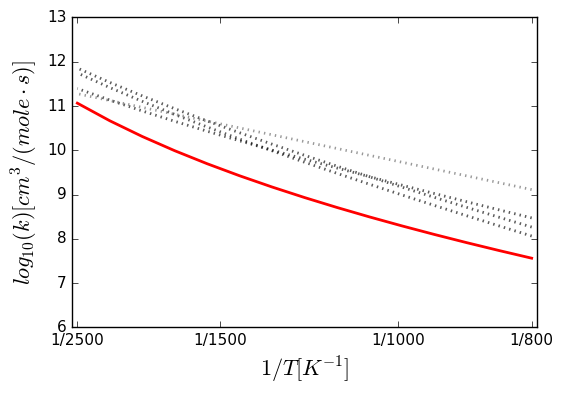


Arrhenius(A=(1.6e+13,'cm^3/(mol*s)'), n=0, Ea=(14400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000283545,'cm^3/(mol*s)'), n=4.25756, Ea=(56.906,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.18226, dn = +|- 0.0219739, dEa = +|- 0.120878 kJ/mol""")
c3h6o1-3 + ho2 => h2o2 + pc2h4cho


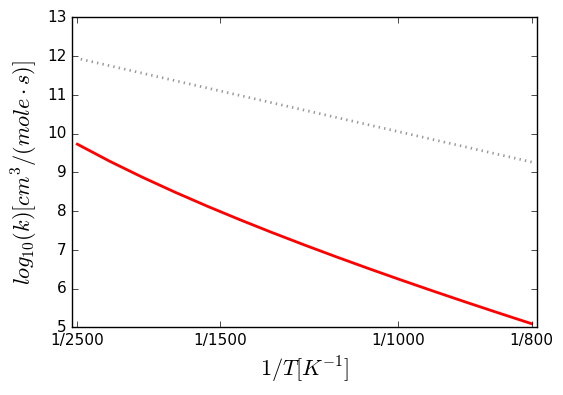


Arrhenius(A=(3290,'cm^3/(mol*s)'), n=2.51, Ea=(6362,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00267709,'cm^3/(mol*s)'), n=3.85305, Ea=(-2.62801,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06758, dn = +|- 0.00858248, dEa = +|- 0.0472123 kJ/mol""")
C5H10CHO-3 + H2O2 <=> NC5H11CHO + HO2


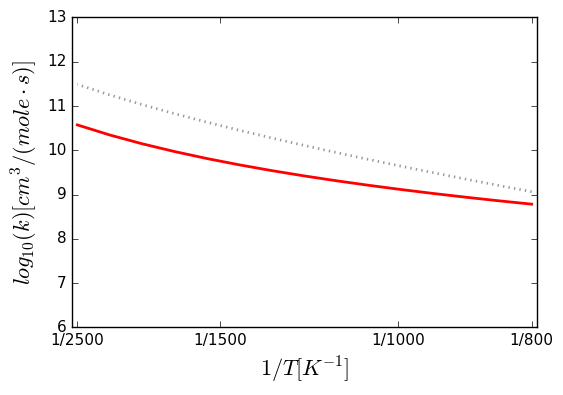


Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhe

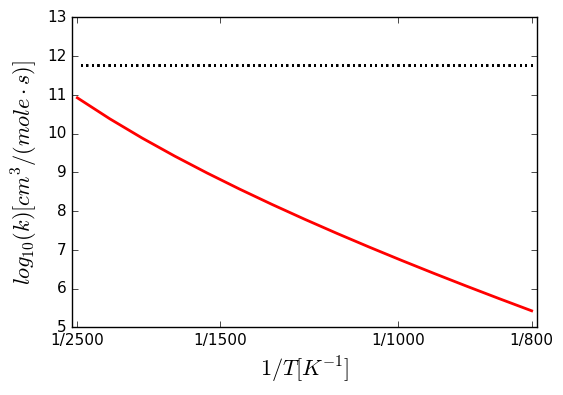


Arrhenius(A=(3.85e+12,'cm^3/(mol*s)'), n=-0.33, Ea=(12000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000979078,'cm^3/(mol*s)'), n=4.2142, Ea=(5.0709,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.26637, dn = +|- 0.0309928, dEa = +|- 0.170492 kJ/mol""")
TC4H9CO + H2O2 <=> TC4H9CHO + HO2


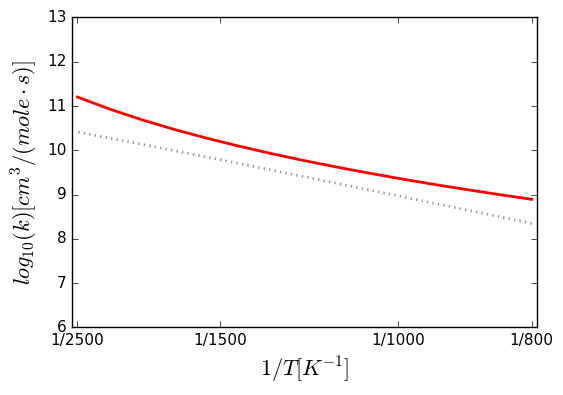


Arrhenius(A=(2.28e+06,'cm^3/(mol*s)'), n=2.06, Ea=(17670,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.35128e-10,'cm^3/(mol*s)'), n=6.06327, Ea=(33.0279,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 3.99022, dn = +|- 0.181617, dEa = +|- 0.999077 kJ/mol""")
C2H3CHCHO + H2O2 <=> AC3H5CHO + HO2


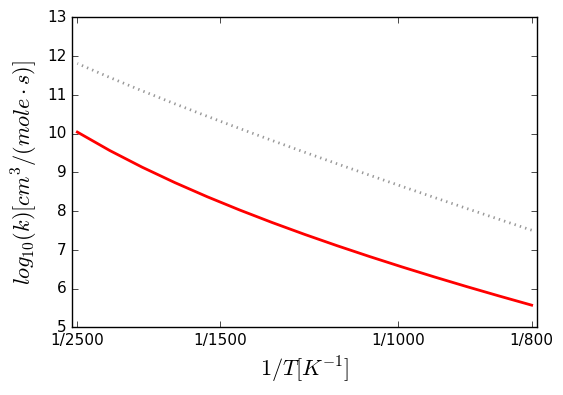


Arrhenius(A=(10830,'cm^3/(mol*s)'), n=2, Ea=(1875.57,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(10830,'cm^3/(mol*s)'), n=2, Ea=(1875.57,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000719559,'cm^3/(mol*s)'), n=4.37444, Ea=(59.948,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.23486, dn = +|- 0.0276867, dEa = +|- 0.152304 kJ/mol""")
CH2C3H5 + H2O2 => NC4H8 + HO2


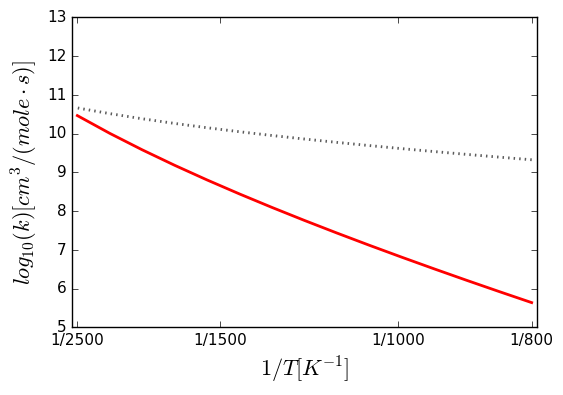


Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.34801,'cm^3/(mol*s)'), n=3.63231, Ea=(-1.98629,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.16998, dn = +|- 0.0206031, dEa = +|- 0.113338 kJ/mol""")
R8CH3OO + R2OH <=> R7CH3O + R3OOH


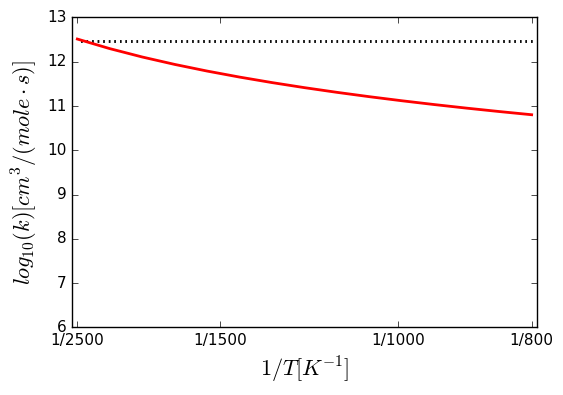


Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhe

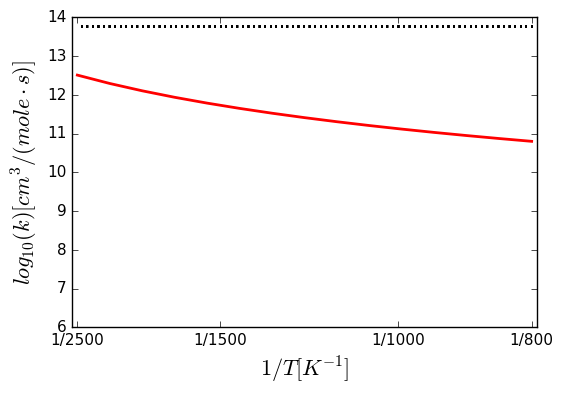


Arrhenius(A=(2.73e+10,'cm^3/(mol*s)'), n=-0.01, Ea=(12690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.80969e-08,'cm^3/(mol*s)'), n=6.01155, Ea=(21.3974,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.80702, dn = +|- 0.0776529, dEa = +|- 0.427169 kJ/mol""")
CH3CHCO + HO2 <=> CH3CHCHO + O2


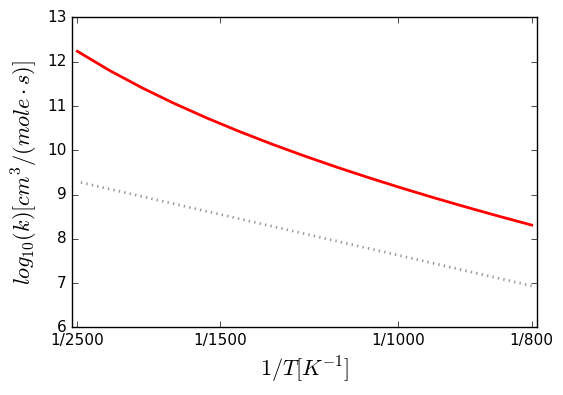


Arrhenius(A=(0.009013,'cm^3/(mol*s)'), n=4.306, Ea=(11006.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.80969e-08,'cm^3/(mol*s)'), n=6.01155, Ea=(21.3974,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.80702, dn = +|- 0.0776529, dEa = +|- 0.427169 kJ/mol""")
ch3chco + ho2 <=> c2h3co + h2o2


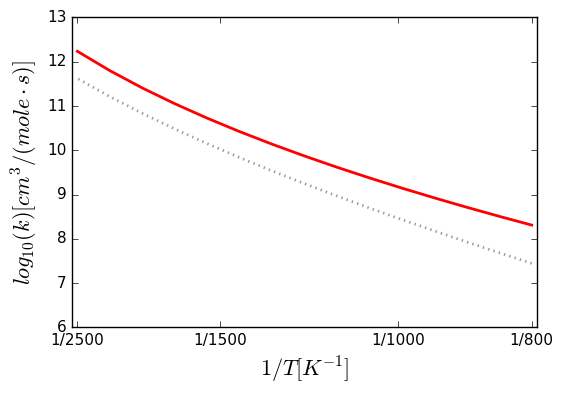


Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.88097e-07,'cm^3/(mol*s)'), n=5.34856, Ea=(20.3184,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.17029, dn = +|- 0.101693, dEa = +|- 0.559416 kJ/mol""")
c4h7oh1-2 + ho2 <=> c2h5coch3 + ho2


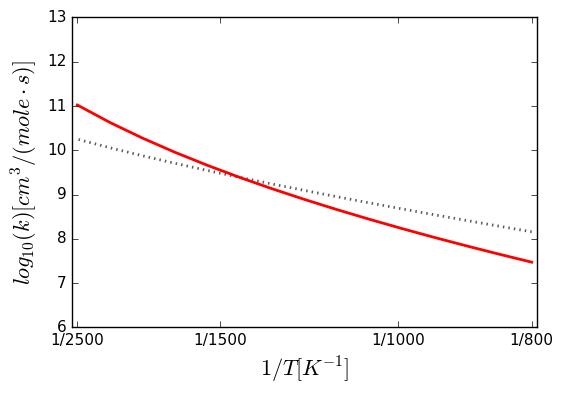


Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.88097e-07,'cm^3/(mol*s)'), n=5.34856, Ea=(20.3184,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.17029, dn = +|- 0.101693, dEa = +|- 0.559416 kJ/mol""")
C4H7OH1-2 + HO2 <=> C4H6OH1-32 + H2O2


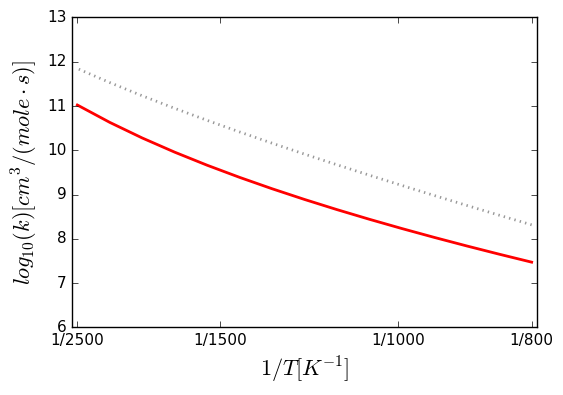


Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.88097e-07,'cm^3/(mol*s)'), n=5.34856, Ea=(20.3184,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.17029, dn = +|- 0.101693, dEa = +|- 0.559416 kJ/mol""")
c4h7oh1-2 + ho2 <=> c4h6oh1-32 + h2o2


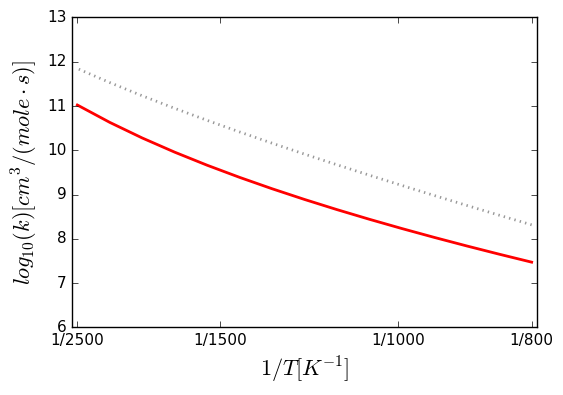


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.35595e-07,'cm^3/(mol*s)'), n=5.62319, Ea=(23.929,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.63061, dn = +|- 0.126938, dEa = +|- 0.698288 kJ/mol""")
CHXDCH23N + HO2 <=> CHXDCH23N6J + H2O2


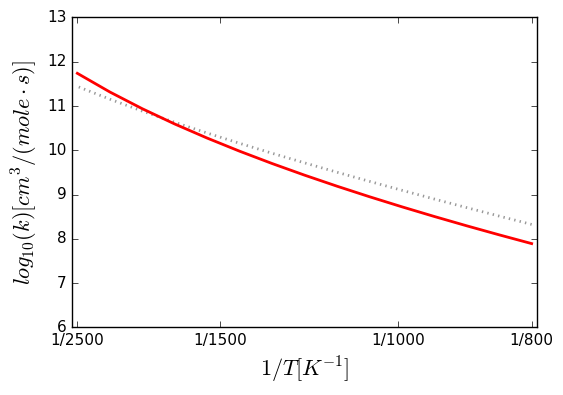


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.35595e-07,'cm^3/(mol*s)'), n=5.62319, Ea=(23.929,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.63061, dn = +|- 0.126938, dEa = +|- 0.698288 kJ/mol""")
CHXDCH23N + HO2 <=> CHXDCH23N2J + H2O2


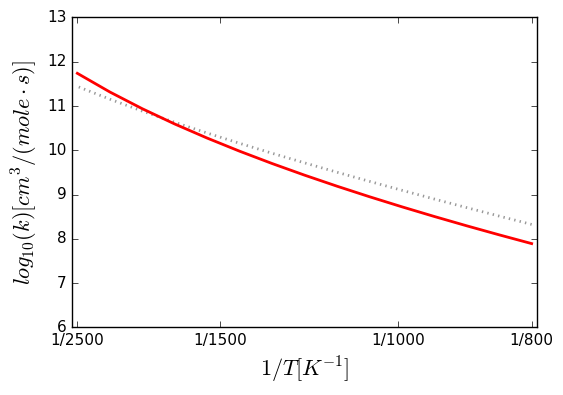


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.35595e-07,'cm^3/(mol*s)'), n=5.62319, Ea=(23.929,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.63061, dn = +|- 0.126938, dEa = +|- 0.698288 kJ/mol""")
CHXDCH23N + HO2 <=> CHXDCH23N5J + H2O2


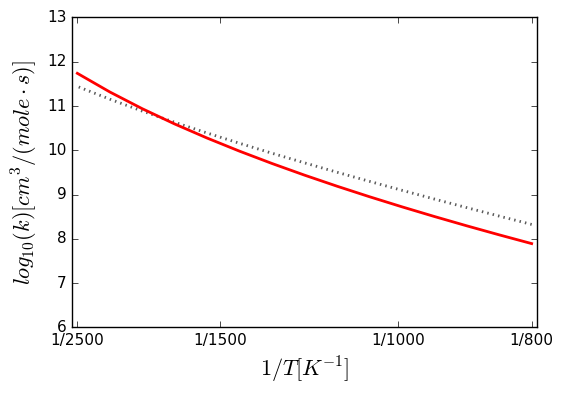


Arrhenius(A=(35400,'cm^3/(mol*s)'), n=2.19, Ea=(4492,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000435069,'cm^3/(mol*s)'), n=4.40483, Ea=(57.9043,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.22723, dn = +|- 0.0268733, dEa = +|- 0.14783 kJ/mol""")
C3H6COC2H5-1 + H2O2 <=> NC3H7COC2H5 + HO2


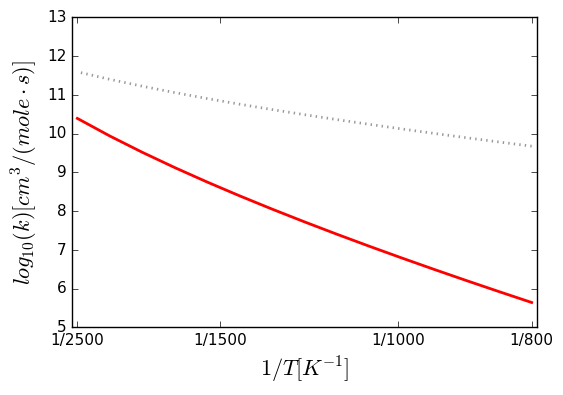


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000128733,'cm^3/(mol*s)'), n=4.53242, Ea=(39.5381,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.38116, dn = +|- 0.0423806, dEa = +|- 0.233136 kJ/mol""")
HO2 + C7H15O2H-2 <=> H2O2 + C7H15O2-2


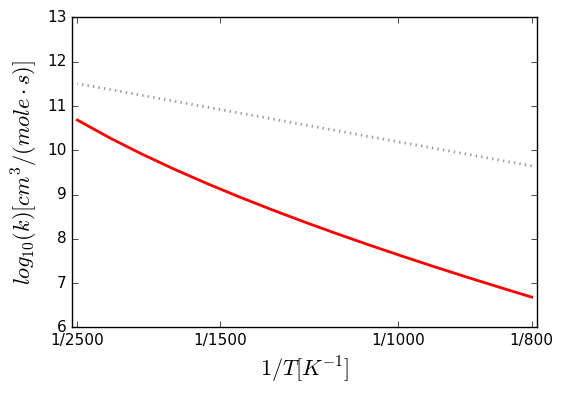


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'), comment="""Chemkin file stated explicit reverse rate: REV /  0.000E+00  0.00  0.000E+00 /""")
Arrhenius(A=(0.016056,'cm^3/(mol*s)'), n=3.88128, Ea=(48.0591,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.0603, dn = +|- 0.00768492, dEa = +|- 0.0422748 kJ/mol""")
sc4h8ohm + ho2 => sc4h8oh-mo + oh


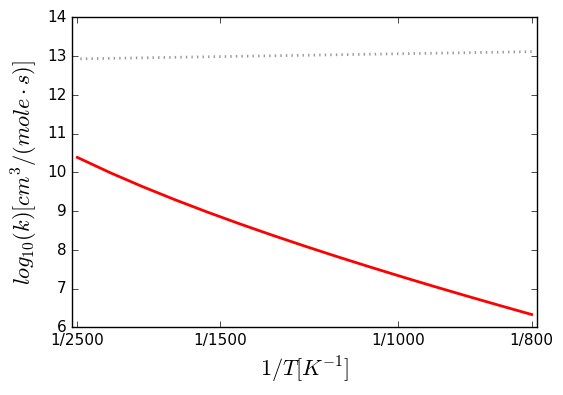


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000204667,'cm^3/(mol*s)'), n=4.461, Ea=(43.9163,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.2428, dn = +|- 0.0285271, dEa = +|- 0.156928 kJ/mol""")
NC10H21CHO + HO2 <=> NC10H21CO + H2O2


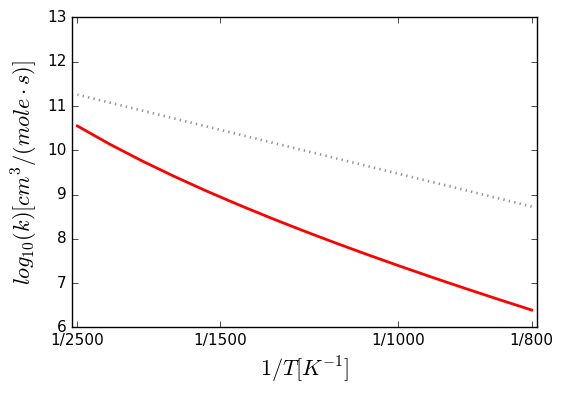


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(5999.04,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(6000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)')

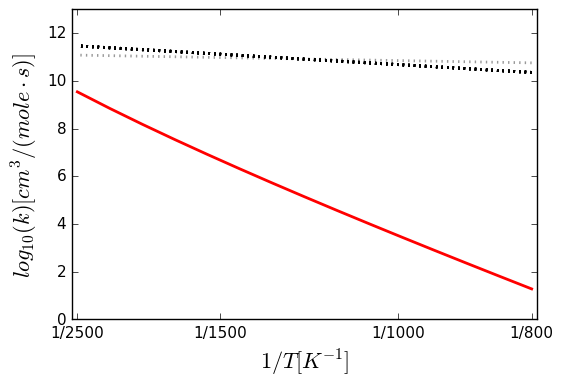


Arrhenius(A=(1.22e+12,'cm^3/(mol*s)'), n=0, Ea=(20070.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(26940,'cm^3/(mol*s)'), n=2, Ea=(15156.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(26940,'cm^3/(mol*s)'), n=2, Ea=(15156.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.03337,'cm^3/(mol*s)'), n=4.12, Ea=(16234,'cal/mol'), T0=(1,'K'))
MultiArrhenius(arrhenius=[Arrhenius(A=(236.8,'cm^3/(mol*s)'), n=3.204, Ea=(20558.3,'cal/mol'), T0=(1,'K')), Arrhenius(A=(0.0121,'cm^3/(mol*s)'), n=4.157, Ea=(16677.5,'cal/mol'), T0=(1,'K'))])
Arrhenius(A=(0.03337,'cm^3/(mol*s)'), n=4.12, Ea=(16235.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(26940,'cm^3/(mol*s)'), n=2, Ea=(15156.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.22e+12,'cm^3/(mol*s)'), n=0, Ea=(20070.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.65209e-05,'cm^3/(mol*s)'), n=4.75281, Ea=(41.0752,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.49501, dn = +|- 0.0527765, dEa = +|- 0.290324 kJ/mol""")
CH3OH + HO2 <=> CH3O + H2

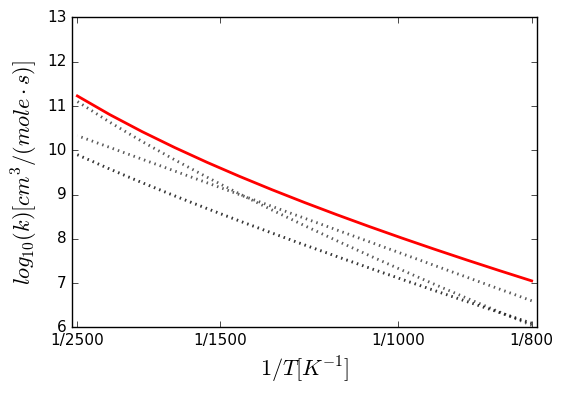


Arrhenius(A=(22620,'cm^3/(mol*s)'), n=2, Ea=(5184.35,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(22620,'cm^3/(mol*s)'), n=2, Ea=(5184.35,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(22620,'cm^3/(mol*s)'), n=2, Ea=(5184.35,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(22620,'cm^3/(mol*s)'), n=2, Ea=(5184.35,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.65209e-05,'cm^3/(mol*s)'), n=4.75281, Ea=(41.0752,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.49501, dn = +|- 0.0527765, dEa = +|- 0.290324 kJ/mol""")
CH2OH + H2O2 => CH3OH + HO2


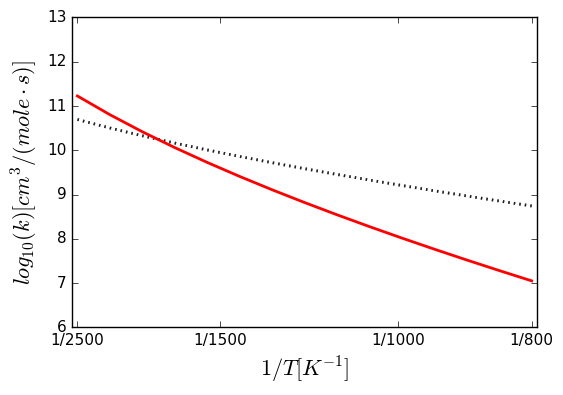


Arrhenius(A=(10800,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.26e+13,'cm^3/(mol*s)'), n=0, Ea=(18782.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+13,'cm^3/(mol*s)'), n=0, Ea=(19400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(10800,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.98e+13,'cm^3/(mol*s)'), n=0, Ea=(19400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(10800,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.98e+13,'cm^3/(mol*s)'), n=0, Ea=(19400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(10800,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.98e+13,'cm^3/(mol*s)'), n=0, Ea=(19400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(10800,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.98e+13,'cm^3/(mol*s)'), n=0, Ea=(19400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(10800,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.13e+13,'cm^3/(mol*s)'), n=0, Ea=(19360,'cal/mol')

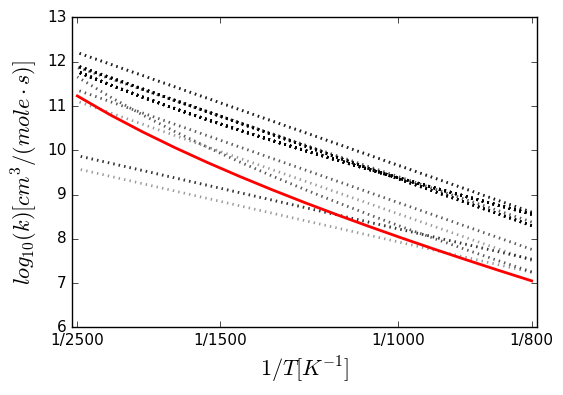


Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.78068e-07,'cm^3/(mol*s)'), n=5.00714, Ea=(10.7844,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.92348, dn = +|- 0.0858498, dEa = +|- 0.47226 kJ/mol""")
ic3h6chcoch3 + ho2 <=> ac3h5chcoch3 + h2o2


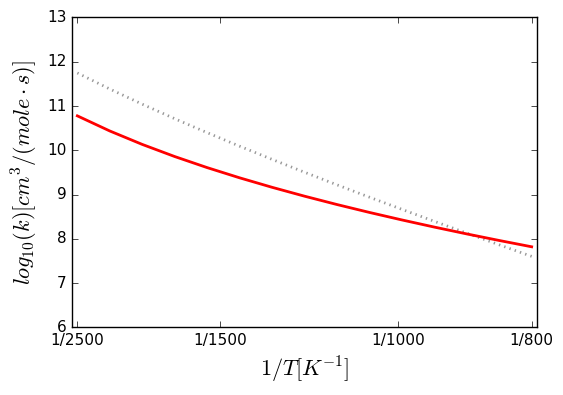


Arrhenius(A=(17,'cm^3/(mol*s)'), n=1.76, Ea=(10110,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.78068e-07,'cm^3/(mol*s)'), n=5.00714, Ea=(10.7844,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.92348, dn = +|- 0.0858498, dEa = +|- 0.47226 kJ/mol""")
IC3H6CHCOCH2 + H2O2 <=> IC3H6CHCOCH3 + HO2


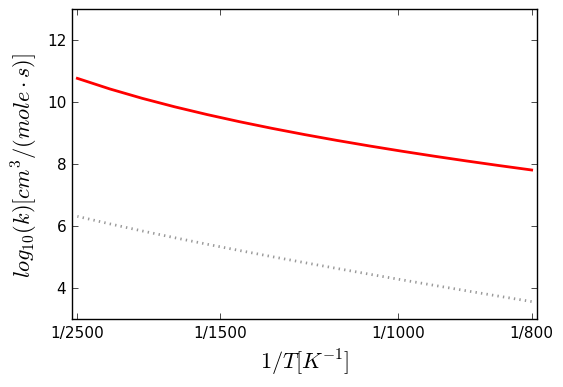


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.78068e-07,'cm^3/(mol*s)'), n=5.00714, Ea=(10.7844,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.92348, dn = +|- 0.0858498, dEa = +|- 0.47226 kJ/mol""")
ic3h6chcoch3 + ho2 <=> ic3h6chcoch2 + h2o2


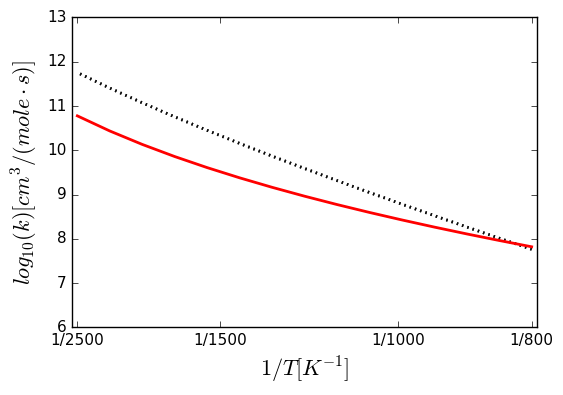


Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.78068e-07,'cm^3/(mol*s)'), n=5.00714, Ea=(10.7844,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.92348, dn = +|- 0.0858498, dEa = +|- 0.47226 kJ/mol""")
ic3h6chcoch3 + ho2 <=> ac3h5chcoch3 + h2o2


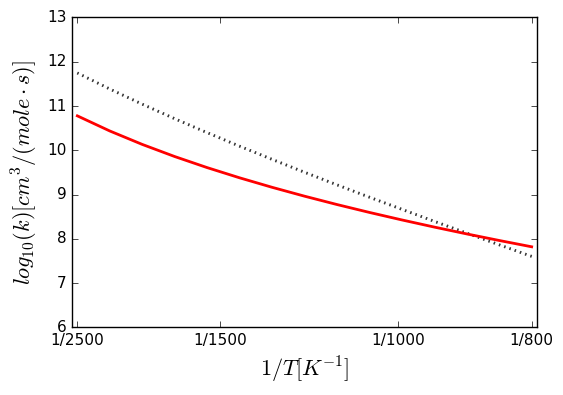


Arrhenius(A=(4.33e+11,'cm^3/(mol*s)'), n=0.01, Ea=(8165,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00151046,'cm^3/(mol*s)'), n=3.88356, Ea=(-2.19007,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08503, dn = +|- 0.0107103, dEa = +|- 0.0589176 kJ/mol""")
C7H15-4 + H2O2 <=> NC7H16 + HO2


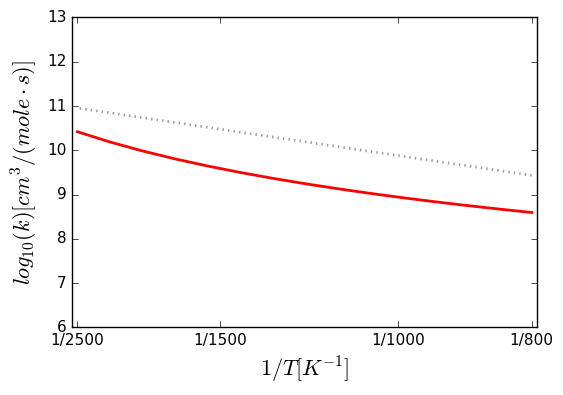


Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.0244e-05,'cm^3/(mol*s)'), n=4.71526, Ea=(38.8658,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.47872, dn = +|- 0.0513387, dEa = +|- 0.282414 kJ/mol""")
ic4h8oh-2o2 + ho2 <=> ic4h8oh-2o2h + o2


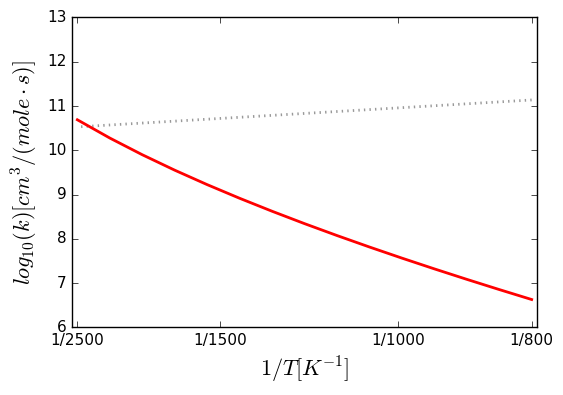


Arrhenius(A=(2.94581e-10,'cm^3/(mol*s)'), n=6.57951, Ea=(16.5688,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.39838, dn = +|- 0.114809, dEa = +|- 0.631562 kJ/mol""")
C6H8(19) + HO2(2) <=> C6H7(81) + H2O2(4)


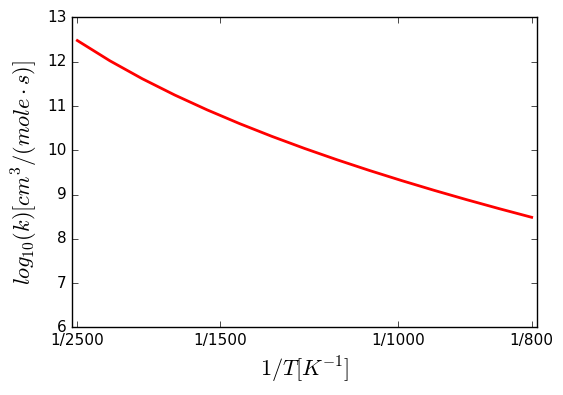


Arrhenius(A=(2.94581e-10,'cm^3/(mol*s)'), n=6.57951, Ea=(16.5688,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.39838, dn = +|- 0.114809, dEa = +|- 0.631562 kJ/mol""")
C6H8(19) + HO2(2) <=> C6H7(20) + H2O2(4)


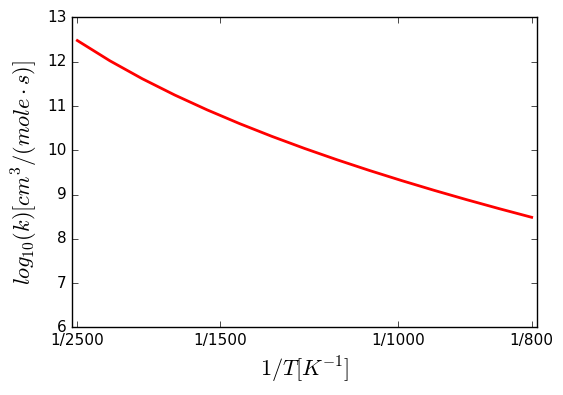


Arrhenius(A=(1280,'cm^3/(mol*s)'), n=2.6, Ea=(4399,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00205182,'cm^3/(mol*s)'), n=3.76541, Ea=(-3.97648,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.03507, dn = +|- 0.00452386, dEa = +|- 0.0248858 kJ/mol""")
C4H8CHO-2 + H2O2 <=> NC4H9CHO + HO2


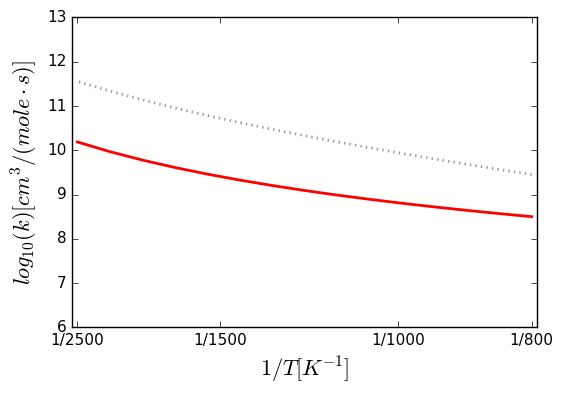


Arrhenius(A=(1.24e+07,'cm^3/(mol*s)'), n=1.91, Ea=(13320,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.56887e-10,'cm^3/(mol*s)'), n=5.8952, Ea=(27.996,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.99859, dn = +|- 0.144121, dEa = +|- 0.792811 kJ/mol""")
C5H10CHO-5 + H2O2 <=> NC5H11CHO + HO2


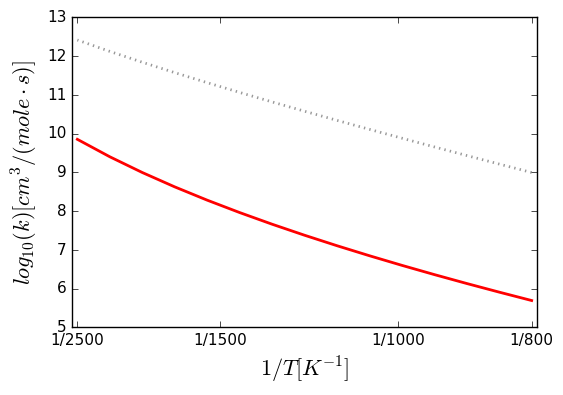


Arrhenius(A=(21600,'cm^3/(mol*s)'), n=2, Ea=(9455.49,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.85664e-05,'cm^3/(mol*s)'), n=4.60934, Ea=(8.52728,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.57852, dn = +|- 0.0599102, dEa = +|- 0.329566 kJ/mol""")
C5H7 + H2O2 => C5H8 + HO2


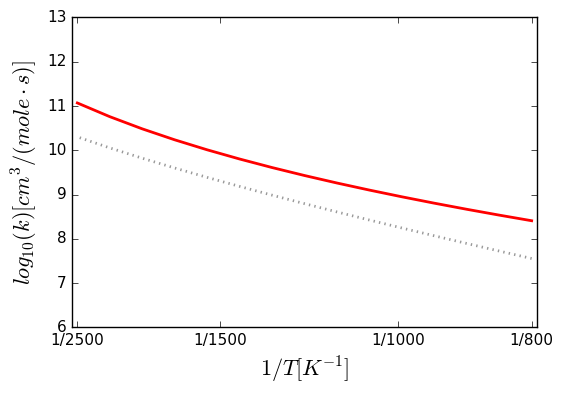


Arrhenius(A=(4.85e+11,'cm^3/(mol*s)'), n=0, Ea=(12700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.85e+11,'cm^3/(mol*s)'), n=0, Ea=(12700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.85e+11,'cm^3/(mol*s)'), n=0, Ea=(12700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.85664e-05,'cm^3/(mol*s)'), n=4.60934, Ea=(8.52728,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.57852, dn = +|- 0.0599102, dEa = +|- 0.329566 kJ/mol""")
HO2 + C5H81-3 => CY3C5H8O + OH


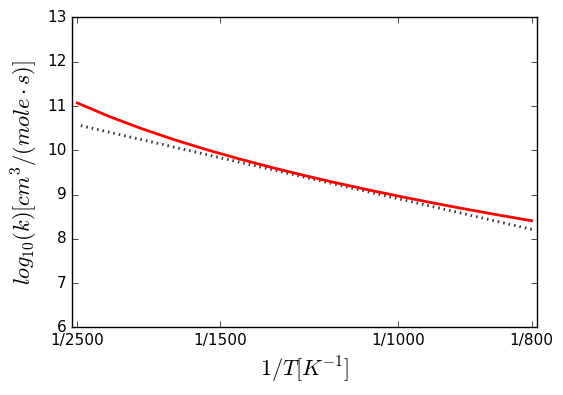


Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(12600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.85664e-05,'cm^3/(mol*s)'), n=4.60934, Ea=(8.52728,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.57852, dn = +|- 0.0599102, dEa = +|- 0.329566 kJ/mol""")
C5H81-3 + HO2 <=> C5H7 + H2O2


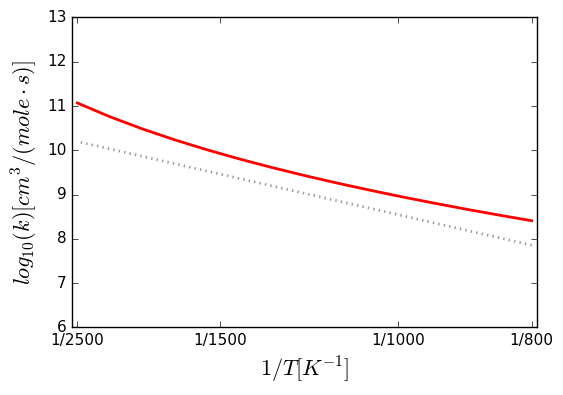


Arrhenius(A=(1.5e+11,'cm^3/(mol*s)'), n=0, Ea=(14190,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.5e+11,'cm^3/(mol*s)'), n=0, Ea=(14190,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.85664e-05,'cm^3/(mol*s)'), n=4.60934, Ea=(8.52728,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.57852, dn = +|- 0.0599102, dEa = +|- 0.329566 kJ/mol""")
HO2 + C*CC*CC <=> H2O2 + C*CC*CCJ


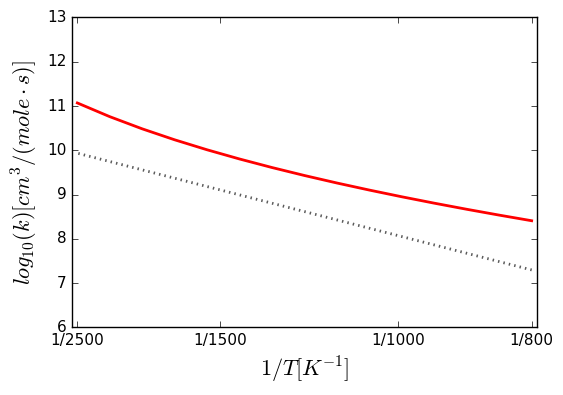


Arrhenius(A=(0.362,'cm^3/(mol*s)'), n=3.98, Ea=(9058,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.57284e-06,'cm^3/(mol*s)'), n=4.76828, Ea=(36.2339,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.50424, dn = +|- 0.0535844, dEa = +|- 0.294768 kJ/mol""")
C4H8O + HO2 <=> C4H7Od + H2O2


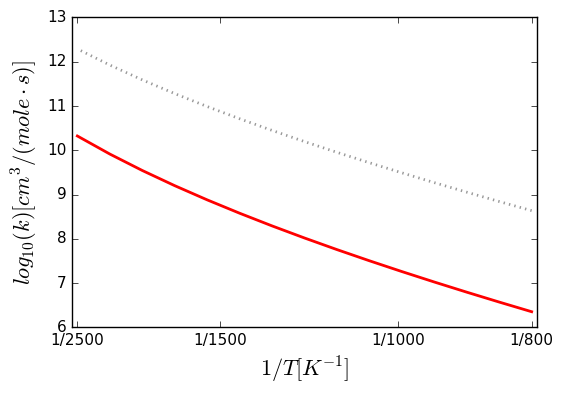


Arrhenius(A=(116000,'cm^3/(mol*s)'), n=2.23, Ea=(-3022,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(116000,'cm^3/(mol*s)'), n=2.23, Ea=(-3022,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(116000,'cm^3/(mol*s)'), n=2.23, Ea=(-3022,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.16e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(116000,'cm^3/(mol*s)'), n=2.23, Ea=(-3022,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.16e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(118900,'cm^3/(mol*s)'), n=2.228, Ea=(-3022,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(116000,'cm^3/(mol*s)'), n=2.23, Ea=(-3022,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(116000,'cm^3/(mol*s)'), n=2.23, Ea=(-3022,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(118900,'cm^3/(mol*s)'), n=2.228, Ea=(-3022,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.61e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
A

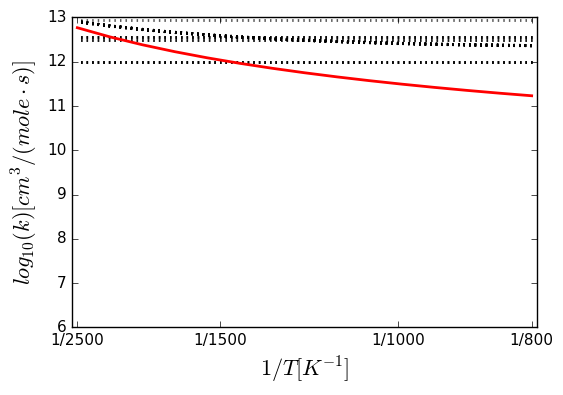


Arrhenius(A=(28.8,'cm^3/(mol*s)'), n=3.1, Ea=(6940,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(28.8,'cm^3/(mol*s)'), n=3.1, Ea=(6940,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.997252,'cm^3/(mol*s)'), n=3.71639, Ea=(-6.81275,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.04511, dn = +|- 0.00579038, dEa = +|- 0.0318529 kJ/mol""")
H2O2 + CH2 <=> HO2 + CH3


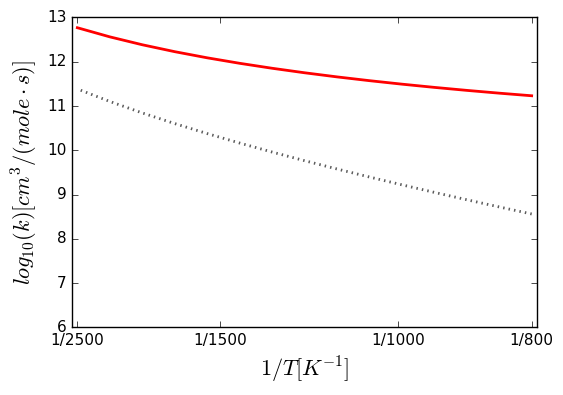


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0.269, Ea=(-687.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0.269, Ea=(-687.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'J/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0.269, Ea=(-687.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+10,'cm^3/(mol*s)'), n=0.76, Ea=(-2325,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0.269, Ea=(-687.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+10,'cm^3/(mol*s)'), n=0.76, Ea=(-2325,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.34e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.34e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0.269, Ea=(-687.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0.269, Ea=(-687.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,

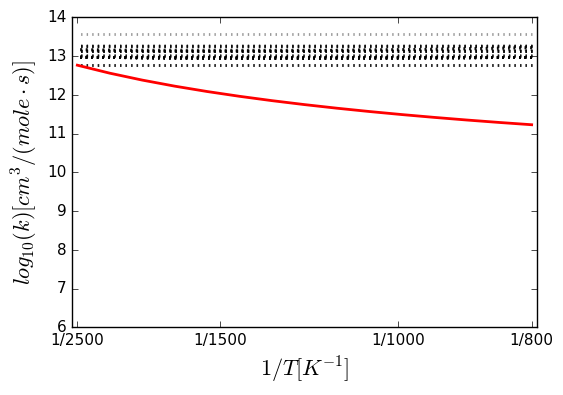


Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(53880,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000355142,'cm^3/(mol*s)'), n=4.62015, Ea=(54.1709,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.37775, dn = +|- 0.0420569, dEa = +|- 0.231355 kJ/mol""")
sc4h9oh + ho2 <=> sc4h9o + h2o2


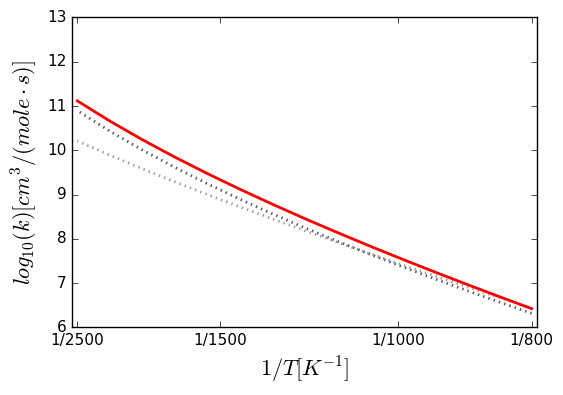


Arrhenius(A=(1.25e-05,'cm^3/(mol*s)'), n=5.26, Ea=(7468,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.25e-05,'cm^3/(mol*s)'), n=5.26, Ea=(7468,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(80820,'cm^3/(mol*s)'), n=2, Ea=(10318.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000355142,'cm^3/(mol*s)'), n=4.62015, Ea=(54.1709,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.37775, dn = +|- 0.0420569, dEa = +|- 0.231355 kJ/mol""")
sc4h9oh + ho2 <=> sc4h8oh-1 + h2o2


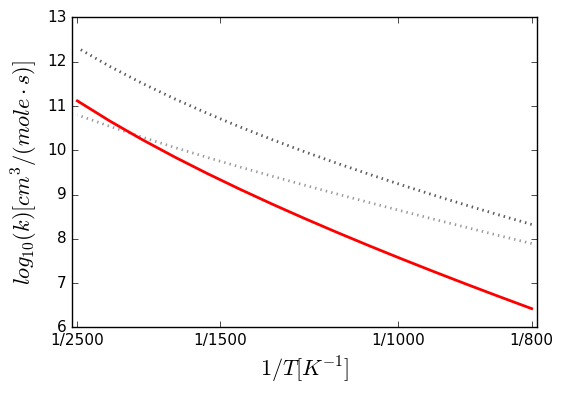


Arrhenius(A=(0.00751,'cm^3/(mol*s)'), n=4.52, Ea=(14710,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00751,'cm^3/(mol*s)'), n=4.52, Ea=(14710,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(107800,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000355142,'cm^3/(mol*s)'), n=4.62015, Ea=(54.1709,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.37775, dn = +|- 0.0420569, dEa = +|- 0.231355 kJ/mol""")
sc4h9oh + ho2 <=> sc4h8oh-2 + h2o2


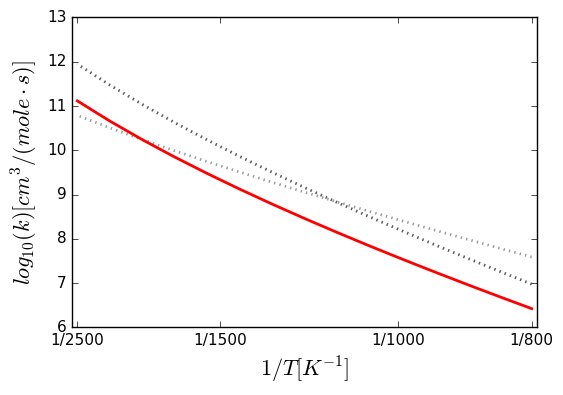


Arrhenius(A=(0.0113,'cm^3/(mol*s)'), n=4.52, Ea=(13850,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0113,'cm^3/(mol*s)'), n=4.52, Ea=(13850,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(161600,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000355142,'cm^3/(mol*s)'), n=4.62015, Ea=(54.1709,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.37775, dn = +|- 0.0420569, dEa = +|- 0.231355 kJ/mol""")
sc4h9oh + ho2 <=> sc4h8ohm + h2o2


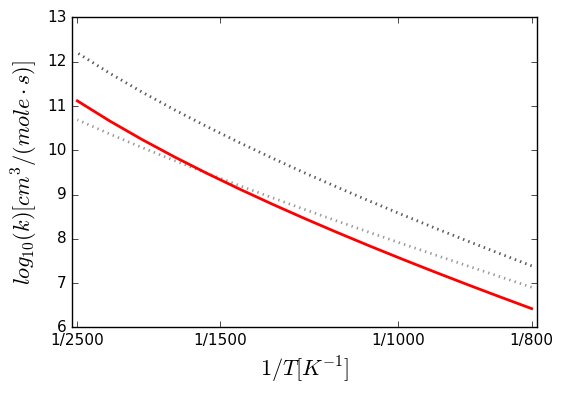


Arrhenius(A=(0.000414,'cm^3/(mol*s)'), n=4.76, Ea=(15050,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000414,'cm^3/(mol*s)'), n=4.76, Ea=(15050,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(161600,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000355142,'cm^3/(mol*s)'), n=4.62015, Ea=(54.1709,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.37775, dn = +|- 0.0420569, dEa = +|- 0.231355 kJ/mol""")
sc4h9oh + ho2 <=> sc4h8oh-3 + h2o2


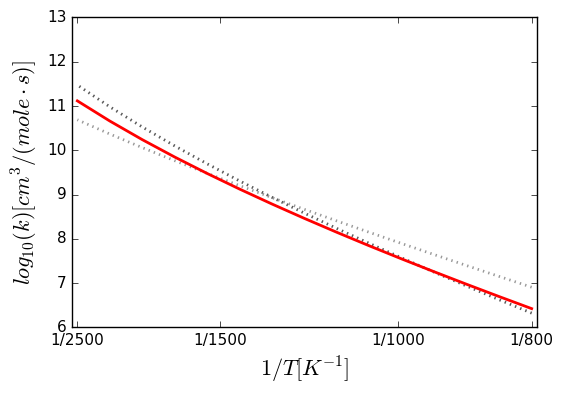


Arrhenius(A=(1.82e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.90287,'cm^3/(mol*s)'), n=3.56523, Ea=(35.4192,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11394, dn = +|- 0.0141611, dEa = +|- 0.0779005 kJ/mol""")
OH + OOCHO <=> HO2 + OCHO


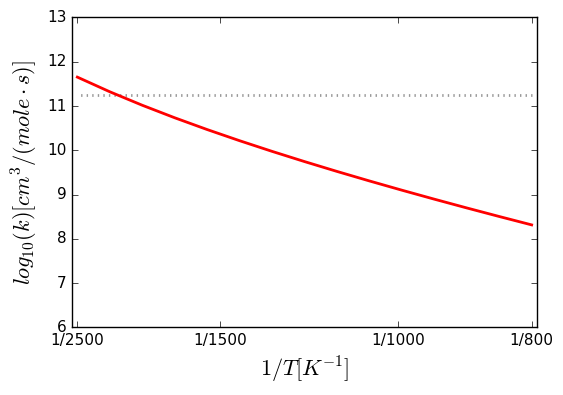


Arrhenius(A=(900000,'cm^3/(mol*s)'), n=2, Ea=(-1133,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(900000,'cm^3/(mol*s)'), n=2, Ea=(-1133,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(900000,'cm^3/(mol*s)'), n=2, Ea=(-1133,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(900000,'cm^3/(mol*s)'), n=2, Ea=(-1133,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.113168,'cm^3/(mol*s)'), n=3.90086, Ea=(83.965,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.22796, dn = +|- 0.0269514, dEa = +|- 0.14826 kJ/mol""")
IC8H18 + OH <=> BC8H17 + H2O


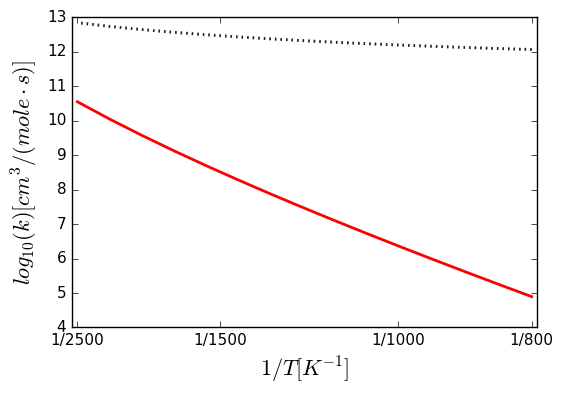


Arrhenius(A=(3.49e+06,'cm^3/(mol*s)'), n=1.8, Ea=(21660,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.113168,'cm^3/(mol*s)'), n=3.90086, Ea=(83.965,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.22796, dn = +|- 0.0269514, dEa = +|- 0.14826 kJ/mol""")
DC8H17 + H2O <=> IC8H18 + OH


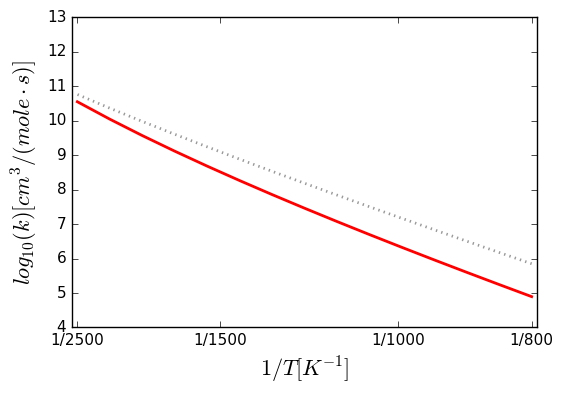


Arrhenius(A=(1.78e+07,'cm^3/(mol*s)'), n=1.8, Ea=(1431,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.78e+07,'cm^3/(mol*s)'), n=1.8, Ea=(1431,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.03e+07,'cm^3/(mol*s)'), n=1.99, Ea=(-284.42,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.78e+07,'cm^3/(mol*s)'), n=1.8, Ea=(1431,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.78e+07,'cm^3/(mol*s)'), n=1.8, Ea=(1431,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.78e+07,'cm^3/(mol*s)'), n=1.8, Ea=(1431,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.113168,'cm^3/(mol*s)'), n=3.90086, Ea=(83.965,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.22796, dn = +|- 0.0269514, dEa = +|- 0.14826 kJ/mol""")
IC8H18 + OH <=> DC8H17 + H2O


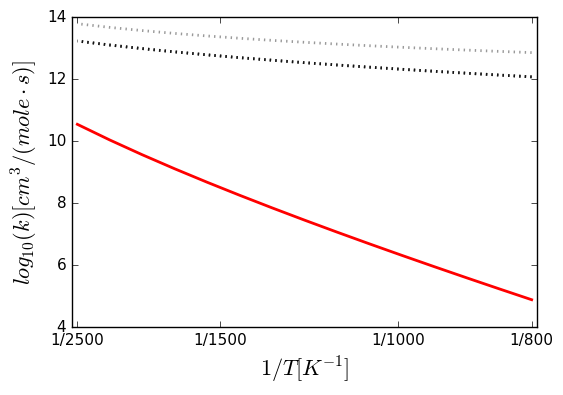


Arrhenius(A=(2.63e+07,'cm^3/(mol*s)'), n=1.8, Ea=(1431,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.63e+07,'cm^3/(mol*s)'), n=1.8, Ea=(1431,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.63e+07,'cm^3/(mol*s)'), n=1.8, Ea=(1431,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.63e+07,'cm^3/(mol*s)'), n=1.8, Ea=(1431,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.63e+07,'cm^3/(mol*s)'), n=1.8, Ea=(278.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.113168,'cm^3/(mol*s)'), n=3.90086, Ea=(83.965,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.22796, dn = +|- 0.0269514, dEa = +|- 0.14826 kJ/mol""")
IC8H18 + OH <=> AC8H17 + H2O


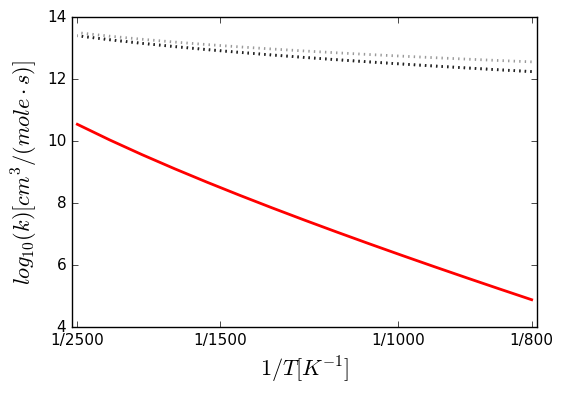


Arrhenius(A=(1.7e+06,'cm^3/(mol*s)'), n=1.9, Ea=(-1450,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+06,'cm^3/(mol*s)'), n=1.9, Ea=(-1450,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.595e+06,'cm^3/(mol*s)'), n=2, Ea=(-2259.83,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+06,'cm^3/(mol*s)'), n=1.9, Ea=(-1450,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+06,'cm^3/(mol*s)'), n=1.9, Ea=(-1450,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+06,'cm^3/(mol*s)'), n=1.9, Ea=(-1451,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.113168,'cm^3/(mol*s)'), n=3.90086, Ea=(83.965,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.22796, dn = +|- 0.0269514, dEa = +|- 0.14826 kJ/mol""")
IC8H18 + OH <=> CC8H17 + H2O


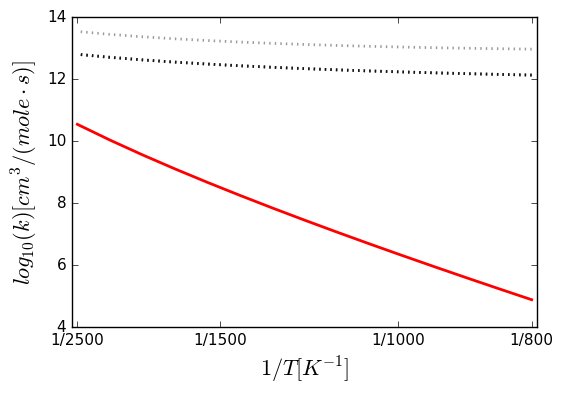


Arrhenius(A=(46300,'cm^3/(mol*s)'), n=2.24, Ea=(4430,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000602733,'cm^3/(mol*s)'), n=4.06211, Ea=(-0.523207,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15033, dn = +|- 0.0183801, dEa = +|- 0.101109 kJ/mol""")
IC3H6CH2CHO + H2O2 <=> IC4H9CHO + HO2


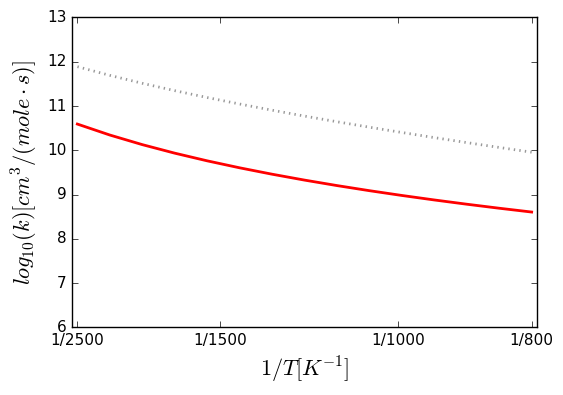


Arrhenius(A=(0.362,'cm^3/(mol*s)'), n=3.98, Ea=(9058,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.46381e-10,'cm^3/(mol*s)'), n=6.0746, Ea=(20.7976,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 3.18244, dn = +|- 0.151931, dEa = +|- 0.835772 kJ/mol""")
HCOCH2OCHO + HO2 <=> HCOCHOCHO + H2O2


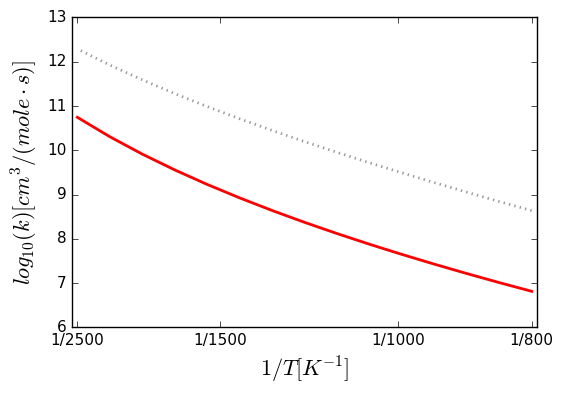


Arrhenius(A=(2.24e+13,'cm^3/(mol*s)'), n=0, Ea=(16840,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.46381e-10,'cm^3/(mol*s)'), n=6.0746, Ea=(20.7976,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 3.18244, dn = +|- 0.151931, dEa = +|- 0.835772 kJ/mol""")
HCOCH2OCHO + HO2 <=> COCH2OCHO + H2O2


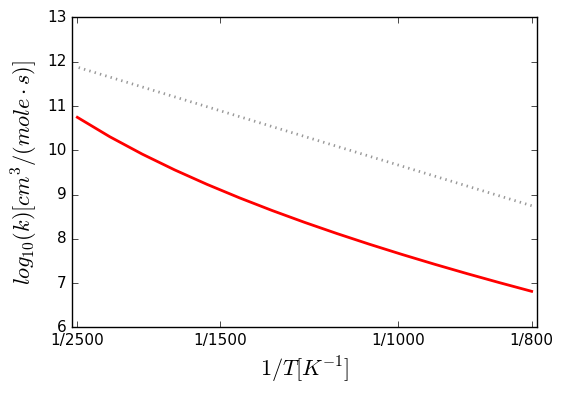


Arrhenius(A=(2.24e+13,'cm^3/(mol*s)'), n=0, Ea=(16840,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.46381e-10,'cm^3/(mol*s)'), n=6.0746, Ea=(20.7976,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 3.18244, dn = +|- 0.151931, dEa = +|- 0.835772 kJ/mol""")
HCOCH2OCHO + HO2 <=> HCOCH2OCO + H2O2


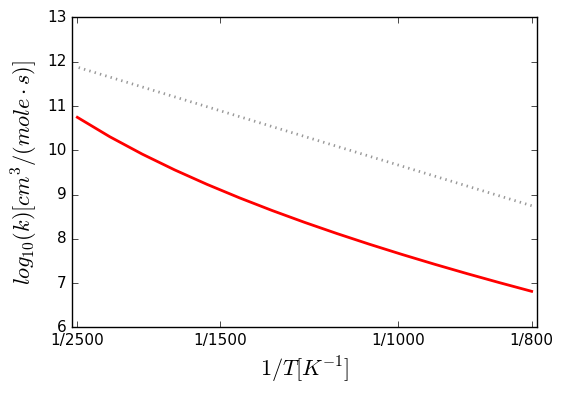


Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000228484,'cm^3/(mol*s)'), n=4.88886, Ea=(56.047,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06954, dn = +|- 0.00882341, dEa = +|- 0.0485376 kJ/mol""")
ic3h7coch3 + ho2 <=> tc3h6coch3 + h2o2


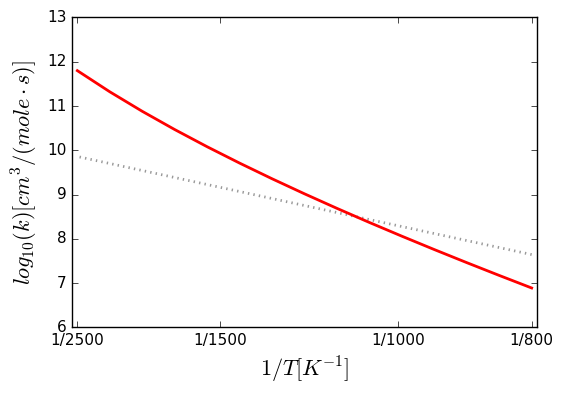


Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000228484,'cm^3/(mol*s)'), n=4.88886, Ea=(56.047,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06954, dn = +|- 0.00882341, dEa = +|- 0.0485376 kJ/mol""")
ic3h7coch3 + ho2 <=> tc3h6coch3 + h2o2


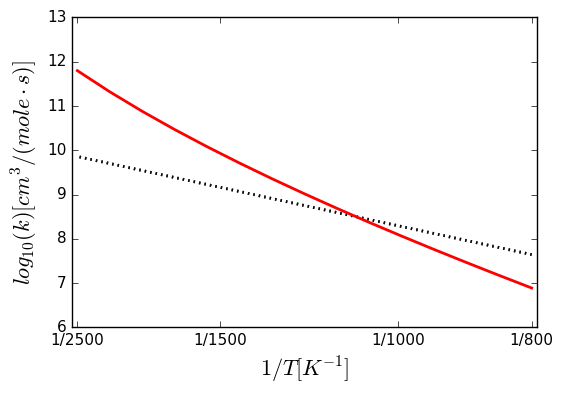


Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000228484,'cm^3/(mol*s)'), n=4.88886, Ea=(56.047,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06954, dn = +|- 0.00882341, dEa = +|- 0.0485376 kJ/mol""")
ic3h7coch3 + ho2 <=> ic3h7coch2 + h2o2


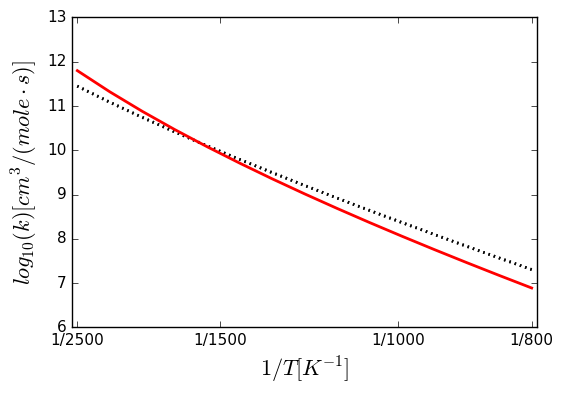


Arrhenius(A=(50900,'cm^3/(mol*s)'), n=2.16, Ea=(3532,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000228484,'cm^3/(mol*s)'), n=4.88886, Ea=(56.047,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06954, dn = +|- 0.00882341, dEa = +|- 0.0485376 kJ/mol""")
IC3H6COCH3 + H2O2 <=> IC3H7COCH3 + HO2


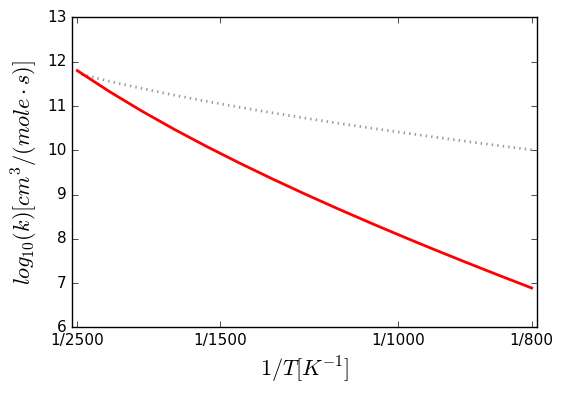


Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000228484,'cm^3/(mol*s)'), n=4.88886, Ea=(56.047,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06954, dn = +|- 0.00882341, dEa = +|- 0.0485376 kJ/mol""")
ic3h7coch3 + ho2 <=> ic3h6coch3 + h2o2


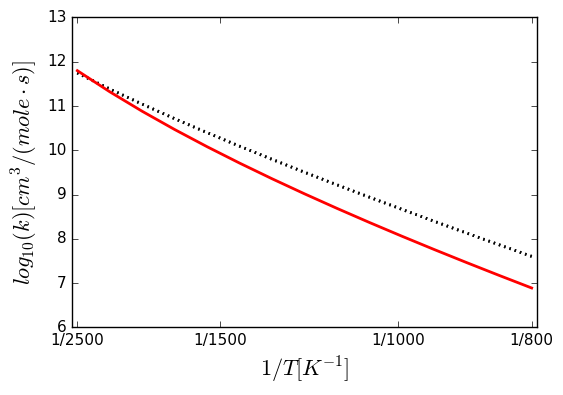


Arrhenius(A=(35400,'cm^3/(mol*s)'), n=2.19, Ea=(2692,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.101337,'cm^3/(mol*s)'), n=3.23595, Ea=(-8.03441,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.1786, dn = +|- 0.0215663, dEa = +|- 0.118636 kJ/mol""")
NC3H7COC2H4P + H2O2 <=> NC3H7COC2H5 + HO2


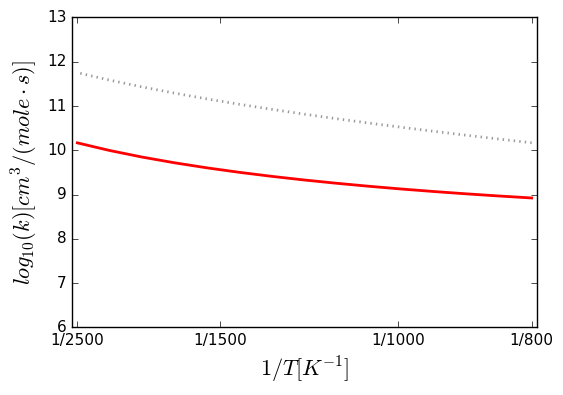


Arrhenius(A=(27000,'cm^3/(mol*s)'), n=0.7, Ea=(5884,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.782,'cm^3/(mol*s)'), n=3.97, Ea=(11702,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=0.7, Ea=(5884,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=0.7, Ea=(5884,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=0.7, Ea=(5884,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=0.7, Ea=(5884,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(17050,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=0.7, Ea=(5884,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(17050,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7130,'cm^3/(mol*s)'), n=2.77, Ea=(14913,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=0.7, Ea=(5884,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrheniu

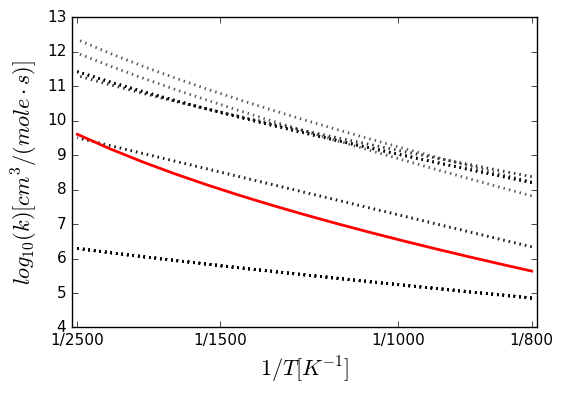


Arrhenius(A=(27200,'cm^3/(mol*s)'), n=2, Ea=(9160.93,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27200,'cm^3/(mol*s)'), n=2, Ea=(9160.93,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.42917e-08,'cm^3/(mol*s)'), n=5.18689, Ea=(31.6545,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.46013, dn = +|- 0.118145, dEa = +|- 0.649917 kJ/mol""")
SC4H7 + H2O2 => NC4H8 + HO2


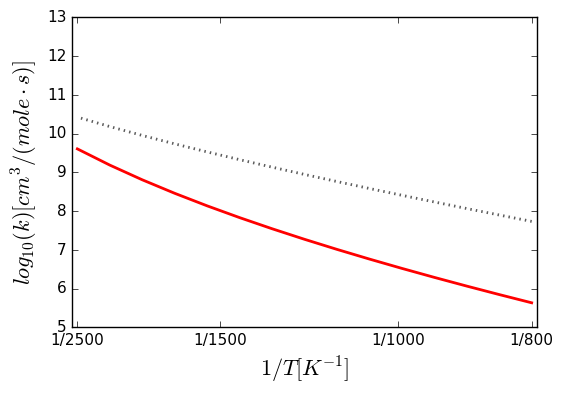


Arrhenius(A=(2380,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2380,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2380,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2380,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2380,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(17050,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2380,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(17050,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2380,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhen

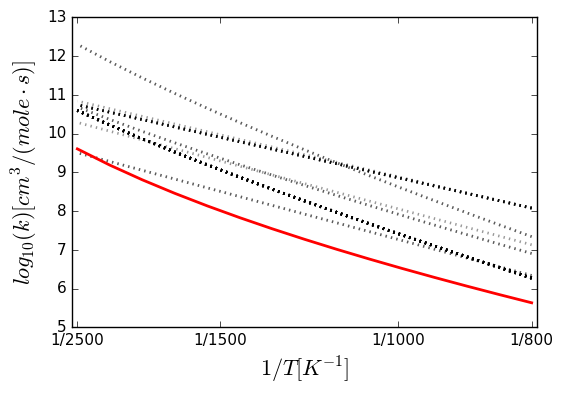


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3

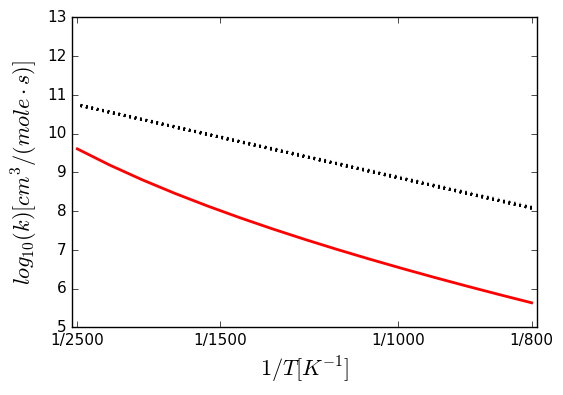


Arrhenius(A=(957,'cm^3/(mol*s)'), n=3.059, Ea=(20798.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(957,'cm^3/(mol*s)'), n=3.059, Ea=(20798.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.42917e-08,'cm^3/(mol*s)'), n=5.18689, Ea=(31.6545,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.46013, dn = +|- 0.118145, dEa = +|- 0.649917 kJ/mol""")
C4H8-1 + HO2 <=> C4H71-1 + H2O2


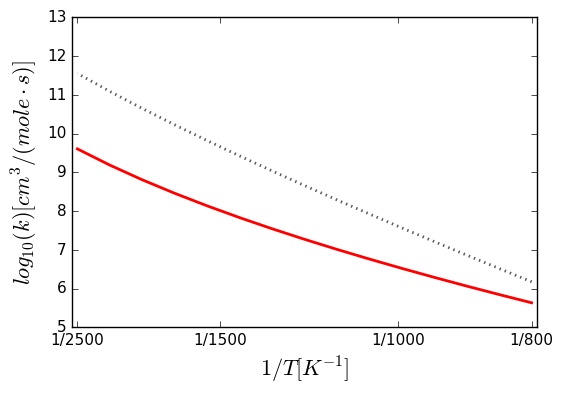


Arrhenius(A=(18390,'cm^3/(mol*s)'), n=2, Ea=(2691.16,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.7e+09,'cm^3/(mol*s)'), n=0, Ea=(974,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.7e+09,'cm^3/(mol*s)'), n=0, Ea=(974,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.7e+09,'cm^3/(mol*s)'), n=0, Ea=(974,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.7e+09,'cm^3/(mol*s)'), n=0, Ea=(974,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.7e+09,'cm^3/(mol*s)'), n=0, Ea=(974,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.7e+09,'cm^3/(mol*s)'), n=0, Ea=(974,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.73e+09,'cm^3/(mol*s)'), n=0, Ea=(974,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18390,'cm^3/(mol*s)'), n=2, Ea=(2691.16,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.7e+09,'cm^3/(mol*s)'), n=0, Ea=(974,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.7e+09,'cm^3/(mol*s)'), n=0, Ea=(974,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18390,'cm^3/(mol*s)'), n=2, Ea=(2691.16,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.7e+09,'cm^3/(mol*s)'), n=0, Ea=(974,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.7e

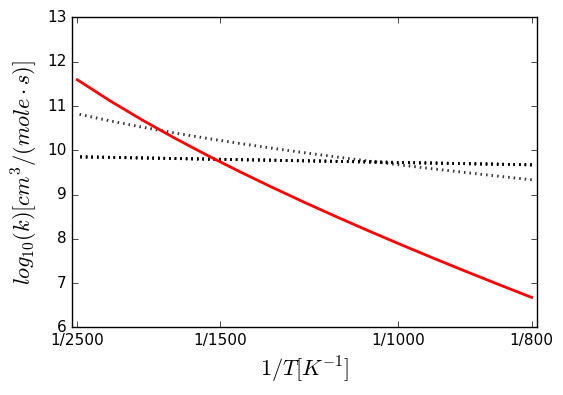


Arrhenius(A=(34.6,'cm^3/(mol*s)'), n=3.61, Ea=(16920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(34.6,'cm^3/(mol*s)'), n=3.61, Ea=(16920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(484900,'cm^3/(mol*s)'), n=2, Ea=(14841.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.32e+13,'cm^3/(mol*s)'), n=0, Ea=(85634.8,'J/mol'), T0=(1,'K'))
Arrhenius(A=(34.6,'cm^3/(mol*s)'), n=3.61, Ea=(16920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(69.2,'cm^3/(mol*s)'), n=3.61, Ea=(16920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(34.6,'cm^3/(mol*s)'), n=3.61, Ea=(16920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(34.6,'cm^3/(mol*s)'), n=3.61, Ea=(16920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(261,'cm^3/(mol*s)'), n=3.37, Ea=(15913,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(34.6,'cm^3/(mol*s)'), n=3.61, Ea=(16920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20520,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(261,'cm^3/(mol*s)'), n=3.37, Ea=(15913,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(34.6,'cm^3/(mol*s)'), n=3.61, Ea=(16920,'cal/mol'), T0=(1,'K')

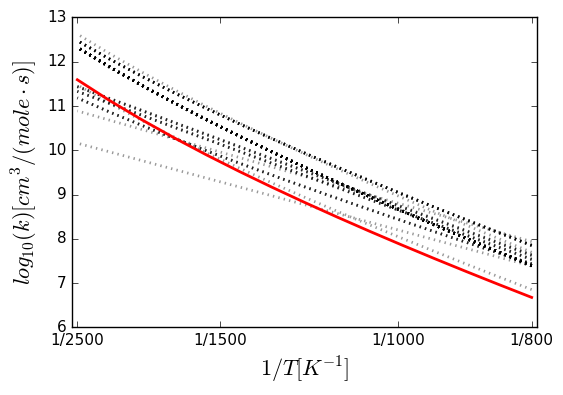


Arrhenius(A=(1.99e+06,'cm^3/(mol*s)'), n=2.02, Ea=(11320,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.65178e-08,'cm^3/(mol*s)'), n=5.1033, Ea=(13.8007,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.08489, dn = +|- 0.0964247, dEa = +|- 0.530433 kJ/mol""")
IC3H7COC2H4S + H2O2 <=> IC3H7COC2H5 + HO2


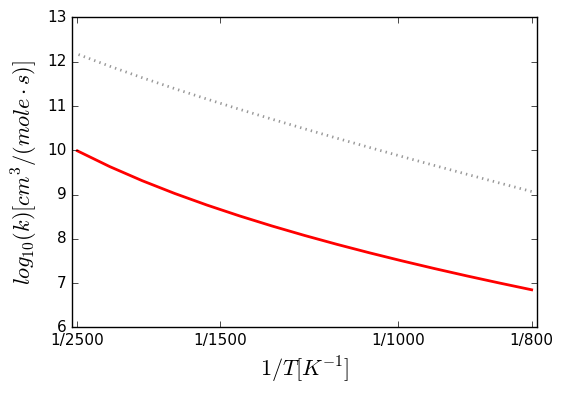


Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.54776e-06,'cm^3/(mol*s)'), n=5.04536, Ea=(58.5526,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.72134, dn = +|- 0.0712772, dEa = +|- 0.392096 kJ/mol""")
c4h8oh-1o2 + ho2 <=> c4h8oh-1o2h + o2


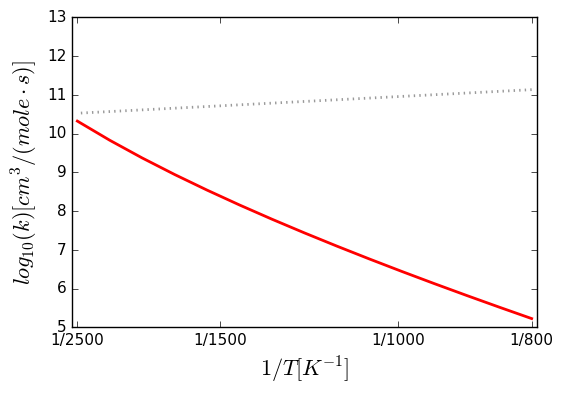


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.21676e-05,'cm^3/(mol*s)'), n=4.42308, Ea=(11.4261,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.26366, dn = +|- 0.0307119, dEa = +|- 0.168946 kJ/mol""")
c7h15oo-2-2 + h2o2 <=> c7h15ooh-2-2 + ho2


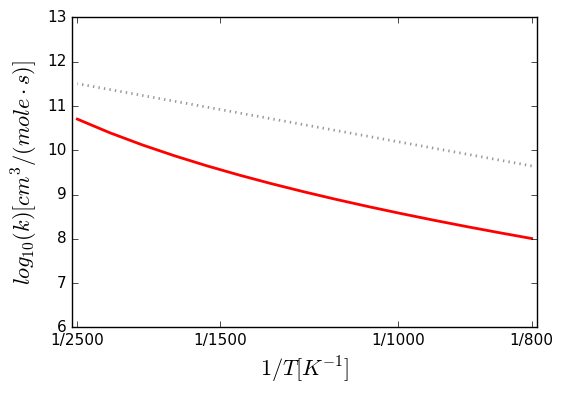


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.27076e-07,'cm^3/(mol*s)'), n=4.69062, Ea=(9.06899,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.45122, dn = +|- 0.0488743, dEa = +|- 0.268858 kJ/mol""")
c8h17oo-2-3 + h2o2 <=> c8h17ooh-2-3 + ho2


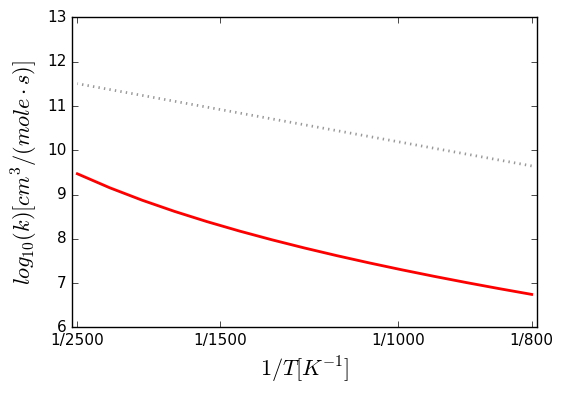


MultiArrhenius(arrhenius=[Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(17000,'cal/mol'), T0=(1,'K')), Arrhenius(A=(3.4e+12,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))])
Arrhenius(A=(0.00125516,'cm^3/(mol*s)'), n=4.13748, Ea=(32.1766,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.18986, dn = +|- 0.0228141, dEa = +|- 0.125501 kJ/mol""")
C10H20OE#4 + R3OOH => H2O2 + C10H19OE#4


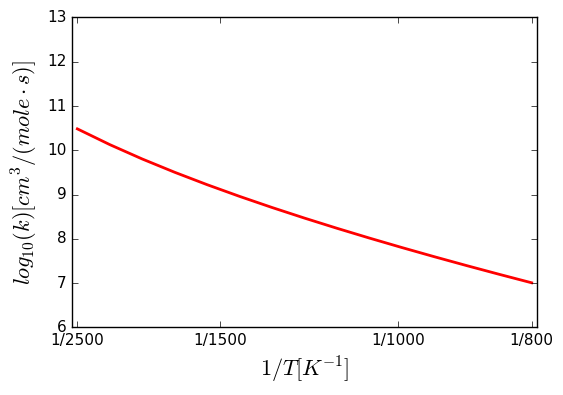


Arrhenius(A=(3.01,'cm^3/(mol*s)'), n=3.28, Ea=(1050,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0219909,'cm^3/(mol*s)'), n=3.44226, Ea=(-6.43637,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.10885, dn = +|- 0.0135599, dEa = +|- 0.0745931 kJ/mol""")
H2O2 + iC4H8OH-3 <=> iC4H9OH + HO2


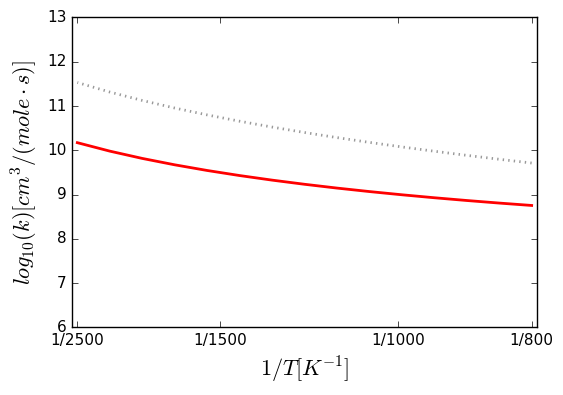


Arrhenius(A=(1.6e+13,'cm^3/(mol*s)'), n=0, Ea=(15862,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000878773,'cm^3/(mol*s)'), n=4.34586, Ea=(43.9057,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29374, dn = +|- 0.0337996, dEa = +|- 0.185932 kJ/mol""")
HO2 + DECALIN => H2O2 + RDECALIN


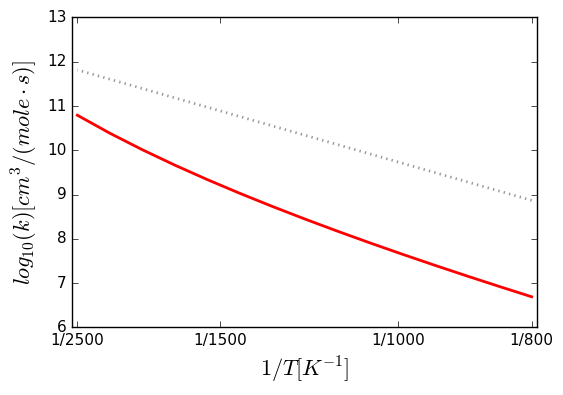


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.77406e-07,'cm^3/(mol*s)'), n=5.12841, Ea=(30.9847,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.90944, dn = +|- 0.0848883, dEa = +|- 0.466971 kJ/mol""")
HO2 + BC8H17O2H <=> H2O2 + BC8H17O2


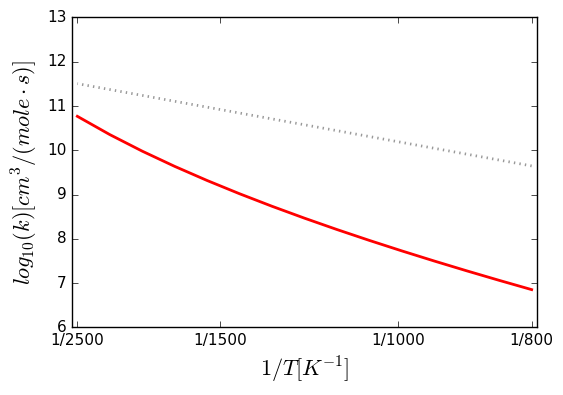


Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.55811e-05,'cm^3/(mol*s)'), n=4.50864, Ea=(4.83452,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.42913, dn = +|- 0.0468615, dEa = +|- 0.257785 kJ/mol""")
IC4H7COCH3 + HO2 <=> IC3H5CHCOCH3 + H2O2


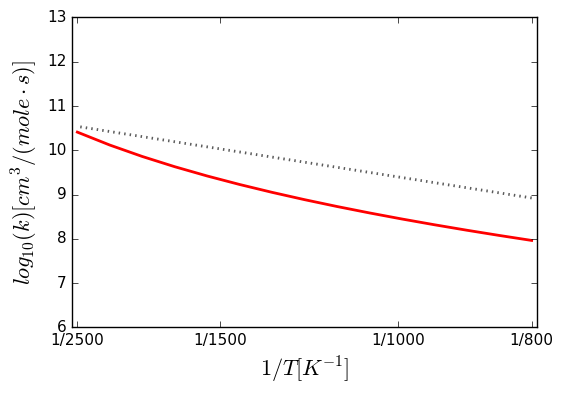


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.55811e-05,'cm^3/(mol*s)'), n=4.50864, Ea=(4.83452,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.42913, dn = +|- 0.0468615, dEa = +|- 0.257785 kJ/mol""")
IC4H7COCH3 + HO2 <=> IC4H7COCH2 + H2O2


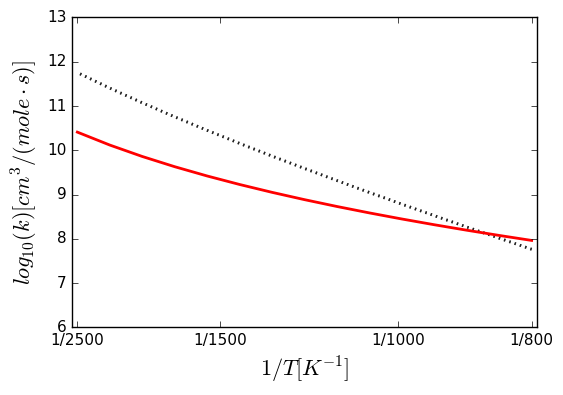


Arrhenius(A=(1.67e+07,'cm^3/(mol*s)'), n=1.53, Ea=(9691,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.55811e-05,'cm^3/(mol*s)'), n=4.50864, Ea=(4.83452,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.42913, dn = +|- 0.0468615, dEa = +|- 0.257785 kJ/mol""")
IC4H7COCH2 + H2O2 <=> IC4H7COCH3 + HO2


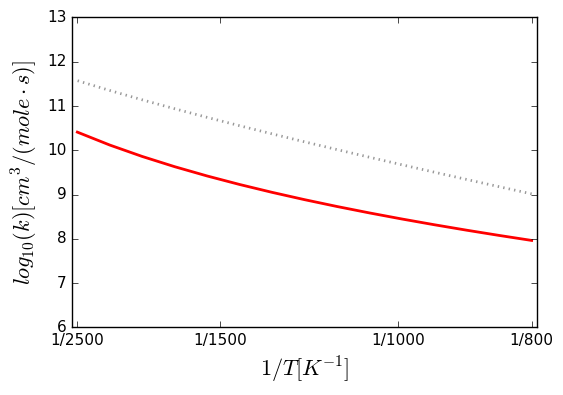


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.55811e-05,'cm^3/(mol*s)'), n=4.50864, Ea=(4.83452,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.42913, dn = +|- 0.0468615, dEa = +|- 0.257785 kJ/mol""")
IC4H7COCH3 + HO2 <=> AC3H4CH2COCH3 + H2O2


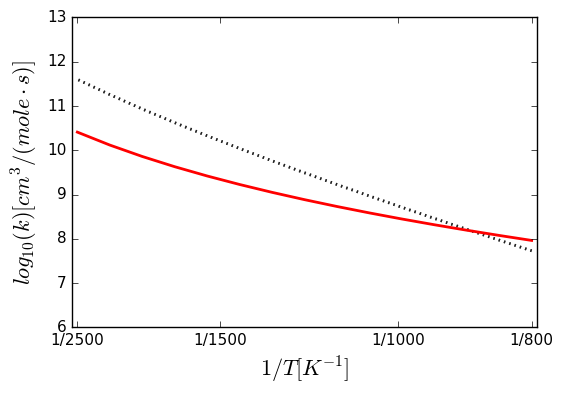


Arrhenius(A=(0.99,'cm^3/(mol*s)'), n=3.78, Ea=(12335,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.063,'cm^3/(mol*s)'), n=4.22, Ea=(11900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.71179e-08,'cm^3/(mol*s)'), n=5.50848, Ea=(22.9902,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.37899, dn = +|- 0.113743, dEa = +|- 0.625702 kJ/mol""")
mf2 + ho2 <=> mf22j + h2o2


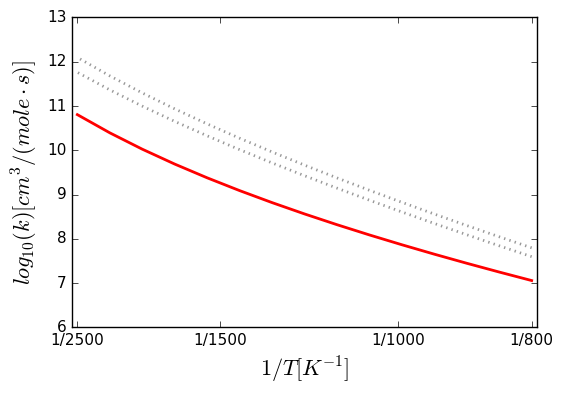


Arrhenius(A=(24700,'cm^3/(mol*s)'), n=2.24, Ea=(4442,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00162435,'cm^3/(mol*s)'), n=4.22072, Ea=(52.4572,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15855, dn = +|- 0.0193142, dEa = +|- 0.106247 kJ/mol""")
C3H6COCH3-1 + H2O2 <=> NC3H7COCH3 + HO2


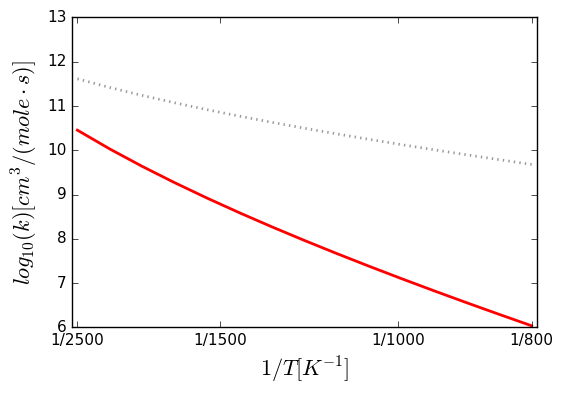


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01212e-07,'cm^3/(mol*s)'), n=5.19499, Ea=(17.0633,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.73559, dn = +|- 0.0723595, dEa = +|- 0.39805 kJ/mol""")
HO2 + C5H11O2H-3 <=> H2O2 + C5H11O2-3


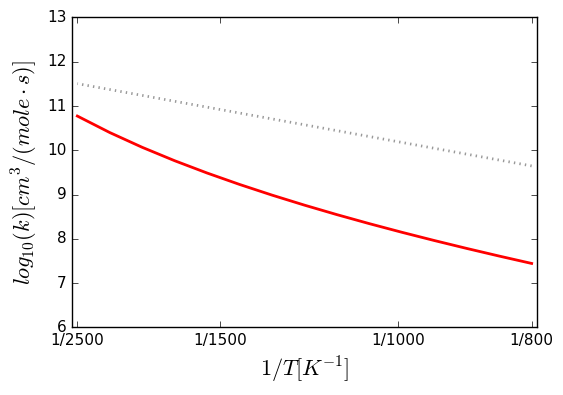


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01212e-07,'cm^3/(mol*s)'), n=5.19499, Ea=(17.0633,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.73559, dn = +|- 0.0723595, dEa = +|- 0.39805 kJ/mol""")
H2O2 + C5H11O2-3 <=> HO2 + C5H11O2H-3


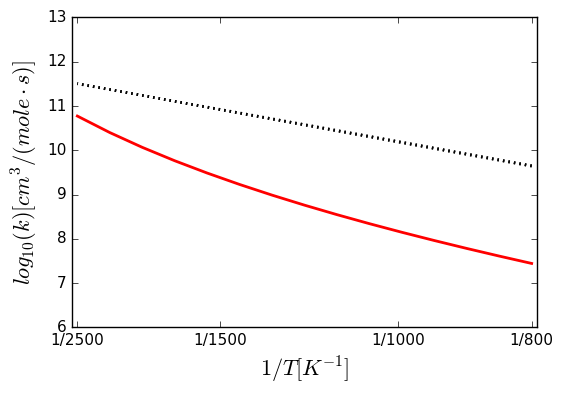


Arrhenius(A=(4.65e+13,'cm^3/(mol*s)'), n=-0.65, Ea=(6200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.02307e-09,'cm^3/(mol*s)'), n=5.71222, Ea=(30.2333,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.53715, dn = +|- 0.122191, dEa = +|- 0.672172 kJ/mol""")
C3H6COC2H5-3 + H2O2 <=> NC3H7COC2H5 + HO2


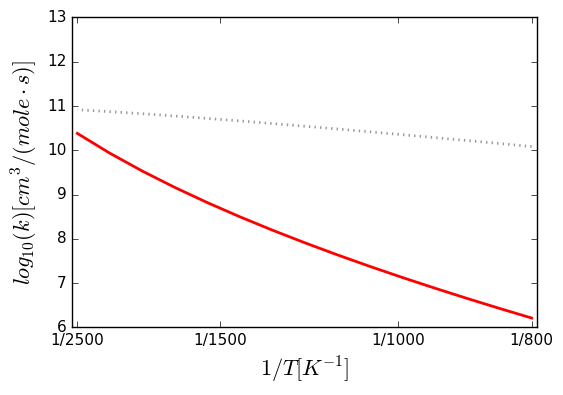


Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(60690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3

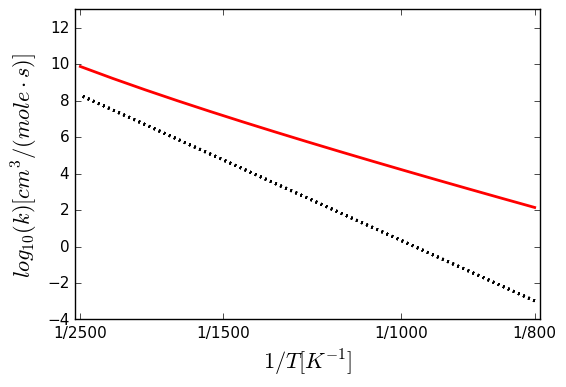


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.85991e-08,'cm^3/(mol*s)'), n=5.34819, Ea=(21.0181,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.09112, dn = +|- 0.0968163, dEa = +|- 0.532587 kJ/mol""")
YC7H15O2H + HO2 <=> YC7H15O2 + H2O2


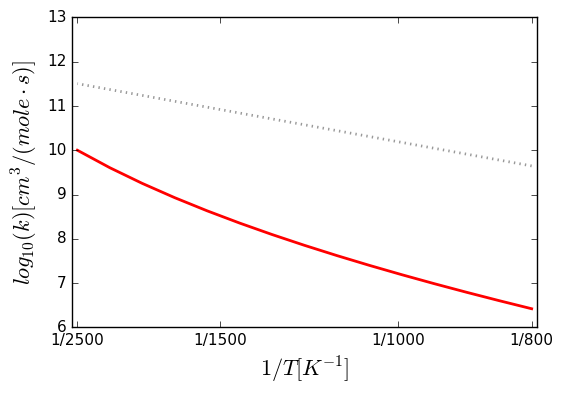


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.85991e-08,'cm^3/(mol*s)'), n=5.34819, Ea=(21.0181,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.09112, dn = +|- 0.0968163, dEa = +|- 0.532587 kJ/mol""")
YC7H15O2 + H2O2 <=> YC7H15O2H + HO2


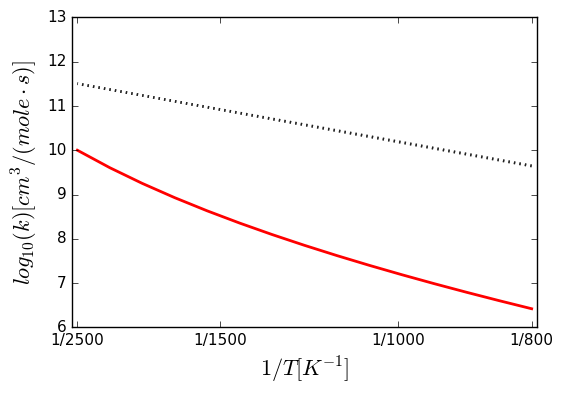


Arrhenius(A=(506,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000508059,'cm^3/(mol*s)'), n=4.49938, Ea=(50.5224,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.3254, dn = +|- 0.0369725, dEa = +|- 0.203386 kJ/mol""")
c8h16-3 + ho2 <=> c8h15 + h2o2


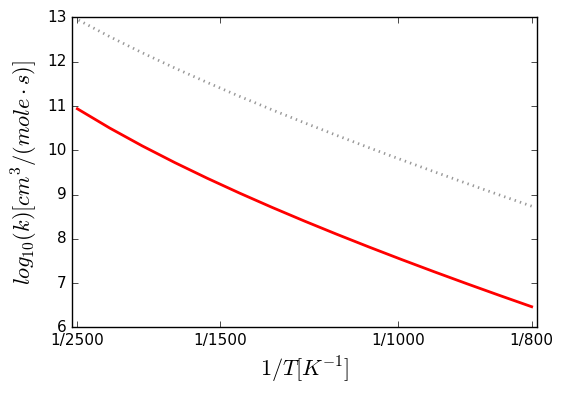


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16494,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16494,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.25954e-05,'cm^3/(mol*s)'), n=4.94551, Ea=(17.3807,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.84027, dn = +|- 0.0800458, dEa = +|- 0.440332 kJ/mol""")
MCH2ENE + HO2 <=> MCH2NCH2J + H2O2


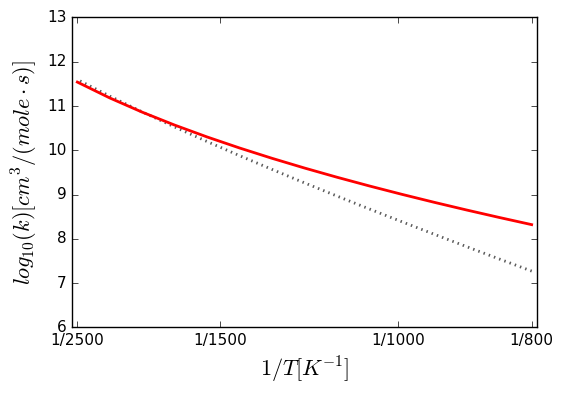


Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6800,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.25954e-05,'cm^3/(mol*s)'), n=4.94551, Ea=(17.3807,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.84027, dn = +|- 0.0800458, dEa = +|- 0.440332 kJ/mol""")
MCH2ENE + HO2 <=> MCH2N4J + H2O2


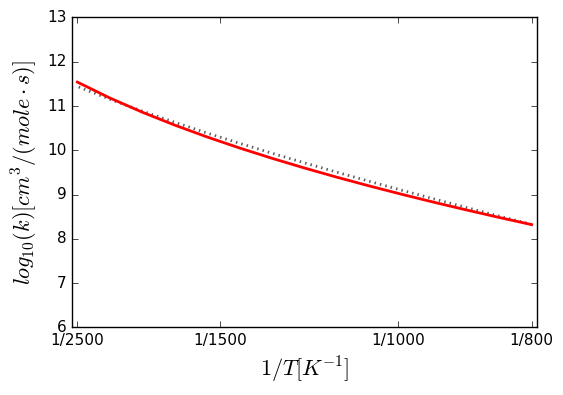


Arrhenius(A=(3400,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3400,'cm^3/(mol*s)'), n=2.5, Ea=(10113.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.25954e-05,'cm^3/(mol*s)'), n=4.94551, Ea=(17.3807,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.84027, dn = +|- 0.0800458, dEa = +|- 0.440332 kJ/mol""")
MCH2ENE + HO2 <=> MCH2N1J + H2O2


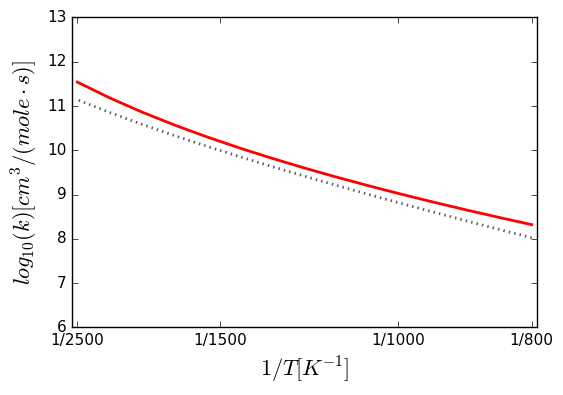


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.25954e-05,'cm^3/(mol*s)'), n=4.94551, Ea=(17.3807,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.84027, dn = +|- 0.0800458, dEa = +|- 0.440332 kJ/mol""")
MCH2ENE + HO2 <=> MCH2N5J + H2O2


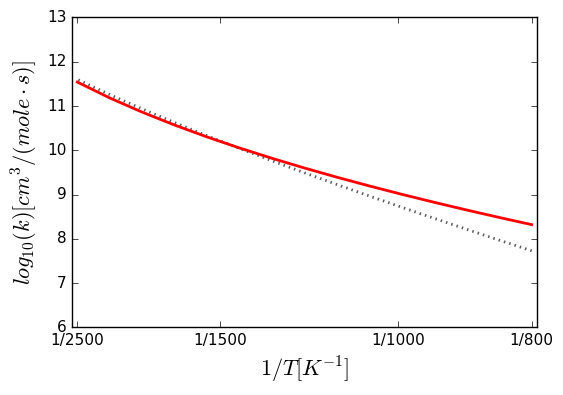


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.25954e-05,'cm^3/(mol*s)'), n=4.94551, Ea=(17.3807,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.84027, dn = +|- 0.0800458, dEa = +|- 0.440332 kJ/mol""")
MCH2ENE + HO2 <=> MCH2N6J + H2O2


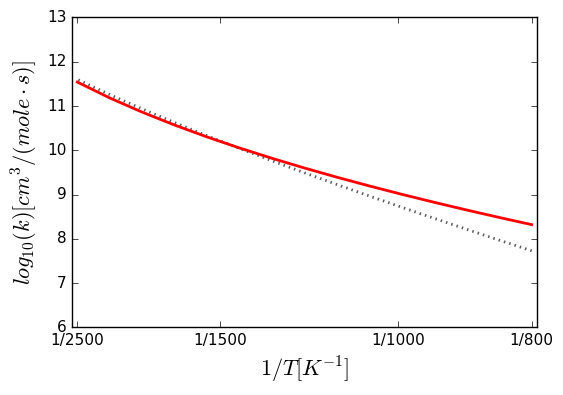


Arrhenius(A=(8500,'cm^3/(mol*s)'), n=2.75, Ea=(11360,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0519304,'cm^3/(mol*s)'), n=4.08654, Ea=(53.5167,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.34509, dn = +|- 0.0389074, dEa = +|- 0.21403 kJ/mol""")
DC8H17 + H2 <=> IC8H18 + H


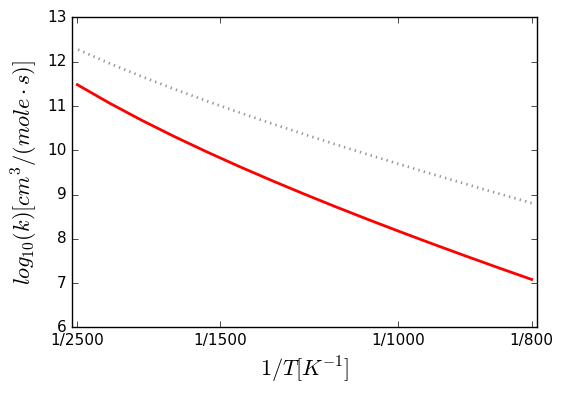


Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27400,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00107812,'cm^3/(mol*s)'), n=4.05193, Ea=(0.029178,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.16634, dn = +|- 0.0201941, dEa = +|- 0.111088 kJ/mol""")
ic3h7coc2h5 + ho2 <=> ic3h6coc2h5 + h2o2


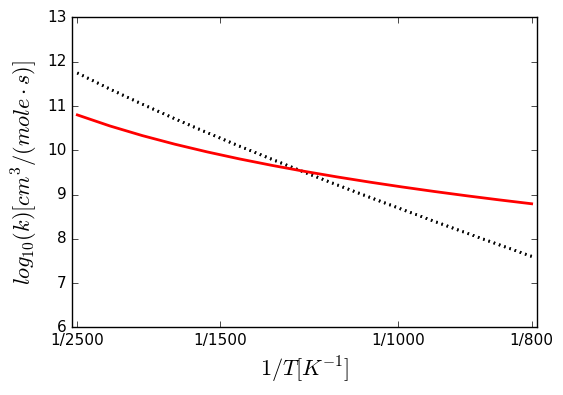


Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00107812,'cm^3/(mol*s)'), n=4.05193, Ea=(0.029178,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.16634, dn = +|- 0.0201941, dEa = +|- 0.111088 kJ/mol""")
ic3h7coc2h5 + ho2 <=> tc3h6coc2h5 + h2o2


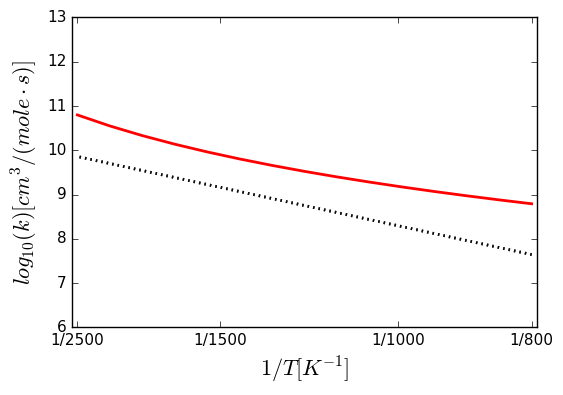


Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00107812,'cm^3/(mol*s)'), n=4.05193, Ea=(0.029178,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.16634, dn = +|- 0.0201941, dEa = +|- 0.111088 kJ/mol""")
ic3h7coc2h5 + ho2 <=> ic3h7coc2h4p + h2o2


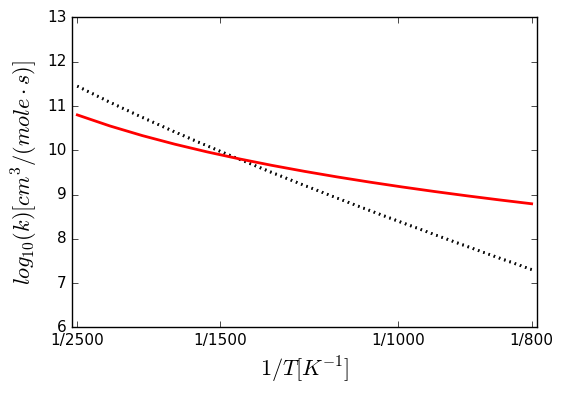


Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14800,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00107812,'cm^3/(mol*s)'), n=4.05193, Ea=(0.029178,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.16634, dn = +|- 0.0201941, dEa = +|- 0.111088 kJ/mol""")
ic3h7coc2h5 + ho2 <=> ic3h7coc2h4s + h2o2


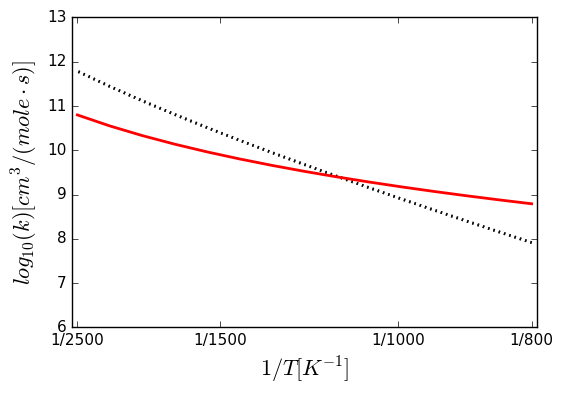


Arrhenius(A=(16700,'cm^3/(mol*s)'), n=2.22, Ea=(3472,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00107812,'cm^3/(mol*s)'), n=4.05193, Ea=(0.029178,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.16634, dn = +|- 0.0201941, dEa = +|- 0.111088 kJ/mol""")
IC3H7COC2H4P + H2O2 <=> IC3H7COC2H5 + HO2


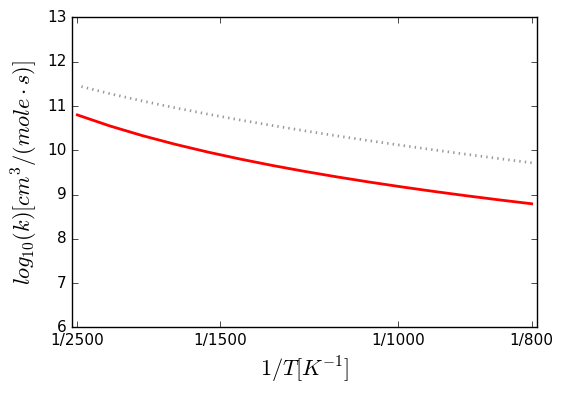


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00206005,'cm^3/(mol*s)'), n=4.11299, Ea=(45.1081,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.14042, dn = +|- 0.0172451, dEa = +|- 0.0948653 kJ/mol""")
AC5H11 + HO2 <=> AC5H11O + OH


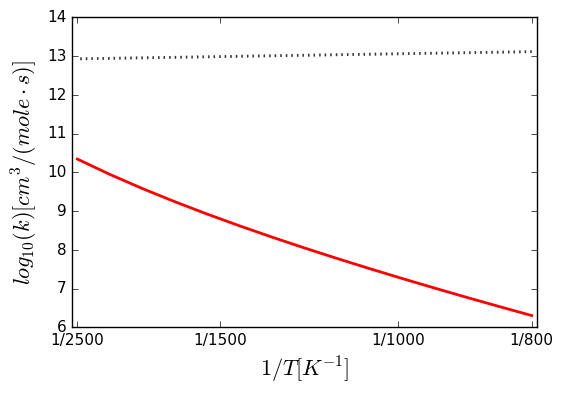


Arrhenius(A=(1.6e+11,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.6e+11,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.6e+11,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.6e+11,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.9558e-07,'cm^3/(mol*s)'), n=4.89981, Ea=(11.7267,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.83104, dn = +|- 0.0793854, dEa = +|- 0.436699 kJ/mol""")
IC3H7COC3H7-I + HO2 <=> IC3H7COC3H6-T + H2O2


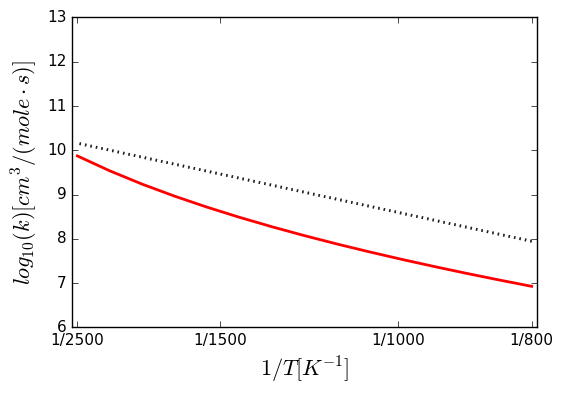


Arrhenius(A=(54800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(54800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(54800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(54800,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.9558e-07,'cm^3/(mol*s)'), n=4.89981, Ea=(11.7267,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.83104, dn = +|- 0.0793854, dEa = +|- 0.436699 kJ/mol""")
IC3H7COC3H7-I + HO2 <=> IC3H7COC3H6-I + H2O2


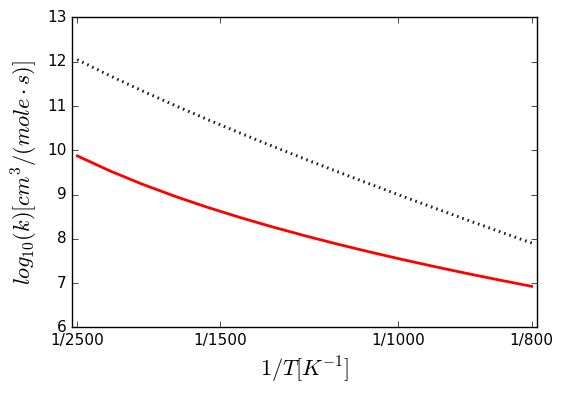


Arrhenius(A=(3.26e+12,'cm^3/(mol*s)'), n=-0.41, Ea=(11070,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.9558e-07,'cm^3/(mol*s)'), n=4.89981, Ea=(11.7267,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.83104, dn = +|- 0.0793854, dEa = +|- 0.436699 kJ/mol""")
IC3H7COC3H6-T + H2O2 <=> IC3H7COC3H7-I + HO2


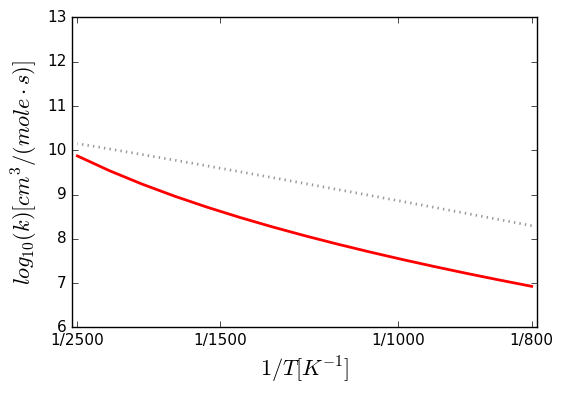


Arrhenius(A=(9600,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.64056e-05,'cm^3/(mol*s)'), n=4.91494, Ea=(23.4707,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.76642, dn = +|- 0.0746702, dEa = +|- 0.410761 kJ/mol""")
CH3CHCHCHO + HO2 <=> CH2CHCHCHO + H2O2


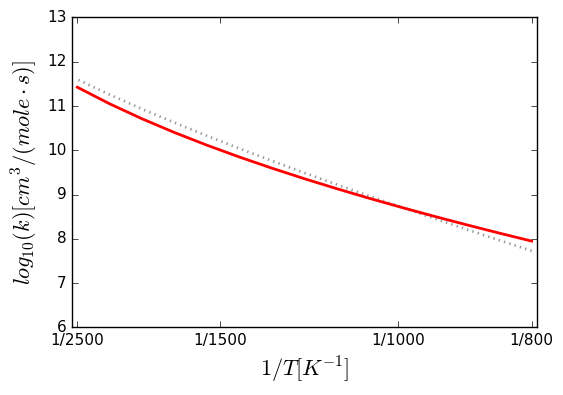


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3

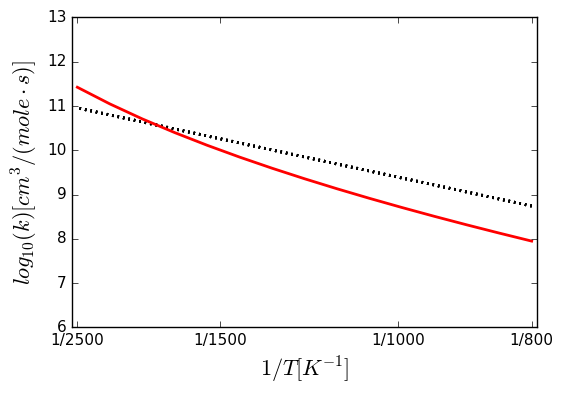


Arrhenius(A=(1.75e+10,'cm^3/(mol*s)'), n=0, Ea=(-3275,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.93706e-07,'cm^3/(mol*s)'), n=4.93694, Ea=(49.8647,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.61118, dn = +|- 0.0625976, dEa = +|- 0.344349 kJ/mol""")
c4h8oh-4o2 + ho2 <=> c4h8oh-4o2h + o2


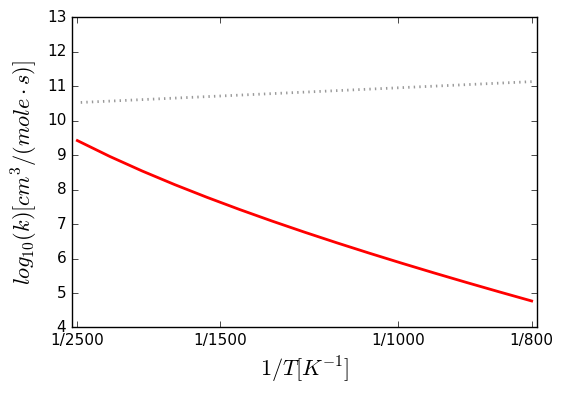


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(20.4,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol')

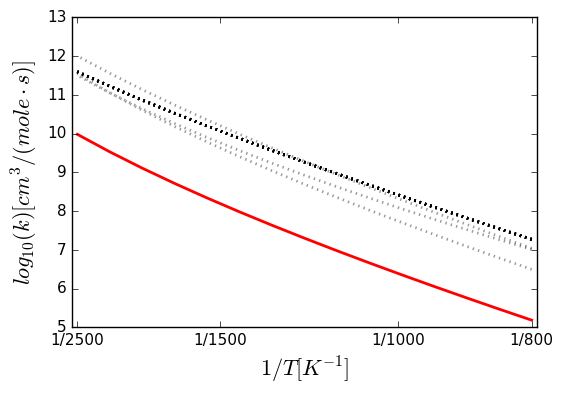


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'

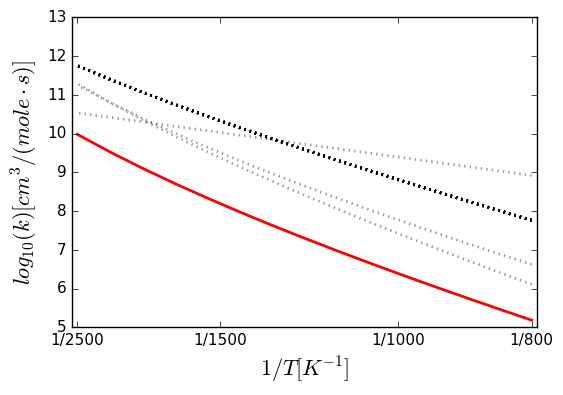


Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.44e+12,'cm^3/(mol*s)'), n=0.05, Ea=(17880,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*

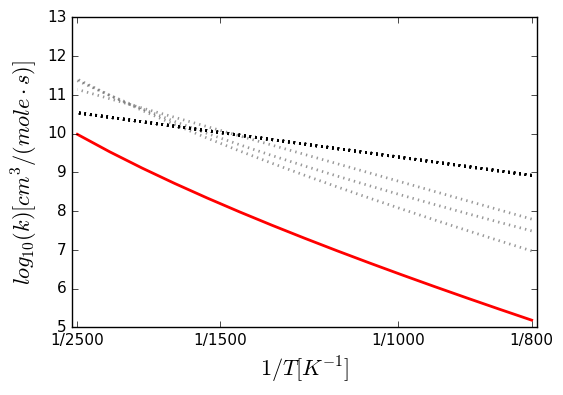


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.92498e-11,'cm^3/(mol*s)'), n=6.54129, Ea=(28.2958,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 4.53529, dn = +|- 0.198422, dEa = +|- 1.09152 kJ/mol""")
ic3h5coch3 + ho2 <=> ac3h4coch3 + h2o2


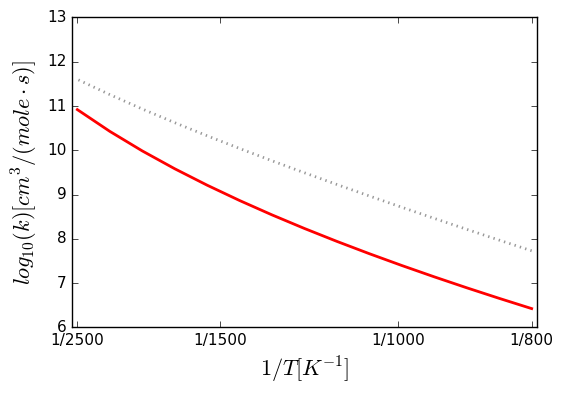


MultiArrhenius(arrhenius=[Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K')), Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))])
Arrhenius(A=(1.92498e-11,'cm^3/(mol*s)'), n=6.54129, Ea=(28.2958,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 4.53529, dn = +|- 0.198422, dEa = +|- 1.09152 kJ/mol""")
ic3h5coch3 + ho2 <=> ic3h5coch2 + h2o2


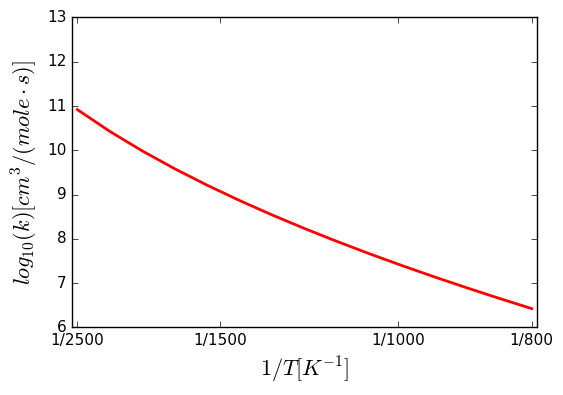


Arrhenius(A=(23790,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.5e+11,'cm^3/(mol*s)'), n=0, Ea=(14190,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.5e+11,'cm^3/(mol*s)'), n=0, Ea=(14190,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.96075e-09,'cm^3/(mol*s)'), n=5.81809, Ea=(24.2053,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.9056, dn = +|- 0.139987, dEa = +|- 0.770069 kJ/mol""")
mb2d + ho2 <=> c5h7o2 + h2o2


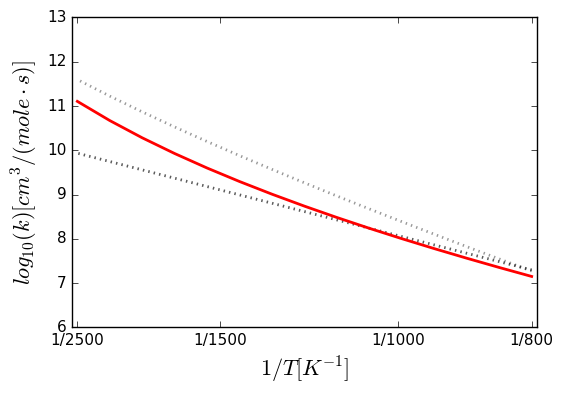


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00106573,'cm^3/(mol*s)'), n=4.56899, Ea=(47.6367,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33744, dn = +|- 0.0381592, dEa = +|- 0.209914 kJ/mol""")
PBZ + HO2 <=> PBZJB + H2O2


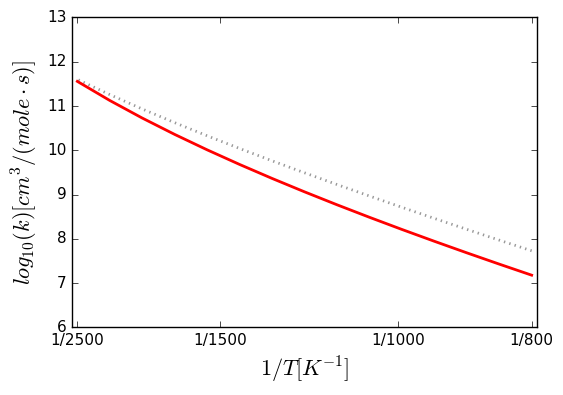


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00106573,'cm^3/(mol*s)'), n=4.56899, Ea=(47.6367,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33744, dn = +|- 0.0381592, dEa = +|- 0.209914 kJ/mol""")
PBZ + HO2 <=> PBZJC + H2O2


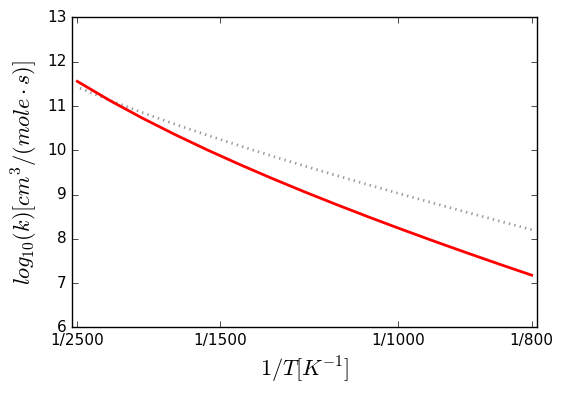


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00106573,'cm^3/(mol*s)'), n=4.56899, Ea=(47.6367,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33744, dn = +|- 0.0381592, dEa = +|- 0.209914 kJ/mol""")
PBZ + HO2 <=> PBZJA + H2O2


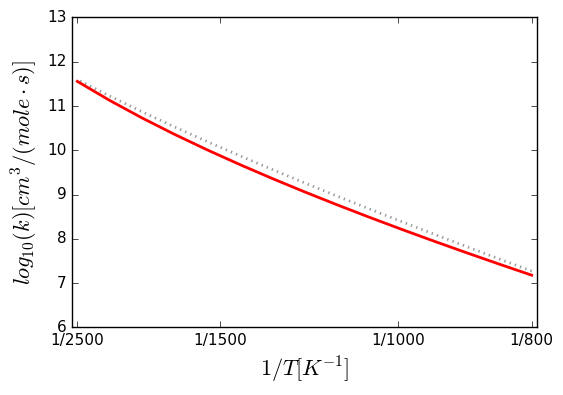


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000207951,'cm^3/(mol*s)'), n=4.61851, Ea=(48.9235,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.38732, dn = +|- 0.0429645, dEa = +|- 0.236348 kJ/mol""")
nc6h13cho + ho2 <=> nc6h13co + h2o2


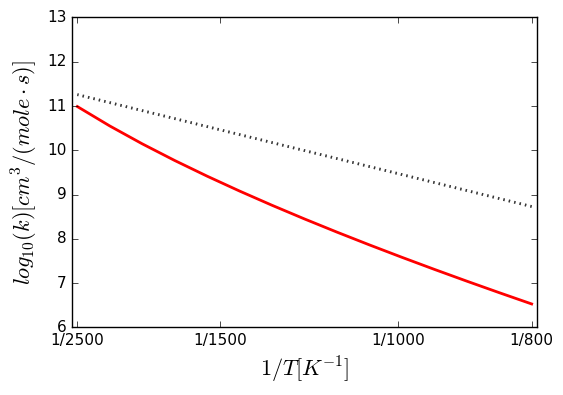


Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0.5, Ea=(42200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0439136,'cm^3/(mol*s)'), n=3.83255, Ea=(136.961,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.20624, dn = +|- 0.0246092, dEa = +|- 0.135375 kJ/mol""")
hoch2cho + o2 <=> hoch2co + ho2


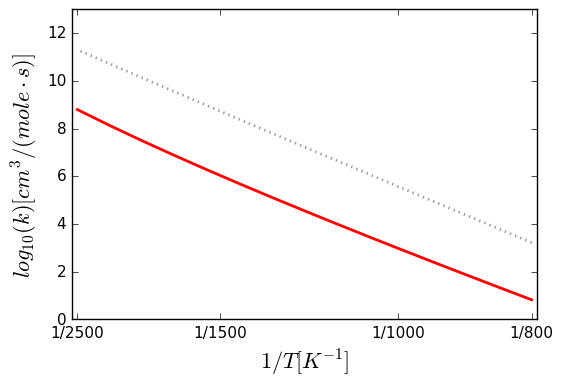


Arrhenius(A=(1.19e+13,'cm^3/(mol*s)'), n=-0.59, Ea=(9362,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.99369e-09,'cm^3/(mol*s)'), n=5.45374, Ea=(21.0677,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.59982, dn = +|- 0.125393, dEa = +|- 0.689789 kJ/mol""")
HC6H12CHO + H2O2 <=> NEOC6H13CHO + HO2


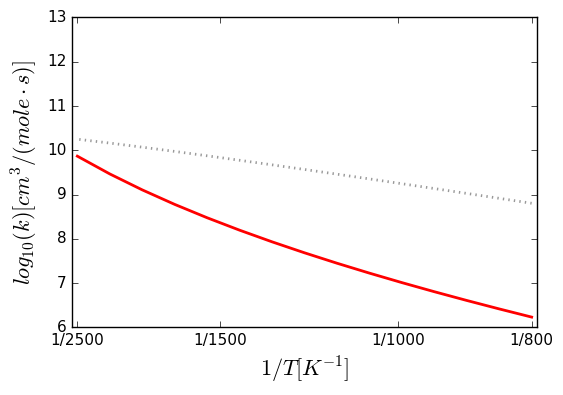


Arrhenius(A=(215500,'cm^3/(mol*s)'), n=2, Ea=(9982.61,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.5e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000291273,'cm^3/(mol*s)'), n=4.6729, Ea=(13.2944,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.5004, dn = +|- 0.0532485, dEa = +|- 0.29292 kJ/mol""")
HO2 + C2H5CHO => H2O2 + C2H4CHO


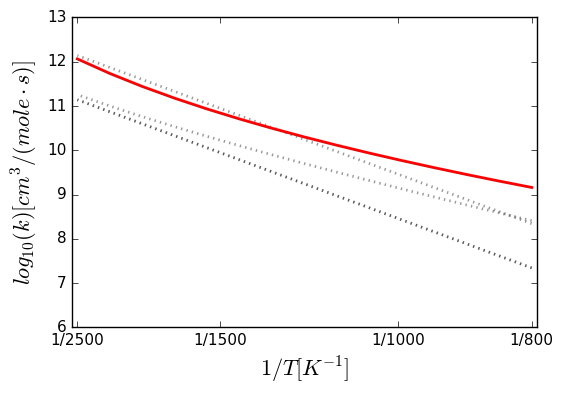


Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000291273,'cm^3/(mol*s)'), n=4.6729, Ea=(13.2944,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.5004, dn = +|- 0.0532485, dEa = +|- 0.29292 kJ/mol""")
c2h5cho + ho2 <=>

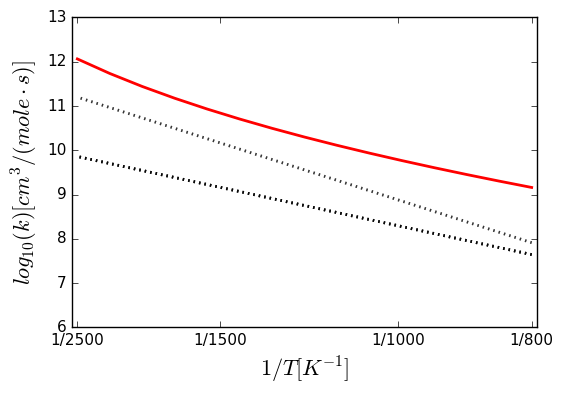


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))


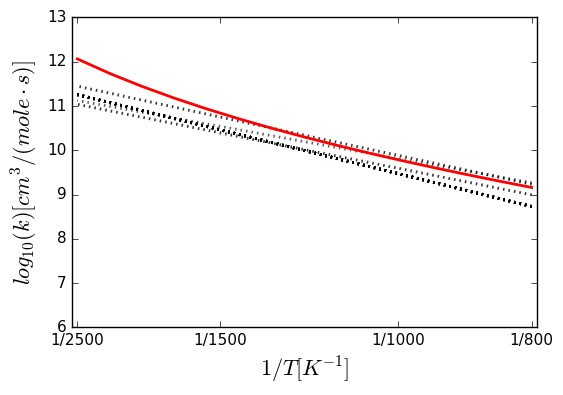


Arrhenius(A=(2.24e+13,'cm^3/(mol*s)'), n=0, Ea=(16840,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.61147e-07,'cm^3/(mol*s)'), n=5.39794, Ea=(53.3084,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.06096, dn = +|- 0.09491, dEa = +|- 0.5221 kJ/mol""")
CH3CH2OCHO + HO2 <=> CH3CH2OCO + H2O2


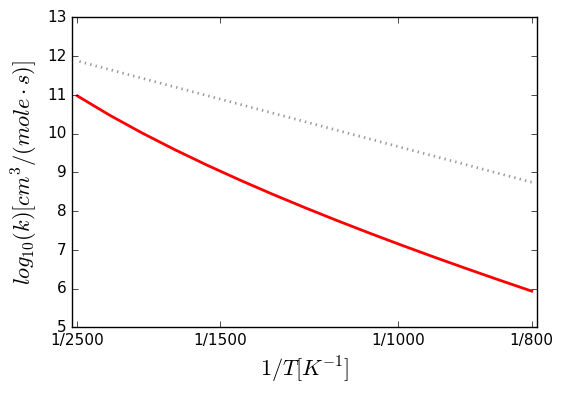


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.50376e-09,'cm^3/(mol*s)'), n=6.18963, Ea=(28.1069,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.93623, dn = +|- 0.0867163, dEa = +|- 0.477026 kJ/mol""")
hoc6h4ch3 + ho2 <=> oc6h4ch3 + h2o2


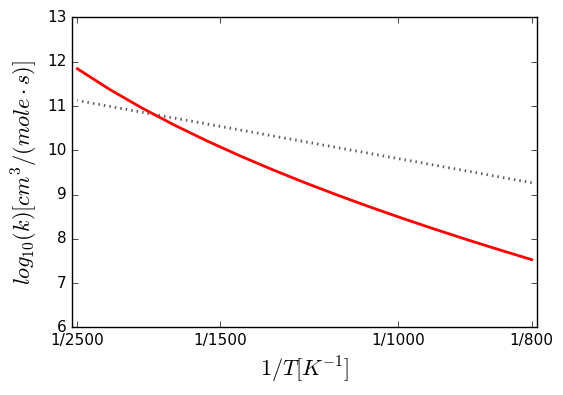


Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(14000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(14000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.50376e-09,'cm^3/(mol*s)'), n=6.18963, Ea=(28.1069,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.93623, dn = +|- 0.0867163, dEa = +|- 0.477026 kJ/mol""")
hoc6h4ch3 + ho2 <=> hoc6h4ch2 + h2o2


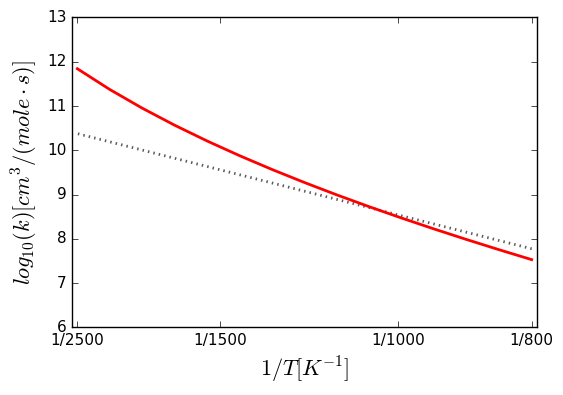


Arrhenius(A=(36800,'cm^3/(mol*s)'), n=2.21, Ea=(3472,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0160178,'cm^3/(mol*s)'), n=3.70256, Ea=(-3.79128,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.02868, dn = +|- 0.00371053, dEa = +|- 0.0204116 kJ/mol""")
TC4H8COC2H5 + H2O2 <=> TC4H9COC2H5 + HO2


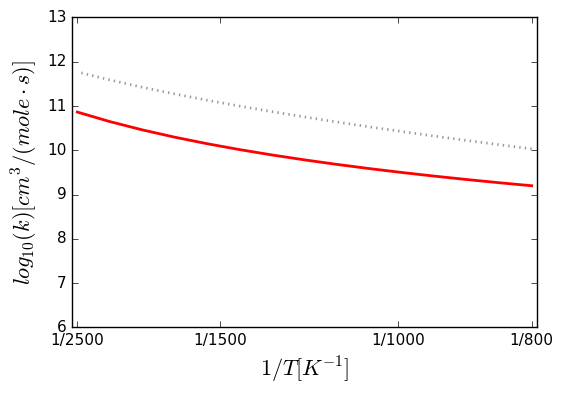


Arrhenius(A=(3.86e+12,'cm^3/(mol*s)'), n=-0.33, Ea=(12000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.9354e-05,'cm^3/(mol*s)'), n=4.52619, Ea=(7.7717,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.50155, dn = +|- 0.0533496, dEa = +|- 0.293476 kJ/mol""")
NC5H11CO-2 + H2O2 <=> NC5H11CHO-2 + HO2


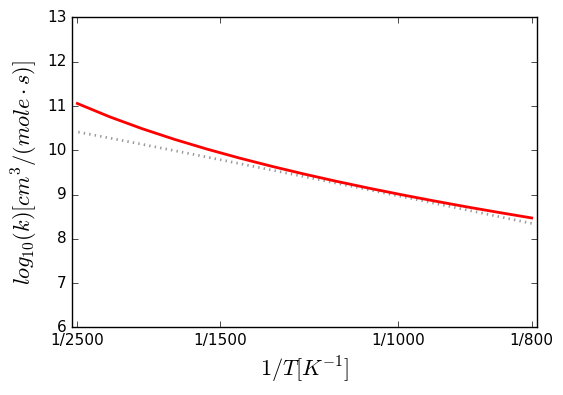


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257571,'cm^3/(mol*s)'), n=4.61397, Ea=(49.1833,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.38735, dn = +|- 0.042968, dEa = +|- 0.236367 kJ/mol""")
F-FC6H12O + HO2 => IC5H10CHO-BA + H2O2


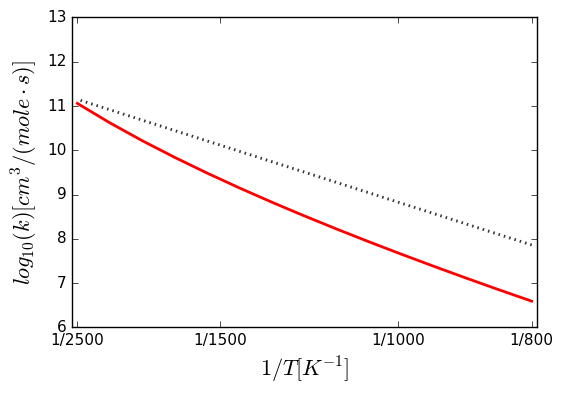


Arrhenius(A=(19280,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(19280,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(19280,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(19280,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.47926e-08,'cm^3/(mol*s)'), n=5.52464, Ea=(21.1545,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.54442, dn = +|- 0.122567, dEa = +|- 0.674239 kJ/mol""")
C6H12-3 + HO2 <=> C6H112-4 + H2O2


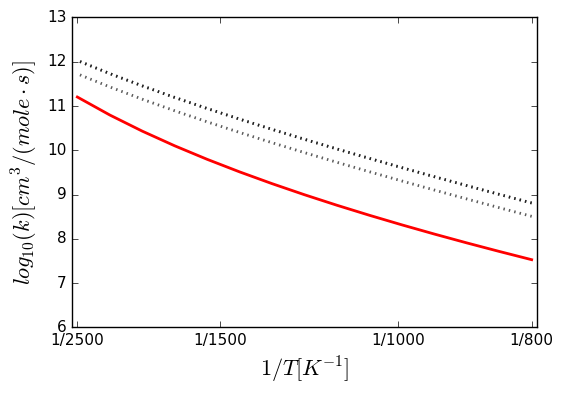


Arrhenius(A=(2e-19,'cm^3/(mol*s)'), n=0, Ea=(17500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.47926e-08,'cm^3/(mol*s)'), n=5.52464, Ea=(21.1545,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.54442, dn = +|- 0.122567, dEa = +|- 0.674239 kJ/mol""")
C6H12-3 + HO2 <=> C6H13-3 + O2


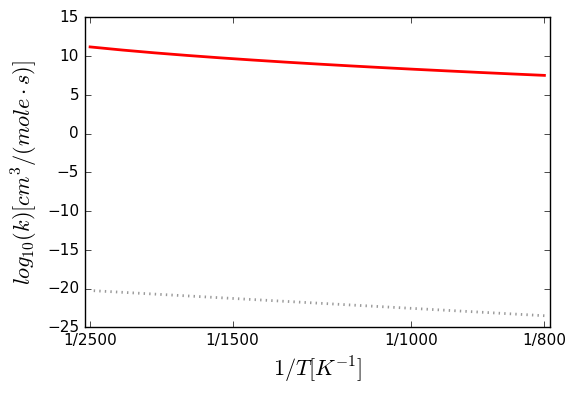


Arrhenius(A=(95200,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(95200,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(95200,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(95200,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.47926e-08,'cm^3/(mol*s)'), n=5.52464, Ea=(21.1545,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.54442, dn = +|- 0.122567, dEa = +|- 0.674239 kJ/mol""")
C6H12-3 + HO2 <=> C6H113-1 + H2O2


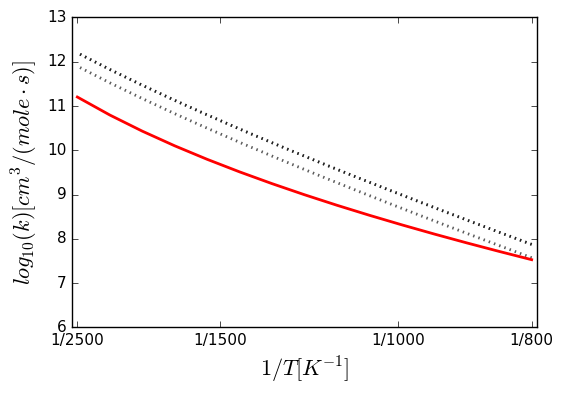


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.40428e-06,'cm^3/(mol*s)'), n=4.46934, Ea=(12.8938,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.30195, dn = +|- 0.0346293, dEa = +|- 0.190496 kJ/mol""")
ic4h8oh-2o2 + h2o2 <=> ic4h8oh-2o2h + ho2


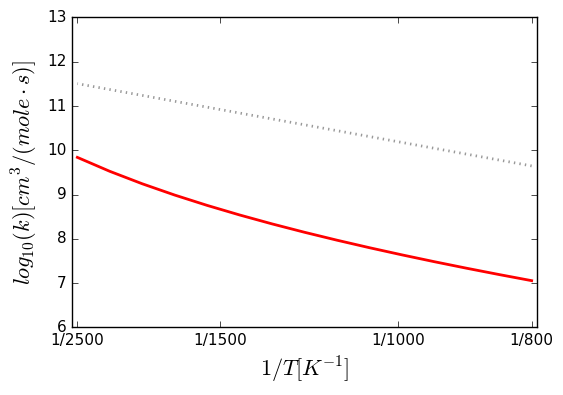


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.61143e-06,'cm^3/(mol*s)'), n=4.61794, Ea=(13.3935,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.41451, dn = +|- 0.0455123, dEa = +|- 0.250364 kJ/mol""")
BC5H11O2 + H2O2 <=> BC5H11O2H + HO2


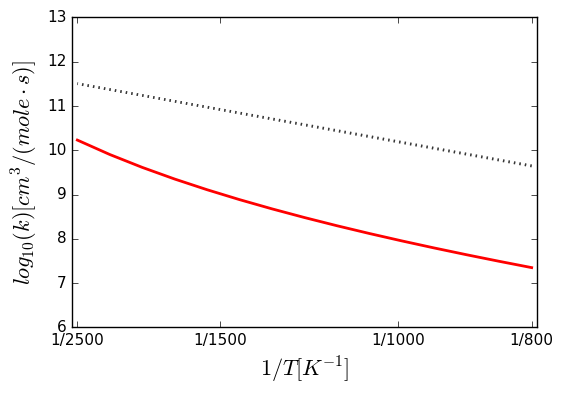


Arrhenius(A=(1770,'cm^3/(mol*s)'), n=2.65, Ea=(4342,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000133173,'cm^3/(mol*s)'), n=4.01117, Ea=(-1.25874,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.14331, dn = +|- 0.0175769, dEa = +|- 0.0966904 kJ/mol""")
C5H10CHO3-2 + H2O2 <=> NC5H11CHO-2 + HO2


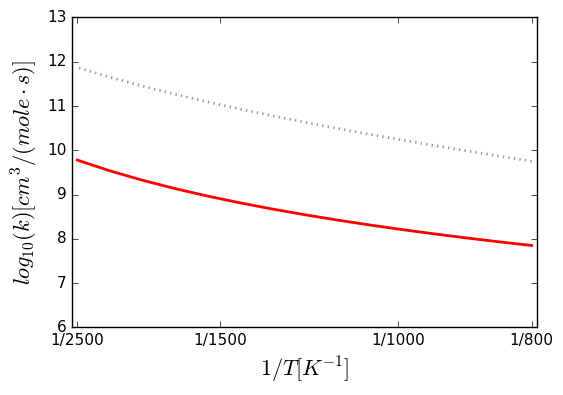


Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(58201.3,'J/mol'), T0=(1,'K'))
Arrhenius(A=(9.19844e-09,'cm^3/(mol*s)'), n=6.23896, Ea=(24.1466,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.9776, dn = +|- 0.0894908, dEa = +|- 0.492289 kJ/mol""")
A2CH3 + HO2 <=> A2CH2 + H2O2


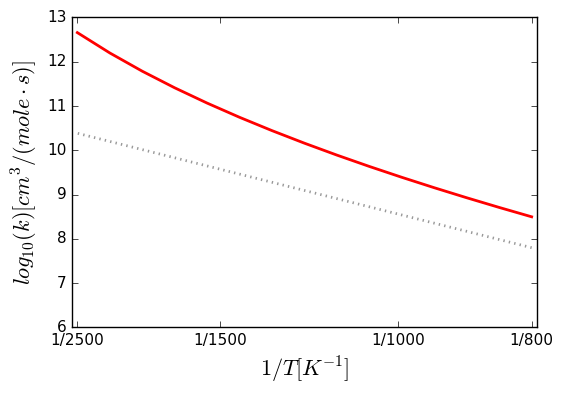


Arrhenius(A=(2.66e+11,'cm^3/(mol*s)'), n=0, Ea=(11270,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.87591e-08,'cm^3/(mol*s)'), n=5.4237, Ea=(14.4251,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.3172, dn = +|- 0.11029, dEa = +|- 0.606704 kJ/mol""")
PHC3H5-1 + HO2 <=> PHC3H4 + H2O2


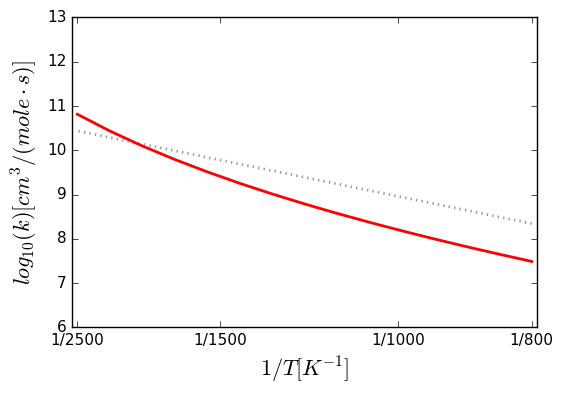


Arrhenius(A=(21600,'cm^3/(mol*s)'), n=2, Ea=(7048.52,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(21600,'cm^3/(mol*s)'), n=2, Ea=(7048.52,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.0496e-06,'cm^3/(mol*s)'), n=4.74737, Ea=(77.324,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.70257, dn = +|- 0.0698385, dEa = +|- 0.384182 kJ/mol""")
RCRESOLO + H2O2 => CRESOL + HO2


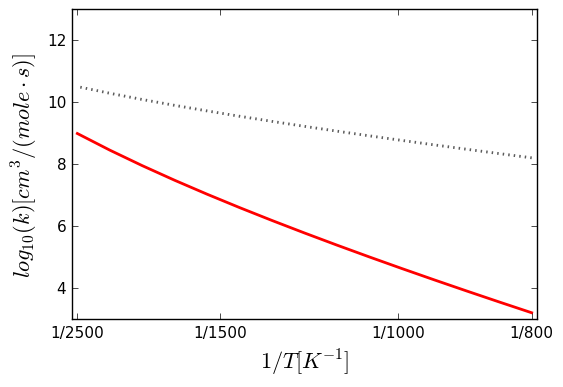


Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.09e+12,'cm^3/(mol*s)'), n=0, Ea=(14200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.09e+12,'cm^3/(mol*s)'), n=0, Ea=(14200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'

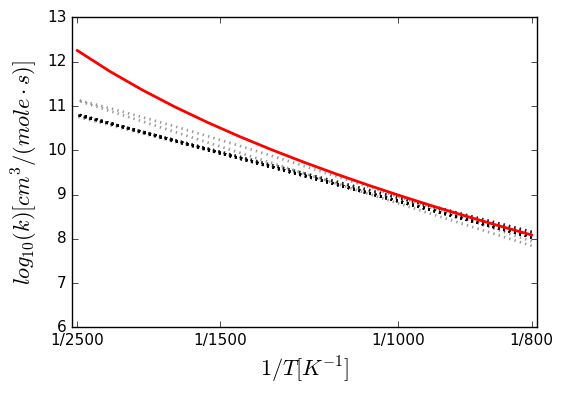


PDepArrhenius(pressures=([0.013,0.9869,9.87,98.69],'atm'), arrhenius=[Arrhenius(A=(1.02e+07,'cm^3/(mol*s)'), n=1.16, Ea=(10273,'cal/mol'), T0=(1,'K')), Arrhenius(A=(1.31e+20,'cm^3/(mol*s)'), n=-2.58, Ea=(19078,'cal/mol'), T0=(1,'K')), Arrhenius(A=(4.14e+28,'cm^3/(mol*s)'), n=-4.92, Ea=(26212,'cal/mol'), T0=(1,'K')), Arrhenius(A=(8.87e+22,'cm^3/(mol*s)'), n=-3.09, Ea=(26586,'cal/mol'), T0=(1,'K'))])
PDepArrhenius(pressures=([0.013,0.9869,9.87,98.69],'atm'), arrhenius=[Arrhenius(A=(1.02e+07,'cm^3/(mol*s)'), n=1.16, Ea=(10273,'cal/mol'), T0=(1,'K')), Arrhenius(A=(1.31e+20,'cm^3/(mol*s)'), n=-2.58, Ea=(19078,'cal/mol'), T0=(1,'K')), Arrhenius(A=(4.14e+28,'cm^3/(mol*s)'), n=-4.92, Ea=(26212,'cal/mol'), T0=(1,'K')), Arrhenius(A=(8.87e+22,'cm^3/(mol*s)'), n=-3.09, Ea=(26586,'cal/mol'), T0=(1,'K'))])
Arrhenius(A=(7.553e+26,'cm^3/(mol*s)'), n=-4.359, Ea=(26326.8,'cal/mol'), T0=(1,'K'))
PDepArrhenius(pressures=([0.013,0.9869,9.87,98.69],'atm'), arrhenius=[Arrhenius(A=(1.02e+07,'cm^3/(mol*s)'), 

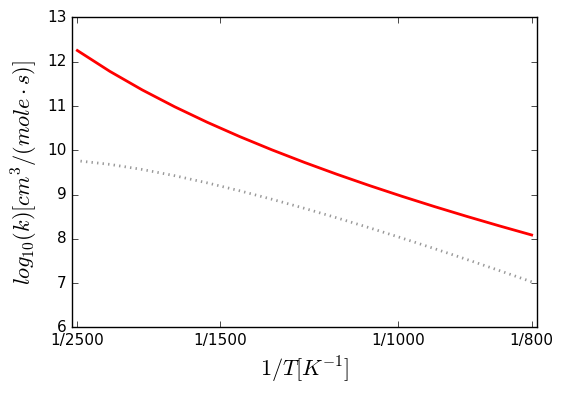


Arrhenius(A=(19250,'cm^3/(mol*s)'), n=2, Ea=(9160.93,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.23051e-10,'cm^3/(mol*s)'), n=6.6446, Ea=(19.7727,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.59654, dn = +|- 0.125228, dEa = +|- 0.688878 kJ/mol""")
CH2CHCH2 + H2O2 => C3H6 + HO2


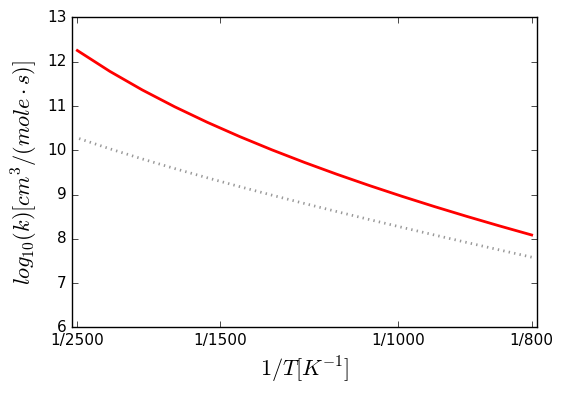


Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(23590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(15600,'cm^3/(mol*s)'), n=2.82, Ea=(24427.9,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(23590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(23590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(23590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(23590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+09,'cm^3/(mol*s)'), n=0, Ea=(9930,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(23590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(23590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(23590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(23590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e-21,'cm^3/(mol*s)'), n=0, Ea=(9930,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+09,'cm^3/(mol*s)'), n=0, Ea=(9930,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(

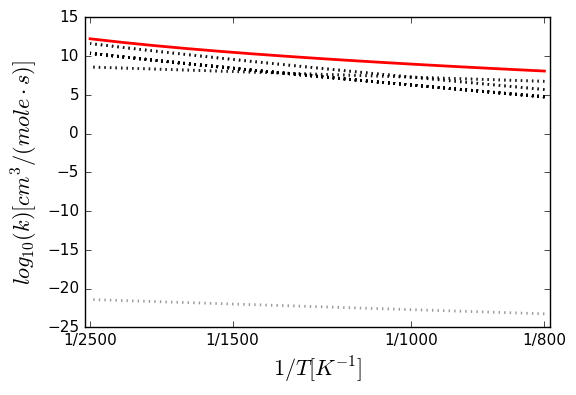


Arrhenius(A=(1.29e+12,'cm^3/(mol*s)'), n=0, Ea=(14900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.23051e-10,'cm^3/(mol*s)'), n=6.6446, Ea=(19.7727,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.59654, dn = +|- 0.125228, dEa = +|- 0.688878 kJ/mol""")
C3H6 + HO2 <=> propen1ol + OH


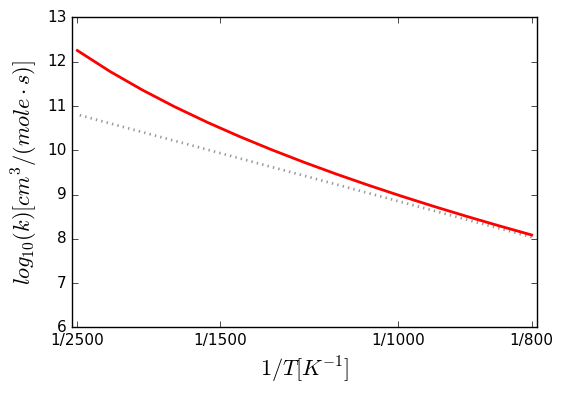


Arrhenius(A=(18000,'cm^3/(mol*s)'), n=2.5, Ea=(27620,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(957,'cm^3/(mol*s)'), n=3.059, Ea=(20798.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18000,'cm^3/(mol*s)'), n=2.5, Ea=(27620,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18000,'cm^3/(mol*s)'), n=2.5, Ea=(27620,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18000,'cm^3/(mol*s)'), n=2.5, Ea=(27620,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18000,'cm^3/(mol*s)'), n=2.5, Ea=(27620,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18000,'cm^3/(mol*s)'), n=2.5, Ea=(27620,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18000,'cm^3/(mol*s)'), n=2.5, Ea=(27620,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18000,'cm^3/(mol*s)'), n=2.5, Ea=(27620,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18000,'cm^3/(mol*s)'), n=2.5, Ea=(27620,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18000,'cm^3/(mol*s)'), n=2.5, Ea=(27620,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.5e-21,'cm^3/(mol*s)'), n=0, Ea=(12570,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.5e+09,'cm^3/(mol*s)'), n=0, Ea=(12570,'cal/mol'), T0=(1,'K

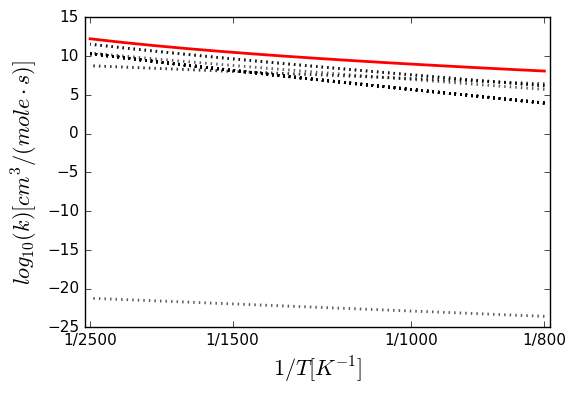


Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0307,'cm^3/(mol*s)'), n=4.403, Ea=(13547.2,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(58226.2,'J/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9600,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7130,'cm^3/(mol*s)'), n=2.77, Ea=(14913,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9600,'cm^3/(mol*s)'), n=2.6, Ea=(13910.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9600,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'

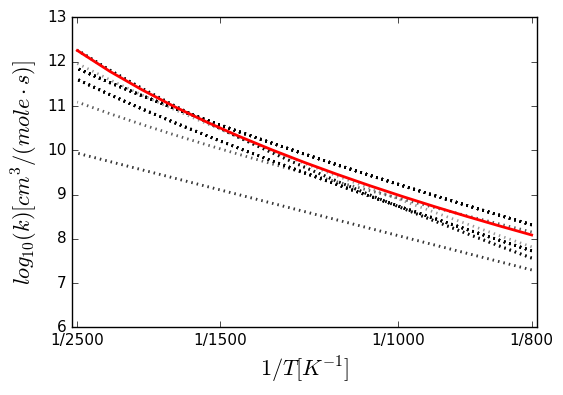


Arrhenius(A=(12.9,'cm^3/(mol*s)'), n=3.98, Ea=(3384.32,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3380.06,'cm^3/(mol*s)'), n=3.06318, Ea=(14.2963,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.58934, dn = +|- 0.0608061, dEa = +|- 0.334495 kJ/mol""")
A1CH3CH3 + H <=> A1CH3CH2 + H2


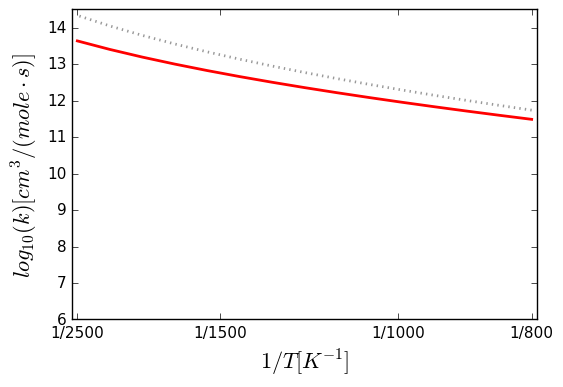


Arrhenius(A=(4.62e+06,'cm^3/(mol*s)'), n=2.17, Ea=(4163.48,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3380.06,'cm^3/(mol*s)'), n=3.06318, Ea=(14.2963,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.58934, dn = +|- 0.0608061, dEa = +|- 0.334495 kJ/mol""")
A1CH3CH3 + H <=> A1CH3 + CH3


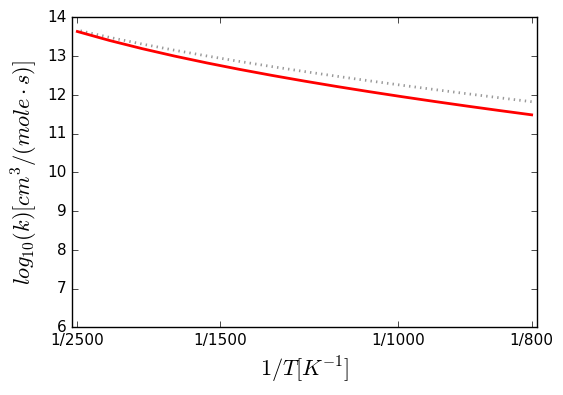


Arrhenius(A=(4.6e+12,'cm^3/(mol*s)'), n=0, Ea=(9810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00205385,'cm^3/(mol*s)'), n=3.86304, Ea=(-1.38474,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08757, dn = +|- 0.0110167, dEa = +|- 0.0606029 kJ/mol""")
AC6H13 + H2O2 <=> IC6H14 + HO2


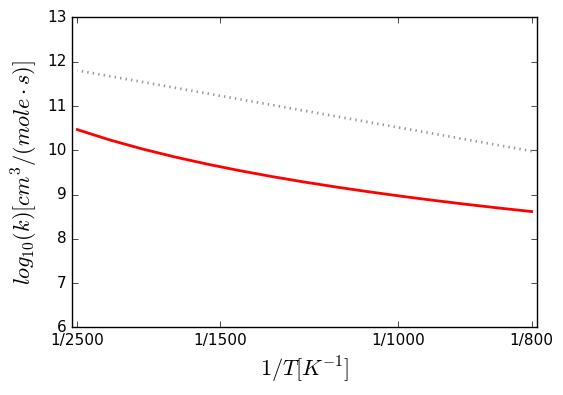


Arrhenius(A=(1.41,'cm^3/(mol*s)'), n=3.74, Ea=(25590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.39024e-08,'cm^3/(mol*s)'), n=5.5877, Ea=(23.9257,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.51546, dn = +|- 0.121064, dEa = +|- 0.665975 kJ/mol""")
C5H10-2 + HO2 <=> C5H11-2 + O2


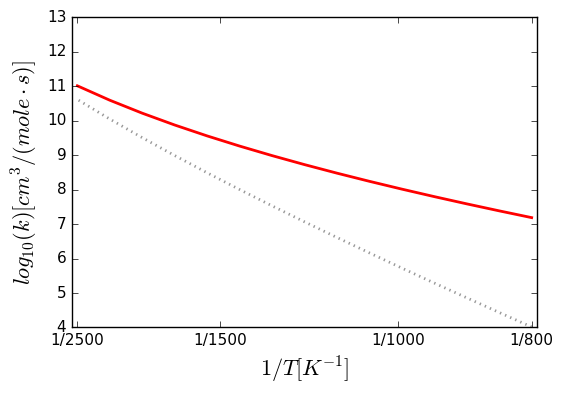


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
MultiArrhenius(arrhenius=[Arrhenius(A=(6400,'cm^3/(mol*s)'), n=2.6, Ea=(12400,'cal/mol'), T0=(1,'K')), Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(17000,'cal/mol'), T0=(1,'K')), Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(15500

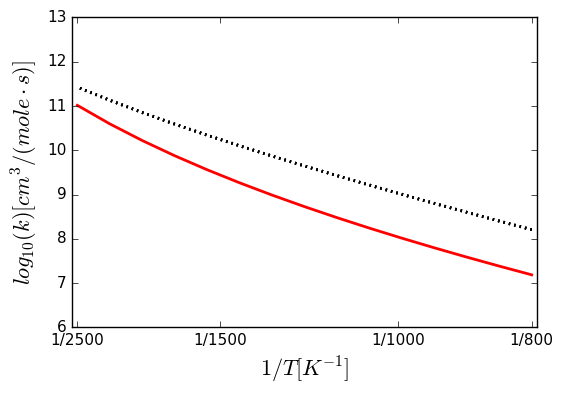


Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal/mol'), T0=(1,'K'))
MultiArrhenius(arrhenius=[Arrhenius(A=(6400,'cm^3/(mol*s)'), n=2.6, Ea=(12400,'cal/mol'), T0=(1,'K')), Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(17000,'cal/mol'), T0=(1,'K')), Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))])
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27000,'cm^3/(mol*s)'), n=2.5, Ea=(12340,'cal

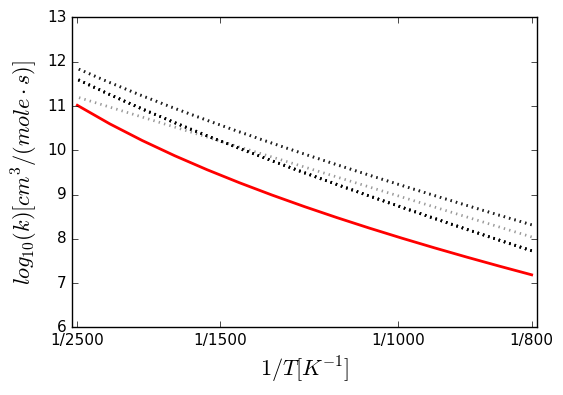


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16494,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'

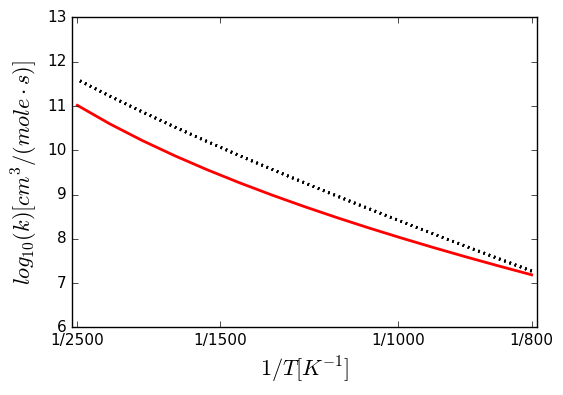


Arrhenius(A=(1.36,'cm^3/(mol*s)'), n=3.74, Ea=(25580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.39024e-08,'cm^3/(mol*s)'), n=5.5877, Ea=(23.9257,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.51546, dn = +|- 0.121064, dEa = +|- 0.665975 kJ/mol""")
C5H10-2 + HO2 <=> C5H11-3 + O2


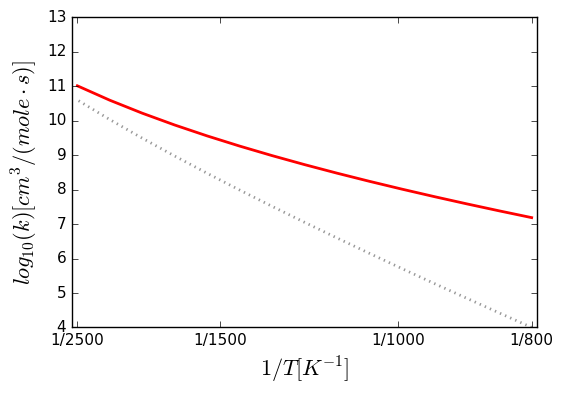


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(14200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.39024e-08,'cm^3/(mol*s)'), n=5.5877, Ea=(23.9257,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.51546, dn = +|- 0.121064, dEa = +|- 0.665975 kJ/mol""")
C5H10Y + R3OOH => R2OH + C5H10OE#3


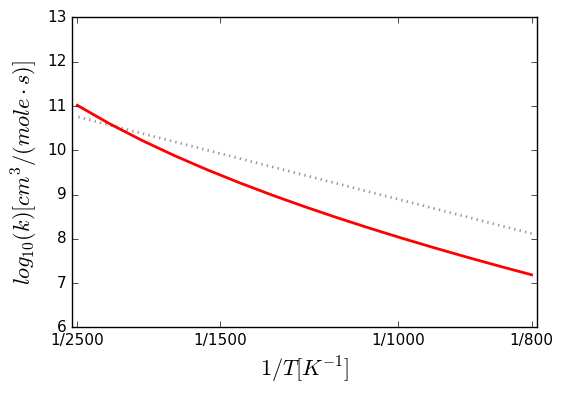


Arrhenius(A=(6.88e+12,'cm^3/(mol*s)'), n=0.05, Ea=(17880,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.88e+12,'cm^3/(mol*s)'), n=0.05, Ea=(17900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.88e+12,'cm^3/(mol*s)'), n=0.05, Ea=(17880,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.88e+12,'cm^3/(mol*s)'), n=0.05, Ea=(17880,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0145262,'cm^3/(mol*s)'), n=3.80511, Ea=(57.7743,'kJ/mol'), T0=(1,'K'

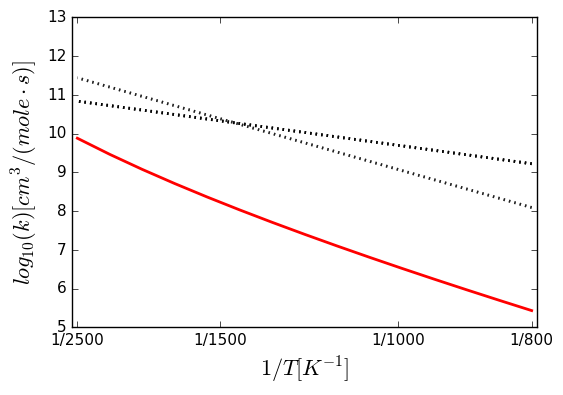


Arrhenius(A=(285500,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27.2,'cm^3/(mol*s)'), n=3.59, Ea=(17200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(285500,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(285500,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0145262,'cm^3/(mol*s)'), n=3.80511, Ea=(57.774

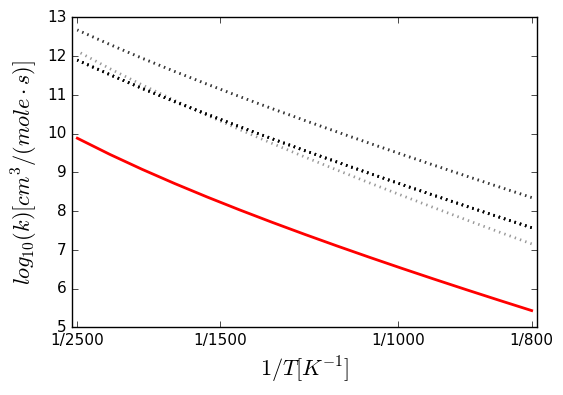


Arrhenius(A=(32000,'cm^3/(mol*s)'), n=2.2, Ea=(4472,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0145262,'cm^3/(mol*s)'), n=3.80511, Ea=(57.7743,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05418, dn = +|- 0.00692463, dEa = +|- 0.0380924 kJ/mol""")
C2H5COC2H4P + H2O2 <=> C2H5COC2H5 + HO2


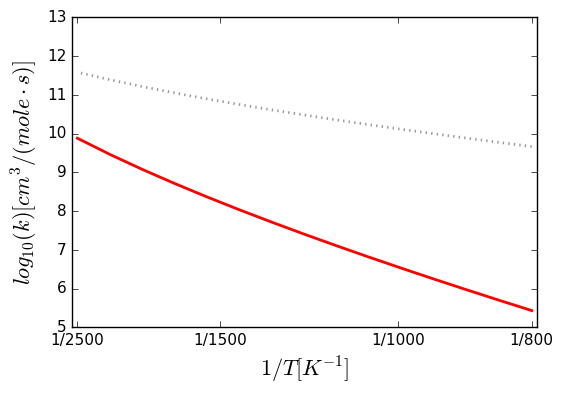


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0100585,'cm^3/(mol*s)'), n=3.77697, Ea=(-2.66879,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.03353, dn = +|- 0.00432836, dEa = +|- 0.0238103 kJ/mol""")
TC4H9CHO + HO2 <=> TC4H9CO + H2O2


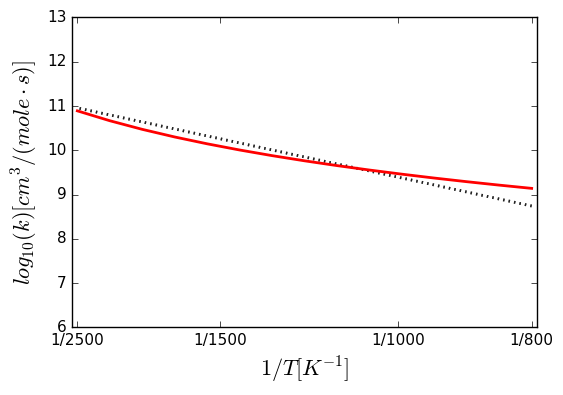


Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0100585,'cm^3/(mol*s)'), n=3.77697, Ea=(-2.66879,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.03353, dn = +|- 0.00432836, dEa = +|- 0.0238103 kJ/mol""")
TC4H9CHO + HO2 <=> TC4H8CHO + H2O2


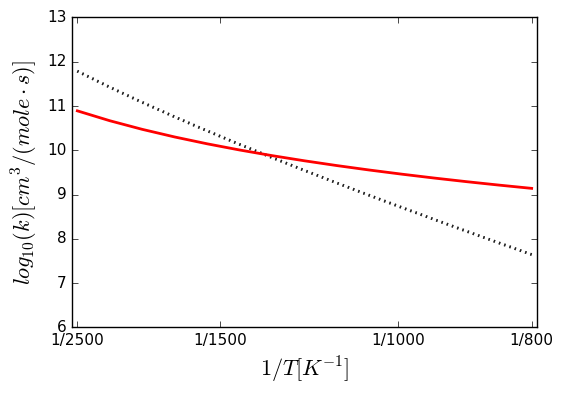


Arrhenius(A=(6070,'cm^3/(mol*s)'), n=2.22, Ea=(3472,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0100585,'cm^3/(mol*s)'), n=3.77697, Ea=(-2.66879,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.03353, dn = +|- 0.00432836, dEa = +|- 0.0238103 kJ/mol""")
TC4H8CHO + H2O2 <=> TC4H9CHO + HO2


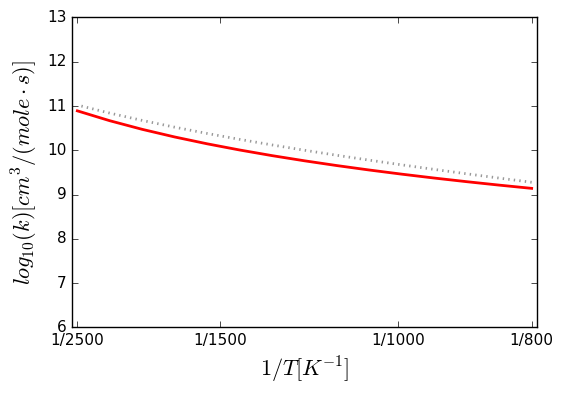


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.79575e-05,'cm^3/(mol*s)'), n=4.86428, Ea=(49.2984,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.53544, dn = +|- 0.0562785, dEa = +|- 0.309588 kJ/mol""")
NC10H22 + HO2 <=> C10H21-5 + H2O2


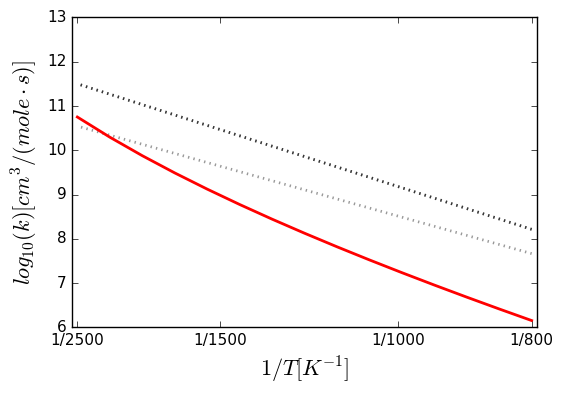


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.79575e-05,'cm^3/(mol*s)'), n=4.86428, Ea=(49.2984,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.53544, dn = +|- 0.0562785, dEa = +|- 0.309588 kJ/mol""")
NC10H22 + HO2 <=> C10H21-2 + H2O2


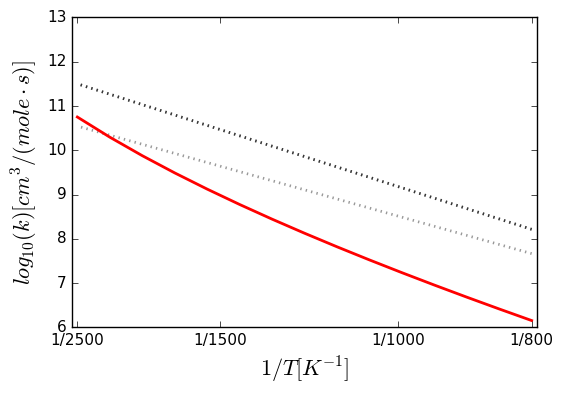


Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.2e+12,'cm^3/(mol*s)'), n=0, Ea=(17000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.79575e-05,'cm^3/(mol*s)'), n=4.86428, Ea=(49.2984,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.53544, dn = +|- 0.0562785, dEa = +|- 0.309588 kJ/mol""")
C10H22-1 + R3OOH => H2O2 + R26C10H21


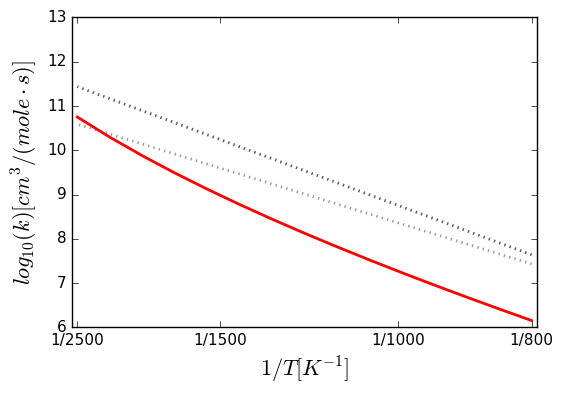


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.79575e-05,'cm^3/(mol*s)'), n=4.86428, Ea=(49.2984,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.53544, dn = +|- 0.0562785, dEa = +|- 0.309588 kJ/mol""")
NC10H22 + HO2 <=> C10H21-4 + H2O2


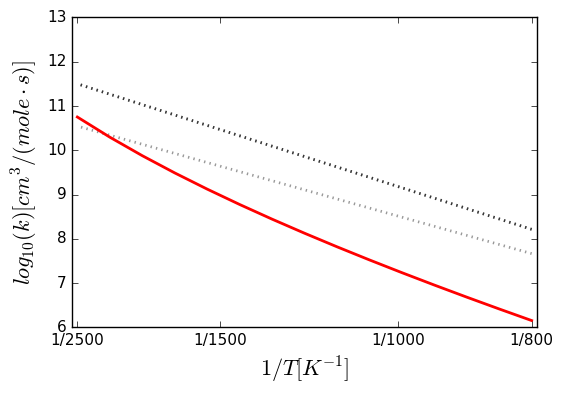


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.79575e-05,'cm^3/(mol*s)'), n=4.86428, Ea=(49.2984,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.53544, dn = +|- 0.0562785, dEa = +|- 0.309588 kJ/mol""")
NC10H22 + HO2 <=> C10H21-3 + H2O2


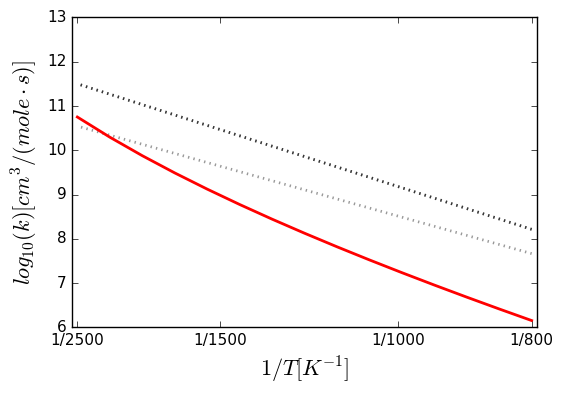


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000756742,'cm^3/(mol*s)'), n=4.21671, Ea=(2.243,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.25286, dn = +|- 0.029586, dEa = +|- 0.162753 kJ/mol""")
TC4H9COC2H5 + HO2 <=> TC4H9COC2H4P + H2O2


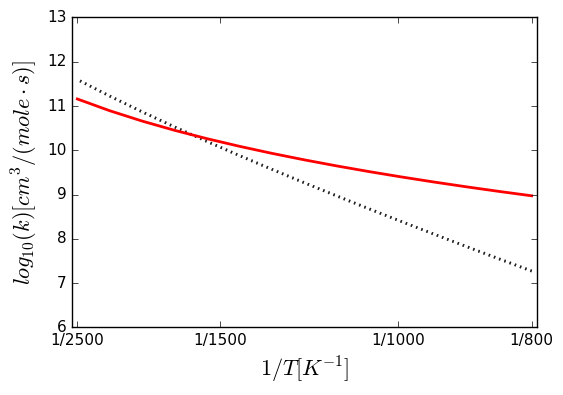


Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(30100,'cm^3/(mol*s)'), n=2.55, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000756742,'cm^3/(mol*s)'), n=4.21671, Ea=(2.243,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.25286, dn = +|- 0.029586, dEa = +|- 0.162753 kJ/mol""")
TC4H9COC2H5 + HO2 <=> TC4H8COC2H5 + H2O2


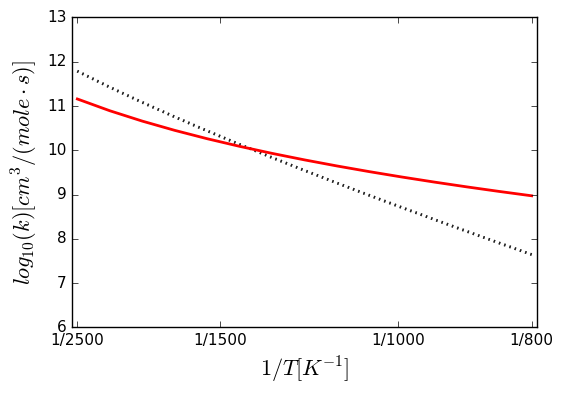


Arrhenius(A=(29100,'cm^3/(mol*s)'), n=2.21, Ea=(4462,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000756742,'cm^3/(mol*s)'), n=4.21671, Ea=(2.243,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.25286, dn = +|- 0.029586, dEa = +|- 0.162753 kJ/mol""")
TC4H9COC2H4P + H2O2 <=> TC4H9COC2H5 + HO2


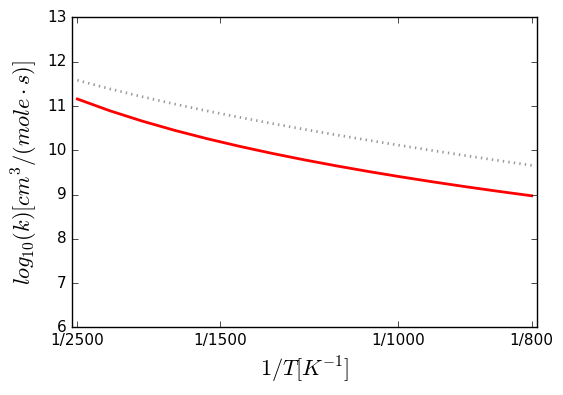


Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000756742,'cm^3/(mol*s)'), n=4.21671, Ea=(2.243,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.25286, dn = +|- 0.029586, dEa = +|- 0.162753 kJ/mol""")
TC4H9COC2H5 + HO2 <=> TC4H9COC2H4S + H2O2


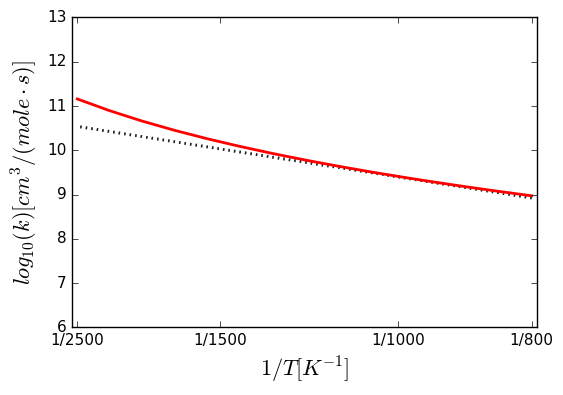


Arrhenius(A=(3.93e+11,'cm^3/(mol*s)'), n=0.02, Ea=(8152,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00224592,'cm^3/(mol*s)'), n=3.79552, Ea=(-3.25405,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.03304, dn = +|- 0.00426637, dEa = +|- 0.0234693 kJ/mol""")
CC5H10CHO + H2O2 <=> IC5H11CHO + HO2


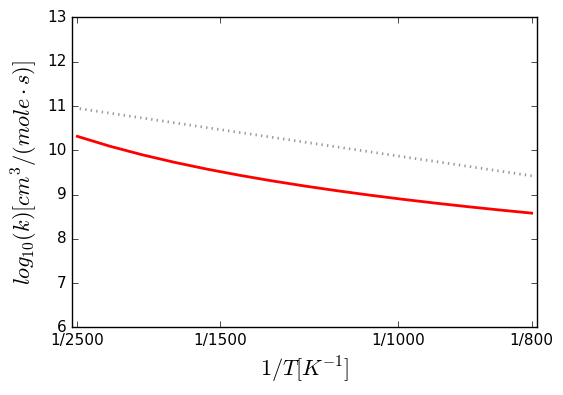


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'), comment="""Chemkin file stated explicit reverse rate: REV /  0.000E+00  0.00  0.000E+00 /""")
Arrhenius(A=(0.00140518,'cm^3/(mol*s)'), n=4.24171, Ea=(26.1372,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.27, dn = +|- 0.0313684, dEa = +|- 0.172557 kJ/mol""")
sc4h8oh-3 + ho2 => sc4h8oh-3o + oh


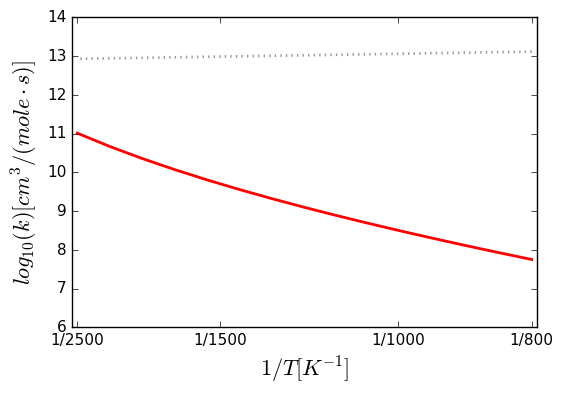


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(15700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0417383,'cm^3/(mol*s)'), n=3.76542, Ea=(42.1265,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05512, dn = +|- 0.00704174, dEa = +|- 0.0387366 kJ/mol""")
MCHYO25 + HO2 <=> CC.C*CCCCO + H2O2


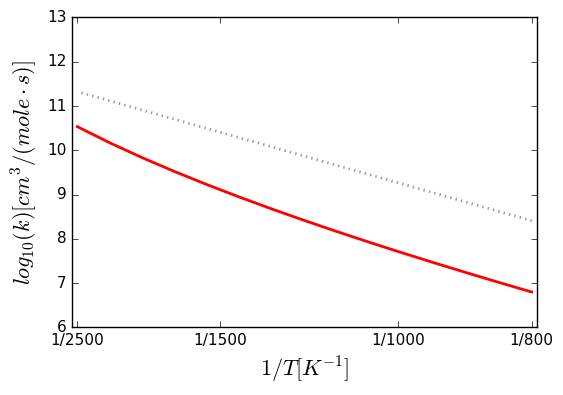


Arrhenius(A=(18390,'cm^3/(mol*s)'), n=2, Ea=(2691.16,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18390,'cm^3/(mol*s)'), n=2, Ea=(2691.16,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6.00784e-05,'cm^3/(mol*s)'), n=4.42772, Ea=(4.68842,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.40489, dn = +|- 0.0446164, dEa = +|- 0.245435 kJ/mol""")
CH3COCH2 + H2O2 => CH3COCH3 + HO2


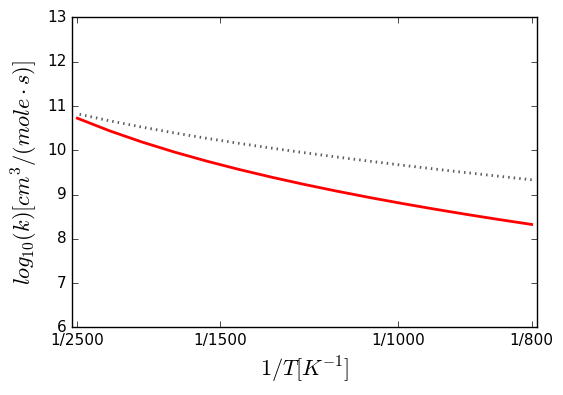


Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.7e+13,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K')

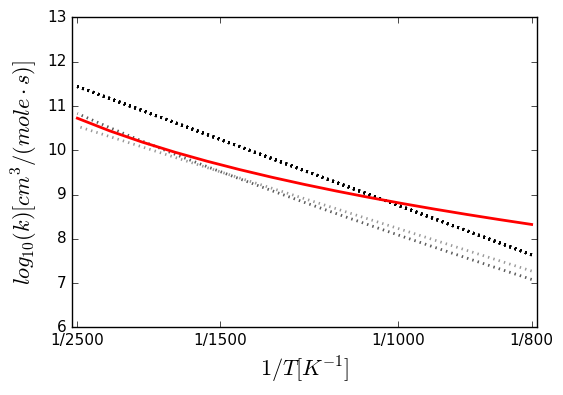


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.02454e-08,'cm^3/(mol*s)'), n=5.05735, Ea=(16.5194,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.60075, dn = +|- 0.0617451, dEa = +|- 0.33966 kJ/mol""")
OC7H15O2 + H2O2 <=> OC7H15O2H + HO2


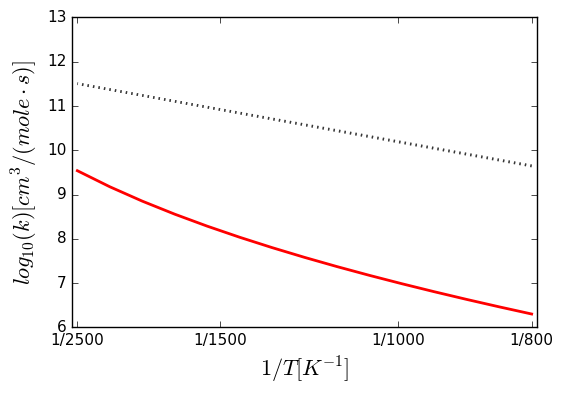


Arrhenius(A=(7e+12,'cm^3/(mol*s)'), n=0, Ea=(-1000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0017047,'cm^3/(mol*s)'), n=4.40707, Ea=(52.5554,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.26789, dn = +|- 0.0311504, dEa = +|- 0.171358 kJ/mol""")
c4h8oh-4 + ho2 <=> c4h8oh-4o + oh


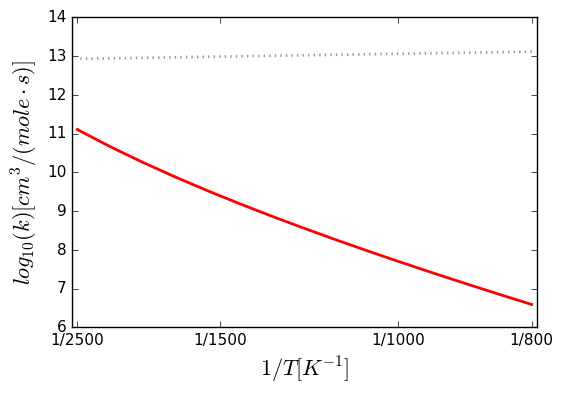


Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(81000,'cm^3/(mol*s)'), n=2.5, Ea=(16690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(81000,'cm^3/(mol*s)'), n=2.5, Ea=(16690,'cal/mol'), T0=(1,'K'))
MultiArrhenius(arrhenius=[Arrhenius(A=(1.2e+12,'cm^3/(mol*s)'), n=0, Ea=(17000,'cal/mol'), T0=(1,'K')), Arrhenius(A=(1.6e+12,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))])
Arrhenius(A=(81000,'cm^3/(mol*s)'), n=2.5, Ea=(16690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(81000,'cm^3/(mol*s)'), n=2.5, Ea=(16690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000468774,'cm^3/(mol*s)'), 

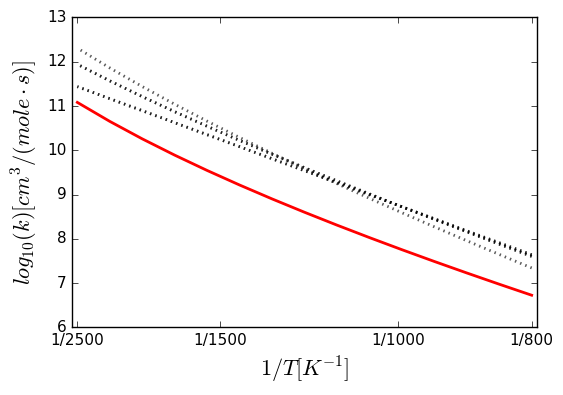


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(117600,'cm^3/(mol*s)'), n=2.5, Ea=(14860,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(117600,'cm^3/(mol*s)'), n=2.5, Ea=(14860,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(117600,'cm^3/(mol*s)'), n=2.5, Ea=(14860,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(117600,'cm^3/(mol*s)'), n=2.5, Ea=(14860,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000468774,'cm^3/(mol*s)'), n=4.53367, Ea=(47.5335,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.35032, dn = +|- 0.039417, dEa = +|- 0.216833 kJ

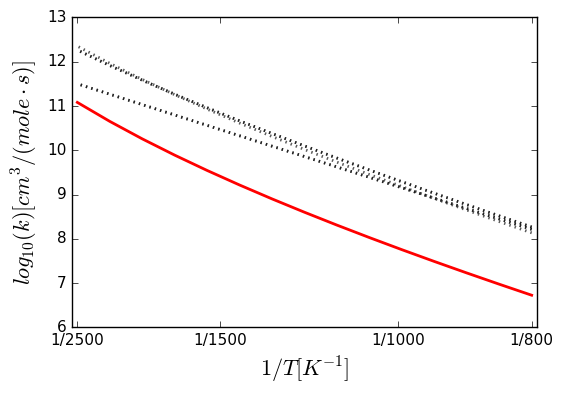


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(117600,'cm^3/(mol*s)'), n=2.5, Ea=(14860,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(117600,'cm^3/(mol*s)'), n=2.5, Ea=(14860,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(117600,'cm^3/(mol*s)'), n=2.5, Ea=(14860,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(117600,'cm^3/(mol*s)'), n=2.5, Ea=(14860,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000468774,'cm^3/(mol*s)'), n=4.53367, Ea=(47.5335,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.35032, dn = +|- 0.039417, dEa = +|- 0.216833 kJ

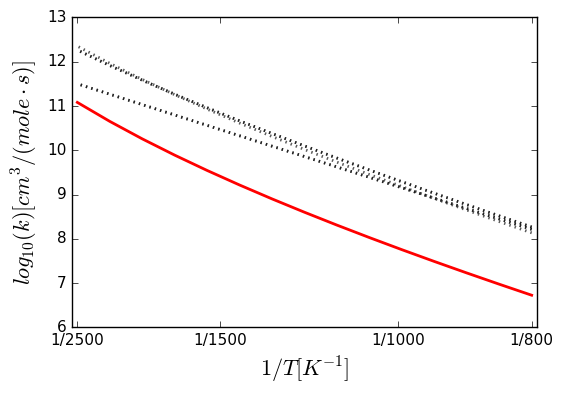


Arrhenius(A=(4.32e+11,'cm^3/(mol*s)'), n=0.01, Ea=(8169,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000468774,'cm^3/(mol*s)'), n=4.53367, Ea=(47.5335,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.35032, dn = +|- 0.039417, dEa = +|- 0.216833 kJ/mol""")
C6H13-2 + H2O2 <=> NC6H14 + HO2


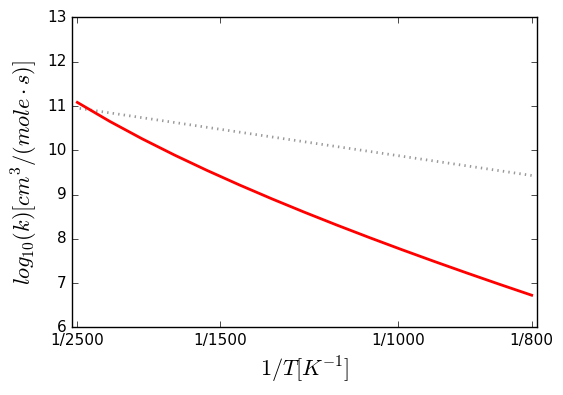


Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3/(mol*s)'), n=0, Ea=(37600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+13,'cm^3

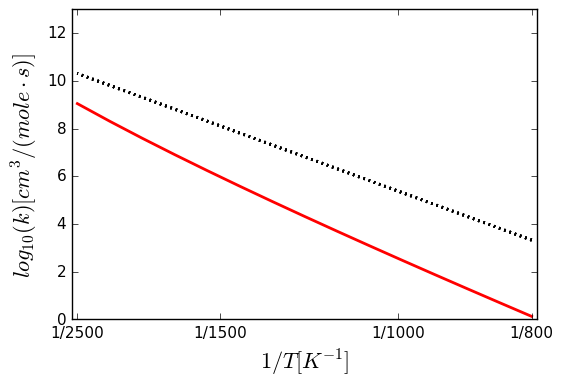


Arrhenius(A=(2.15e+06,'cm^3/(mol*s)'), n=2.07, Ea=(16260,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.9267e-10,'cm^3/(mol*s)'), n=5.77552, Ea=(25.3266,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 3.25549, dn = +|- 0.154909, dEa = +|- 0.852157 kJ/mol""")
IC3H5CHCHO + H2O2 <=> IC4H7CHO + HO2


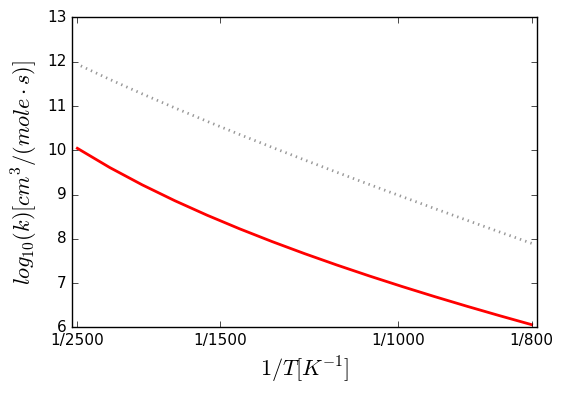


Arrhenius(A=(1e+13,'cm^3/(mol*s)'), n=0, Ea=(15800,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+13,'cm^3/(mol*s)'), n=0, Ea=(15800,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+13,'cm^3/(mol*s)'), n=0, Ea=(15800,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+13,'cm^3/(mol*s)'), n=0, Ea=(15800,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+13,'cm^3/(mol*s)'), n=0, Ea=(15800,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.12783e-05,'cm^3/(mol*s)'), n=4.72352, Ea=(7.13709,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.59015, dn = +|- 0.0608733, dEa = +|- 0.334864 kJ/mol""")
c5h5oh + ho2 <=> c5h5o + h2o2


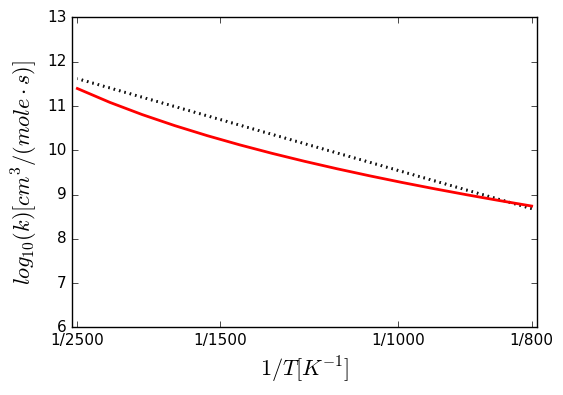


Arrhenius(A=(3600,'cm^3/(mol*s)'), n=2.55, Ea=(10531,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3600,'cm^3/(mol*s)'), n=2.55, Ea=(10531,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3600,'cm^3/(mol*s)'), n=2.55, Ea=(10531,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3600,'cm^3/(mol*s)'), n=2.55, Ea=(10531,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3610,'cm^3/(mol*s)'), n=2.55, Ea=(10531,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3600,'cm^3/(mol*s)'), n=2.55, Ea=(10531,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.12783e-05,'cm^3/(mol*s)'), n=4.72352, Ea=(7.13709,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.59015, dn = +|- 0.0608733, dEa = +|- 0.334864 kJ/mol""")
c5h5oh + ho2 <=> c5h4oh + h2o2


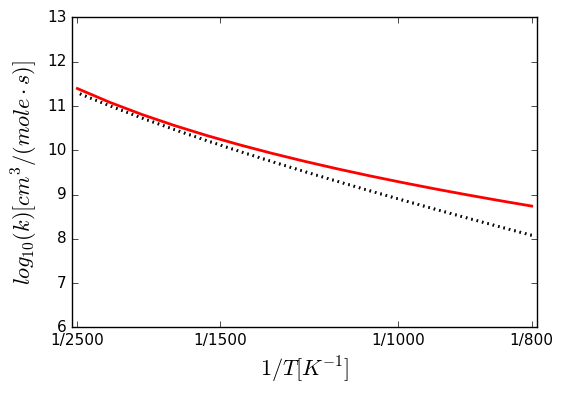


Arrhenius(A=(1280,'cm^3/(mol*s)'), n=2.6, Ea=(4399,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000259913,'cm^3/(mol*s)'), n=3.95987, Ea=(-1.52149,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.13089, dn = +|- 0.0161432, dEa = +|- 0.0888038 kJ/mol""")
C4H8CHO-3 + H2O2 <=> NC4H9CHO + HO2


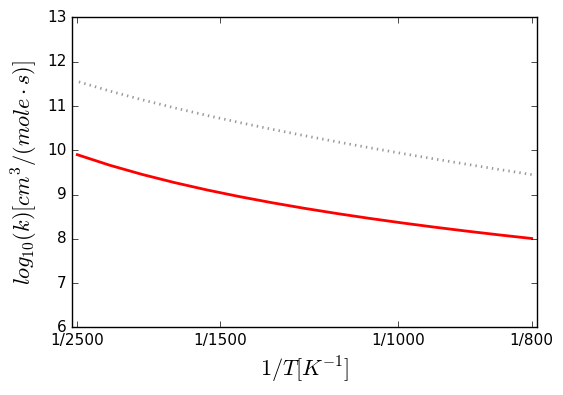


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.2862e-09,'cm^3/(mol*s)'), n=5.52782, Ea=(10.9264,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.19391, dn = +|- 0.103114, dEa = +|- 0.567231 kJ/mol""")
ic4h8oh-1o2 + h2o2 <=> ic4h8oh-1o2h + ho2


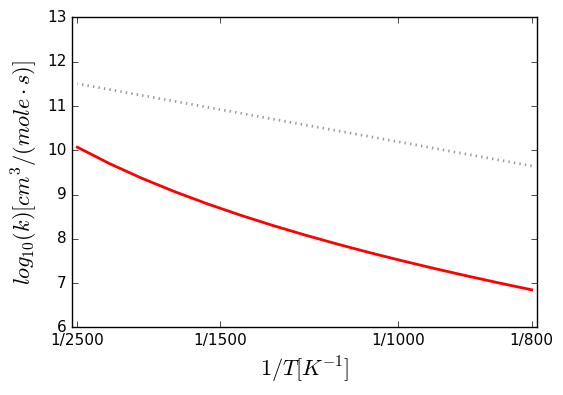


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.05308e-06,'cm^3/(mol*s)'), n=5.14251, Ea=(18.286,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.6569, dn = +|- 0.0662702, dEa = +|- 0.364552 kJ/mol""")
c4h8oh-2o2 + h2o2 <=> c4h8oh-2o2h + ho2


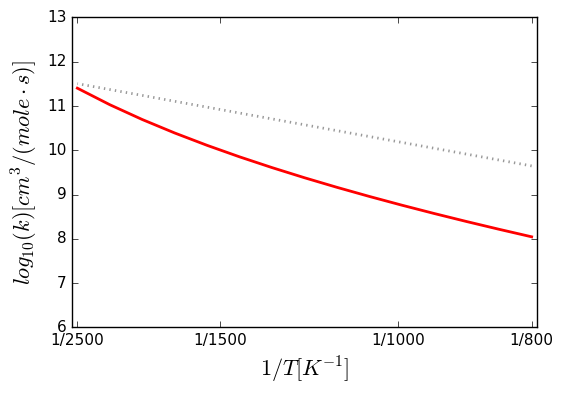


Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00210305,'cm^3/(mol*s)'), n=3.79143, Ea=(-3.16643,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.04666, dn = +|- 0.0059857, dEa = +|- 0.0329273 kJ/mol""")
NC5H11CHO-2 + HO2 <=> C5H10CHO4-2 + H2O2


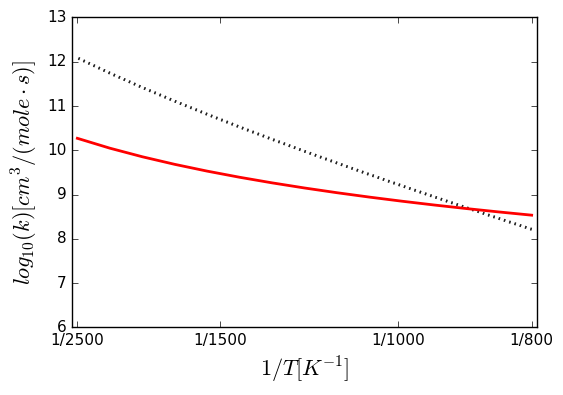


Arrhenius(A=(55200,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55200,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55200,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55200,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00210305,'cm^3/(mol*s)'), n=3.79143, Ea=(-3.16643,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.04666, dn = +|- 0.0059857, dEa = +|- 0.0329273 kJ/mol""")
NC5H11CHO-2 + HO2 <=> C5H10CHO1-2 + H2O2


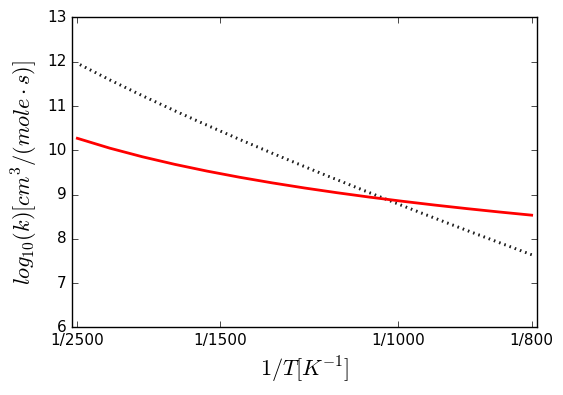


Arrhenius(A=(55200,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55200,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55200,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(55200,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00210305,'cm^3/(mol*s)'), n=3.79143, Ea=(-3.16643,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.04666, dn = +|- 0.0059857, dEa = +|- 0.0329273 kJ/mol""")
NC5H11CHO-2 + HO2 <=> C5H10CHO5-2 + H2O2


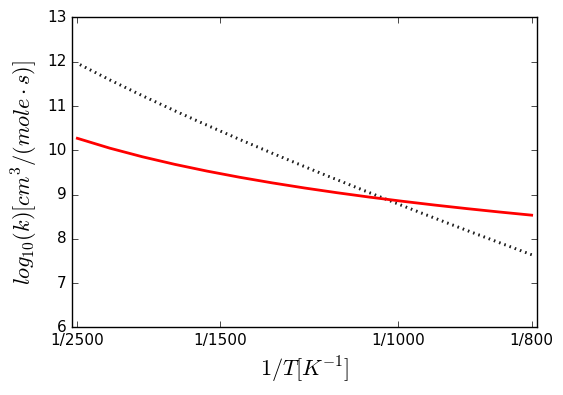


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00210305,'cm^3/(mol*s)'), n=3.79143, Ea=(-3.16643,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.04666, dn = +|- 0.0059857, dEa = +|- 0.0329273 kJ/mol""")
NC5H11CHO-2 + HO2 <=> NC5H11CO-2 + H2O2


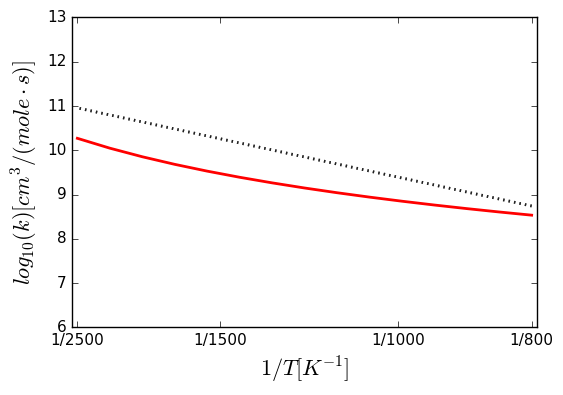


Arrhenius(A=(71600,'cm^3/(mol*s)'), n=2.21, Ea=(4462,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00210305,'cm^3/(mol*s)'), n=3.79143, Ea=(-3.16643,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.04666, dn = +|- 0.0059857, dEa = +|- 0.0329273 kJ/mol""")
C5H10CHO5-2 + H2O2 <=> NC5H11CHO-2 + HO2


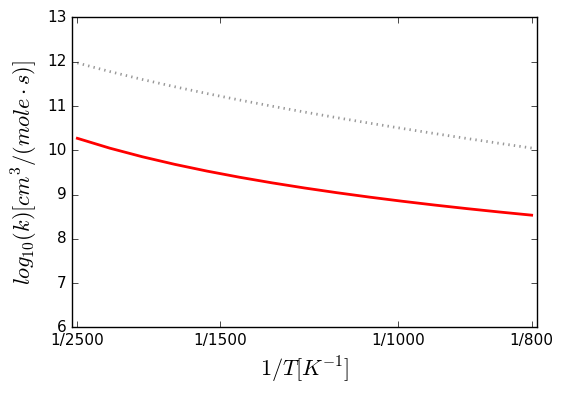


Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00210305,'cm^3/(mol*s)'), n=3.79143, Ea=(-3.16643,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.04666, dn = +|- 0.0059857, dEa = +|- 0.0329273 kJ/mol""")
NC5H11CHO-2 + HO2 <=> C5H10CHO3-2 + H2O2


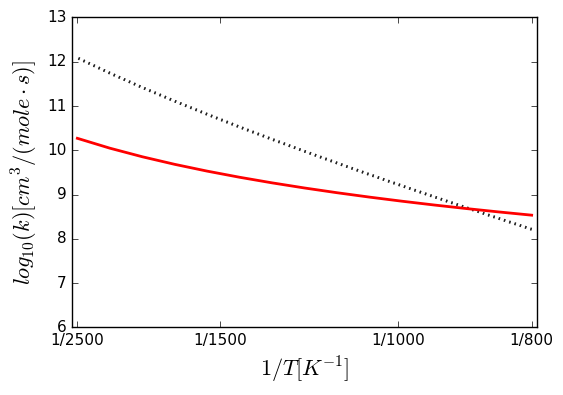


Arrhenius(A=(1e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00210305,'cm^3/(mol*s)'), n=3.79143, Ea=(-3.16643,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.04666, dn = +|- 0.0059857, dEa = +|- 0.0329273 kJ/mol""")
NC5H11CHO-2 + HO2 <=> C5H10CHO2-2 + H2O2


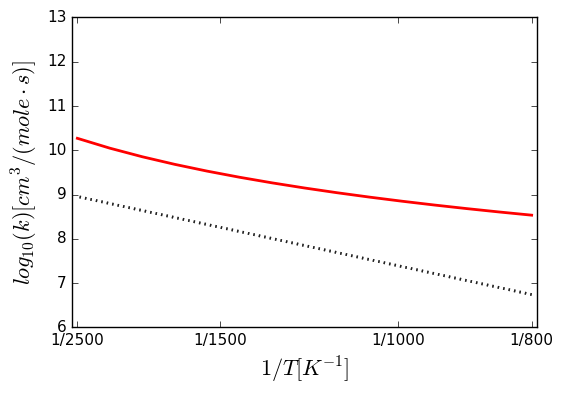


Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14800,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000336721,'cm^3/(mol*s)'), n=3.89083, Ea=(-2.78684,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.09344, dn = +|- 0.0117236, dEa = +|- 0.0644917 kJ/mol""")
NC5H11CHO + HO2 <=> C5H10CHO-4 + H2O2


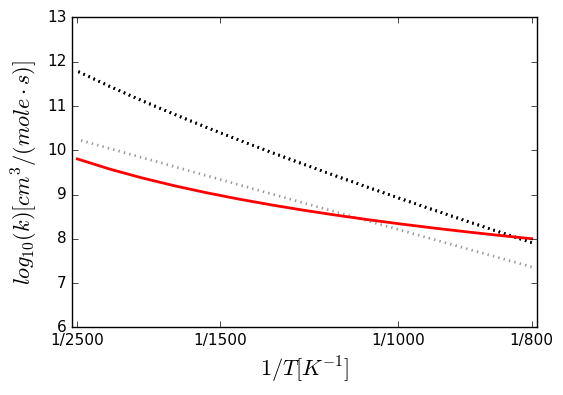


Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14800,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000336721,'cm^3/(mol*s)'), n=3.89083, Ea=(-2.78684,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.09344, dn = +|- 0.0117236, dEa = +|- 0.0644917 kJ/mol""")


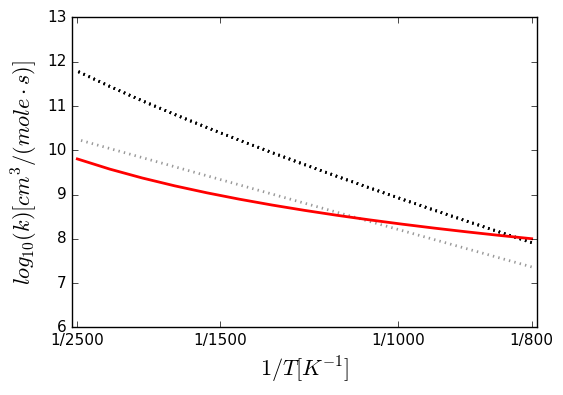


Arrhenius(A=(33300,'cm^3/(mol*s)'), n=2.22, Ea=(4442,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000336721,'cm^3/(mol*s)'), n=3.89083, Ea=(-2.78684,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.09344, dn = +|- 0.0117236, dEa = +|- 0.0644917 kJ/mol""")
C5H10CHO-1 + H2O2 <=> NC5H11CHO + HO2


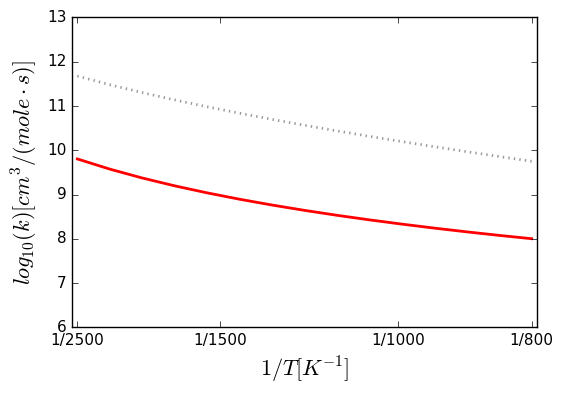


Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14800,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000336721,'cm^3/(mol*s)'), n=3.89083, Ea=(-2.78684,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.09344, dn = +|- 0.0117236, dEa = +|- 0.0644917 kJ/mol""")
NC5H11CHO + HO2 <=> C5H10CHO-2 + H2O2


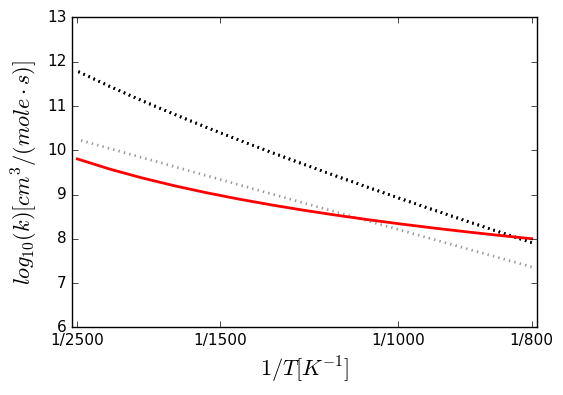


Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000336721,'cm^3/(mol*s)'), n=3.89083, Ea=(-2.78684,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.09344, dn = +|- 0.0117236, dEa = +|- 0.0644917 kJ/mol""")
NC5H11CHO + HO2 <=> C5H10CHO-5 + H2O2


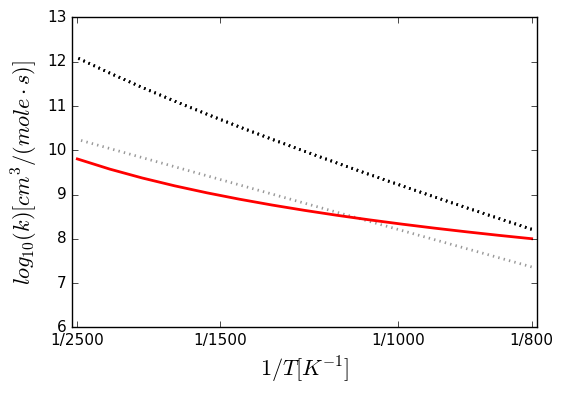


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9500,'cm^3/(mol*s)'), n=2.7, Ea=(11520,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000336721,'cm^3/(mol*s)'), n=3.89083, Ea=(-2.78684,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.09344, dn = +|- 0.0117236, dEa = +|- 0.0644917 kJ/mol""")

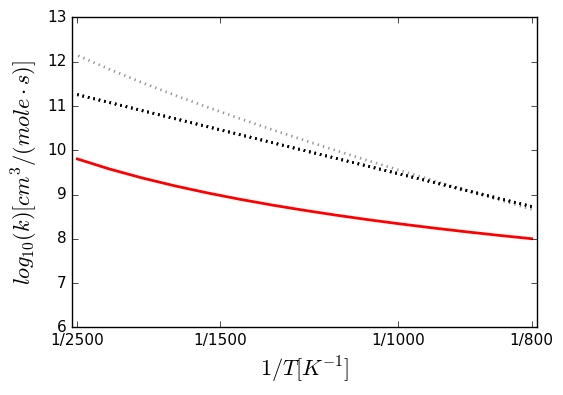


Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+11,'cm^3/(mol*s)'), n=0, Ea=(17000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000336721,'cm^3/(mol*s)'), n=3.89083, Ea=(-2.78684,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.09344, dn = +|- 0.0117236, dEa = +|- 0.0644917 kJ/mol""")
NC5H11CHO + HO2 <=> C5H10CHO-1 + H2O2


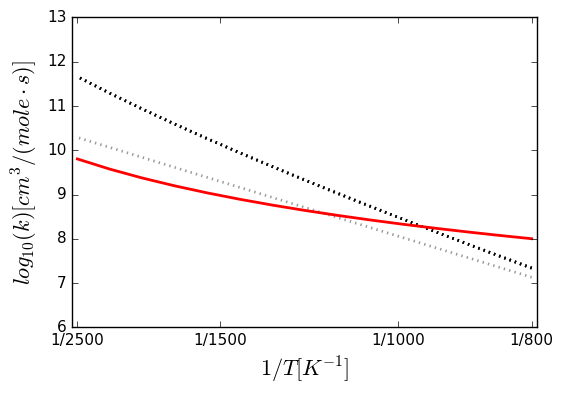


Arrhenius(A=(29300,'cm^3/(mol*s)'), n=2.21, Ea=(4471,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00270139,'cm^3/(mol*s)'), n=4.03277, Ea=(0.142169,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15835, dn = +|- 0.0192924, dEa = +|- 0.106128 kJ/mol""")
C4H8CHO4-2 + H2O2 <=> NC4H9CHO-2 + HO2


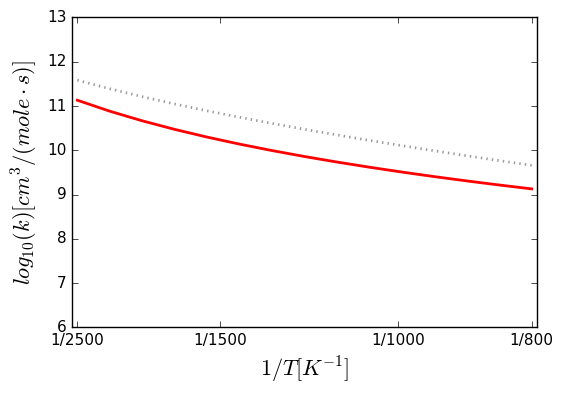


Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(28900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(28900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(28900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.476861,'cm^3/(mol*s)'), n=3.85587, Ea=(106.72,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.07922, dn = +|- 0.010005, dEa = +|- 0.0550376 kJ/mol""")
C6H5OH# + R3OOH <=> C6H4OH# + H2O2


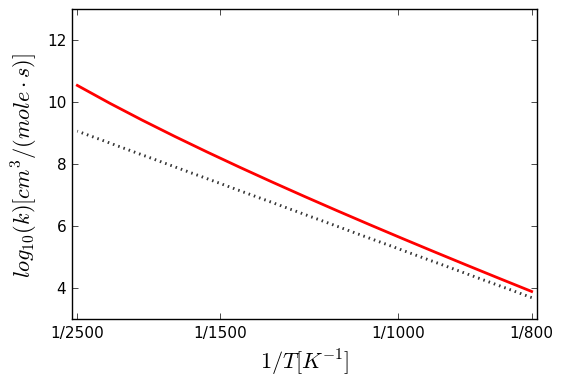


Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(28900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(28900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(28900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(28900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.476861,'cm^3/(mol*s)'), n=3.85587, Ea=(106.72,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.07922, dn = +|- 0.010005, dEa = +|- 0.0550376 kJ/mol""")
c6h5oh + ho2 <=> c6h4oh + h2o2


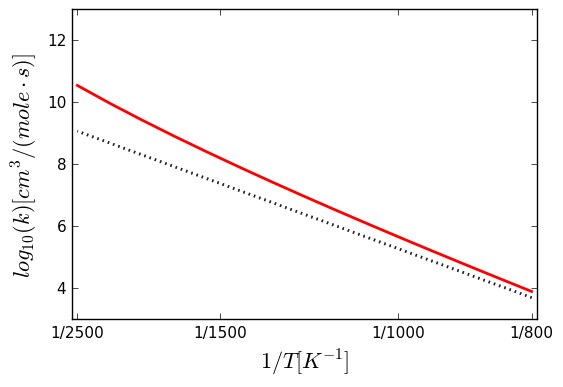


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(8000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(269400,'cm^3/(mol*s)'), n=2, Ea=(13998.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+13,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(269400,'cm^3/(mol*s)'), n=2, Ea=(13998.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.476861,'cm^3/(mol*s)'), n=3.85587, Ea=(106.72,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.0

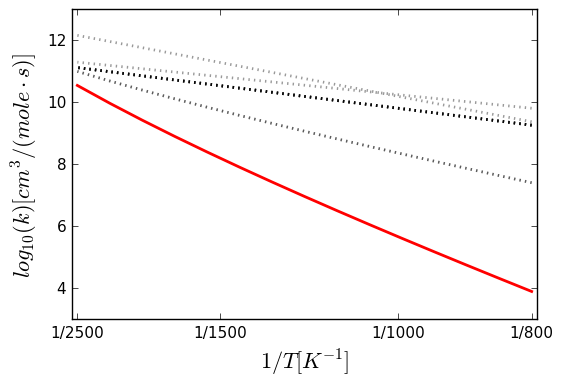


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.32693e-06,'cm^3/(mol*s)'), n=4.68695, Ea=(15.3617,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.41324, dn = +|- 0.0453944, dEa = +|- 0.249714 kJ/mol""")
H2O2 + C7H15O2-3 <=> HO2 + C7H15O2H-3


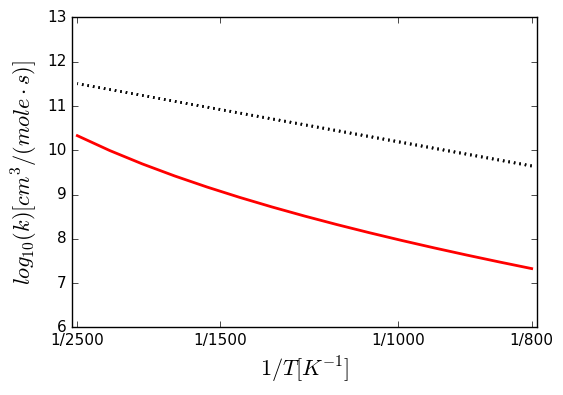


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.32693e-06,'cm^3/(mol*s)'), n=4.68695, Ea=(15.3617,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.41324, dn = +|- 0.0453944, dEa = +|- 0.249714 kJ/mol""")
HO2 + C7H15O2H-3 <=> H2O2 + C7H15O2-3


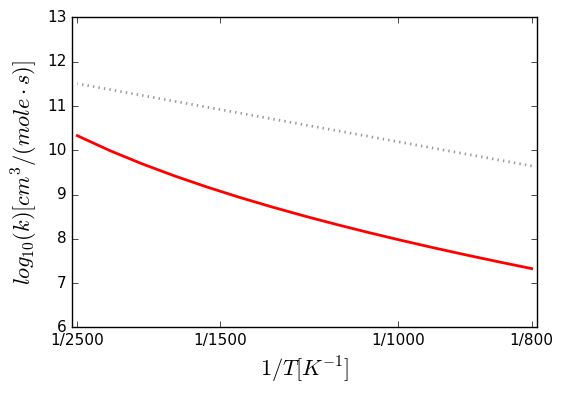


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.35229e-07,'cm^3/(mol*s)'), n=4.86524, Ea=(14.921,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.55803, dn = +|- 0.058195, dEa = +|- 0.320131 kJ/mol""")
c8h17o2-4 + h2o2 <=> c8h17o2h-4 + ho2


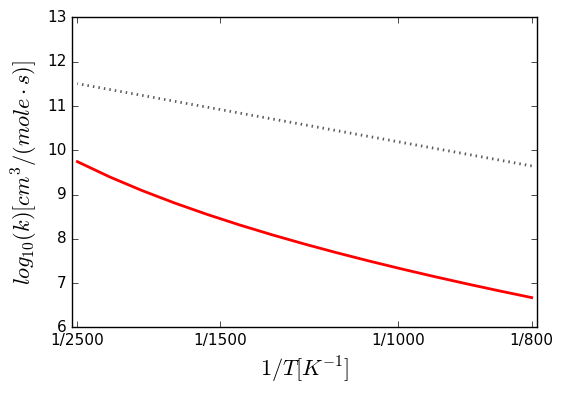


Arrhenius(A=(316,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(316,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0002835,'cm^3/(mol*s)'), n=4.30892, Ea=(48.8064,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21888, dn = +|- 0.0259768, dEa = +|- 0.142899 kJ/mol""")
CHX1*O + HO2 <=> CHX1*O2J + H2O2


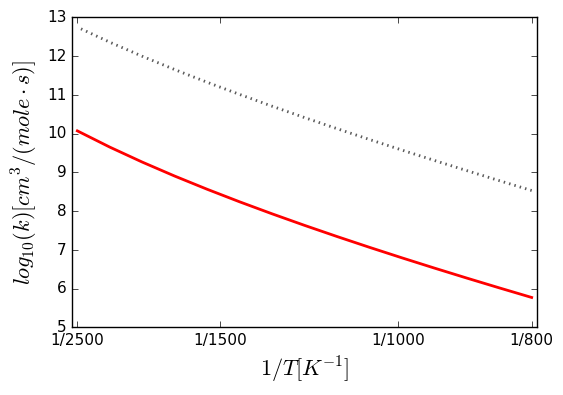


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.79211e-08,'cm^3/(mol*s)'), n=5.14114, Ea=(11.3087,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.71986, dn = +|- 0.0711647, dEa = +|- 0.391477 kJ/mol""")
PC7H15O2 + H2O2 <=> PC7H15O2H + HO2


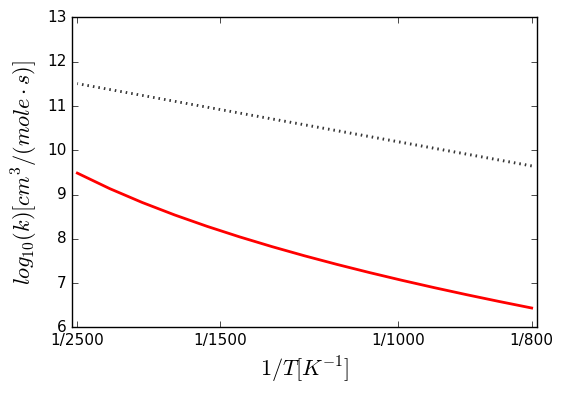


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(11510,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(11510,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(11510,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0445131,'cm^3/(mol*s)'), n=3.55572, Ea=(-6.02471,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05717, dn = +|- 0.00729583, dEa = +|- 0.0401344 kJ/mol""")
IC5H11CHO + HO2 <=> DC5H10CHO + H2O2


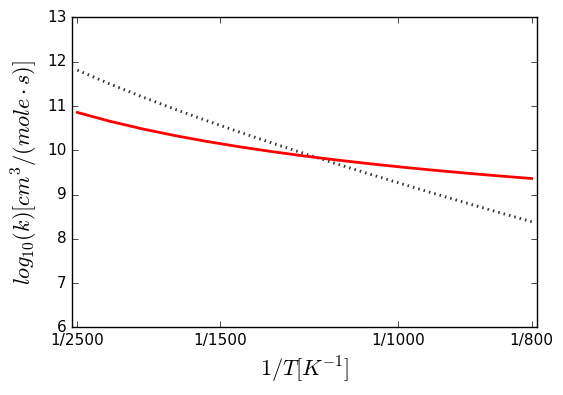


Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0445131,'cm^3/(mol*s)'), n=3.55572, Ea=(-6.02471,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05717, dn = +|- 0.00729583, dEa = +|- 0.0401344 kJ/mol""")
ic5h11cho + ho2 <=> ic5h11co + h2o2


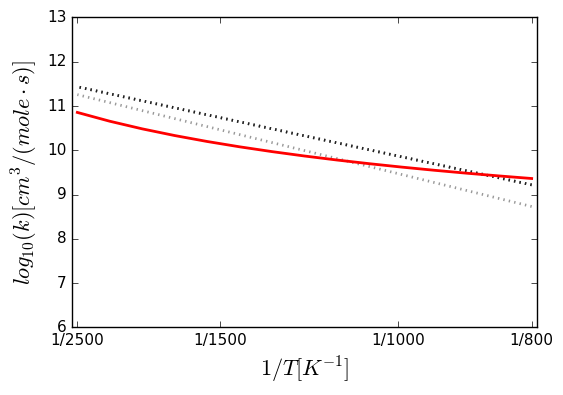


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0445131,'cm^3/(mol*s)'), n=3.55572, Ea=(-6.02471,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05717, dn = +|- 0.00729583, dEa = +|- 0.0401344 kJ/mol""")
IC5H11CHO + HO2 <=> CC5H10CHO + H2O2


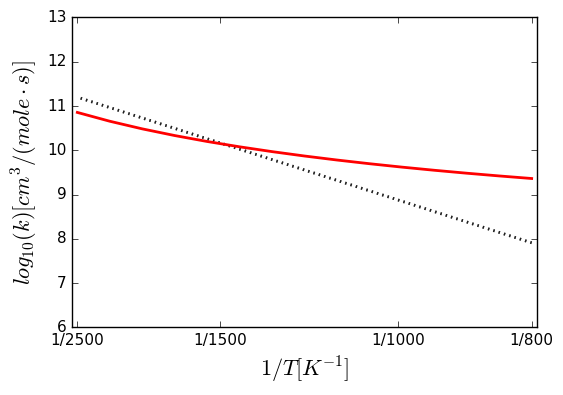


Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0445131,'cm^3/(mol*s)'), n=3.55572, Ea=(-6.02471,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05717, dn = +|- 0.00729583, dEa = +|- 0.0401344 kJ/mol""")
IC5H11CHO + HO2 <=> AC5H10CHO + H2O2


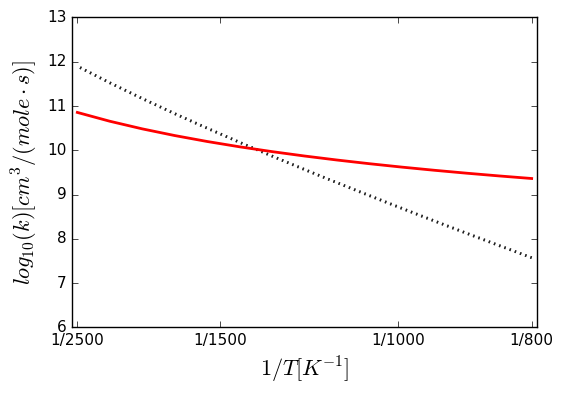


Arrhenius(A=(1.59e+09,'cm^3/(mol*s)'), n=0.25, Ea=(4372,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0445131,'cm^3/(mol*s)'), n=3.55572, Ea=(-6.02471,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05717, dn = +|- 0.00729583, dEa = +|- 0.0401344 kJ/mol""")
BC5H10CHO + H2O2 <=> IC5H11CHO + HO2


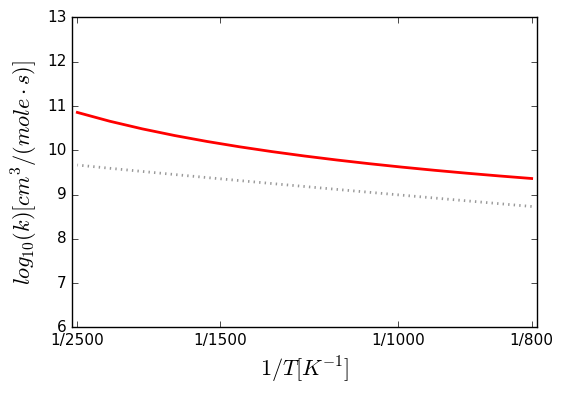


Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0445131,'cm^3/(mol*s)'), n=3.55572, Ea=(-6.02471,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05717, dn = +|- 0.00729583, dEa = +|- 0.0401344 kJ/mol""")
IC5H11CHO + HO2 <=> BC5H10CHO + H2O2


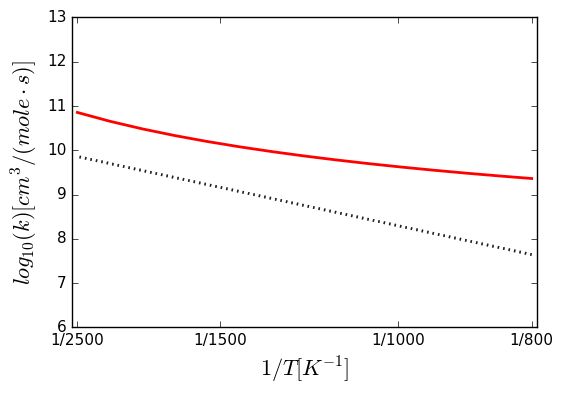


Arrhenius(A=(2.1e+19,'cm^3/(mol*s)'), n=-1.59, Ea=(30180,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(59334.8,'cm^3/(mol*s)'), n=2.72743, Ea=(10.3235,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.13389, dn = +|- 0.0164915, dEa = +|- 0.0907198 kJ/mol""")
BC5H11O + OH <=> BC5H11 + HO2


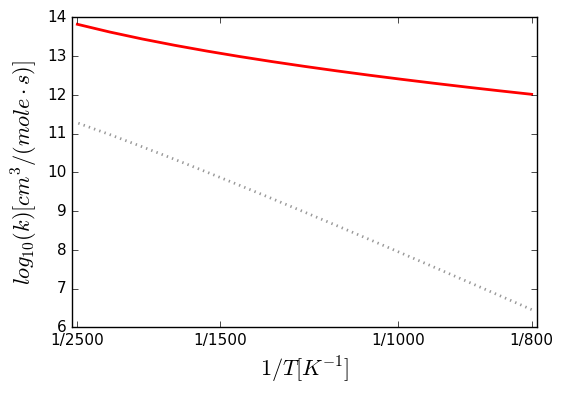


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.93459e-07,'cm^3/(mol*s)'), n=5.0001, Ea=(12.8398,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.73059, dn = +|- 0.071981, dEa = +|- 0.395967 kJ/mol""")
NC7H15O2 + H2O2 <=> NC7H15O2H + HO2


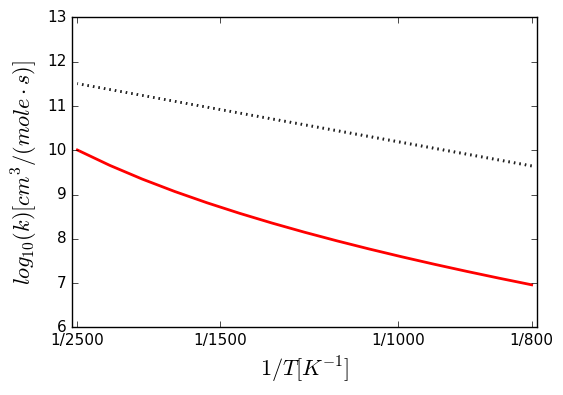


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.41659e-07,'cm^3/(mol*s)'), n=5.13587, Ea=(39.8617,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.83771, dn = +|- 0.0798628, dEa = +|- 0.439326 kJ/mol""")
ROOH4 + HO2 <=> RO24 + H2O2


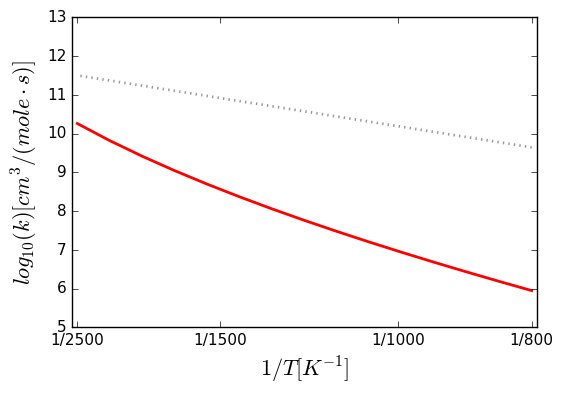


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.57e+12,'cm^3/(mol*s)'), n=0.21, Ea=(17633.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(388,'cm^3/(mol*s)'), n=3.34, Ea=(12300,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000546978,'cm^3/(mol*s)'), n=4.56807, Ea=(48.

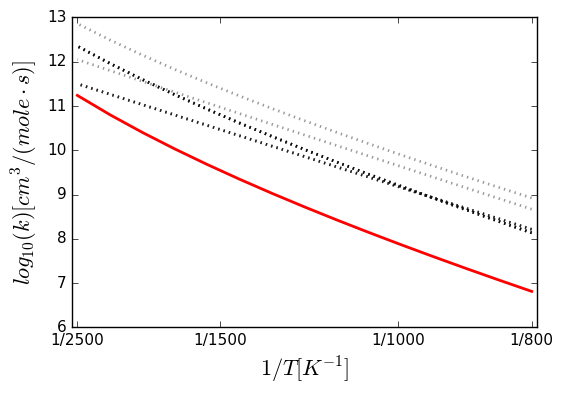


Arrhenius(A=(4.35e+11,'cm^3/(mol*s)'), n=0.01, Ea=(8165,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000546978,'cm^3/(mol*s)'), n=4.56807, Ea=(48.7635,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.38189, dn = +|- 0.04245, dEa = +|- 0.233518 kJ/mol""")
C7H15-2 + H2O2 <=> NC7H16 + HO2


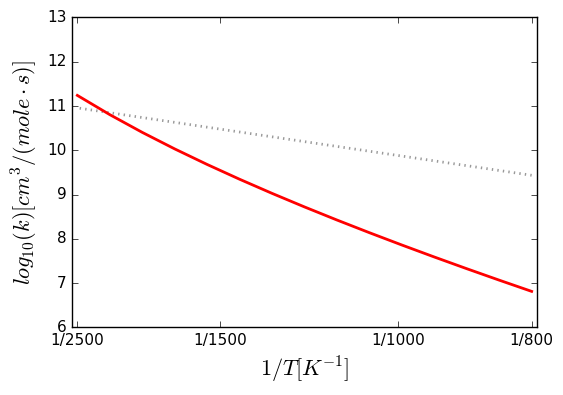


Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(371,'cm^3/(mol*s)'), n=3.28, Ea=(15500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000546978,'cm^3/(mol*s)'), n=4.56807, Ea=(48.7635,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 d

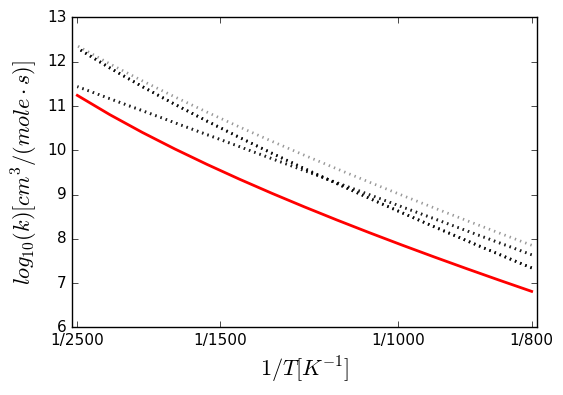


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(194,'cm^3/(mol*s)'), n=3.34, Ea=(12300,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000546978,'cm^3/(mol*s)'), n=4.56807, Ea=(48.7635,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data 

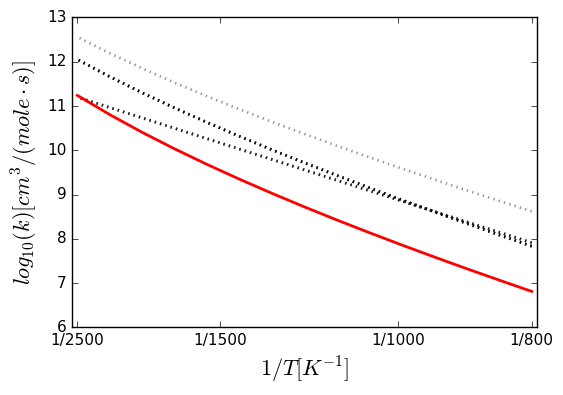


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(646500,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(388,'cm^3/(mol*s)'), n=3.34, Ea=(12300,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000546978,'cm^3/(mol*s)'), n=4.56807, Ea=(48.7635,

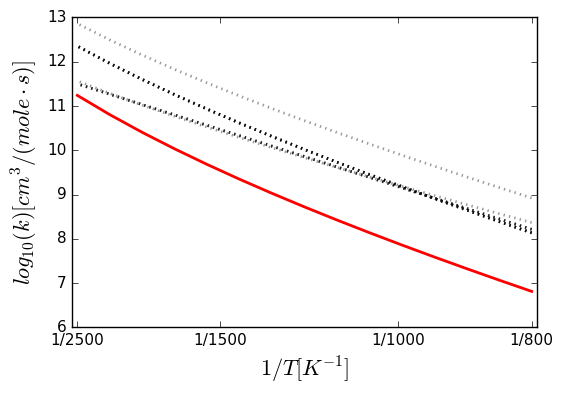


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.46682e-05,'cm^3/(mol*s)'), n=4.70816, Ea=(51.462,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.45724, dn = +|- 0.0494178, dEa = +|- 0.271847 kJ/mol""")
mbm*o + ho2 <=> mbmj*o + h2o2


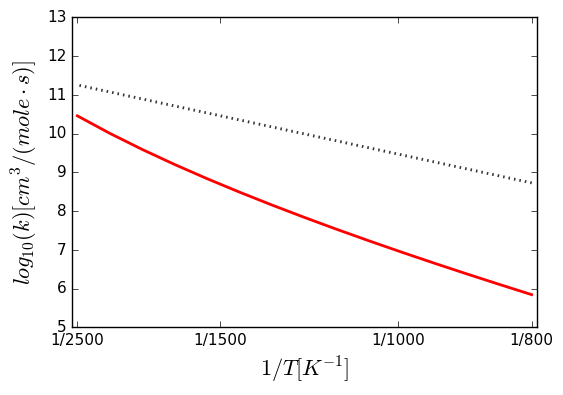


Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257374,'cm^3/(mol*s)'), n=3.86045, Ea=(-2.82061,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08485, dn = +|- 0.010689, dEa = +|- 0.0588002 kJ/mol""")
c8h18-3 + ho2 <=> c8h17-3b + h2o2


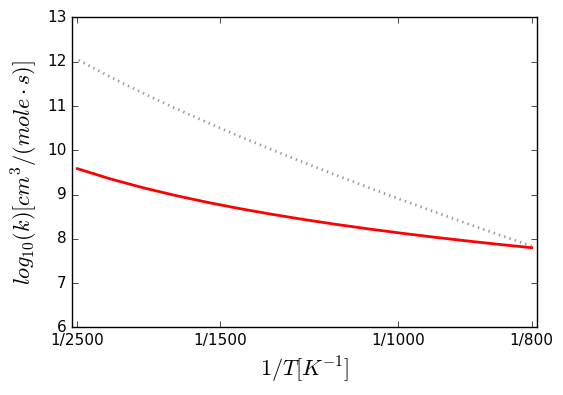


Arrhenius(A=(650,'cm^3/(mol*s)'), n=3.01, Ea=(12090,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257374,'cm^3/(mol*s)'), n=3.86045, Ea=(-2.82061,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08485, dn = +|- 0.010689, dEa = +|- 0.0588002 kJ/mol""")
c8h18-3 + ho2 <=> c8h17-3c + h2o2


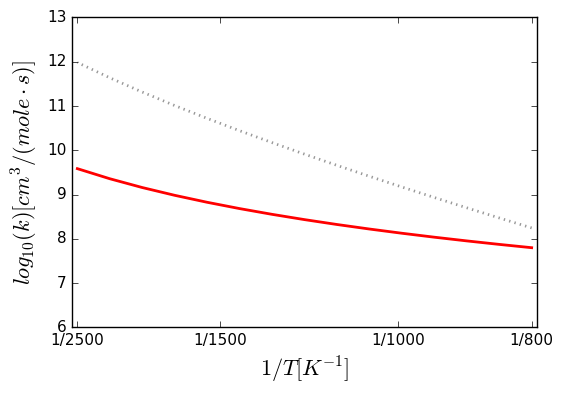


Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257374,'cm^3/(mol*s)'), n=3.86045, Ea=(-2.82061,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08485, dn = +|- 0.010689, dEa = +|- 0.0588002 kJ/mol""")
c8h18-3 + ho2 <=> c8h17-3d + h2o2


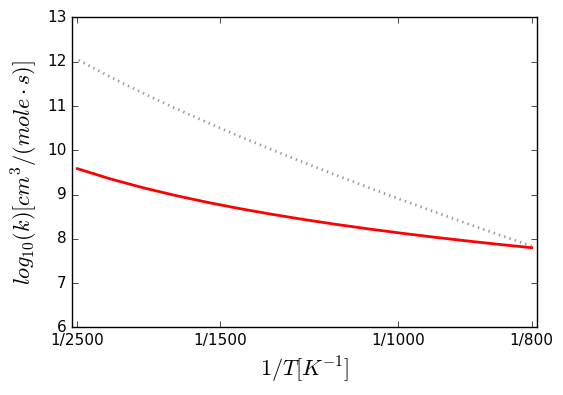


Arrhenius(A=(20.4,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257374,'cm^3/(mol*s)'), n=3.86045, Ea=(-2.82061,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08485, dn = +|- 0.010689, dEa = +|- 0.0588002 kJ/mol""")
c8h18-3 + ho2 <=> c8h17-3z + h2o2


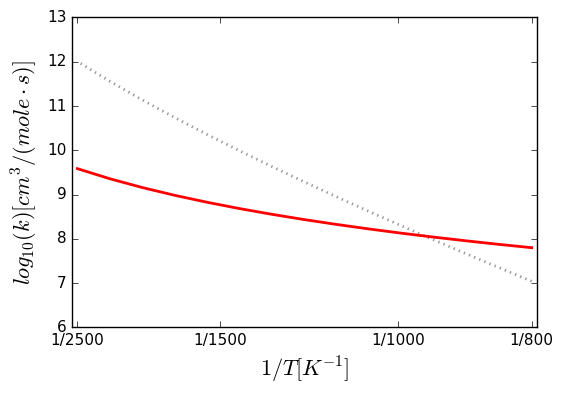


Arrhenius(A=(20.4,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257374,'cm^3/(mol*s)'), n=3.86045, Ea=(-2.82061,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08485, dn = +|- 0.010689, dEa = +|- 0.0588002 kJ/mol""")
c8h18-3 + ho2 <=> c8h17-3g + h2o2


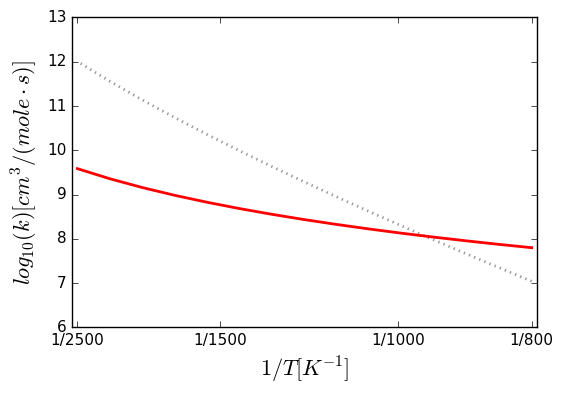


Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257374,'cm^3/(mol*s)'), n=3.86045, Ea=(-2.82061,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08485, dn = +|- 0.010689, dEa = +|- 0.0588002 kJ/mol""")
c8h18-3 + ho2 <=> c8h17-3f + h2o2


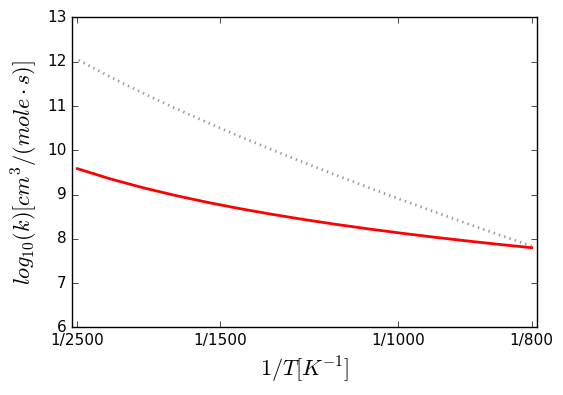


Arrhenius(A=(63.2,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257374,'cm^3/(mol*s)'), n=3.86045, Ea=(-2.82061,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08485, dn = +|- 0.010689, dEa = +|- 0.0588002 kJ/mol""")
c8h18-3 + ho2 <=> c8h17-3e + h2o2


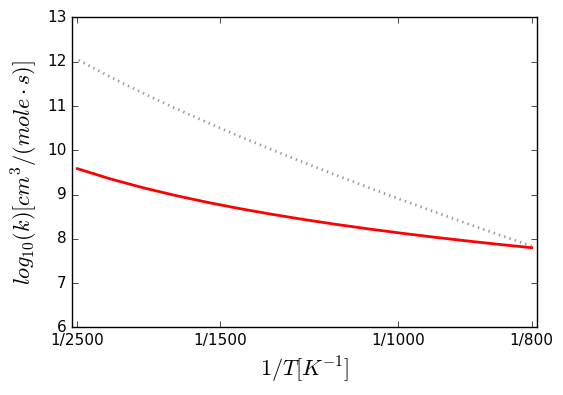


Arrhenius(A=(20.4,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000257374,'cm^3/(mol*s)'), n=3.86045, Ea=(-2.82061,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08485, dn = +|- 0.010689, dEa = +|- 0.0588002 kJ/mol""")
c8h18-3 + ho2 <=> c8h17-3a + h2o2


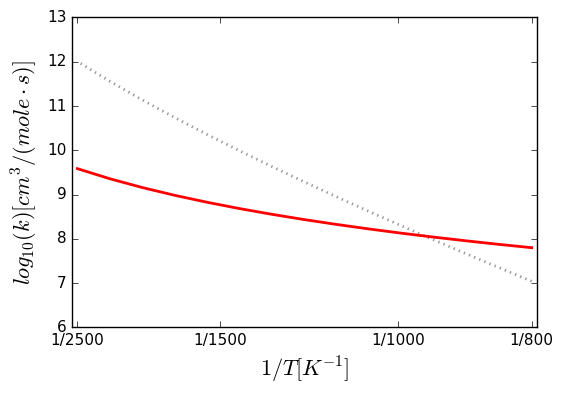


Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(-1050,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(322885,'cm^3/(mol*s)'), n=2.49786, Ea=(17.1644,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11881, dn = +|- 0.0147344, dEa = +|- 0.081054 kJ/mol""")
c8h16-5-2 + o => c2h5cho + cc5h10


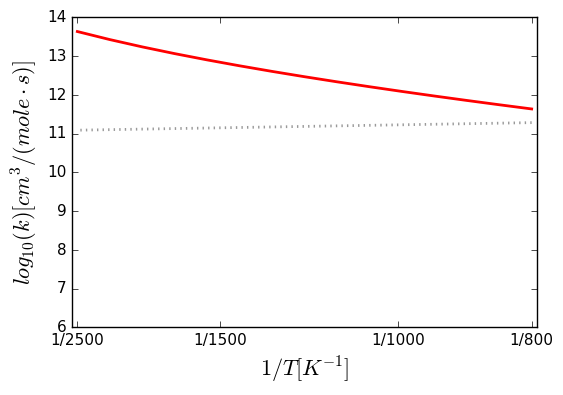


Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(-1050,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(322885,'cm^3/(mol*s)'), n=2.49786, Ea=(17.1644,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.11881, dn = +|- 0.0147344, dEa = +|- 0.081054 kJ/mol""")
c8h16-5-2 + o => ch3cho + dc6h12


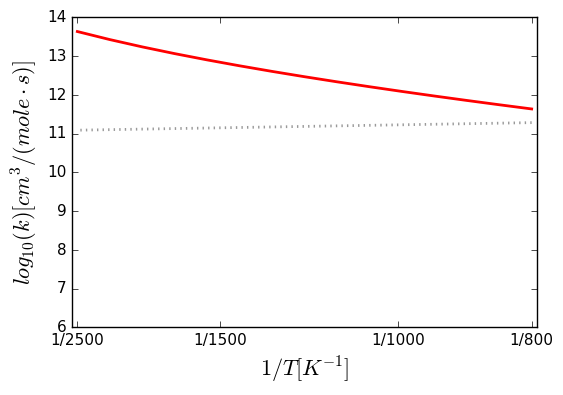


Arrhenius(A=(93300,'cm^3/(mol*s)'), n=2.5, Ea=(14684.5,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.11056e-08,'cm^3/(mol*s)'), n=5.48843, Ea=(29.4858,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.34898, dn = +|- 0.112078, dEa = +|- 0.616539 kJ/mol""")
A1CH3CHO + HO2 <=> A1CHOCH2 + H2O2


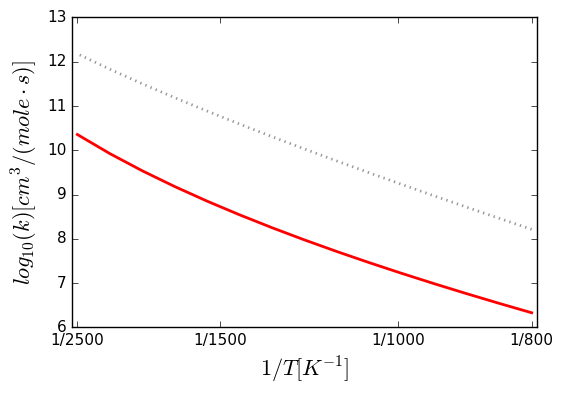


Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000539458,'cm^3/(mol*s)'), n=4.39461, Ea=(38.4294,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29432, dn = +|- 0.0338583, dEa = +|- 0.186255 kJ/mol""")
IC6H13CHO-D + HO2 <=> IC6H13CO-D + H2O2


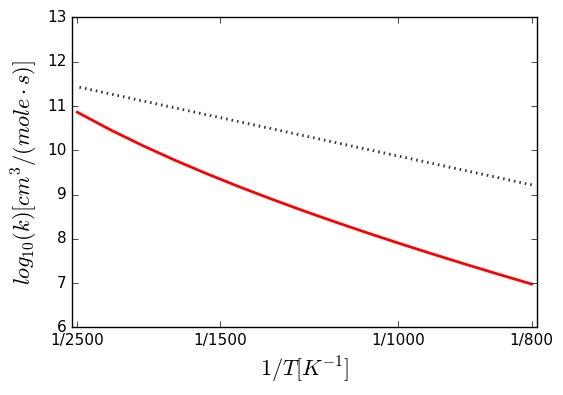


Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000539458,'cm^3/(mol*s)'), n=4.39461, Ea=(38.4294,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29432, dn = +|- 0.0338583, dEa = +|- 0.186255 kJ/mol""")
IC6H13CHO-D + HO2 <=> DC6H12CHO-D + H2O2


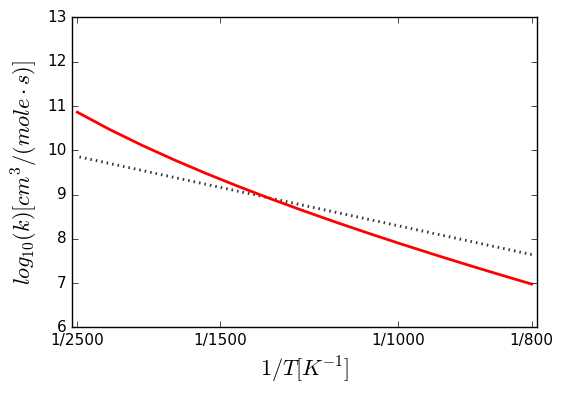


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000539458,'cm^3/(mol*s)'), n=4.39461, Ea=(38.4294,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29432, dn = +|- 0.0338583, dEa = +|- 0.186255 kJ/mol""")
IC6H13CHO-D + HO2 <=> CC6H12CHO-D + H2O2


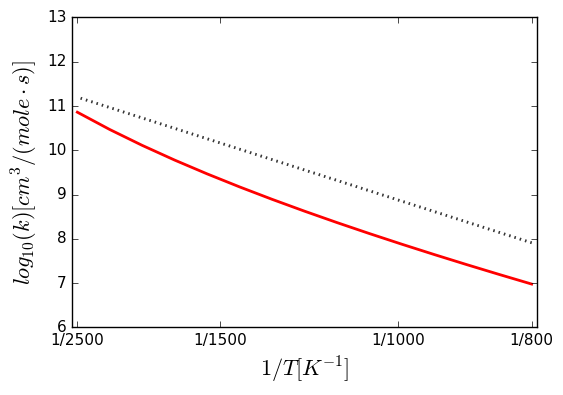


Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000539458,'cm^3/(mol*s)'), n=4.39461, Ea=(38.4294,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29432, dn = +|- 0.0338583, dEa = +|- 0.186255 kJ/mol""")
IC6H13CHO-D + HO2 <=> EC6H12CHO-D + H2O2


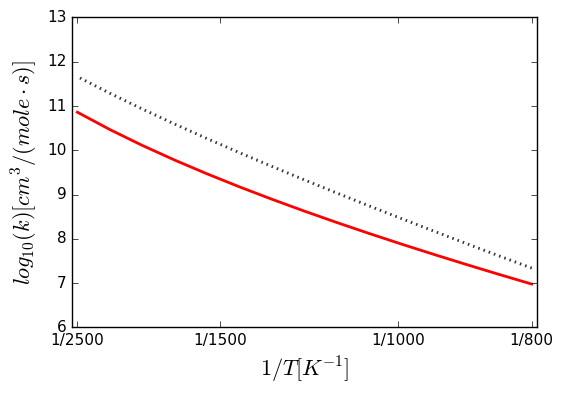


Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000539458,'cm^3/(mol*s)'), n=4.39461, Ea=(38.4294,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29432, dn = +|- 0.0338583, dEa = +|- 0.186255 kJ/mol""")
IC6H13CHO-D + HO2 <=> BC6H12CHO-D + H2O2


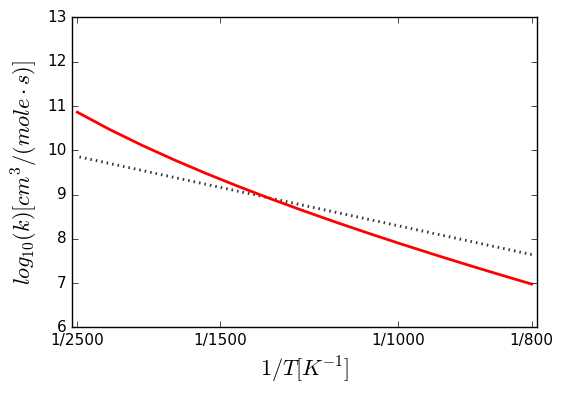


Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000539458,'cm^3/(mol*s)'), n=4.39461, Ea=(38.4294,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.29432, dn = +|- 0.0338583, dEa = +|- 0.186255 kJ/mol""")
IC6H13CHO-D + HO2 <=> AC6H12CHO-D + H2O2


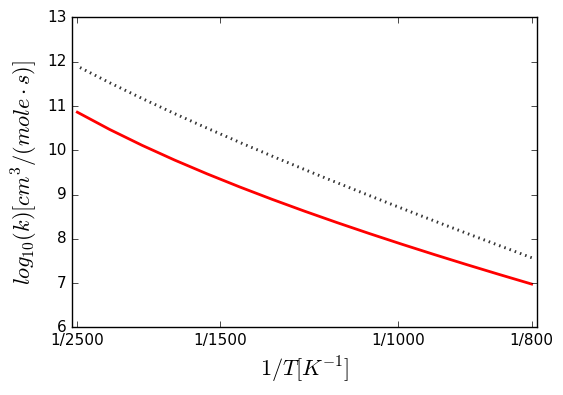


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.51384e-08,'cm^3/(mol*s)'), n=5.53722, Ea=(18.9209,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.47981, dn = +|- 0.119191, dEa = +|- 0.655669 kJ/mol""")
mf25j + ho2 <=> mf25oj + oh


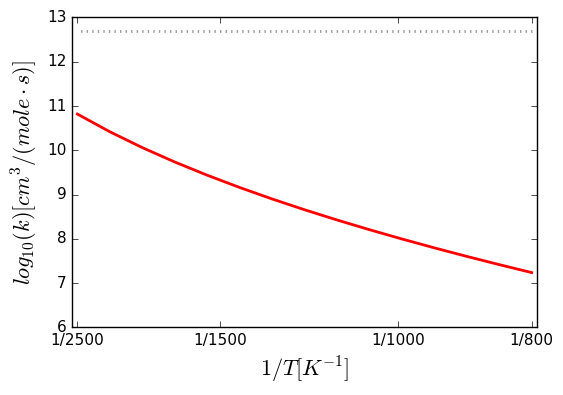


Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(17060,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.87713e-08,'cm^3/(mol*s)'), n=5.75789, Ea=(26.0319,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.96685, dn = +|- 0.142725, dEa = +|- 0.785129 kJ/mol""")
THP-2-ene + HO2 <=> THP-234-enyl + H2O2


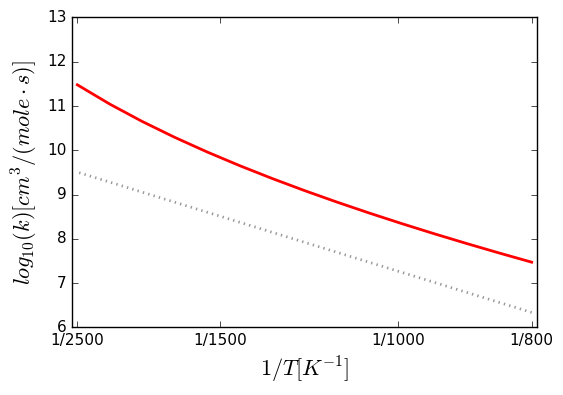


Arrhenius(A=(1510,'cm^3/(mol*s)'), n=2.85, Ea=(10890,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5242.83,'cm^3/(mol*s)'), n=2.88155, Ea=(27.5802,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.54154, dn = +|- 0.0567986, dEa = +|- 0.312449 kJ/mol""")
BC8H17 + H2 <=> IC8H18 + H


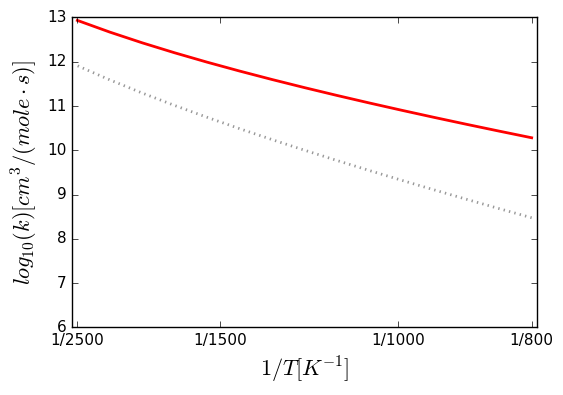


Arrhenius(A=(602000,'cm^3/(mol*s)'), n=2.4, Ea=(2583,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(602000,'cm^3/(mol*s)'), n=2.4, Ea=(2583,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.166e+07,'cm^3/(mol*s)'), n=2, Ea=(3950.57,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(602000,'cm^3/(mol*s)'), n=2.4, Ea=(2583,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(602000,'cm^3/(mol*s)'), n=2.4, Ea=(2583,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(602000,'cm^3/(mol*s)'), n=2.4, Ea=(2583,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5242.83,'cm^3/(mol*s)'), n=2.88155, Ea=(27.5802,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.54154, dn = +|- 0.0567986, dEa = +|- 0.312449 kJ/mol""")
IC8H18 + H <=> CC8H17 + H2


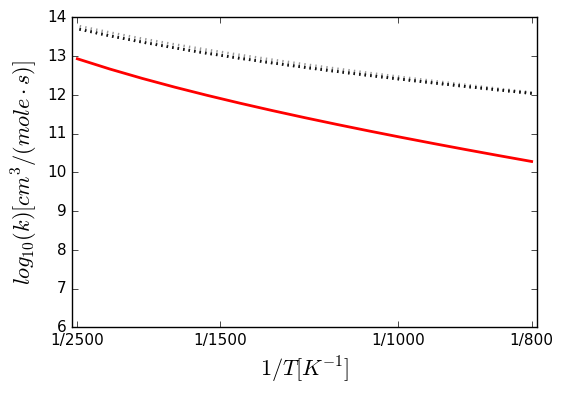


Arrhenius(A=(734100,'cm^3/(mol*s)'), n=2.768, Ea=(8147,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(734100,'cm^3/(mol*s)'), n=2.768, Ea=(8147,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(734100,'cm^3/(mol*s)'), n=2.768, Ea=(8147,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(734100,'cm^3/(mol*s)'), n=2.768, Ea=(8147,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(734000,'cm^3/(mol*s)'), n=2.77, Ea=(8147,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5242.83,'cm^3/(mol*s)'), n=2.88155, Ea=(27.5802,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.54154, dn = +|- 0.0567986, dEa = +|- 0.312449 kJ/mol""")
IC8H18 + H <=> AC8H17 + H2


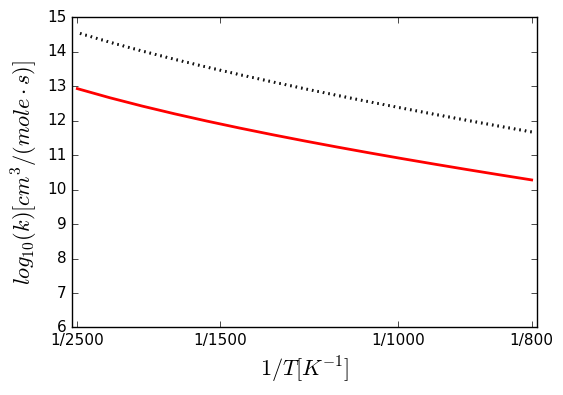


Arrhenius(A=(188000,'cm^3/(mol*s)'), n=2.75, Ea=(6280,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(188000,'cm^3/(mol*s)'), n=2.75, Ea=(6280,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(51.5,'cm^3/(mol*s)'), n=3.92, Ea=(2428.3,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(188000,'cm^3/(mol*s)'), n=2.75, Ea=(6280,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(188000,'cm^3/(mol*s)'), n=2.75, Ea=(6280,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(188000,'cm^3/(mol*s)'), n=2.75, Ea=(6280,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5242.83,'cm^3/(mol*s)'), n=2.88155, Ea=(27.5802,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.54154, dn = +|- 0.0567986, dEa = +|- 0.312449 kJ/mol""")
IC8H18 + H <=> DC8H17 + H2


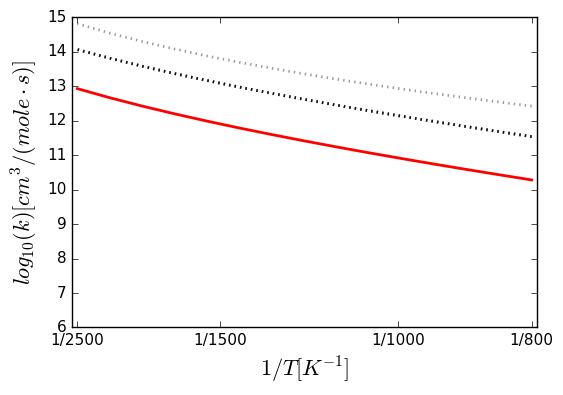


Arrhenius(A=(573600,'cm^3/(mol*s)'), n=2.491, Ea=(4124,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(573600,'cm^3/(mol*s)'), n=2.491, Ea=(4124,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(573600,'cm^3/(mol*s)'), n=2.491, Ea=(4124,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(574000,'cm^3/(mol*s)'), n=2.49, Ea=(4124,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5242.83,'cm^3/(mol*s)'), n=2.88155, Ea=(27.5802,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.54154, dn = +|- 0.0567986, dEa = +|- 0.312449 kJ/mol""")
IC8H18 + H <=> BC8H17 + H2


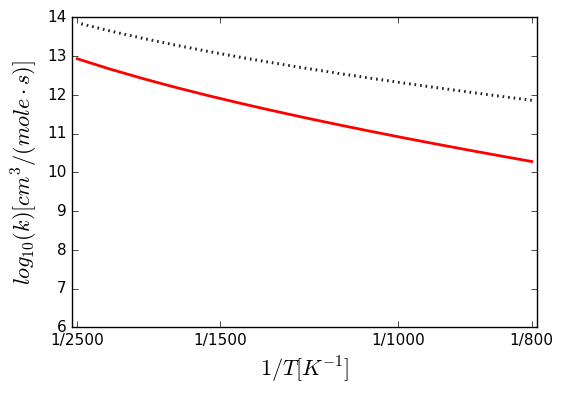


Arrhenius(A=(2410,'cm^3/(mol*s)'), n=3.78, Ea=(3652,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00802742,'cm^3/(mol*s)'), n=3.97344, Ea=(51.4742,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08142, dn = +|- 0.010273, dEa = +|- 0.056512 kJ/mol""")
PC2H4COC2H3 + H2O2 <=> C2H5COC2H3 + HO2


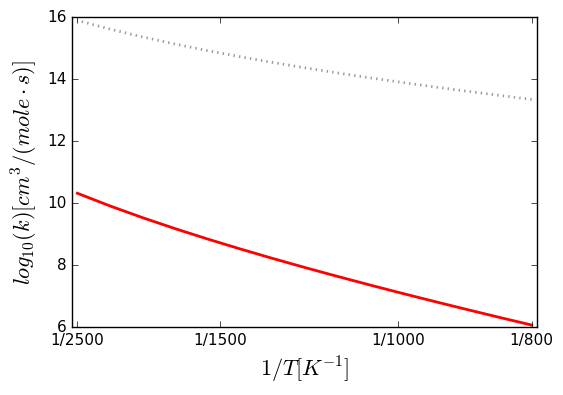


Arrhenius(A=(9000,'cm^3/(mol*s)'), n=2.5, Ea=(23590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00802742,'cm^3/(mol*s)'), n=3.97344, Ea=(51.4742,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08142, dn = +|- 0.010273, dEa = +|- 0.056512 kJ/mol""")
evk + ho2 <=> evjk-s + h2o2


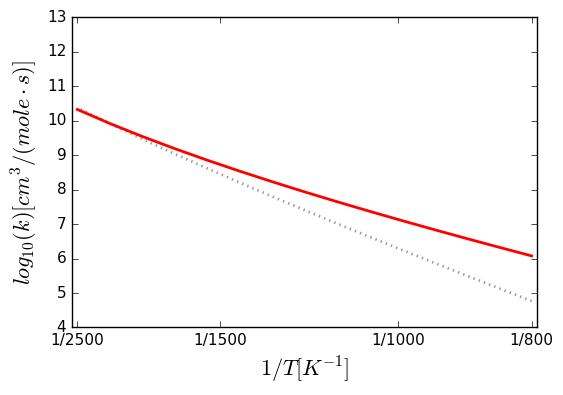


Arrhenius(A=(18000,'cm^3/(mol*s)'), n=2.5, Ea=(27620,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.65e+14,'cm^3/(mol*s)'), n=0, Ea=(30400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00802742,'cm^3/(mol*s)'), n=3.97344, Ea=(51.4742,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.08142, dn = +|- 0.010273, dEa = +|- 0.056512 kJ/mol""")
evk + ho2 <=> evjk-p + h2o2


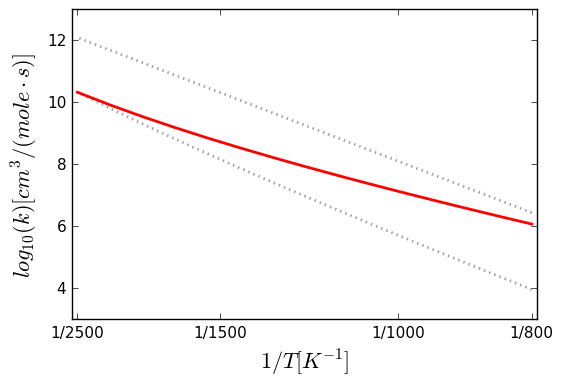


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(20.4,'cm^3/(mol*s)'), n=3.6, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00802742,'cm^3/(mol*s)'), n=3.97344, Ea=(51.4742,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to

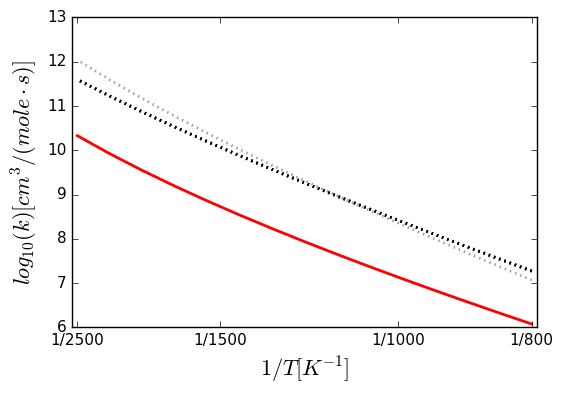


Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.58e+12,'cm^3/(mol*s)'), n=0.02, Ea=(16565.4,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00802742,'cm^3/(mol*s)'), n=3.97344, Ea=(51.4742,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K

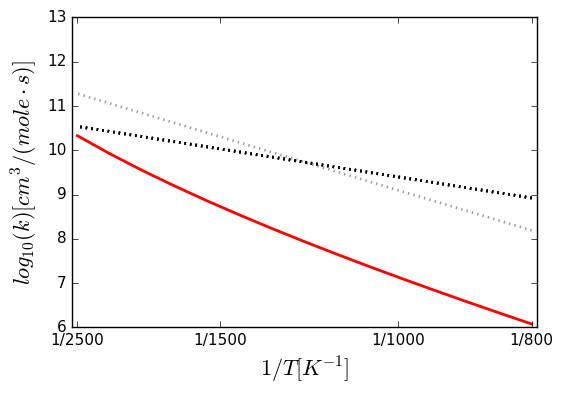


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10500,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.01776e-09,'cm^3/(mol*s)'), n=5.76582, Ea=(15.8912,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.88016, dn = +|- 0.138833, dEa = +|- 0.763719 kJ/mol""")
O*CY(COC(C)*CC) + HO2 <=> O*CY(COC*(C)CCJ) + H2O2


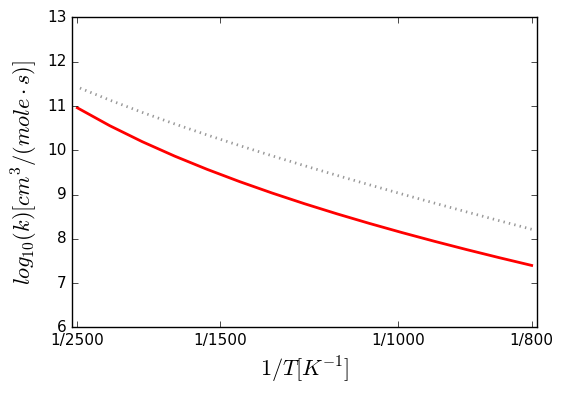


Arrhenius(A=(4e+12,'cm^3/(mol*s)'), n=0, Ea=(17057,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000361794,'cm^3/(mol*s)'), n=4.67589, Ea=(51.9521,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.43309, dn = +|- 0.047225, dEa = +|- 0.259785 kJ/mol""")
THP + HO2 <=> THP-2-yl + H2O2


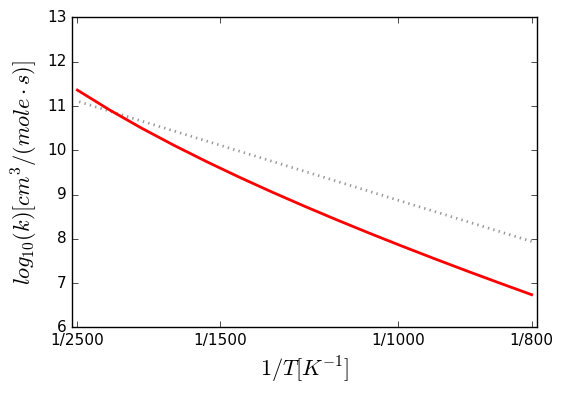


Arrhenius(A=(4e+12,'cm^3/(mol*s)'), n=0, Ea=(17057,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000361794,'cm^3/(mol*s)'), n=4.67589, Ea=(51.9521,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.43309, dn = +|- 0.047225, dEa = +|- 0.259785 kJ/mol""")
THP + HO2 <=> THP-3-yl + H2O2


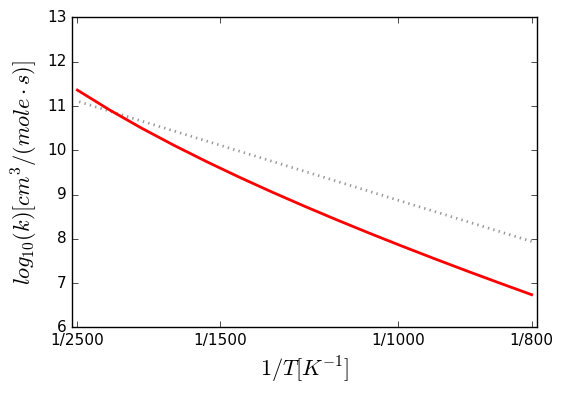


Arrhenius(A=(2e+12,'cm^3/(mol*s)'), n=0, Ea=(17057,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000361794,'cm^3/(mol*s)'), n=4.67589, Ea=(51.9521,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.43309, dn = +|- 0.047225, dEa = +|- 0.259785 kJ/mol""")
THP + HO2 <=> THP-4-yl + H2O2


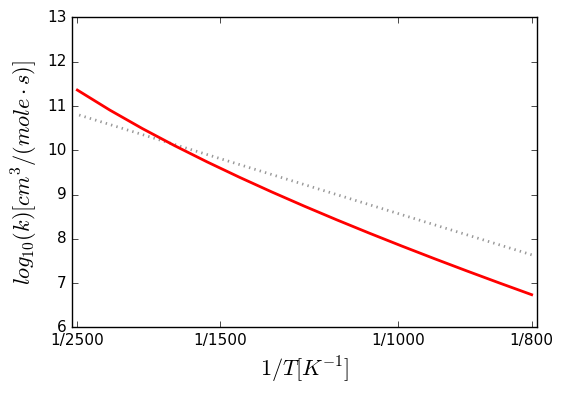


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00010681,'cm^3/(mol*s)'), n=4.67591, Ea=(47.0258,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.38406, dn = +|- 0.0426559, dEa = +|- 0.23465 kJ/mol""")
NC8H18 + HO2 <=> C8H17-3 + H2O2


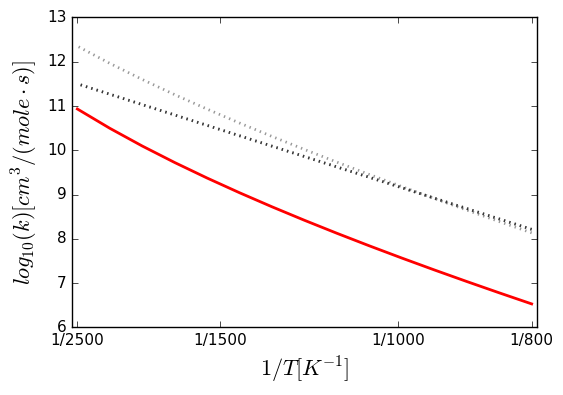


Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(40.8,'cm^3/(mol*s)'), n=3.59, Ea=(17160,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20440,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00010681,'cm^3/(mol*s)'), n=4.67591, Ea=(47.0258,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.38406, dn = +|- 0.0426559, dEa = +|- 0.23465 kJ/mol""")
NC8H18 + HO2 <=> C8H17-1 + H2O2


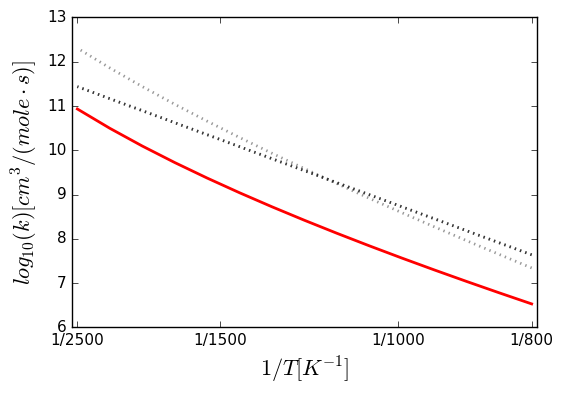


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00010681,'cm^3/(mol*s)'), n=4.67591, Ea=(47.0258,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.38406, dn = +|- 0.0426559, dEa = +|- 0.23465 kJ/mol""")
NC8H18 + HO2 <=> C8H17-4 + H2O2


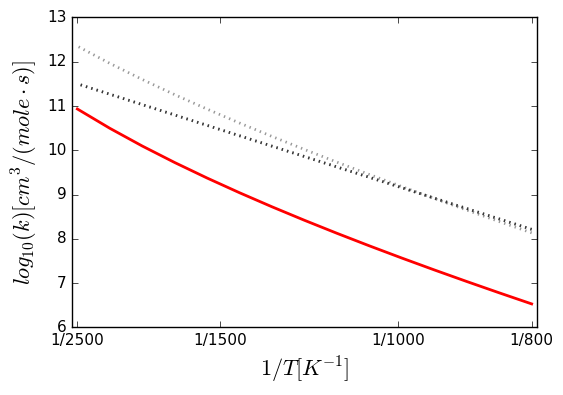


Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(126.4,'cm^3/(mol*s)'), n=3.37, Ea=(13720,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.12e+13,'cm^3/(mol*s)'), n=0, Ea=(17690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00010681,'cm^3/(mol*s)'), n=4.67591, Ea=(47.0258,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.38406, dn = +|- 0.0426559, dEa = +|- 0.23465 kJ/mol""")
NC8H18 + HO2 <=> C8H17-2 + H2O2


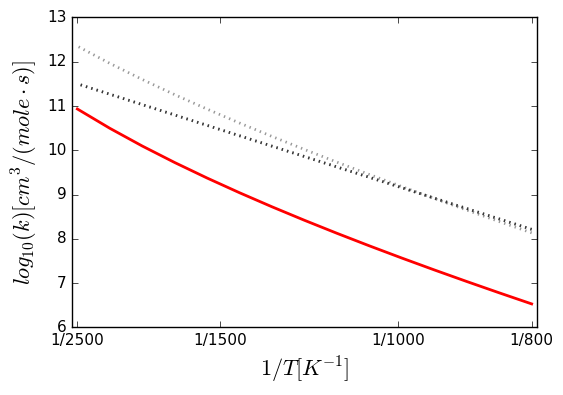


Arrhenius(A=(5.09e-09,'cm^3/(mol*s)'), n=-0.01, Ea=(18180,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.04831e-05,'cm^3/(mol*s)'), n=4.77037, Ea=(51.0624,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51658, dn = +|- 0.0546563, dEa = +|- 0.300665 kJ/mol""")
C7H14-3 + HO2 <=> C7H15-3 + O2


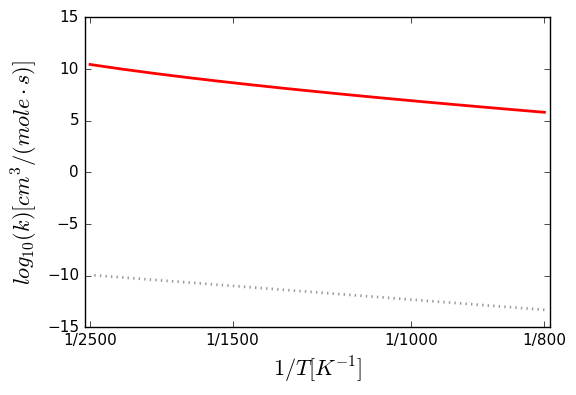


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.04831e-05,'cm^3/(mol*s)'), n=4.77037, Ea=(51.0624,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51658, dn = +|- 0.0546563, dEa = +|- 0.300665 kJ/mol""")
C7H14-3 + HO2 <=> C7H132-4 + H2O2


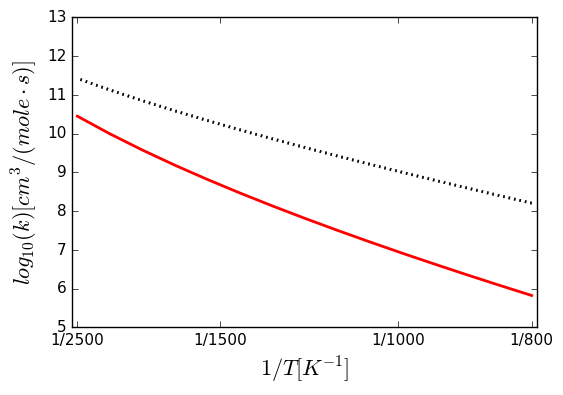


Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.04831e-05,'cm^3/(mol*s)'), n=4.77037, Ea=(51.0624,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51658, dn = +|- 0.0546563, dEa = +|- 0.300665 kJ/mol""")
C7H14-3 + HO2 <=> C7H133-1 + H2O2


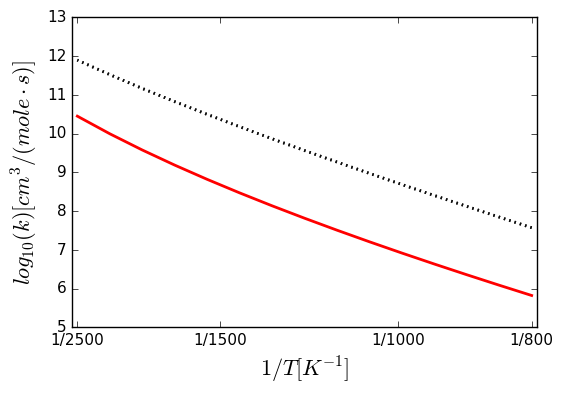


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.04831e-05,'cm^3/(mol*s)'), n=4.77037, Ea=(51.0624,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51658, dn = +|- 0.0546563, dEa = +|- 0.300665 kJ/mol""")
C7H14-3 + HO2 <=> C7H133-5 + H2O2


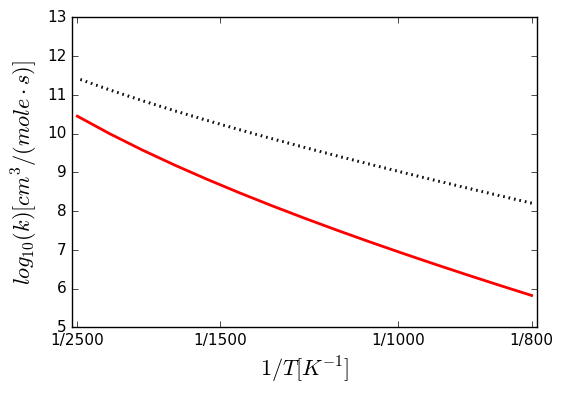


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.04831e-05,'cm^3/(mol*s)'), n=4.77037, Ea=(51.0624,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51658, dn = +|- 0.0546563, dEa = +|- 0.300665 kJ/mol""")
C7H14-3 + HO2 <=> C7H133-6 + H2O2


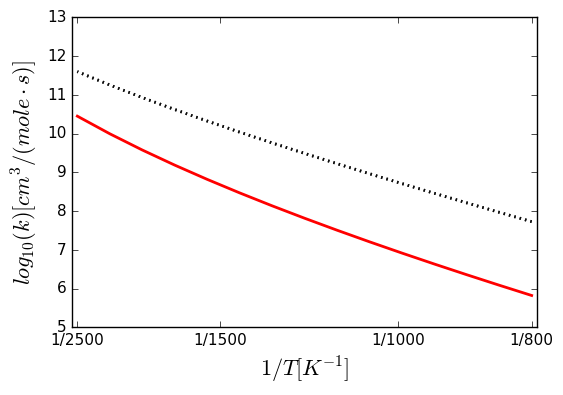


Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(47600,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.04831e-05,'cm^3/(mol*s)'), n=4.77037, Ea=(51.0624,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51658, dn = +|- 0.0546563, dEa = +|- 0.300665 kJ/mol""")
C7H14-3 + HO2 <=> C7H133-7 + H2O2


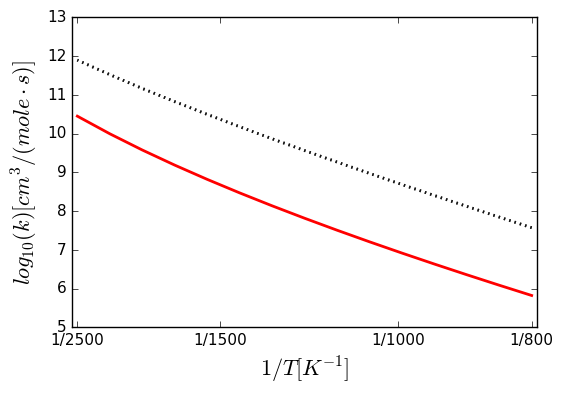


Arrhenius(A=(5.11e-09,'cm^3/(mol*s)'), n=-0.01, Ea=(18180,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.04831e-05,'cm^3/(mol*s)'), n=4.77037, Ea=(51.0624,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.51658, dn = +|- 0.0546563, dEa = +|- 0.300665 kJ/mol""")
C7H14-3 + HO2 <=> C7H15-4 + O2


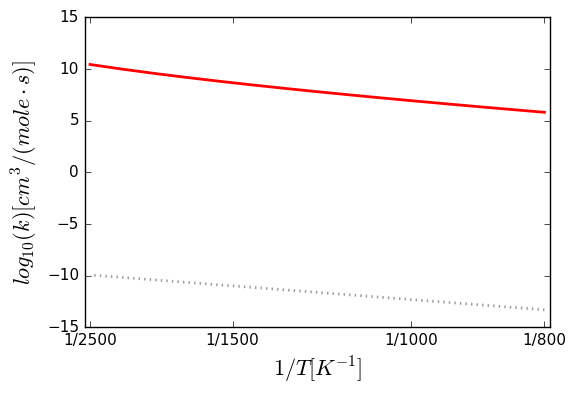


Arrhenius(A=(4.33e+11,'cm^3/(mol*s)'), n=0.01, Ea=(8175,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0035804,'cm^3/(mol*s)'), n=3.97903, Ea=(-1.53334,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.10314, dn = +|- 0.0128825, dEa = +|- 0.0708666 kJ/mol""")
PC7H15 + H2O2 <=> NEOC7H16 + HO2


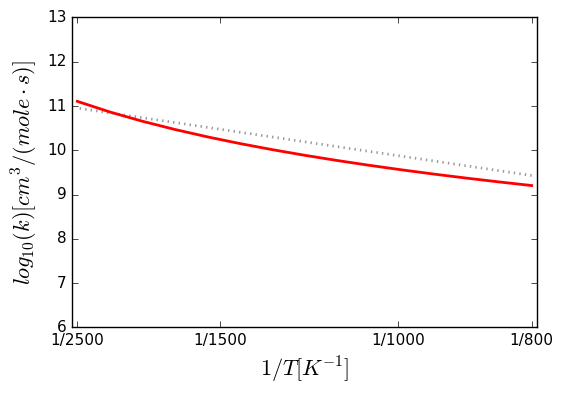


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.19112e-08,'cm^3/(mol*s)'), n=5.11374, Ea=(15.679,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.80288, dn = +|- 0.0773512, dEa = +|- 0.425509 kJ/mol""")
c8h17oo-2-2 + h2o2 <=> c8h17ooh-2-2 + ho2


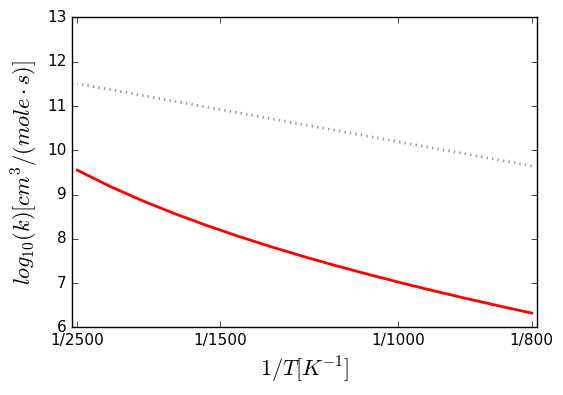


Arrhenius(A=(2.82e+11,'cm^3/(mol*s)'), n=0.07, Ea=(8112,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000111658,'cm^3/(mol*s)'), n=4.32711, Ea=(2.76605,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.31046, dn = +|- 0.0354847, dEa = +|- 0.195201 kJ/mol""")
C4H8COCH3-3 + H2O2 <=> NC4H9COCH3 + HO2


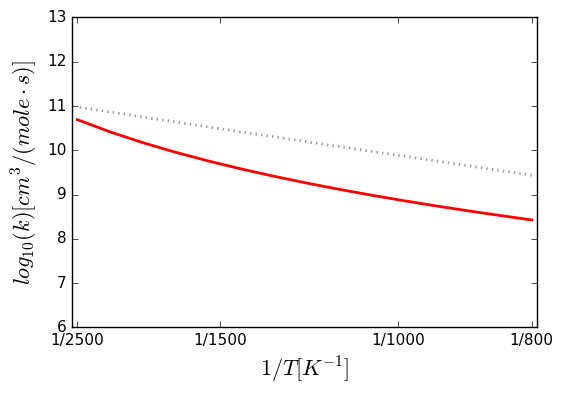


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000411339,'cm^3/(mol*s)'), n=3.79546, Ea=(0.501559,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.03351, dn = +|- 0.00432633, dEa = +|- 0.0237991 kJ/mol""")
mb3oo + h2o2 => mb3ooh + ho2


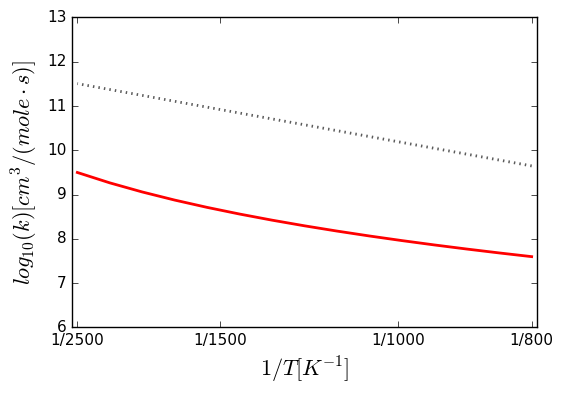


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000411339,'cm^3/(mol*s)'), n=3.79546, Ea=(0.501559,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.03351, dn = +|- 0.00432633, dEa = +|- 0.0237991 kJ/mol""")
mb3ooh + ho2 => mb3oo + h2o2


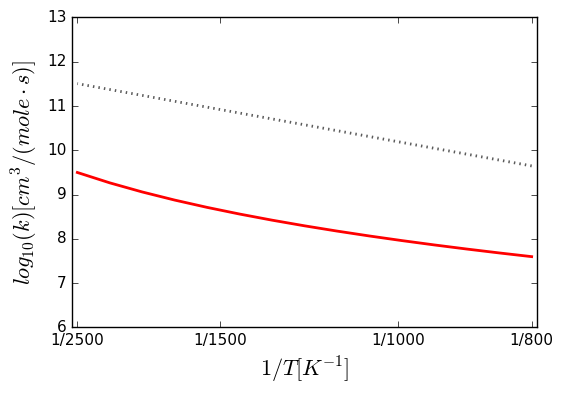


Arrhenius(A=(101000,'cm^3/(mol*s)'), n=2, Ea=(6335.02,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(101000,'cm^3/(mol*s)'), n=2, Ea=(6335.02,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(101000,'cm^3/(mol*s)'), n=2, Ea=(6335.02,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.59731e-06,'cm^3/(mol*s)'), n=4.88218, Ea=(7.73744,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.80424, dn = +|- 0.0774509, dEa = +|- 0.426057 kJ/mol""")
HCO + H2O2 => CH2O + HO2


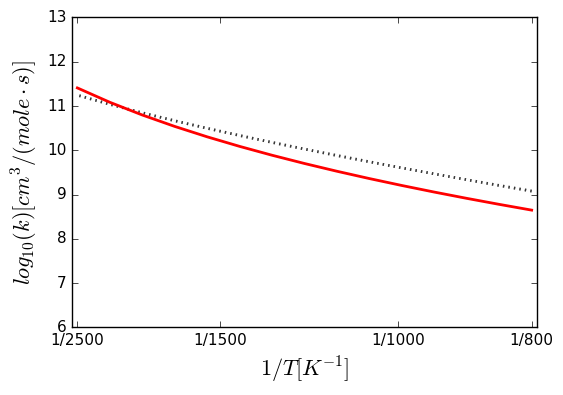


Arrhenius(A=(18800,'cm^3/(mol*s)'), n=2.7, Ea=(11520,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18800,'cm^3/(mol*s)'), n=2.7, Ea=(11520,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.01e+12,'cm^3/(mol*s)'), n=0, Ea=(54713.1,'J/mol'), T0=(1,'K'))
Arrhenius(A=(18800,'cm^3/(mol*s)'), n=2.7, Ea=(11520,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(41100,'cm^3/(mol*s)'), n=2.5, Ea=(10210,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0071,'cm^3/(mol*s)'), n=4.517, Ea=(6580,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(41100,'cm^3/(mol*s)'), n=2.5, Ea=(10210,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(8000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(8000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18800,'cm^3/(mol*s)'), n=2.7, Ea=(11520,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(18800,'cm^3/(mol*s)'), n=2.7, Ea=(11520,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(41240,'cm^3/(mol*s)'), n=2.5, Ea=(10200,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(8000,'cal/mol'), T0=(1,'K'))
Arrh

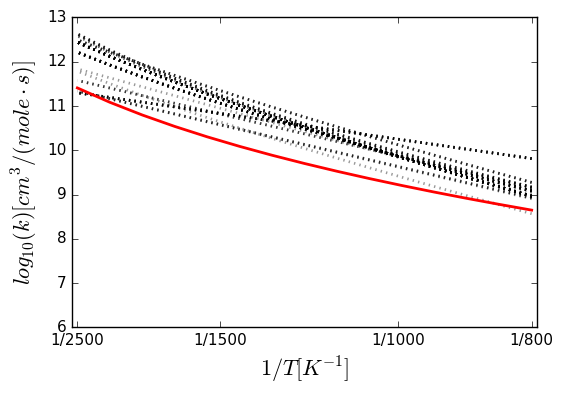


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0194118,'cm^3/(mol*s)'), n=3.83268, Ea=(38.5247,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06373, dn = +|- 0.00810811, dEa = +|- 0.0446027 kJ/mol""")
COCOC*O + HO2 <=> COCOCj*O + H2O2


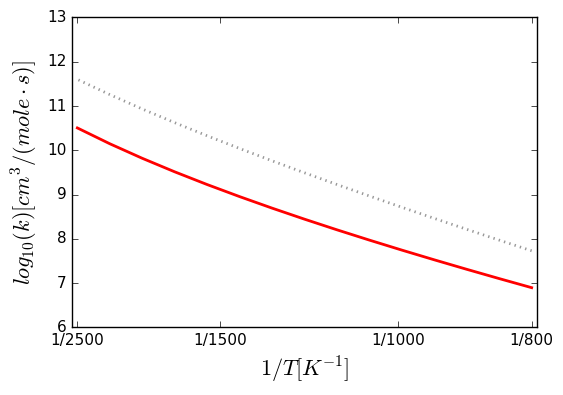


Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(20430,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0194118,'cm^3/(mol*s)'), n=3.83268, Ea=(38.5247,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06373, dn = +|- 0.00810811, dEa = +|- 0.0446027 kJ/mol""")
COCOC*O + HO2 <=> CjOCOC*O + H2O2


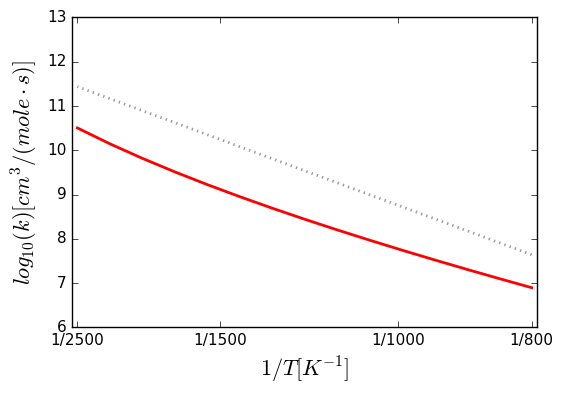


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0194118,'cm^3/(mol*s)'), n=3.83268, Ea=(38.5247,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.06373, dn = +|- 0.00810811, dEa = +|- 0.0446027 kJ/mol""")
COCOC*O + HO2 <=> COCjOC*O + H2O2


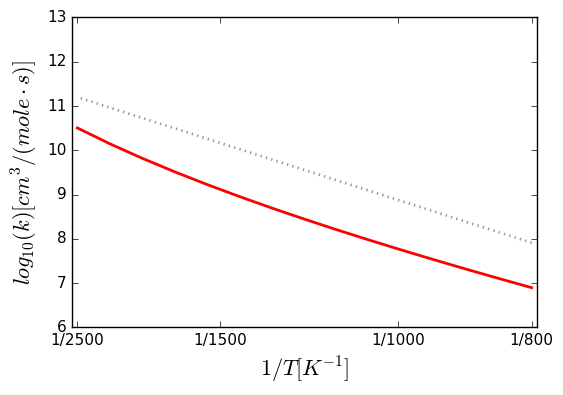


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.78341e-09,'cm^3/(mol*s)'), n=5.21558, Ea=(15.8998,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.94005, dn = +|- 0.0869754, dEa = +|- 0.478452 kJ/mol""")
c8h17oo-6-2 + h2o2 <=> c8h17ooh-6-2 + ho2


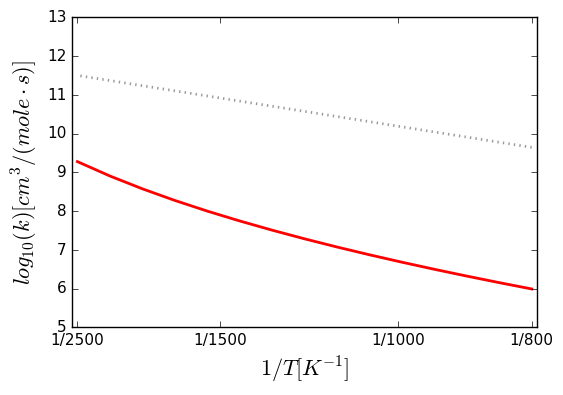


Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(16000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(16000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.53379e-06,'cm^3/(mol*s)'), n=4.97408, Ea=(11.0182,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.97487, dn = +|- 0.0893101, dEa = +|- 0.491295 kJ/mol""")
pc3h4 + ho2 <=> ch3co + ch2o


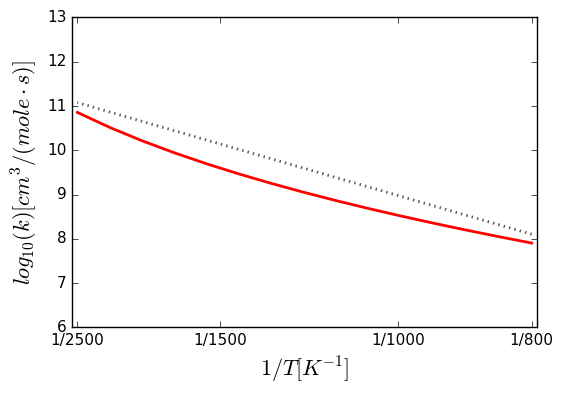


Arrhenius(A=(0.0955,'cm^3/(mol*s)'), n=4.17, Ea=(9632.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(130,'cm^3/(mol*s)'), n=3.37, Ea=(15913,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(130,'cm^3/(mol*s)'), n=3.37, Ea=(15913,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.233e+06,'cm^3/(mol*s)'), n=2, Ea=(18492,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9600,'cm^3/(mol*s)'), n=2.6, Ea=(13900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9600,'cm^3/(mol*s)'), n=2.6, Ea=(13900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+11,'cm^3/(mol*s)'), n=0, Ea=(19000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+11,'cm^3/(mol*s)'), n=0, Ea=(19000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(130,'cm^3/(mol*s)'), n=3.37, Ea=(15913,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0955,'cm^3/(mol*s)'), n=4.17, Ea=(9632.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0955,'cm^3/(mol*s)'), n=4.17, Ea=(9632.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0955,'cm^3/(mol*s)'), n=4.17, Ea=(9632.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.233e+06,'cm^3/(mol*s)'), n=2, Ea=(18492,'cal/mol'), T0=

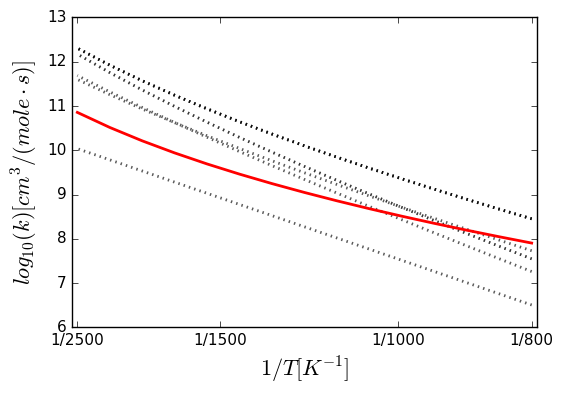


Arrhenius(A=(21600,'cm^3/(mol*s)'), n=2, Ea=(9542.01,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(21600,'cm^3/(mol*s)'), n=2, Ea=(9542.01,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.53379e-06,'cm^3/(mol*s)'), n=4.97408, Ea=(11.0182,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.97487, dn = +|- 0.0893101, dEa = +|- 0.491295 kJ/mol""")
C3H3 + H2O2 => AC3H4 + HO2


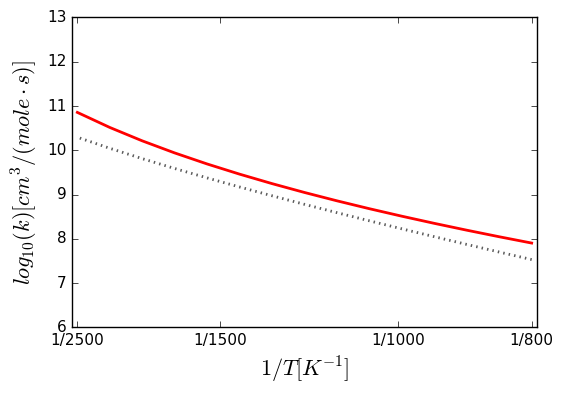


Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5e+12,'cm^3/(mol*s)'), n=0, Ea=(15000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.53379e-06,'cm^3/(mol*s)'), n=4.97408, Ea=(11.0182,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.97487, dn = +|- 0.0893101, dEa = +|- 0.491295 kJ/mol""")
HO2 + PC3H4 => O2 + CHCHCH3


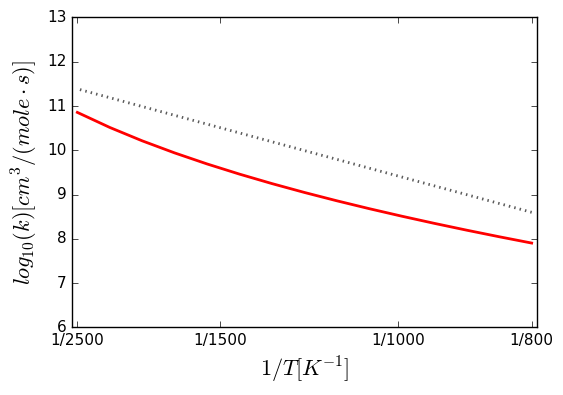


Arrhenius(A=(4.5e+12,'cm^3/(mol*s)'), n=0, Ea=(16000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.5e+12,'cm^3/(mol*s)'), n=0, Ea=(16000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.53379e-06,'cm^3/(mol*s)'), n=4.97408, Ea=(11.0182,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.97487, dn = +|- 0.0893101, dEa = +|- 0.491295 kJ/mol""")
pc3h4 + ho2 <=> ch3cho + hco


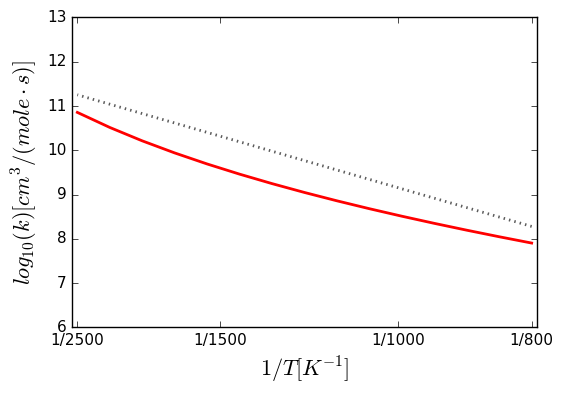


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K')

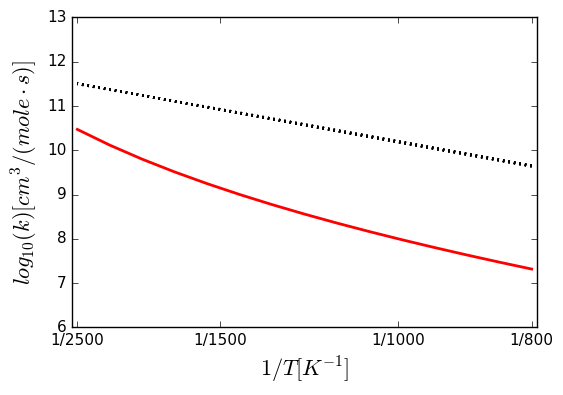


Arrhenius(A=(13000,'cm^3/(mol*s)'), n=2.6, Ea=(12428.3,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.98748e-08,'cm^3/(mol*s)'), n=5.68272, Ea=(24.415,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.65018, dn = +|- 0.127911, dEa = +|- 0.703638 kJ/mol""")
C8H142-6 + HO2 <=> C8H132-6,SA + H2O2


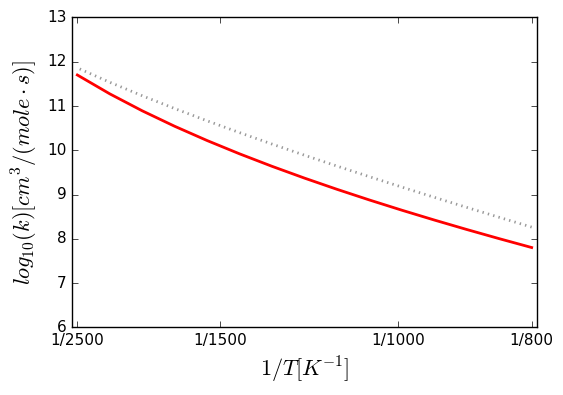


Arrhenius(A=(19000,'cm^3/(mol*s)'), n=2.6, Ea=(13862.3,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.98748e-08,'cm^3/(mol*s)'), n=5.68272, Ea=(24.415,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.65018, dn = +|- 0.127911, dEa = +|- 0.703638 kJ/mol""")
C8H142-6 + HO2 <=> C8H132-6,PA + H2O2


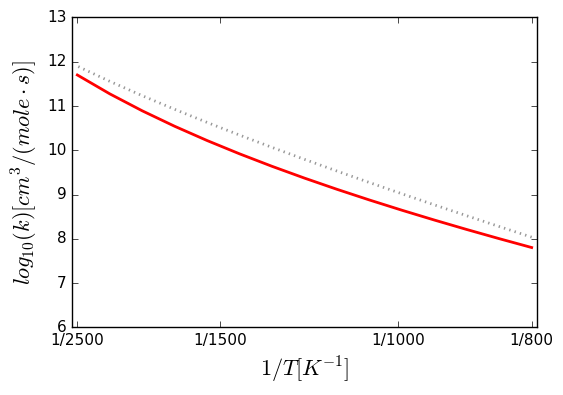


Arrhenius(A=(567,'cm^3/(mol*s)'), n=2.65, Ea=(4342,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000426369,'cm^3/(mol*s)'), n=3.8768, Ea=(-3.04057,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.07076, dn = +|- 0.00897229, dEa = +|- 0.0493566 kJ/mol""")
C4H8CHO3-2 + H2O2 <=> NC4H9CHO-2 + HO2


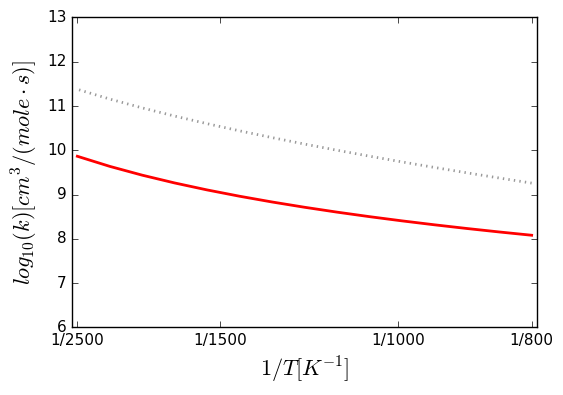


Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(700,'cm^3/(mol*s)'), n=3, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+12,'cm^3/(mol*s)'), n=0, Ea=(11000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+12,'cm^3/(mol*s)'), n=0, Ea=(11665,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00025785,'cm^3/(mol*s)'), n=4.55198, Ea=(23.1278,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.4523, dn = +|- 0.0489719, dEa = +|- 0.269395 kJ/mol""")
PHHCO + HO2 <=> PHCO + H2O2


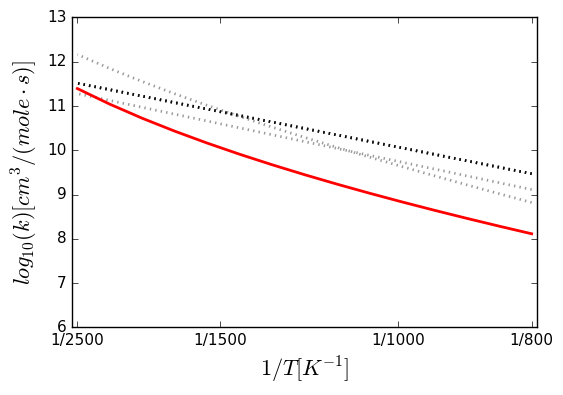


Arrhenius(A=(1.8e+11,'cm^3/(mol*s)'), n=0, Ea=(8226,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8e+11,'cm^3/(mol*s)'), n=0, Ea=(8226,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.8e+11,'cm^3/(mol*s)'), n=0, Ea=(8226,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00025785,'cm^3/(mol*s)'), n=4.55198, Ea=(23.1278,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.4523, dn = +|- 0.0489719, dEa = +|- 0.269395 kJ/mol""")
C6H5CO + H2O2 <=> C6H5CHO + HO2


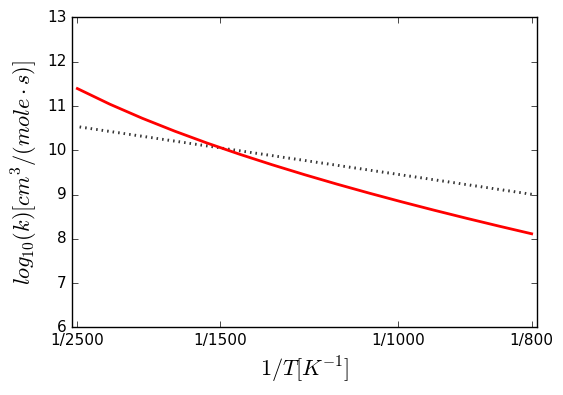


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'

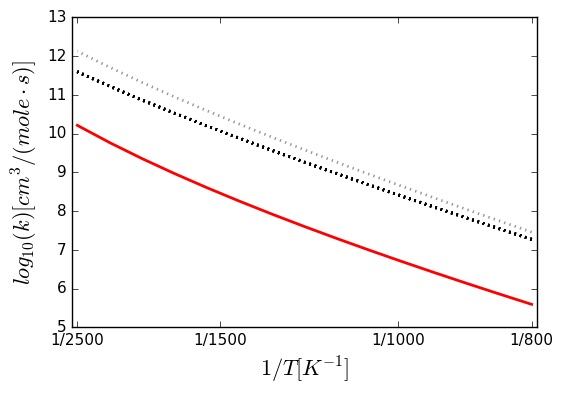


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A

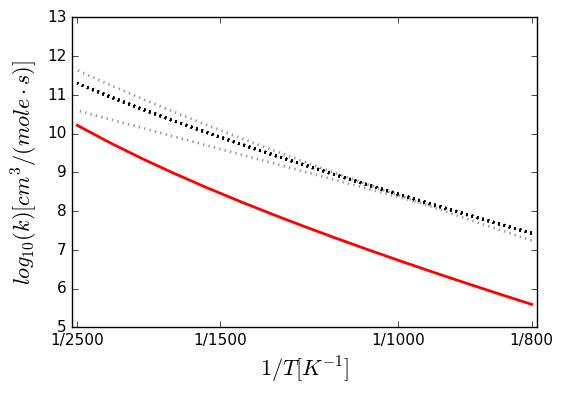


Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4820,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.44188e-08,'cm^3/(mol*s)'), n=5.42764, Ea=(21.0841,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.37423, dn = +|- 0.113481, dEa = +|- 0.624258 kJ/mol""")
AC5H10 + HO2 <=> AC5H9-C + H2O2


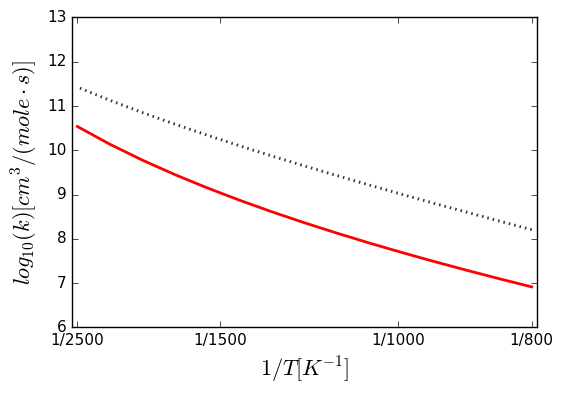


Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9639,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.44188e-08,'cm^3/(mol*s)'), n=5.42764, Ea=(21.0841,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.37423, dn = +|- 0.113481, dEa = +|- 0.624258 kJ/mol""")
AC5H10 + HO2 <=> AC5H9-A2 + H2O2


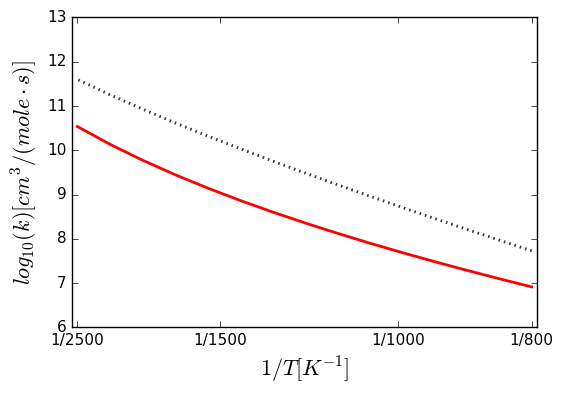


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.44188e-08,'cm^3/(mol*s)'), n=5.42764, Ea=(21.0841,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.37423, dn = +|- 0.113481, dEa = +|- 0.624258 kJ/mol""")
AC5H10 + HO2 <=> AC5H9-D + H2O2


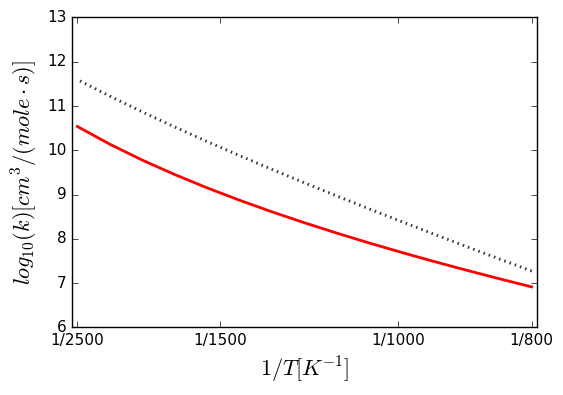


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.4905e-10,'cm^3/(mol*s)'), n=5.87076, Ea=(19.0976,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.71122, dn = +|- 0.1309, dEa = +|- 0.72008 kJ/mol""")
H2O2 + AC8H17O2 <=> HO2 + AC8H17O2H


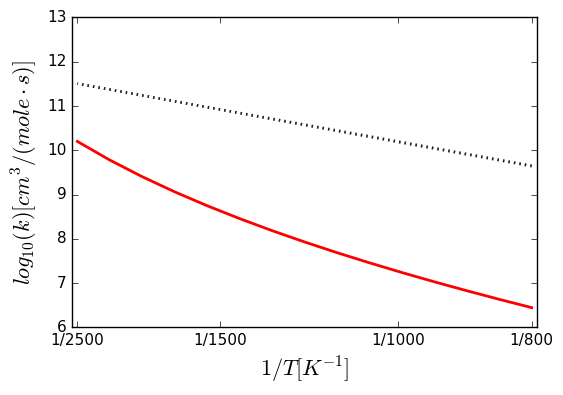


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.4905e-10,'cm^3/(mol*s)'), n=5.87076, Ea=(19.0976,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.71122, dn = +|- 0.1309, dEa = +|- 0.72008 kJ/mol""")
HO2 + AC8H17O2H <=> H2O2 + AC8H17O2


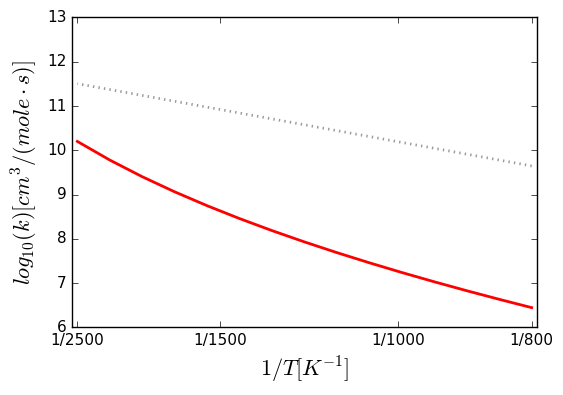


Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8e+10,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000127068,'cm^3/(mol*s)'), n=4.09695, Ea=(6.47337,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.26998, dn = +|- 0.0313666, dEa = +|- 0.172548 kJ/mol""")
NEOC6H13CHO + HO2 <=> HC6H12CHO + H2O2


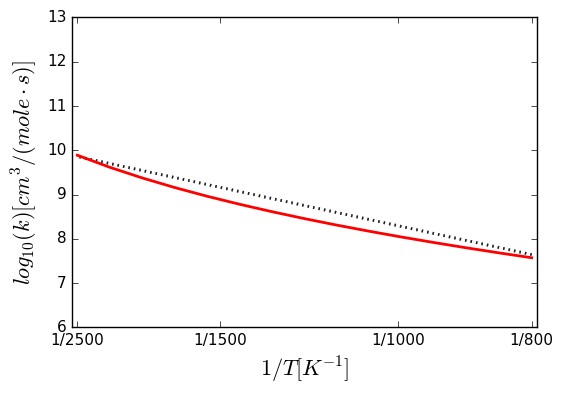


Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000127068,'cm^3/(mol*s)'), n=4.09695, Ea=(6.47337,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.26998, dn = +|- 0.0313666, dEa = +|- 0.172548 kJ/mol""")
NEOC6H13CHO + HO2 <=> GC6H12CHO + H2O2


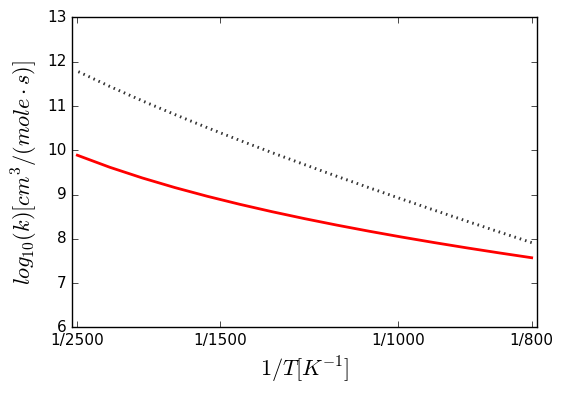


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000127068,'cm^3/(mol*s)'), n=4.09695, Ea=(6.47337,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.26998, dn = +|- 0.0313666, dEa = +|- 0.172548 kJ/mol""")
NEOC6H13CHO + HO2 <=> NEOC6H13CO + H2O2


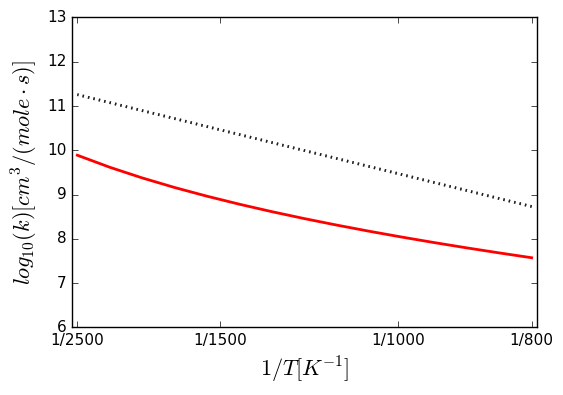


Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(19400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(19400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(19400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.68e+13,'cm^3/(mol*s)'), n=0, Ea=(19400,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000127068,'cm^3/(mol*s)'), n=4.09695, Ea=(6.47337,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.26998, dn = +|- 0.0313666, dEa = +|- 0.172548 kJ/mol""")
NEOC6H13CHO + HO2 <=> FC6H12CHO + H2O2


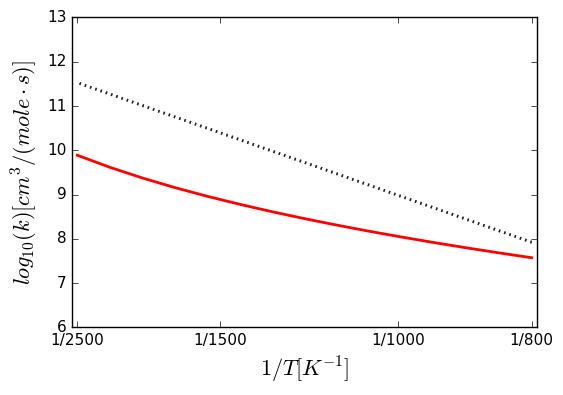


Arrhenius(A=(1.18e+13,'cm^3/(mol*s)'), n=-0.35, Ea=(13690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000127068,'cm^3/(mol*s)'), n=4.09695, Ea=(6.47337,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.26998, dn = +|- 0.0313666, dEa = +|- 0.172548 kJ/mol""")
NEOC6H13CO + H2O2 <=> NEOC6H13CHO + HO2


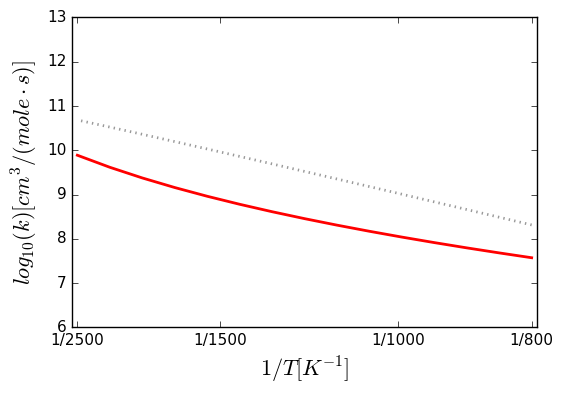


Arrhenius(A=(14460,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14460,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14460,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000408181,'cm^3/(mol*s)'), n=4.20427, Ea=(48.1227,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.16662, dn = +|- 0.0202255, dEa = +|- 0.111261 kJ/mol""")
MP2D + HO2 <=> MP2DMJ + H2O2


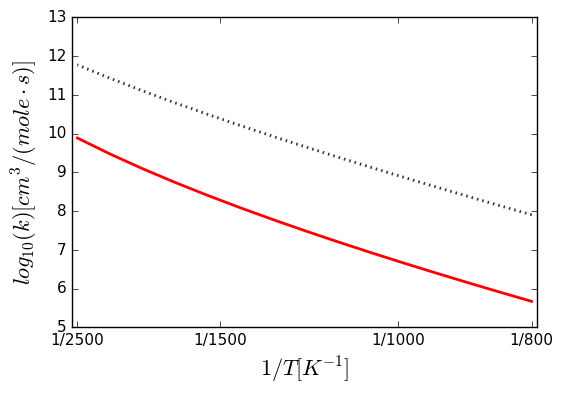


Arrhenius(A=(3610,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3610,'cm^3/(mol*s)'), n=2.55, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000408181,'cm^3/(mol*s)'), n=4.20427, Ea=(48.1227,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.16662, dn = +|- 0.0202255, dEa = +|- 0.111261 kJ/mol""")
MP2D + HO2 <=> MP2D2J + H2O2


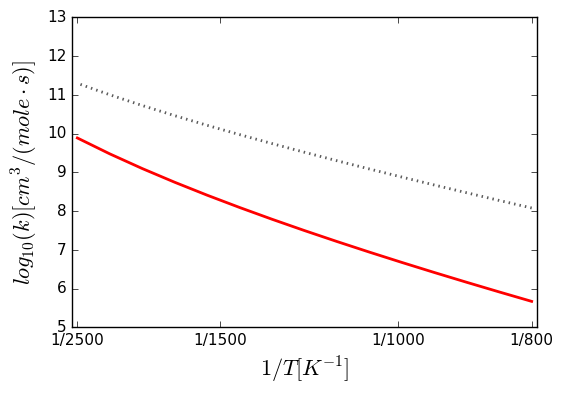


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000408181,'cm^3/(mol*s)'), n=4.20427, Ea=(48.1227,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.16662, dn = +|- 0.0202255, dEa = +|- 0.111261 kJ/mol""")
MP2D + HO2 <=> MP2D3J + H2O2


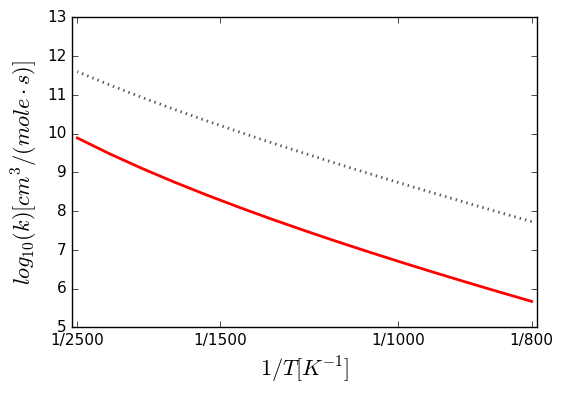


Arrhenius(A=(9e+12,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00158136,'cm^3/(mol*s)'), n=4.30696, Ea=(55.4599,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21311, dn = +|- 0.0253538, dEa = +|- 0.139471 kJ/mol""")
CH3OCH2 + HO2 <=> CH3OCH2O + OH


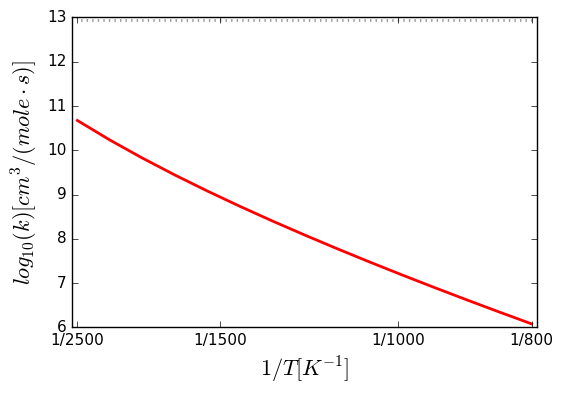


Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13200,'cm^3/(mol*s)'), n=2.5, Ea=(9560,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(60880,'cm^3/(mol*s)'), n=2, Ea=(6540.14,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(9900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(9900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.409e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(13200,'cm^3/(mol*s)'), n=2.5, Ea=(9560,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(9900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.41e+12,'cm^3/(mol*s)'), n=0, Ea=(9936,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(60880,'cm^3/(mol*s)'), n=2, Ea=(6540.14,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.25347e-05,'cm^3/(mol*s)'), n=4.61955, Ea=(0.462874,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data po

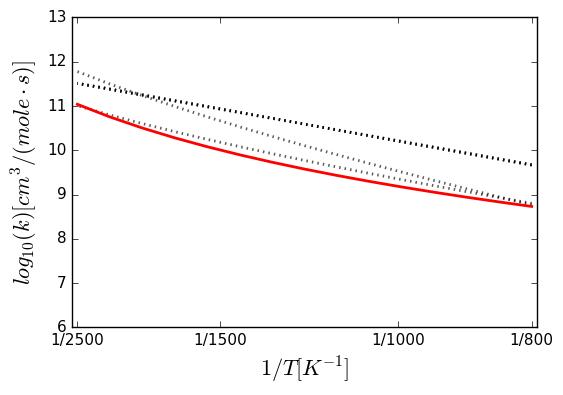


Arrhenius(A=(2e+13,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(107800,'cm^3/(mol*s)'), n=2, Ea=(10890.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(107800,'cm^3/(mol*s)'), n=2, Ea=(10890.1,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.25347e-05,'cm^3/(mol*s)'), n=4.61955, Ea=(0.462874,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.41572, dn = +|- 0.045624, dEa = +|- 0.250978 kJ/mol""")
HO2 + CH3OOH => H2O2 + CH3OO


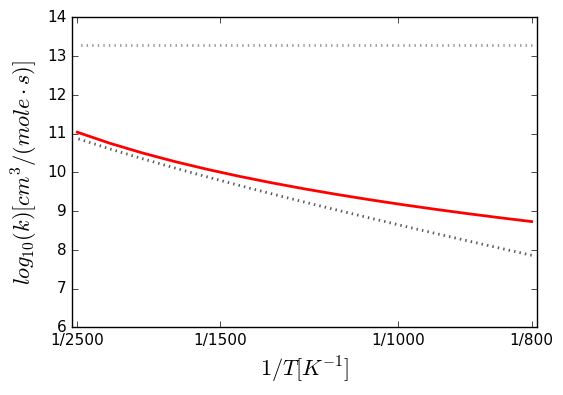


Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.48946,'cm

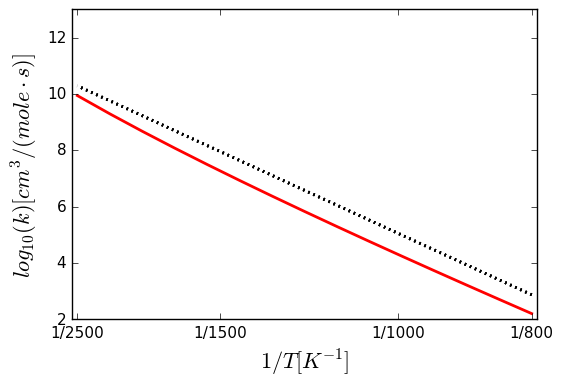


Arrhenius(A=(6e+13,'cm^3/(mol*s)'), n=0, Ea=(39900,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.48946,'cm^3/(mol*s)'), n=3.63274, Ea=(133.738,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.12664, dn = +|- 0.0156497, dEa = +|- 0.0860889 kJ/mol""")
IC4H7OH + O2 <=> IC4H6OH + HO2


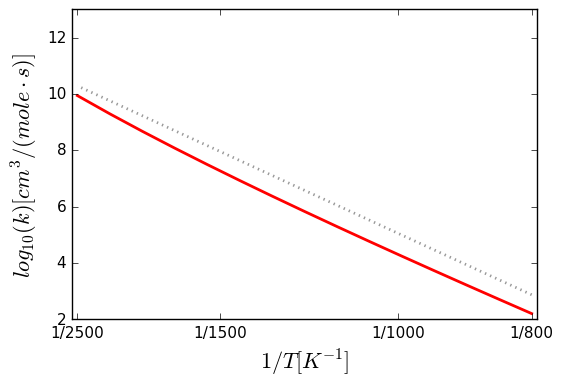


Arrhenius(A=(107800,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00751,'cm^3/(mol*s)'), n=4.52, Ea=(14710,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000461344,'cm^3/(mol*s)'), n=4.49371, Ea=(61.8638,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.31972, dn = +|- 0.0364087, dEa = +|- 0.200284 kJ/mol""")
HO2 + NC3H7OH => H2O2 + CH3CHCH2OH


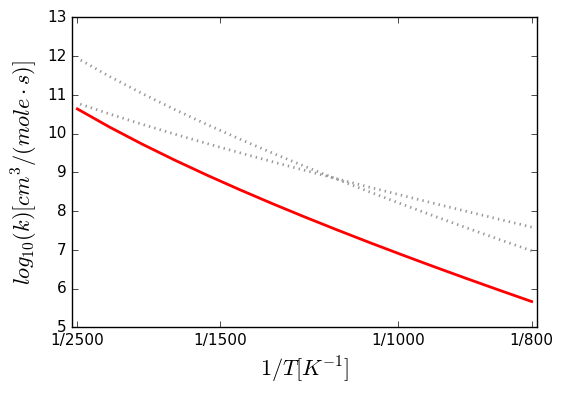


Arrhenius(A=(161600,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3.5e-05,'cm^3/(mol*s)'), n=5.26, Ea=(8268,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000461344,'cm^3/(mol*s)'), n=4.49371, Ea=(61.8638,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.31972, dn = +|- 0.0364087, dEa = +|- 0.200284 kJ/mol""")
HO2 + NC3H7OH => H2O2 + CH3CH2CHOH


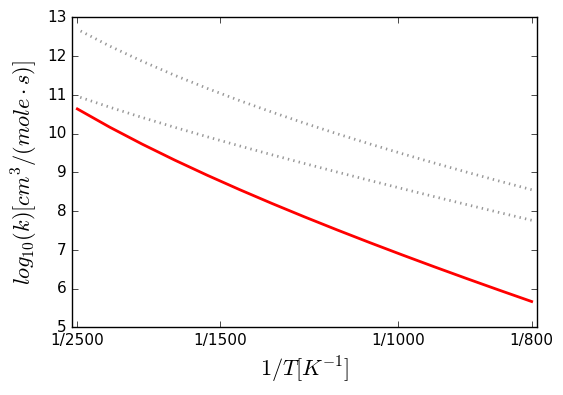


Arrhenius(A=(53880,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.5e+12,'cm^3/(mol*s)'), n=0, Ea=(24000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000461344,'cm^3/(mol*s)'), n=4.49371, Ea=(61.8638,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.31972, dn = +|- 0.0364087, dEa = +|- 0.200284 kJ/mol""")
HO2 + NC3H7OH => H2O2 + CH3CH2CH2O


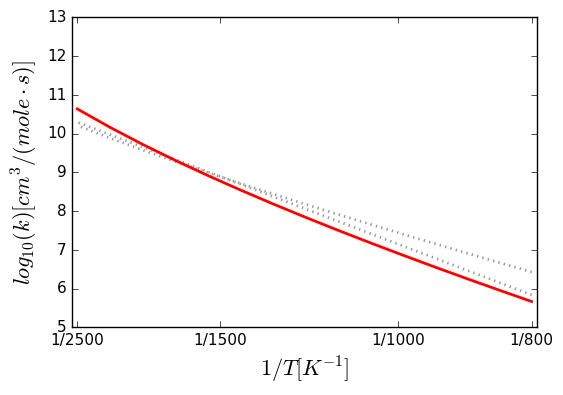


Arrhenius(A=(161600,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.088,'cm^3/(mol*s)'), n=4.31, Ea=(17270,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000461344,'cm^3/(mol*s)'), n=4.49371, Ea=(61.8638,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.31972, dn = +|- 0.0364087, dEa = +|- 0.200284 kJ/mol""")
HO2 + NC3H7OH => H2O2 + CH2CH2CH2OH


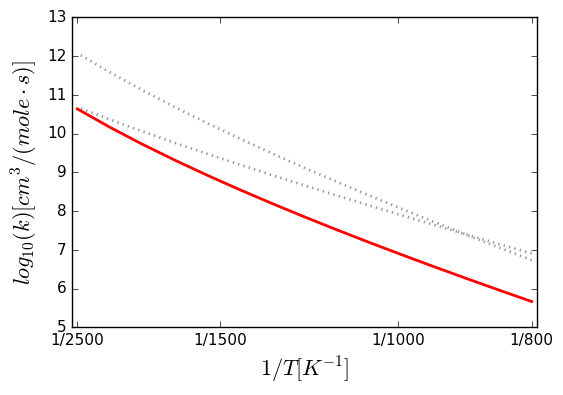


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.50978e-08,'cm^3/(mol*s)'), n=5.20035, Ea=(10.6234,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.79358, dn = +|- 0.0766725, dEa = +|- 0.421775 kJ/mol""")
c4h8oh-4o2 + h2o2 <=> c4h8oh-4o2h + ho2


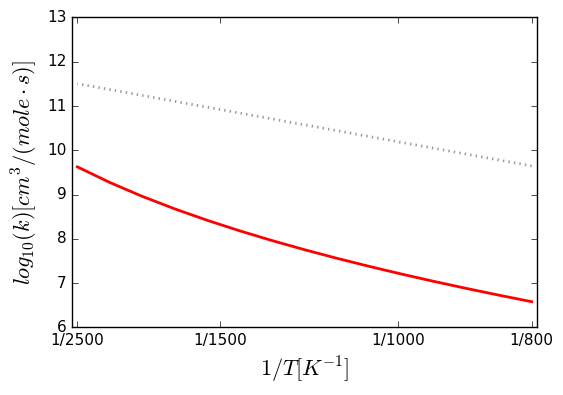


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.63848e-05,'cm^3/(mol*s)'), n=4.58331, Ea=(43.417,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.42867, dn = +|- 0.0468199, dEa = +|- 0.257556 kJ/mol""")
EC6H13O2H + HO2 <=> EC6H13O2 + H2O2


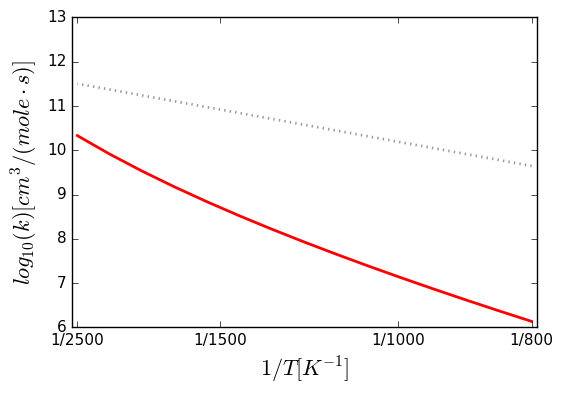


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.0252e-05,'cm^3/(mol*s)'), n=4.43579, Ea=(13.3142,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.27497, dn = +|- 0.0318815, dEa = +|- 0.17538 kJ/mol""")
C6H13O2H-3 + HO2 <=> C6H13O2-3 + H2O2


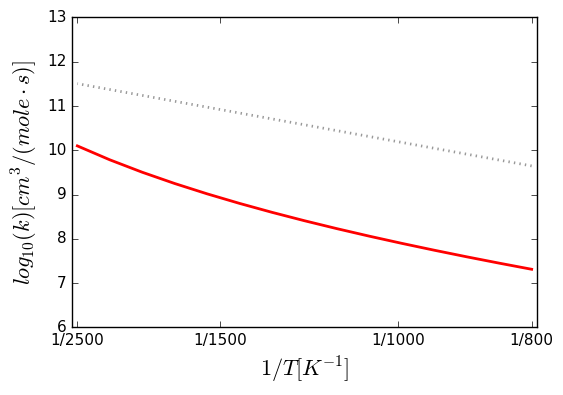


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.0252e-05,'cm^3/(mol*s)'), n=4.43579, Ea=(13.3142,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.27497, dn = +|- 0.0318815, dEa = +|- 0.17538 kJ/mol""")
C6H13O2-3 + H2O2 <=> C6H13O2H-3 + HO2


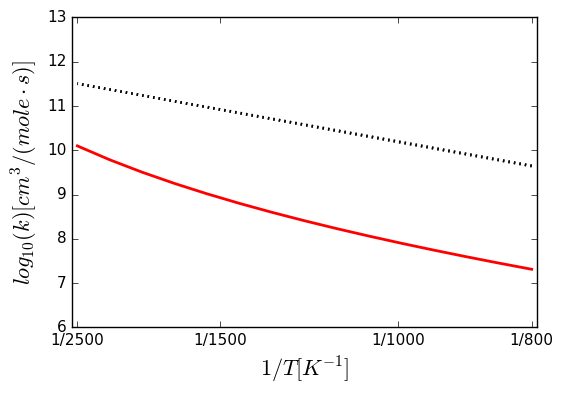


Arrhenius(A=(5e+16,'cm^3/(mol*s)'), n=-0.88, Ea=(27050,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(584.125,'cm^3/(mol*s)'), n=2.91376, Ea=(-2.52963,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.0523, dn = +|- 0.00669105, dEa = +|- 0.0368075 kJ/mol""")
NEOC5H11O + OH <=> NEOC5H11 + HO2


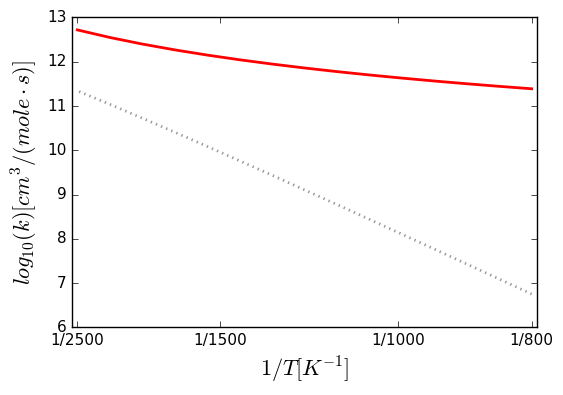


Arrhenius(A=(4e+11,'cm^3/(mol*s)'), n=0, Ea=(58201.3,'J/mol'), T0=(1,'K'))
Arrhenius(A=(1.50396e-07,'cm^3/(mol*s)'), n=5.28056, Ea=(27.3757,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.02207, dn = +|- 0.0924095, dEa = +|- 0.508345 kJ/mol""")
A3CH3 + HO2 <=> A3CH2 + H2O2


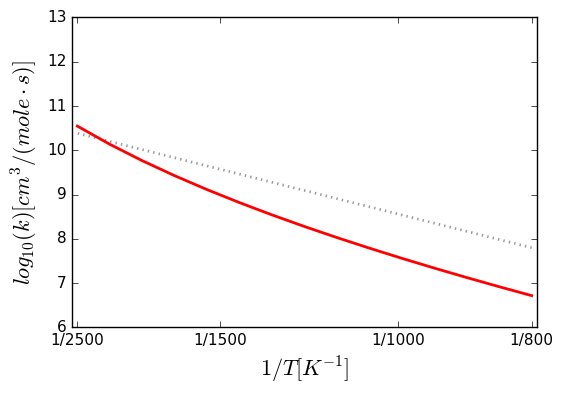


Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(27600,'cm^3/(mol*s)'), n=2.55, Ea=(16480,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000451636,'cm^3/(mol*s)'), n=4.31888, Ea=(58.1426,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.20659, dn = +|- 0.0246474, dEa = +|- 0.135585 kJ/mol""")
NC4H9CHO + HO2 <=> C4H8CHO-1 + H2O2


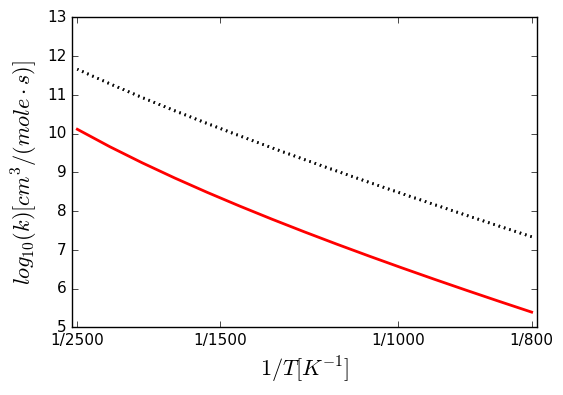


Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(29500,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000451636,'cm^3/(mol*s)'), n=4.31888, Ea=(58.1426,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.20659, dn = +|- 0.0246474, dEa = +|- 0.135585 kJ/mol""")
NC4H9CHO + HO2 <=> C4H8CHO-4 + H2O2


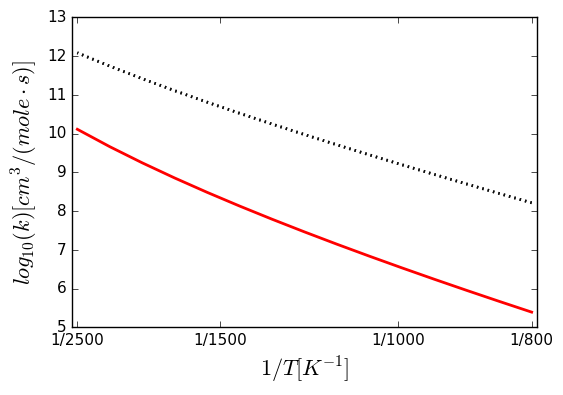


Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14800,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000451636,'cm^3/(mol*s)'), n=4.31888, Ea=(58.1426,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.20659, dn = +|- 0.0246474, dEa = +|- 0.135585 kJ/mol""")
NC4H9CHO + HO2 <=> C4H8CHO-2 + H2O2


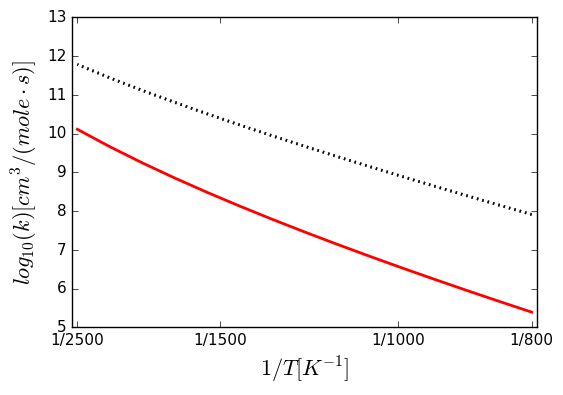


Arrhenius(A=(38300,'cm^3/(mol*s)'), n=2.2, Ea=(4471,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000451636,'cm^3/(mol*s)'), n=4.31888, Ea=(58.1426,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.20659, dn = +|- 0.0246474, dEa = +|- 0.135585 kJ/mol""")
C4H8CHO-1 + H2O2 <=> NC4H9CHO + HO2


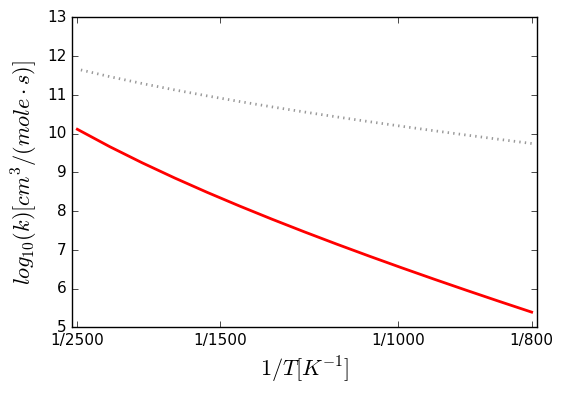


Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14800,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000451636,'cm^3/(mol*s)'), n=4.31888, Ea=(58.1426,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.20659, dn = +|- 0.0246474, dEa = +|- 0.135585 kJ/mol""")
NC4H9CHO + HO2 <=> C4H8CHO-3 + H2O2


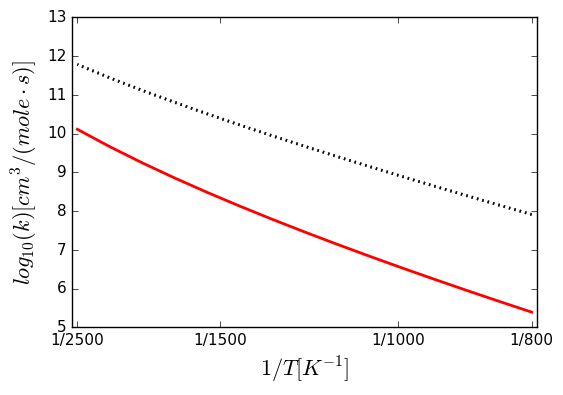


Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13599.9,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.8e+12,'cm^3/(mol*s)'), n=0, Ea=(13600,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000451636,'cm^3/(mol*s)'), n=4.31888, Ea=(58.1426,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.20659, dn = +|- 0.0246474, dEa = +|- 0.135585 kJ/mol"""

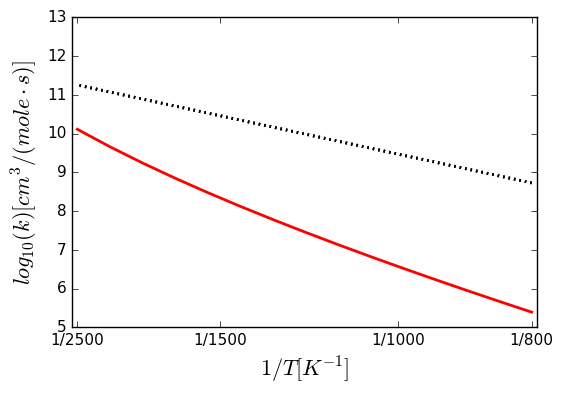


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.14635e-11,'cm^3/(mol*s)'), n=6.05142, Ea=(28.0567,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 3.5282, dn = +|- 0.165467, dEa = +|- 0.910235 kJ/mol""")
C7H12-15 + HO2 <=> C7H11-15-7 + H2O2


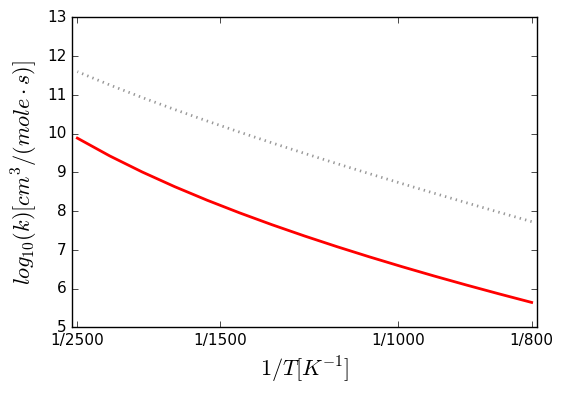


Arrhenius(A=(6.63e+09,'cm^3/(mol*s)'), n=0.17, Ea=(14820,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000192682,'cm^3/(mol*s)'), n=4.34844, Ea=(3.54616,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33638, dn = +|- 0.0380552, dEa = +|- 0.209342 kJ/mol""")
IC3H5COCH3 + HO2 <=> TC3H6COCH3 + O2


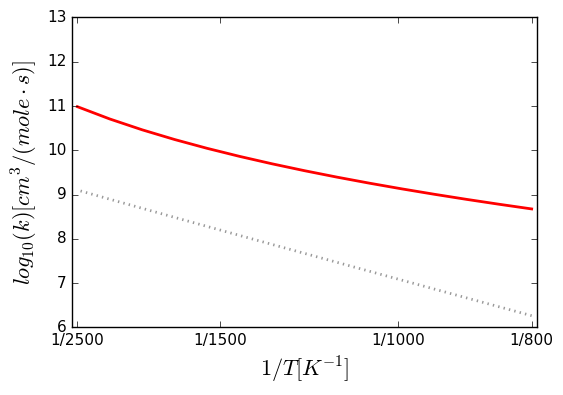


Arrhenius(A=(1e+11,'cm^3/(mol*s)'), n=0, Ea=(8000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000192682,'cm^3/(mol*s)'), n=4.34844, Ea=(3.54616,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33638, dn = +|- 0.0380552, dEa = +|- 0.209342 kJ/mol""")
IC3H5COCH2 + H2O2 <=> IC3H5COCH3 + HO2


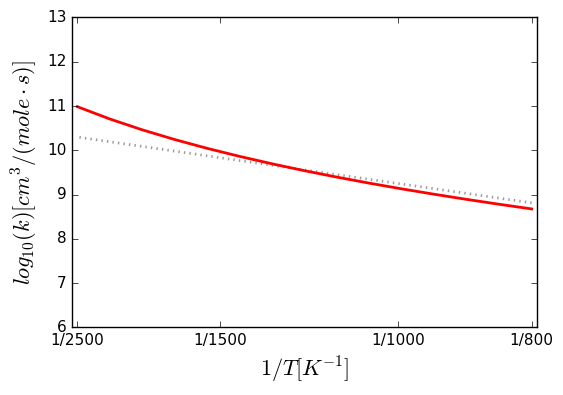


Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000192682,'cm^3/(mol*s)'), n=4.34844, Ea=(3.54616,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33638, dn = +|- 0.0380552, dEa = +|- 0.209342 kJ/mol""")
ic3h5coch3 + ho2 <=> sc3h5coch2 + h2o2


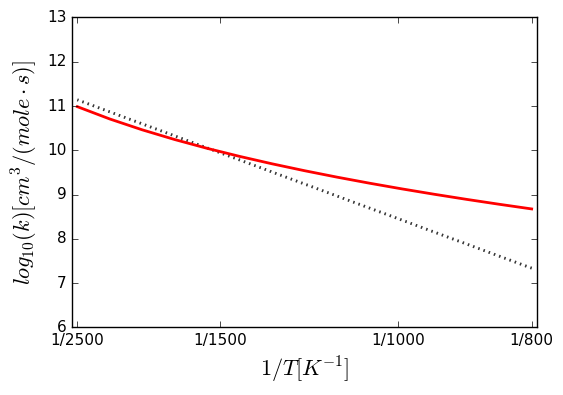


Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.5e+12,'cm^3/(mol*s)'), n=0, Ea=(20460,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000192682,'cm^3/(mol*s)'), n=4.34844, Ea=(3.54616,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33638, dn = +|- 0.0380552, dEa = +|- 0.209342 kJ/mol""")
ic3h5coch3 + ho2 <=> ic3h5coch2 + h2o2


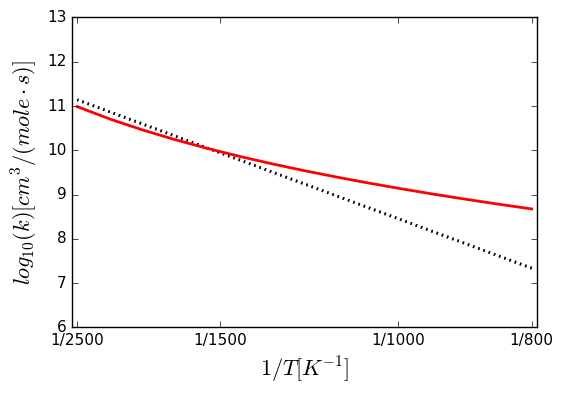


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000192682,'cm^3/(mol*s)'), n=4.34844, Ea=(3.54616,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33638, dn = +|- 0.0380552, dEa = +|- 0.209342 kJ/mol""")
IC3H5COCH3 + HO2 <=> AC3H4COCH3 + H2O2


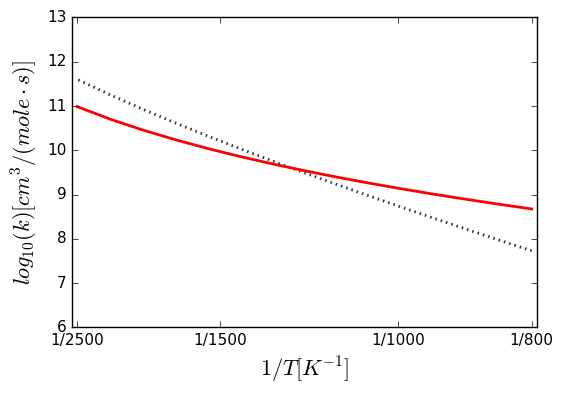


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000192682,'cm^3/(mol*s)'), n=4.34844, Ea=(3.54616,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.33638, dn = +|- 0.0380552, dEa = +|- 0.209342 kJ/mol""")
ic3h5coch3 + ho2 <=> ac3h4coch3 + h2o2


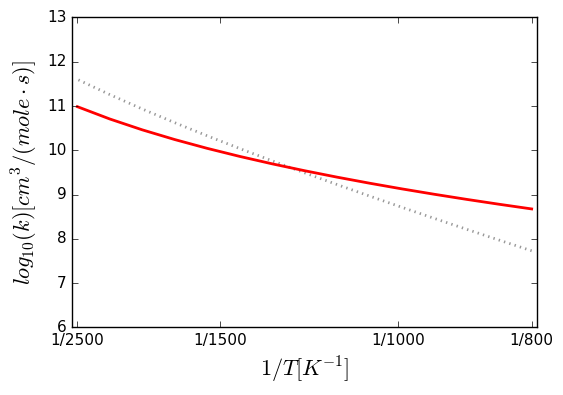


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(4.90429e-05,'cm^3/(mol*s)'), n=4.69337, Ea=(52.8137,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.48328, dn = +|- 0.0517424, dEa = +|- 0.284635 kJ/mol""")
NC7H15O2H + HO2 <=> NC7H15O2 + H2O2


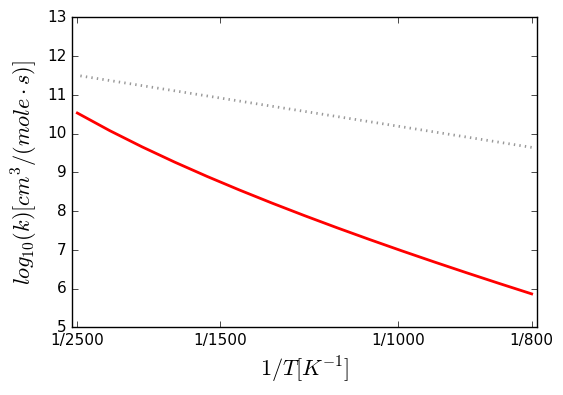


Arrhenius(A=(3.27e+06,'cm^3/(mol*s)'), n=2.01, Ea=(17730,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.00839e-09,'cm^3/(mol*s)'), n=5.77243, Ea=(22.7581,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.87101, dn = +|- 0.138415, dEa = +|- 0.761423 kJ/mol""")
C4H6CHO1-43 + H2O2 <=> C4H7CHO1-4 + HO2


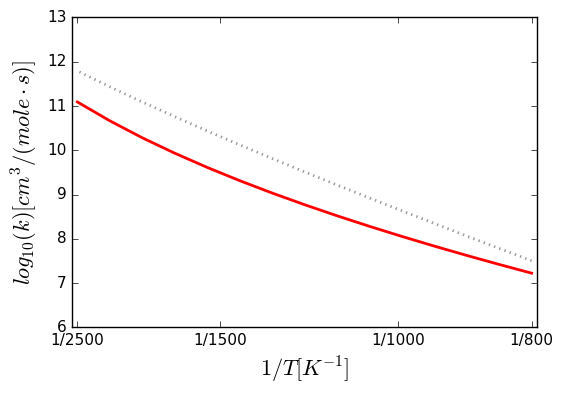


Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1e+12,'cm^3/(mol*s)'), n=0, Ea=(11920,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.00839e-09,'cm^3/(mol*s)'), n=5.77243, Ea=(22.7581,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.87101, dn = +|- 0.138415, dEa = +|- 0.761423 kJ/mol""")
C4H7CHO1-4 + HO2 <=> C4H7CO1-4 + H2O2


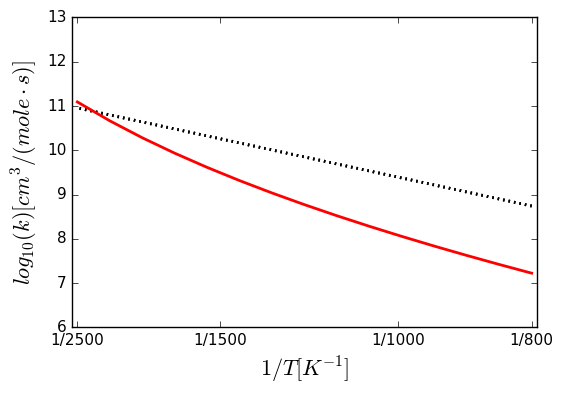


Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9640,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.00839e-09,'cm^3/(mol*s)'), n=5.77243, Ea=(22.7581,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.87101, dn = +|- 0.138415, dEa = +|- 0.761423 kJ/mol""")
C4H7CHO1-4 + HO2 <=> C4H6CHO1-43 + H2O2


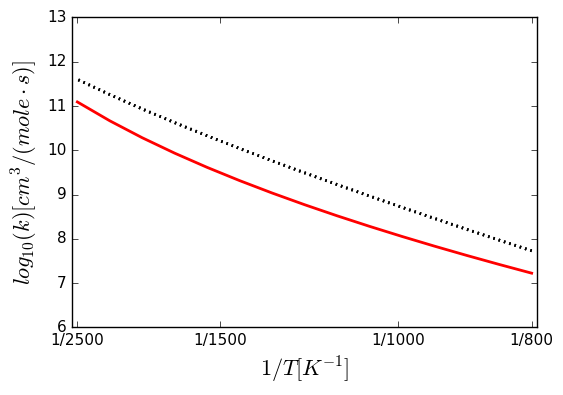


Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14800,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(14750,'cm^3/(mol*s)'), n=2.6, Ea=(13910,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.00839e-09,'cm^3/(mol*s)'), n=5.77243, Ea=(22.7581,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.87101, dn = +|- 0.138415, dEa = +|- 0.761423 kJ/mol""")
C4H7CHO1-4 + HO2 <=> C4H6CHO1-44 + H2O2


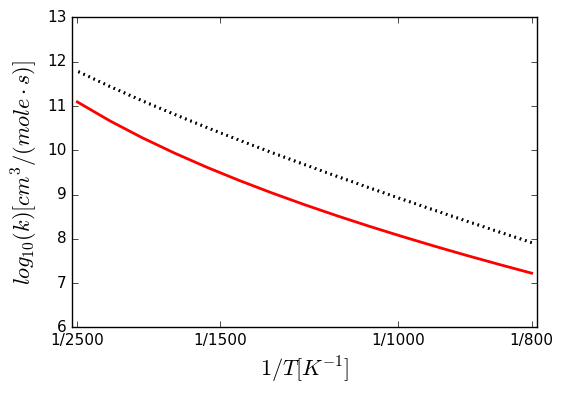


Arrhenius(A=(2.82e+06,'cm^3/(mol*s)'), n=1.94, Ea=(15850,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(9.00839e-09,'cm^3/(mol*s)'), n=5.77243, Ea=(22.7581,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.87101, dn = +|- 0.138415, dEa = +|- 0.761423 kJ/mol""")
C4H6CHO1-43 + H2O2 <=> C4H7CHO2-1 + HO2


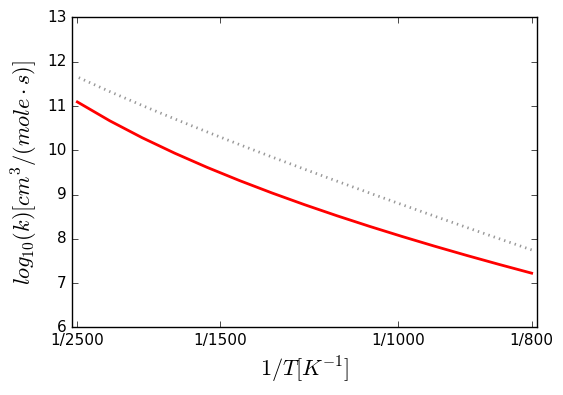


Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhe

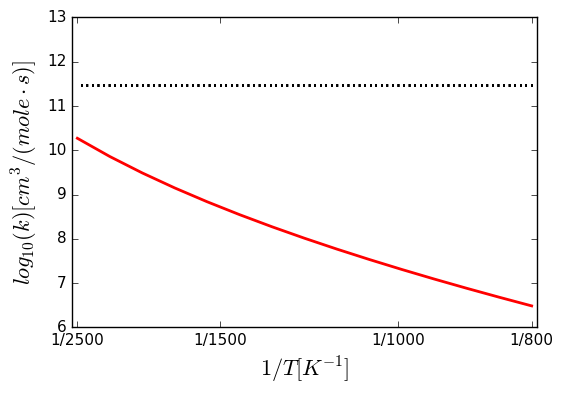


Arrhenius(A=(1.24e+09,'cm^3/(mol*s)'), n=1.301, Ea=(38339,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.31e+11,'cm^3/(mol*s)'), n=0, Ea=(24858,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(8.31e+11,'cm^3/(mol*s)'), n=0, Ea=(24858,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0328366,'cm^3/(mol*s)'), n=4.11605, Ea=(114.929,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.31083, dn = +|- 0.0355213, dEa = +|- 0.195403 kJ/mol""")
CHD13 + O2 <=> C6H7C + HO2


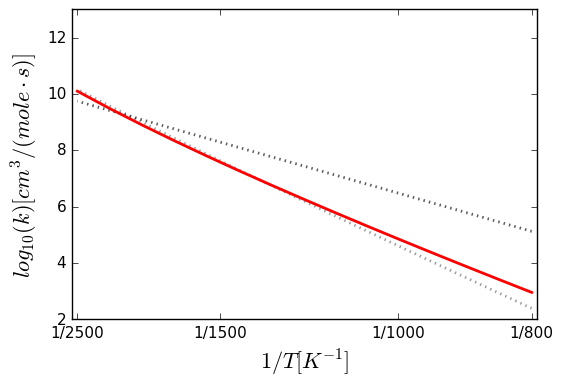


Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0668444,'cm^3/(mol*s)'), n=3.60869, Ea=(-5.06746,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05232, dn = +|- 0.00669258, dEa = +|- 0.0368159 kJ/mol""")
nc3h7coc2h5 + ho2 <=> nc3h7coc2h4s + h2o2


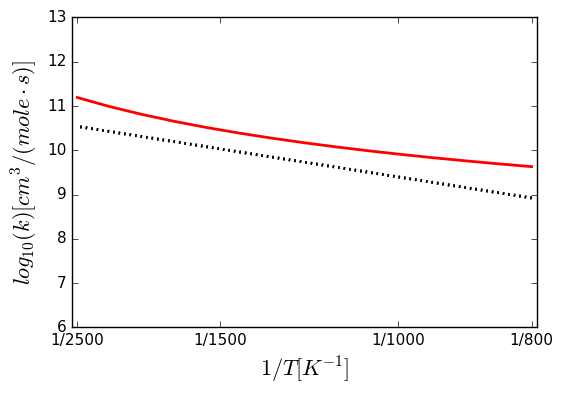


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(14690,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0668444,'cm^3/(mol*s)'), n=3.60869, Ea=(-5.06746,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05232, dn = +|- 0.00669258, dEa = +|- 0.0368159 kJ/mol""")
nc3h7coc2h5 + ho2 <=> nc3h7coc2h4p + h2o2


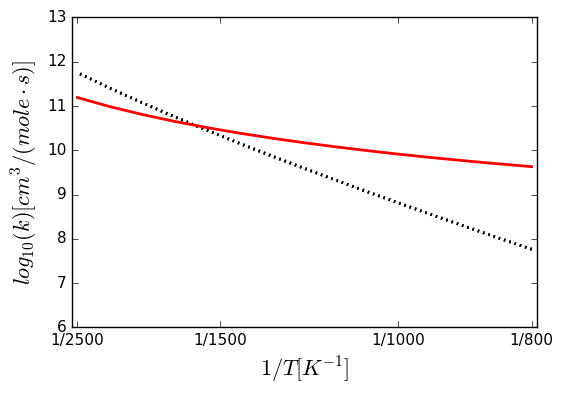


Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(8698,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0668444,'cm^3/(mol*s)'), n=3.60869, Ea=(-5.06746,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05232, dn = +|- 0.00669258, dEa = +|- 0.0368159 kJ/mol""")
nc3h7coc2h5 + ho2 <=> c3h6coc

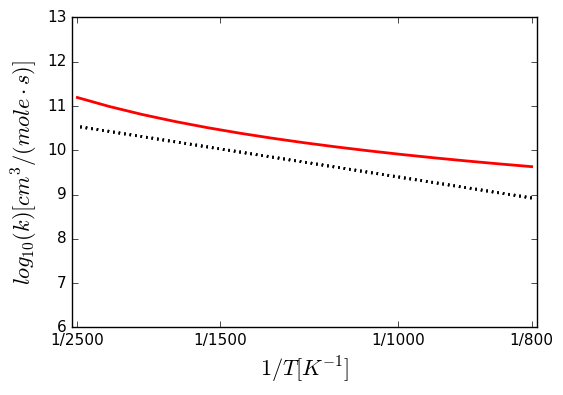


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0668444,'cm^3/(mol*s)'), n=3.60869, Ea=(-5.06746,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05232, dn = +|- 0.00669258, dEa = +|- 0.0368159 kJ/mol""")

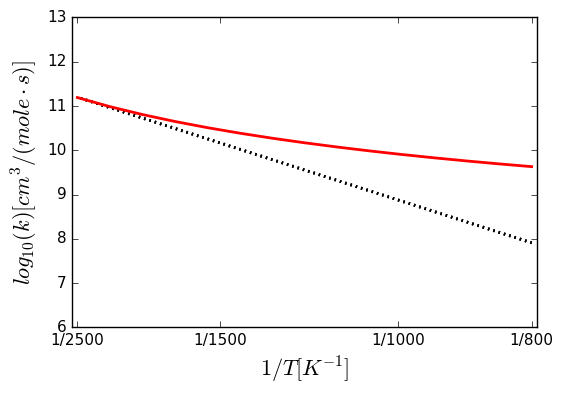


Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(23800,'cm^3/(mol*s)'), n=2.55, Ea=(16490,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0668444,'cm^3/(mol*s)'), n=3.60869, Ea=(-5.06746,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05232, dn = +|- 0.00669258, dEa = +|- 0.0368159 

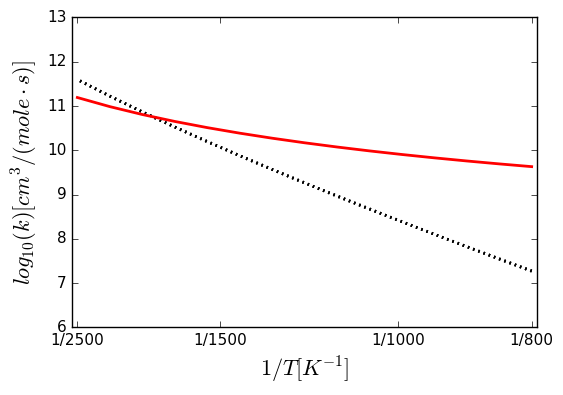


Arrhenius(A=(6.65e+11,'cm^3/(mol*s)'), n=-0.05, Ea=(8242,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.0668444,'cm^3/(mol*s)'), n=3.60869, Ea=(-5.06746,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05232, dn = +|- 0.00669258, dEa = +|- 0.0368159 kJ/mol""")
C3H6COC2H5-2 + H2O2 <=> NC3H7COC2H5 + HO2


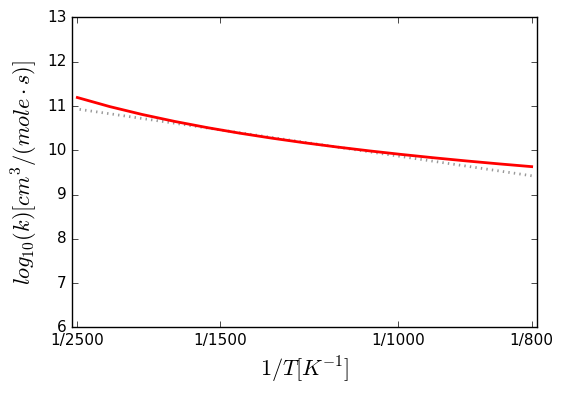


Arrhenius(A=(0.00376,'cm^3/(mol*s)'), n=4.52, Ea=(11710,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(53880,'cm^3/(mol*s)'), n=2, Ea=(10318.8,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00199853,'cm^3/(mol*s)'), n=4.00797, Ea=(0.417367,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15522, dn = +|- 0.0189372, dEa = +|- 0.104173 kJ/mol""")
ic4h9oh + ho2 <=> ic4h8oh-2 + h2o2


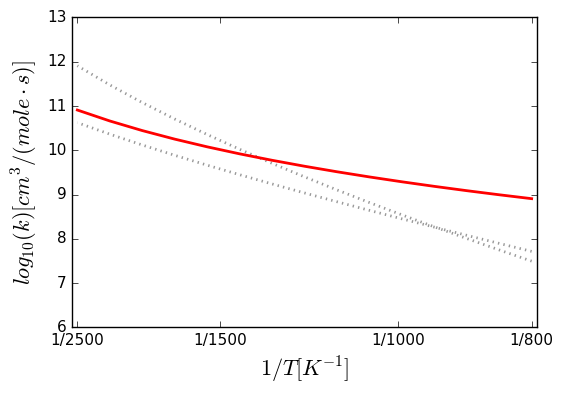


Arrhenius(A=(3.5e-05,'cm^3/(mol*s)'), n=5.26, Ea=(8668,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(161600,'cm^3/(mol*s)'), n=2, Ea=(11887.7,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00199853,'cm^3/(mol*s)'), n=4.00797, Ea=(0.417367,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15522, dn = +|- 0.0189372, dEa = +|- 0.104173 kJ/mol""")
ic4h9oh + ho2 <=> ic4h8oh-1 + h2o2


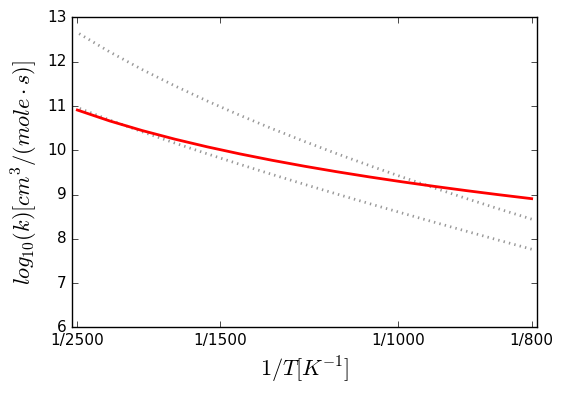


Arrhenius(A=(6.47e-07,'cm^3/(mol*s)'), n=5.3, Ea=(10530,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(53880,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00199853,'cm^3/(mol*s)'), n=4.00797, Ea=(0.417367,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15522, dn = +|- 0.0189372, dEa = +|- 0.104173 kJ/mol""")
ic4h9oh + ho2 <=> ic4h9o + h2o2


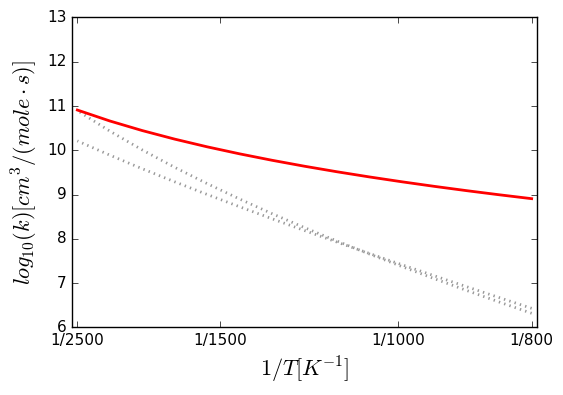


Arrhenius(A=(56.9,'cm^3/(mol*s)'), n=3.04, Ea=(1210,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00199853,'cm^3/(mol*s)'), n=4.00797, Ea=(0.417367,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15522, dn = +|- 0.0189372, dEa = +|- 0.104173 kJ/mol""")
H2O2 + iC4H8OH-1 <=> iC4H9OH + HO2


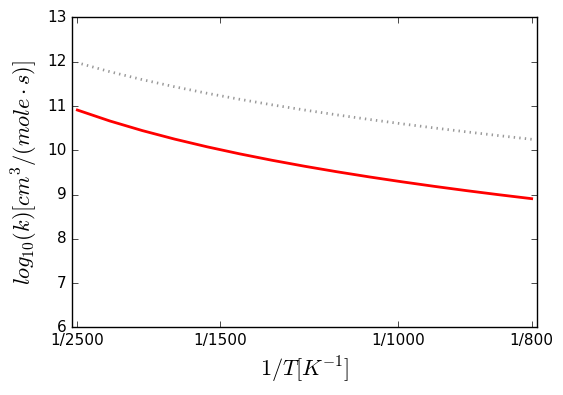


Arrhenius(A=(0.000414,'cm^3/(mol*s)'), n=4.76, Ea=(14850,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(323300,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.00199853,'cm^3/(mol*s)'), n=4.00797, Ea=(0.417367,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.15522, dn = +|- 0.0189372, dEa = +|- 0.104173 kJ/mol""")
ic4h9oh + ho2 <=> ic4h8oh-3 + h2o2


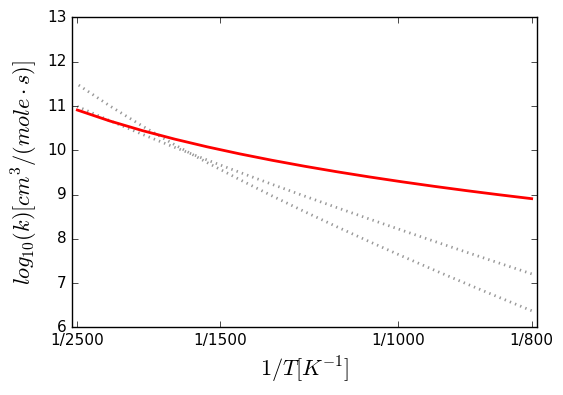


Arrhenius(A=(2e+06,'cm^3/(mol*s)'), n=2.1, Ea=(4870,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2e+11,'cm^3/(mol*s)'), n=0, Ea=(0,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.000361238,'cm^3/(mol*s)'), n=4.67291, Ea=(58.0807,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.41536, dn = +|- 0.0455913, dEa = +|- 0.250798 kJ/mol""")
HCO3 + HO2 => O2 + HCO3H


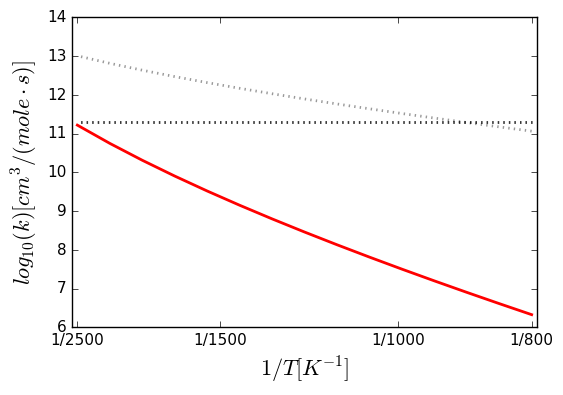


Arrhenius(A=(4.7e+07,'cm^3/(mol*s)'), n=1.61, Ea=(-35,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(39.0154,'cm^3/(mol*s)'), n=2.96193, Ea=(74.3171,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21746, dn = +|- 0.0258243, dEa = +|- 0.142059 kJ/mol""")
c8h18-3 + oh <=> c8h17-3f + h2o


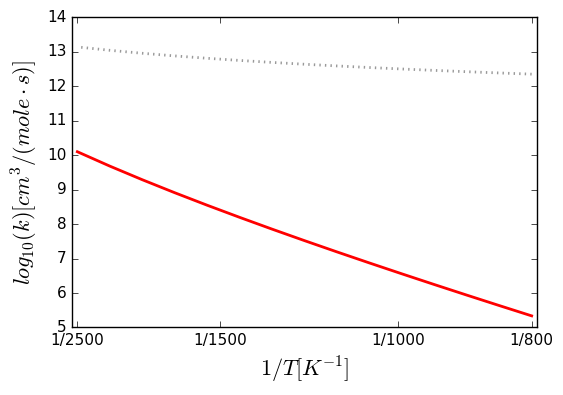


Arrhenius(A=(5.28e+09,'cm^3/(mol*s)'), n=0.97, Ea=(1590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(39.0154,'cm^3/(mol*s)'), n=2.96193, Ea=(74.3171,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21746, dn = +|- 0.0258243, dEa = +|- 0.142059 kJ/mol""")
c8h18-3 + oh <=> c8h17-3a + h2o


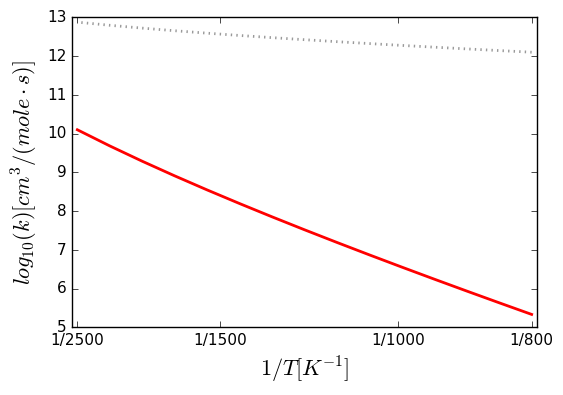


Arrhenius(A=(4.7e+07,'cm^3/(mol*s)'), n=1.61, Ea=(-35,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(39.0154,'cm^3/(mol*s)'), n=2.96193, Ea=(74.3171,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21746, dn = +|- 0.0258243, dEa = +|- 0.142059 kJ/mol""")
c8h18-3 + oh <=> c8h17-3b + h2o


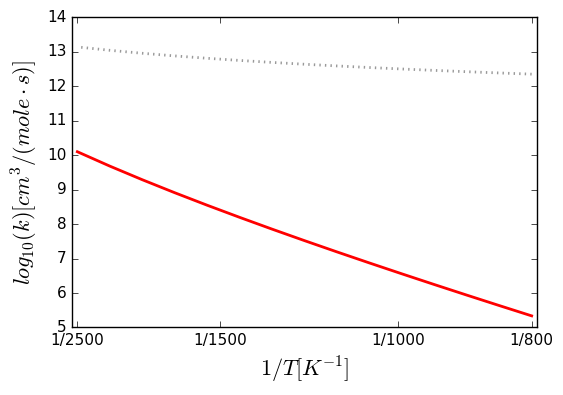


Arrhenius(A=(5.28e+09,'cm^3/(mol*s)'), n=0.97, Ea=(1590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(39.0154,'cm^3/(mol*s)'), n=2.96193, Ea=(74.3171,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21746, dn = +|- 0.0258243, dEa = +|- 0.142059 kJ/mol""")
c8h18-3 + oh <=> c8h17-3g + h2o


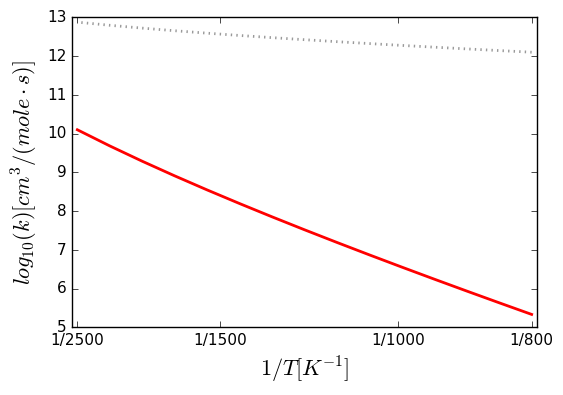


Arrhenius(A=(4.7e+07,'cm^3/(mol*s)'), n=1.61, Ea=(-35,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(39.0154,'cm^3/(mol*s)'), n=2.96193, Ea=(74.3171,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21746, dn = +|- 0.0258243, dEa = +|- 0.142059 kJ/mol""")
c8h18-3 + oh <=> c8h17-3e + h2o


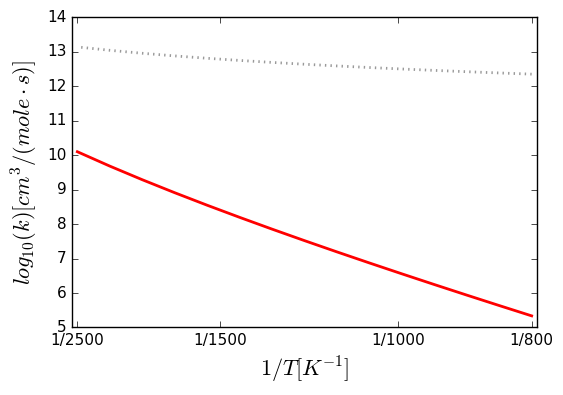


Arrhenius(A=(4.7e+07,'cm^3/(mol*s)'), n=1.61, Ea=(-35,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(39.0154,'cm^3/(mol*s)'), n=2.96193, Ea=(74.3171,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21746, dn = +|- 0.0258243, dEa = +|- 0.142059 kJ/mol""")
c8h18-3 + oh <=> c8h17-3d + h2o


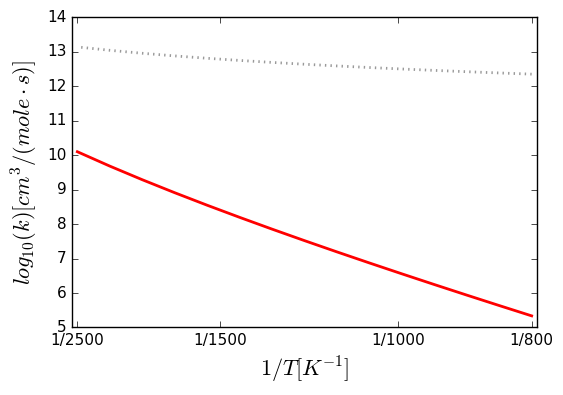


Arrhenius(A=(5.73e+10,'cm^3/(mol*s)'), n=0.51, Ea=(63,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(39.0154,'cm^3/(mol*s)'), n=2.96193, Ea=(74.3171,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21746, dn = +|- 0.0258243, dEa = +|- 0.142059 kJ/mol""")
c8h18-3 + oh <=> c8h17-3c + h2o


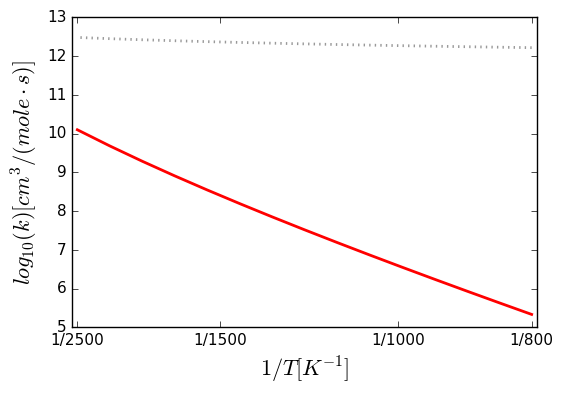


Arrhenius(A=(5.28e+09,'cm^3/(mol*s)'), n=0.97, Ea=(1590,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(39.0154,'cm^3/(mol*s)'), n=2.96193, Ea=(74.3171,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.21746, dn = +|- 0.0258243, dEa = +|- 0.142059 kJ/mol""")
c8h18-3 + oh <=> c8h17-3z + h2o


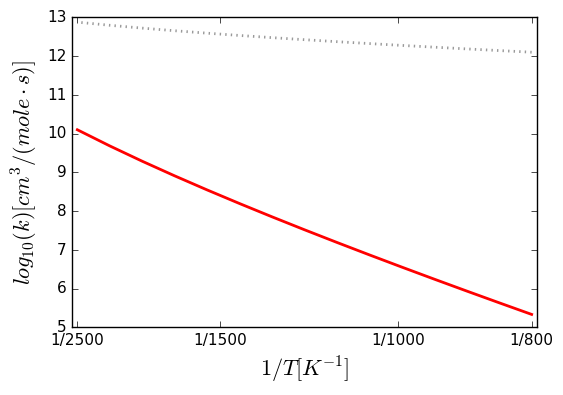


Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(2.4e+12,'cm^3/(mol*s)'), n=0, Ea=(10000,'cal/mol'), T0=(1,'K')

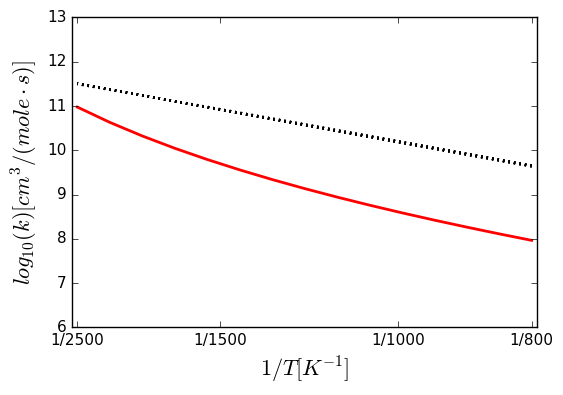


Arrhenius(A=(808200,'cm^3/(mol*s)'), n=2, Ea=(15025.6,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(1.73837e-05,'cm^3/(mol*s)'), n=4.80089, Ea=(63.4679,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.49882, dn = +|- 0.0531104, dEa = +|- 0.292161 kJ/mol""")
HO2 + MTBE => H2O2 + RMTBE


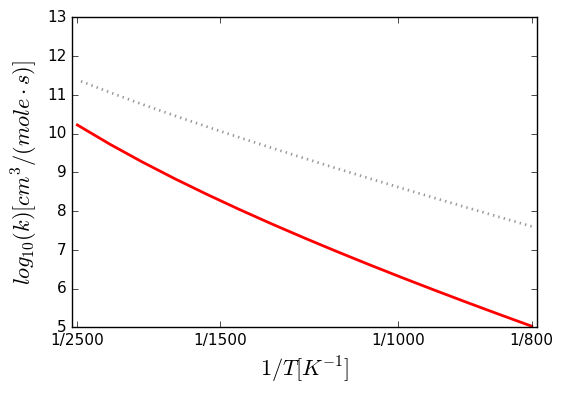


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(16013,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(16013,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(7.01517e-09,'cm^3/(mol*s)'), n=5.68715, Ea=(22.7861,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 2.55685, dn = +|- 0.123206, dEa = +|- 0.677756 kJ/mol""")
BUT14DIAL + HO2 <=> BT14AL1J + H2O2


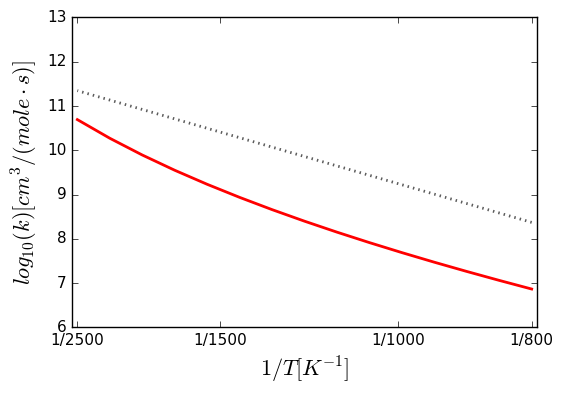


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3400,'cm^3/(mol*s)'), n=2.5, Ea=(8922,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(3400,'cm^3/(mol*s)'), n=2.5, Ea=(8922,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.131477,'cm^3/(mol*s)'), n=3.83204, Ea=(82.1128,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05819, dn = +|- 0.00742338, dEa = +|- 0.040836 kJ/mol""")
C2H3OH + HO2 <=> CH2CHO + H2O2


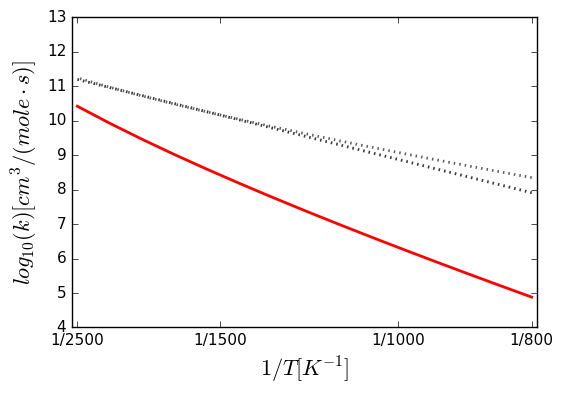


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.131477,'cm^3/(mol*s)'), n=3.83204, Ea=(82.1128,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05819, dn = +|- 0.00742338, dEa = +|- 0.040836 kJ/mol""")
C2H3OH + HO2 <=> CH2COH + H2O2


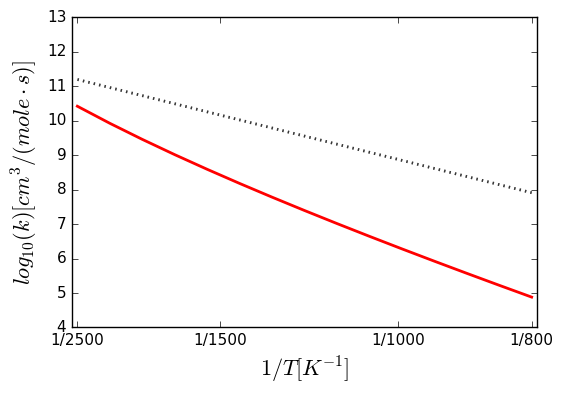


Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(5.6e+12,'cm^3/(mol*s)'), n=0, Ea=(17700,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(0.131477,'cm^3/(mol*s)'), n=3.83204, Ea=(82.1128,'kJ/mol'), T0=(1,'K'), Tmin=(303.03,'K'), Tmax=(2500,'K'), comment="""Fitted to 59 data points; dA = *|/ 1.05819, dn = +|- 0.00742338, dEa = +|- 0.040836 kJ/mol""")
C2H3OH + HO2 <=> HCCHOH + H2O2


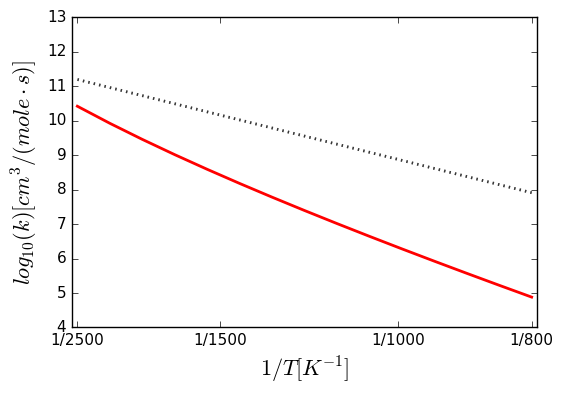


Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Arrhenius(A=(149000,'cm^3/(mol*s)'), n=1.67, Ea=(6810,'cal/mol'), T0=(1,'K'))
Chebyshev(coeffs=[[11.686,-0.89255,-0.18968],[1.0258,0.88111,0.11329],[-0.10827,0.15423,0.10637],[-0.1146,-0.06692,0.013608],[-0.047884,-0.06485,-0.024835]], kunits='cm^3/(mol*s)', Tmin=(290,'K'), Tmax=(3000,'K'), Pmin=(0.00986923,'atm'), Pmax=(98.6923,'atm'))


NameError: name 'Chebyshev' is not defined

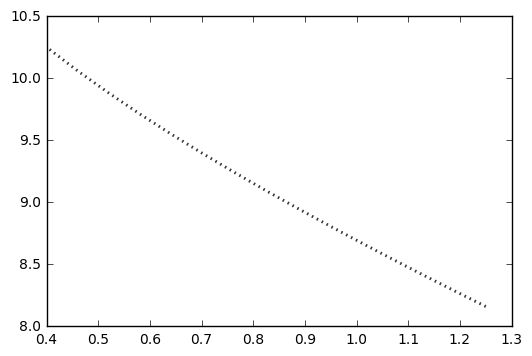

In [34]:
def evalArrhenius(autoTSTExpression):
    if autoTSTExpression is np.nan:
        return autoTSTExpression
    try:
        my_string = str(autoTSTExpression).strip("'")
        print my_string
        result = eval(my_string, {}, {'Arrhenius': rmgpy.kinetics.Arrhenius,
                                     'MultiArrhenius': rmgpy.kinetics.MultiArrhenius,
                                     'PDepArrhenius': rmgpy.kinetics.PDepArrhenius,})
    except:
        result = autoTSTExpression
        raise
    return result

# Temps = np.array(range(800,2500,100))
# inverseTemps = 1000./Temps

inverseTemps = np.linspace(1000./800., 1000./2500., 15)
Temps = 1000./inverseTemps

comparisonPressure = 1e5 # Pa

# make a copy and leave the original so we can try this cell several times
kineticsSheet = expSheet.copy() 
for j in expSheet.index:
    fig, ax = plt.subplots()
    for i in list(expSheet):
        logk = []
        logkAutoTST = []
        kineticsSheet[i].loc[j] = evalArrhenius(expSheet[i].loc[j])
        #print type(kineticsSheet[i].loc[j])
        
        if i == 'AutoTST-OOH':
            for Temp in Temps:
                k = kineticsSheet[i].loc[j].getRateCoefficient(T=Temp,P=comparisonPressure)
                logkAutoTST.append(np.log10(k) + 6)

            plt.plot(inverseTemps, logkAutoTST, '-r', linewidth=2)
        elif type(kineticsSheet[i].loc[j]) == rmgpy.kinetics.arrhenius.Arrhenius:
            #kineticsSheet[i].loc[j]
            for Temp in Temps:
                k = kineticsSheet[i].loc[j].getRateCoefficient(T=Temp,P=comparisonPressure)
                logk.append(np.log10(k) + 6)
            plt.plot(inverseTemps, logk, ':k', linewidth=2, alpha=0.4)
    plt.xlabel("$1/T [K^{-1}]$", fontsize=16)
    plt.ylabel("$log_{10}(k) [cm^3 / (mole \cdot s)]$", fontsize=16)
    
    Tticks = [800, 1000, 1500, 2500]
    ax.set_xticks([1000./T for T in Tticks])
    ax.set_xticklabels(['1/{:.0f}'.format(T) for T in Tticks])
    plt.tick_params(axis='x', labelsize=11)
    plt.tick_params(axis='y', labelsize=11)
    #plt.title(j)
    plt.xlim([0.39,1.26])
    
    #plt.ylim([6,13])
    # the following will EXPAND the limits to at least (6,13) but not shrink them
    plt.ylim(min(ax.get_ylim()[0], 6), max(ax.get_ylim()[1], 13))
    saveString = str(j) + '.pdf'
    #plt.savefig(saveString)
    print str(j)
    plt.show() 
    print

# My attempt to generate parity plots for $A$ and $E_a$

In [28]:
#%cd ..

In [40]:
for j in expSheet.index:
    #mean = kinSheet.loc[j].mean(axis=0) + 6
    
    autoTST = np.log10(expSheet['AutoTST-OOH'].loc[j].A.value) + 6
    #print expSheet['AutoTST-OOHabstraction'].loc[j].A
    #print 
    x_list = []
    y_list = []
    for i in list(expSheet):
        print i
        if i != "AutoTST-OOH" and pd.isnull(kinSheet[i].loc[j]) == False:
            try:
                #print float(str(expSheet[i].loc[j].A).split(' ')[0])
                x_list.append(np.log10(expSheet[i].loc[j].A.value) + 6)
                y_list.append(autoTST)
            except:
                print expSheet[i].loc[j]
            
    mean = np.mean(x_list)
    plt.plot(x_list, y_list, '-b') # Line for the range for each AutoTST point
    plt.plot(x_list, y_list, '|b') # Tick marks for each point
    plt.plot(mean, autoTST, '.k') # Dots for each average data point
    plt.plot(range(-5, 22), range(-5, 22), '-g')# Parity Line
    plt.plot(range(-6, 21), range(-5, 22), ':g') # 1 order of magnitude
    plt.plot(range(-4, 23), range(-5, 22), ':g')# 1 order of magnitude
    plt.ylim([-5,20])
    plt.xlim([-5,20])
    plt.xlabel('$log_{10}A [cm^3 / (mole \cdot s)]$ by Imported Kinetics', fontsize=10)
    plt.ylabel('$log_{10}A [cm^3 / (mole \cdot s)]$ by AutoTST', fontsize=10)
    plt.tick_params(axis='x', labelsize=8)
    plt.tick_params(axis='y', labelsize=8)

plt.savefig('parityPlotA.pdf')

AramcoMech_1.3


KeyError: Reaction(reactants=[Species(label="c8h17oo-5-3", molecule=[Molecule(SMILES="CCC(C)CC(CC)O[O]")]), Species(label="h2o2", molecule=[Molecule(SMILES="OO")])], products=[Species(label="c8h17ooh-5-3", molecule=[Molecule(SMILES="CCC(C)CC(CC)OO")]), Species(label="ho2", molecule=[Molecule(SMILES="[O]O")])])

In [ ]:
for j in expSheet.index:
    #mean = kinSheet.loc[j].mean(axis=0) + 6
    
    autoTST = np.log10(float(str(expSheet['AutoTST-OOHabstraction'].loc[j].Ea).split(' ')[0]) / 0.004184)
    #print expSheet['AutoTST-OOHabstraction'].loc[j].Ea
    #print 
    x_list = []
    y_list = []
    for i in list(expSheet):
        if i != "AutoTST-OOHabstraction" and pd.isnull(kinSheet[i].loc[j]) == False:
            try:
                #print expSheet[i].loc[j].Ea
                x_list.append(np.log10(float(str(expSheet[i].loc[j].Ea).split(' ')[0])))
                y_list.append(autoTST)
            except:
                print expSheet[i].loc[j]
            
    mean = np.mean(x_list)
    plt.plot(x_list, y_list, '-b') # Line for the range for each AutoTST point
    plt.plot(x_list, y_list, '|b') # Tick marks for each point
    plt.plot(mean, autoTST, '.k') # Dots for each average data point
    plt.plot(range(-5, 22), range(-5, 22), '-g')# Parity Line
    plt.plot(range(-6, 21), range(-5, 22), ':g') # 1 order of magnitude
    plt.plot(range(-4, 23), range(-5, 22), ':g')# 1 order of magnitude
    plt.ylim([2.5,5])
    plt.xlim([2.5,5])
    plt.xlabel('$E_a [cal / mol]$ by Imported Kinetics', fontsize=10)
    plt.ylabel('$E_a [cal / mol]$ by AutoTST', fontsize=10)
    plt.tick_params(axis='x', labelsize=8)
    plt.tick_params(axis='y', labelsize=8)

plt.savefig('parityPlotEa.pdf')

In [ ]:
kinSheet.